In [1]:
#%pip install tensorflow --user

In [3]:
import random
import numpy as np
import pandas as pd
from keras.layers import Dense
from keras.models import Sequential
from keras.optimizers import Adam

%matplotlib inline
%load_ext autoreload
%autoreload 2

## Работа с данными

In [4]:
t = pd.read_csv('data/SBER20150310.csv')
t.head()

,Unnamed: 0,BidPrice5,BidVolume5,BidPrice4,BidVolume4,BidPrice3,BidVolume3,BidPrice2,BidVolume2,BidPrice1,...,EMA30,EMA100,STD10,STD50,STD100,STD1000,RSI14,RSI30,RSI50,RSI100
0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,70.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,0.0,0.0,0.0,0.0,0.0,0.0,70.00,20.0,70.50,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2,0.0,0.0,0.0,0.0,70.0,20.0,70.50,880.0,72.45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,3,0.0,0.0,70.0,20.0,70.5,880.0,72.23,10700.0,72.45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4,70.0,20.0,70.5,880.0,71.0,100.0,72.23,10700.0,72.45,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
data = t[['AskPrice1', 'AskVolume1', 'BidPrice1', 'BidVolume1']]
data.head()

,AskPrice1,AskVolume1,BidPrice1,BidVolume1
0,0.0,0.0,70.00,20.0
1,0.0,0.0,70.50,880.0
2,0.0,0.0,72.45,15000.0
3,0.0,0.0,72.45,15000.0
4,0.0,0.0,72.45,15000.0


In [6]:
data.drop_duplicates(inplace=True)

<ipython-input-6-515f69ef7765>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.drop_duplicates(inplace=True)


In [7]:
class DataFeed(object):
    def __init__(self, data_RA):
        self.data_RA = data_RA
        self.rewind()
    def next(self):
        try:
            return self.__gen.__next__()
        except StopIteration as e:
            raise e
    def rewind(self):
        self.__gen = (row for row in self.data_RA)

In [8]:
data_RA = np.array(data[5:100001])
data_generator = DataFeed(data_RA)

## Среда для DQN агента

In [9]:
class Env(object):
    """Abstract class for an environment. Simplified OpenAI API.
    """

    def __init__(self):
        self.n_actions = None
        self.state_shape = None

    def step(self, action):
        """Run one timestep of the environment's dynamics.
        Accepts an action and returns a tuple (observation, reward, done, info).
        Args:
            action (numpy.array): action array
        Returns:
            tuple:
                - observation (numpy.array): Agent's observation of the current environment.
                - reward (float) : Amount of reward returned after previous action.
                - done (bool): Whether the episode has ended, in which case further step() calls will return undefined results.
                - info (str): Contains auxiliary diagnostic information (helpful for debugging, and sometimes learning).
        """
        raise NotImplementedError()

    def reset(self):
        """Reset the state of the environment and returns an initial observation.
        Returns:
            numpy.array: The initial observation of the space. Initial reward is assumed to be 0.
        """
        raise NotImplementedError()

    def render(self):
        """Render the environment.
        """
        raise NotImplementedError()

In [61]:
class SpreadTrading(Env):
    """Class for a discrete (buy/hold/sell) spread trading environment.
    """

    _actions = {
        'hold': np.array([1, 0, 0]),
        'buy': np.array([0, 1, 0]),
        'sell': np.array([0, 0, 1])
    }

    _positions = {
        'flat': np.array([1, 0, 0]),
        'long': np.array([0, 1, 0]),
        'short': np.array([0, 0, 1])
    }

    def __init__(self, data_generator, spread_coefficients, episode_length=1000, trading_fee=0, time_fee=0, cash_limit_total=1000000, cash_deal_limit=50000, history_length=2, amount_own=0):
        """Initialisation function
        Args:
            data_generator (tgym.core.DataGenerator): A data
                generator object yielding a 1D array of bid-ask prices.
            spread_coefficients (list): A list of signed integers defining
                how much of each product to buy (positive) or sell (negative)
                when buying or selling the spread.
            episode_length (int): number of steps to play the game for
            trading_fee (float): penalty for trading
            time_fee (float): time fee
            depths_history: bid, ask depth
            history_length (int): number of historical states to stack in the
                observation vector.
        """
        #assert data_generator.n_products == len(spread_coefficients)
        assert history_length > 0
        self._data_generator = data_generator
        self._spread_coefficients = spread_coefficients
        self._first_render = True
        self._trading_fee = trading_fee
        self._time_fee = time_fee
        self._episode_length = episode_length
        self.n_actions = 3
        self._prices_history = []
        self._depths_history = []
        self._history_length = history_length
        self._cash_limit_total = cash_limit_total
        self._cash_deal_limit = cash_deal_limit
        self._amount_own = amount_own
        self.reset()

    def reset(self):
        """Reset the trading environment. Reset rewards, data generator...
        Returns:
            observation (numpy.array): observation of the state
        """
        self._iteration = 0
        self._data_generator.rewind()
        self._total_reward = 0
        self._total_pnl = 0
        self._position = self._positions['flat']
        #попробать ещё none поставить на entry_price/exit_price
        self._entry_price = 0
        self._exit_price = 0
        self._closed_plot = False
        self._cash_limit_total = 1000000
        self._amount_own = 0

        for i in range(self._history_length):
            gen = np.array(self._data_generator.next())
            self._prices_history.append(gen[[2,0]])
            self._depths_history.append(gen[[3,1]])
        
        #self._ask, self._ask_depth, self._bid, self._bid_depth = self._data_generator.next()
        #self._price = {'bid': self._bid, 'ask': self._ask}

        observation = self._get_observation()
        self.state_shape = observation.shape
        self._action = self._actions['hold']

        self._bid_vol = self._cash_deal_limit/gen[2]
        self._ask_vol = self._cash_deal_limit/gen[0]
            
        if self._bid_vol < gen[3]:
            self._bid_vol = self._bid_vol
        else:
            self._bid_vol = gen[3]
        
        if self._ask_vol < gen[1]:
            self._ask_vol = self._ask_vol
        else:
            self._ask_vol = gen[1]

        
        return observation

    def step(self, action):
        """Take an action (buy/sell/hold) and computes the immediate reward.
        Args:
            action (numpy.array): Action to be taken, one-hot encoded.
        Returns:
            tuple:
                - observation (numpy.array): Agent's observation of the current environment.
                - reward (float) : Amount of reward returned after previous action.
                - done (bool): Whether the episode has ended, in which case further step() calls will return undefined results.
                - info (dict): Contains auxiliary diagnostic information (helpful for debugging, and sometimes learning).
        """

        assert any([(action == x).all() for x in self._actions.values()])
        self._action = action
        self._iteration += 1
        done = False
        instant_pnl = 0
        info = {}
        reward = -self._time_fee
        #r = np.random.rand(1)
        q = np.float(self._depths_history[-1][0])/(self._depths_history[-1][0] + self._depths_history[-1][1])
        fill_ask = True 
        fill_bid = True 
        
        #if q>0.8:
        #    fill_bid = False 
        #elif q<0.2:
        #    fill_ask = False 

        if all(action == self._actions['buy']) and (fill_bid) and (self._cash_limit_total > 0):
            reward -= self._trading_fee
            if all(self._position == self._positions['flat']):         
                self._position = self._positions['long']
                self._entry_price =  self._prices_history[-1][0]  # bid
                #reward -= 0 #self._entry_price
                #уменьшаем кэш с учётом объёма и цены покупки            
                self._cash_limit_total -= self._bid_vol*self._entry_price
                #увеличиваем число акции которое есть у агента в inventory
                self._amount_own += self._bid_vol
            elif all(self._position == self._positions['short']): # closed out a short position          
                self._position = self._positions['flat']
                self._exit_price = self._prices_history[-1][0]  # bid
                #прибыль/убыток от закрытия короткой позиции
                instant_pnl = self._bid_vol*(self._entry_price - self._exit_price)
                self._entry_price = 0
            #elif all(self._position == self._positions['long']):
                #raise ValueError("can't buy already got")
        
        elif all(action == self._actions['sell']) and (fill_ask):
            reward -= self._trading_fee
            if all(self._position == self._positions['flat']):
                self._position = self._positions['short']
                self._entry_price = self._prices_history[-1][1]  # ask
                self._cash_limit_total += self._ask_vol*self._entry_price
                self._amount_own -= self._ask_vol
            elif all(self._position == self._positions['long']):
                self._exit_price = self._prices_history[-1][1]  # ask
                self._position = self._positions['flat']
                instant_pnl = self._ask_vol*(self._exit_price - self._entry_price)
                self._entry_price = 0
            #elif all(self._position == self._positions['short']):
                #raise ValueError("can't sell already short")
                
        reward += instant_pnl
        self._total_pnl += instant_pnl
        self._total_reward += reward

        # Game over logic
        try:
            gen = np.array(self._data_generator.next())
            #self._price = {'bid': gen[2], 'ask': gen[0]}
            self._bid_vol = self._cash_deal_limit/gen[2]
            self._ask_vol = self._cash_deal_limit/gen[0]
            
            if self._bid_vol < gen[3]:
                self._bid_vol = self._bid_vol
            else:
                self._bid_vol = gen[3]
        
            if self._ask_vol < gen[1]:
                self._ask_vol = self._ask_vol
            else:
                self._ask_vol = gen[1]
                
            self._prices_history.append(gen[[2,0]])
            self._depths_history.append(gen[[3,1]])
        except StopIteration:
            done = True
            info['status'] = 'No more data.'
        if self._iteration >= self._episode_length:
            done = True
            info['status'] = 'Time out.'
        if self._closed_plot:
            info['status'] = 'Closed plot'

        observation = self._get_observation()
        return observation, reward, done, info
    
    def _handle_close(self, evt):
        self._closed_plot = True

    def render(self, savefig=False, filename='myfig'):
        """Matlplotlib rendering of each step.
        Args:
            savefig (bool): Whether to save the figure as an image or not.
            filename (str): Name of the image file.
        """
        if self._first_render:
            self._f, self._ax = plt.subplots(
                len(self._spread_coefficients) + int(len(self._spread_coefficients) > 1),
                sharex=True
            )
            if len(self._spread_coefficients) == 1:
                self._ax = [self._ax]
            self._f.set_size_inches(12, 6)
            self._first_render = False
            self._f.canvas.mpl_connect('close_event', self._handle_close)
        if len(self._spread_coefficients) > 1:
            # TODO: To be checked
            for prod_i in range(len(self._spread_coefficients)):
                bid = self._prices_history[-1][2 * prod_i]
                ask = self._prices_history[-1][2 * prod_i + 1]
                self._ax[prod_i].plot([self._iteration, self._iteration + 1],
                                      [bid, bid], color='white')
                self._ax[prod_i].plot([self._iteration, self._iteration + 1],
                                      [ask, ask], color='white')
                self._ax[prod_i].set_title('Product {} (spread coef {})'.format(
                    prod_i, str(self._spread_coefficients[prod_i])))

        # Spread price
        prices = self._prices_history[-1]
        bid, ask = calc_spread(prices, self._spread_coefficients)
        self._ax[-1].plot([self._iteration, self._iteration + 1],
                          [bid, bid], color='white')
        self._ax[-1].plot([self._iteration, self._iteration + 1],
                          [ask, ask], color='white')
        ymin, ymax = self._ax[-1].get_ylim()
        yrange = ymax - ymin
        if (self._action == self._actions['sell']).all():
            self._ax[-1].scatter(self._iteration + 0.5, bid + 0.03 *
                                 yrange, color='orangered', marker='v')
        elif (self._action == self._actions['buy']).all():
            self._ax[-1].scatter(self._iteration + 0.5, ask - 0.03 *
                                 yrange, color='lawngreen', marker='^')
        plt.suptitle('Cumulated Reward: ' + "%.2f" % self._total_reward + ' ~ ' +
                     'Cumulated PnL: ' + "%.2f" % self._total_pnl + ' ~ ' +
                     'Position: ' + ['flat', 'long', 'short'][list(self._position).index(1)] + ' ~ ' +
                     'Entry Price: ' + "%.2f" % self._entry_price)
        self._f.tight_layout()
        plt.xticks(range(self._iteration)[::5])
        plt.xlim([max(0, self._iteration - 80.5), self._iteration + 0.5])
        plt.subplots_adjust(top=0.85)
        plt.pause(0.01)
        if savefig:
            plt.savefig(filename)

    def _get_observation(self):
        """Concatenate all necessary elements to create the observation.
        Returns:
            numpy.array: observation array.
        """
        return np.concatenate(
            [prices for prices in self._prices_history[-self._history_length:]] +

            [depths for depths in self._depths_history[-self._history_length:]] +
            [
                np.array([self._entry_price]),
                np.array(self._position)
            ]
        )

    @staticmethod
    def random_action_fun():
        """The default random action for exploration.
        We hold 80% of the time and buy or sell 10% of the time each.
        Returns:
            numpy.array: array with a 1 on the action index, 0 elsewhere.
        """
        return np.random.multinomial(1, [0.8, 0.1, 0.1])

## Агент DQN

In [62]:
class DQNAgent:
    def __init__(self,
                 state_size,
                 action_size,
                 episodes,
                 episode_length,
                 memory_size=2000,
                 train_interval=100,
                 gamma=0.95,
                 learning_rate=0.001,
                 batch_size=64,
                 epsilon_min=0.01
                 ):
        self.state_size = state_size
        self.action_size = action_size
        self.memory_size = memory_size
        self.memory = [None] * memory_size
        self.gamma = gamma
        self.epsilon = 1.0
        self.epsilon_min = epsilon_min
        self.epsilon_decrement = (self.epsilon - epsilon_min)\
            * train_interval / (episodes * episode_length)  # linear decrease rate
        self.learning_rate = learning_rate
        self.train_interval = train_interval
        self.batch_size = batch_size
        self.brain = self._build_brain()
        self.i = 0

    def _build_brain(self):
        """Build the agent's brain
        """
        brain = Sequential()
        neurons_per_layer = 24
        activation = "relu"
        brain.add(Dense(neurons_per_layer,
                        input_dim=self.state_size,
                        activation=activation))
        brain.add(Dense(neurons_per_layer, activation=activation))
        brain.add(Dense(self.action_size, activation='linear'))
        brain.compile(loss='mse', optimizer=Adam(lr=self.learning_rate))
        return brain

    def act(self, state):
        """Acting Policy of the DQNAgent
        """
        action = np.zeros(self.action_size)
        valid_actions = []
        position = state[-3:]
        
        if all(position == [1,0,0]): # flat
            valid_actions = [0,1,2]
        elif all(position == [0,1,0]):  # long
            valid_actions = [0,2]  # hold or sell
        else: # short
            valid_actions = [0,1]  # hold or buy
        
        if np.random.rand() <= self.epsilon:    
            action[valid_actions[random.randrange(len(valid_actions))]] = 1   
        else:
            state = state.reshape(1, self.state_size)
            act_values = self.brain.predict(state)
            print(act_values[0])
            action[valid_actions[np.argmax(act_values[0][valid_actions])]] = 1
        return action

    def observe(self, state, action, reward, next_state, done, warming_up=False):
        """Memory Management and training of the agent
        """
        self.i = (self.i + 1) % self.memory_size
        self.memory[self.i] = (state, action, reward, next_state, done)
        if (not warming_up) and (self.i % self.train_interval) == 0:
            if self.epsilon > self.epsilon_min:
                self.epsilon -= self.epsilon_decrement
            state, action, reward, next_state, done = self._get_batches()
            #print(next_state)
            reward += (self.gamma
                       * np.logical_not(done)
                       * np.amax(self.brain.predict(np.asarray(next_state).astype('float32')),
                                 axis=1))
            q_target = self.brain.predict(np.asarray(state).astype('float32'))
            print ("state: ", state[0])
            print ("action[0]: ", action[0])
            print ("action[1]: ", action[1])
            print ("q_target: ", q_target[action[0], action[1]])
            print ("reward: ", reward)
            
            q_target[action[0], action[1]] = reward
            return self.brain.fit(np.asarray(state).astype('float32'), q_target,
                                  batch_size=self.batch_size,
                                  epochs=1,
                                  verbose=False)

    def _get_batches(self):
        """Selecting a batch of memory
           Split it into categorical subbatches
           Process action_batch into a position vector
        """
        batch = np.array(random.sample(self.memory, self.batch_size))
        state_batch = np.concatenate(batch[:, 0])\
            .reshape(self.batch_size, self.state_size)
        action_batch = np.concatenate(batch[:, 1])\
            .reshape(self.batch_size, self.action_size)
        reward_batch = batch[:, 2]
        next_state_batch = np.concatenate(batch[:, 3])\
            .reshape(self.batch_size, self.state_size)
        done_batch = batch[:, 4]
        # action processing
        action_batch = np.where(action_batch == 1)
        return state_batch, action_batch, reward_batch, next_state_batch, done_batch

## Обучение

In [63]:
import matplotlib.pyplot as plt
#import sys
#sys.path.append('/Users/matthewdixon/Downloads/Trading-Gym/')
#from tgym.envs import SpreadTrading
#from tgym.gens.deterministic import WavySignal
#from tgym.gens.random import AR1
#from tgym.gens.csvstream import CSVStreamer
# Instantiating the environmnent
generator = data_generator
#generator = AR1(a=0.1, ba_spread=0.1)   #WavySignal(period_1=25, period_2=50, epsilon=-0.5)
episodes = 100
episode_length = 400
trading_fee = .0
time_fee = 0
history_length = 2
environment = SpreadTrading(spread_coefficients=[1],
                            data_generator=generator,
                                trading_fee=trading_fee,
                                time_fee=time_fee,
                                history_length=history_length)

In [64]:
state = environment.reset()
# Instantiating the agent
memory_size = 3000
state_size = len(state)
gamma = 0.96
epsilon_min = 0.01
batch_size = 64
action_size = len(SpreadTrading._actions)
train_interval = 10
learning_rate = 0.001
agent = DQNAgent(state_size=state_size,
                     action_size=action_size,
                     memory_size=memory_size,
                     episodes=episodes,
                     episode_length=episode_length,
                     train_interval=train_interval,
                     gamma=gamma,
                     learning_rate=learning_rate,
                     batch_size=batch_size,
                     epsilon_min=epsilon_min)

In [65]:
# Warming up the agent
for _ in range(memory_size):
        action = agent.act(state)
        next_state, reward, done, _ = environment.step(action)
        agent.observe(state, action, reward, next_state, done, warming_up=True)
        
rews = []
losses = []
epsilons = []
# Training the agent
for ep in range(episodes):
    state = environment.reset()
    rew = 0
    for _ in range(episode_length):
        action = agent.act(np.asarray(state).astype('float32'))
        
        for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            position_name = position
        
    
        for _action in environment._actions:
          if all(action==environment._actions[_action]):
            action_name = _action
        
        next_state, reward, done, _ = environment.step(action)
        
        for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            next_position_name = position
        
        
           
        #print position_name, action_name, next_position_name
        loss = agent.observe(state, action, reward, next_state, done)
        state = next_state
        rew += reward
    print("Ep:" + str(ep)
           + "| rew:" + str(round(rew, 2))
           + "| eps:" + str(round(agent.epsilon, 2))
           + "| loss:" + str(round(loss.history["loss"][0], 4)))
    rews.append(rew)
    epsilons.append(agent.epsilon)
    losses.append(loss.history["loss"][0])

<ipython-input-62-3159d9e736ed>:98: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  batch = np.array(random.sample(self.memory, self.batch_size))


state:  [7.245e+01 7.390e+01 7.246e+01 7.390e+01 1.500e+04 1.000e+03 1.000e+01
 1.000e+03 0.000e+00 1.000e+00 0.000e+00 0.000e+00]
action[0]:  [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
action[1]:  [0 2 0 2 2 1 2 2 2 1 0 0 1 2 1 2 0 0 2 0 1 2 2 0 0 2 2 1 1 1 1 0 0 2 2 2 0
 1 1 0 0 0 2 1 0 1 2 0 2 1 0 1 1 1 0 0 2 1 1 1 0 1 0 1]
q_target:  [-1137.4128  -3540.4824  -1137.4128  -3540.4824  -3540.4824    406.87958
 -3540.4824  -3540.4824  -3540.4824    406.87958 -1137.4128  -1137.4128
   406.87958 -3540.4824    406.87958 -3540.4824  -1137.4128  -1137.4128
 -3540.4824  -1137.4128    406.87958 -3540.4824  -3540.4824  -1137.4128
 -1137.4128  -3540.4824  -3540.4824    406.87958   406.87958   406.87958
   406.87958 -1137.4128  -1137.4128  -3540.4824  -3540.4824  -3540.4824
 -1137.4128    406.87958   406.87958 -1137.4128  -1137.4128  -1137.4128
 

In [66]:
len(SpreadTrading._actions)

3

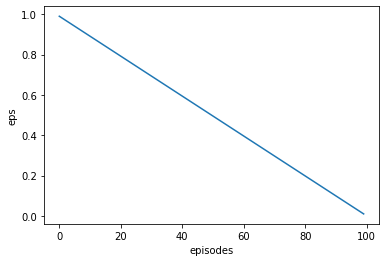

In [67]:
plt.plot(epsilons)
plt.xlabel('episodes')
plt.ylabel('eps')
plt.savefig('epsilons.jpg')

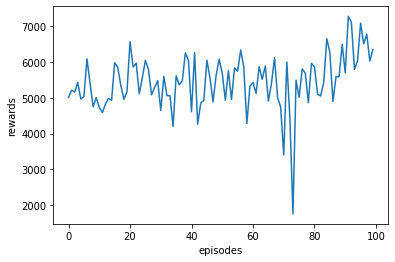

In [68]:
plt.plot(rews)
plt.xlabel('episodes')
plt.ylabel('rewards')
plt.savefig('rewards.jpg')

In [69]:
def calc_spread(prices, spread_coefficients):
    """Calculate the spread based on spread_coefficients.
    Args:
        spread_coefficients (list): A list of signed integers defining how much
            of each product to buy (positive) or sell (negative) when buying or
            selling the spread.
        prices (numpy.array): Array containing the prices (bid, ask) of
            different products, i.e: [p1_b, p1_a, p2_b, p2_a].
    Returns:
        tuple:
            - (float) spread bid price,
            - (float) spread ask price.
    """
    spread_bid = sum([
        spread_coefficients[i] *
        prices[2 * i + int(spread_coefficients[i] < 0)]
        for i in range(len(spread_coefficients))]
    )
    spread_ask = sum([
        spread_coefficients[i] *
        prices[2 * i + int(spread_coefficients[i] > 0)]
        for i in range(len(spread_coefficients))]
    )
    return spread_bid, spread_ask

[744.5083  754.44714 758.48157]
flat sell short


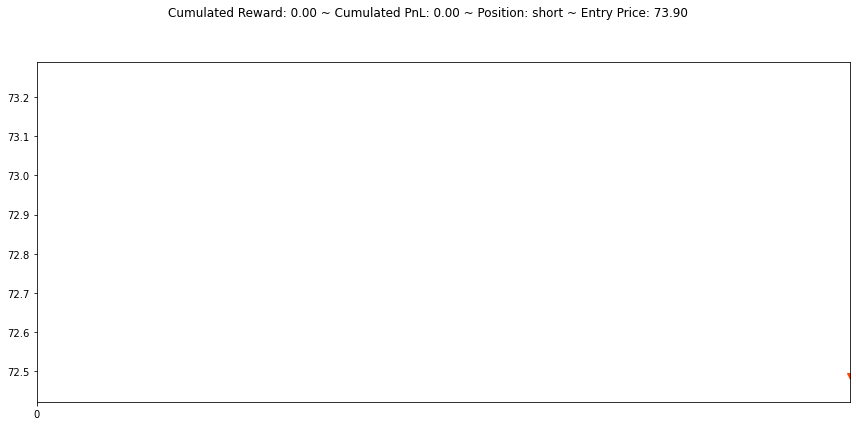

[939.2067 885.2695 780.9721]
short hold short


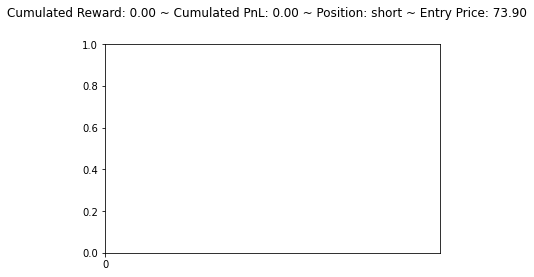

[726.8561  897.09296 891.20844]
short buy flat


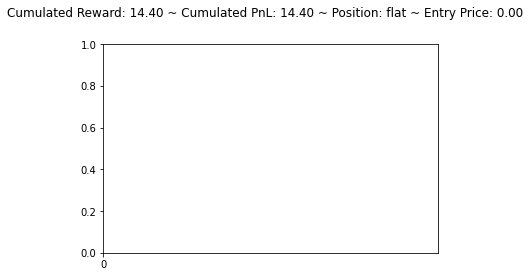

[802.4737  797.78253 676.9912 ]
flat hold flat


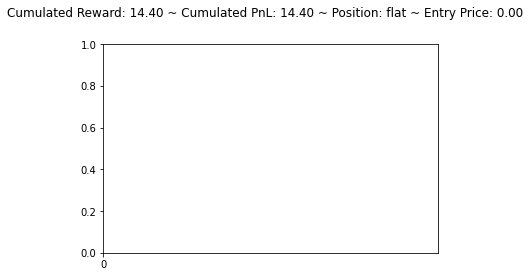

[764.3423  774.82544 883.692  ]
flat sell short


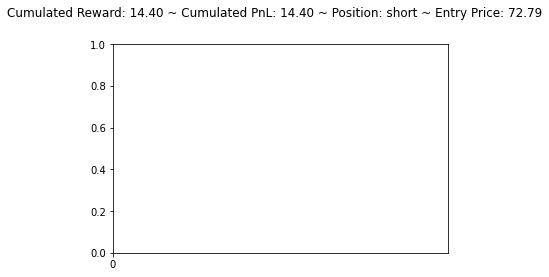

[840.37427 838.71423 962.3432 ]
short hold short


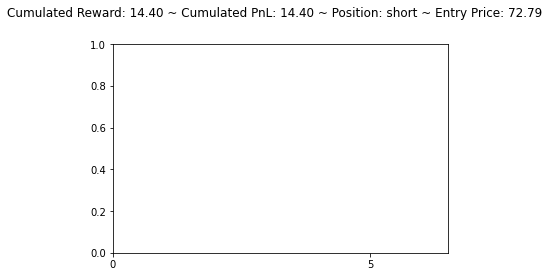

[640.0455  522.3265  844.76965]
short hold short


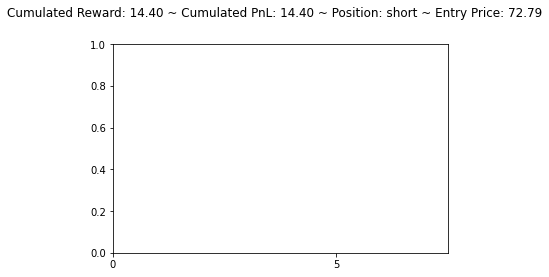

[691.44305 673.0661  815.60474]
short hold short


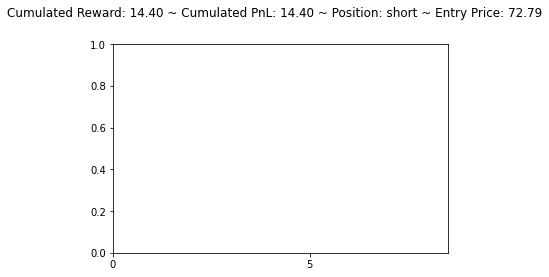

[1160.015  1017.8681 1049.1956]
short hold short


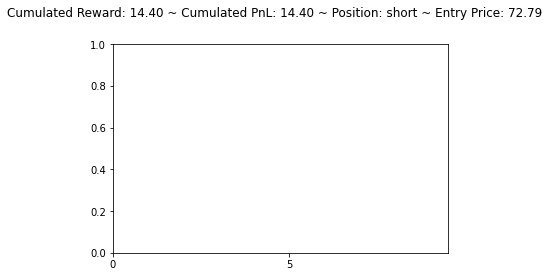

[1656.5164 1447.6758 1422.3832]
short hold short


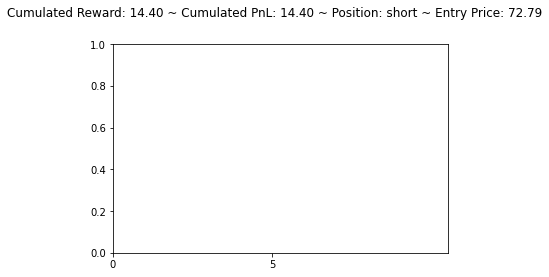

[2358.423  2068.3418 1985.7742]
short hold short


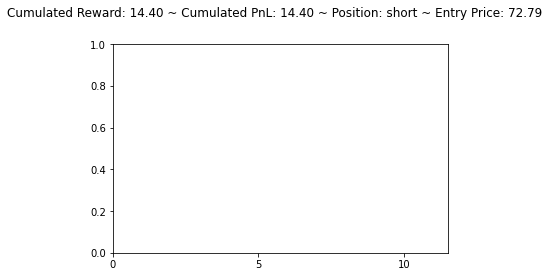

short hold short


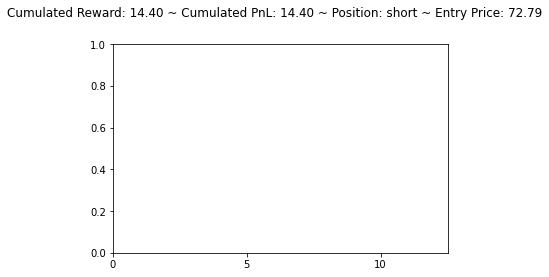

[2648.8945 2669.9092 2581.9692]
short buy flat


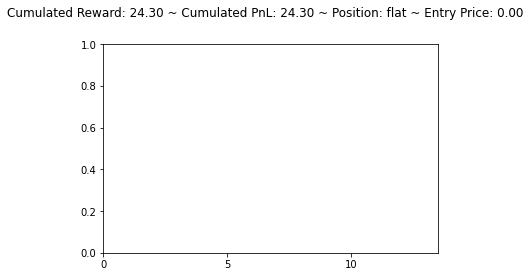

[3251.2498 3228.8962 3011.5967]
flat hold flat


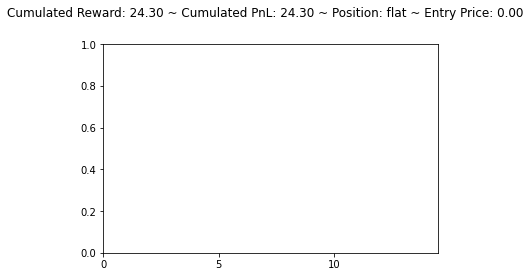

[3028.5928 3034.7068 2846.393 ]
flat buy long


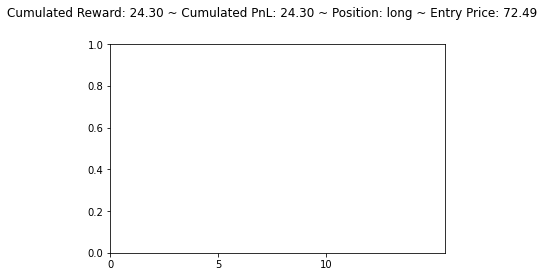

[4469.415  4280.4243 3869.2222]
long hold long


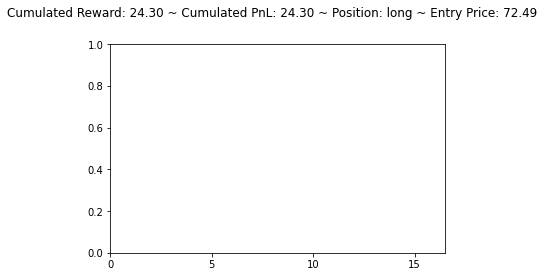

[4100.276  4113.2295 3828.9548]
long hold long


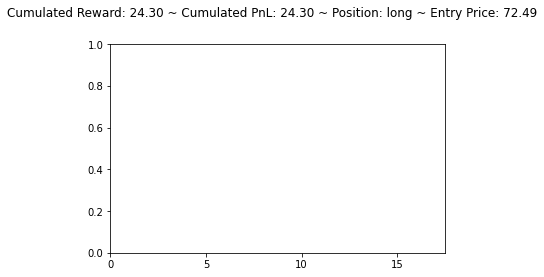

[4105.1113 4118.8813 3830.688 ]
long hold long


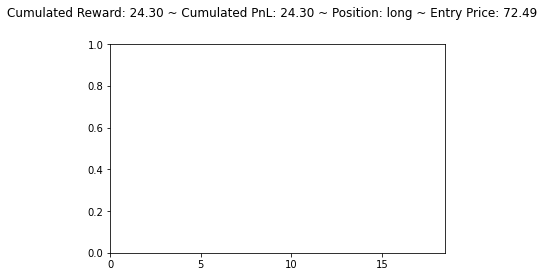

[3861.5476 4045.9568 3960.4834]
long sell flat


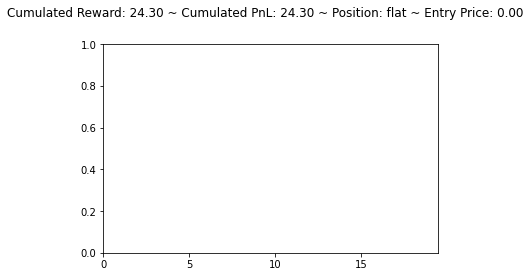

[3863.4924 3039.632  3616.3384]
flat hold flat


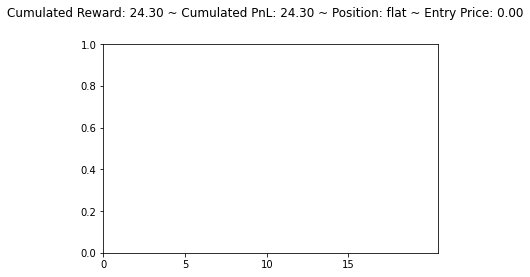

[4047.3484 4069.5027 3800.2056]
flat buy long


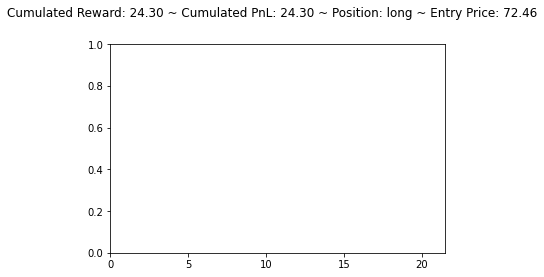

[2977.6267 2623.8665 3051.7783]
long sell flat


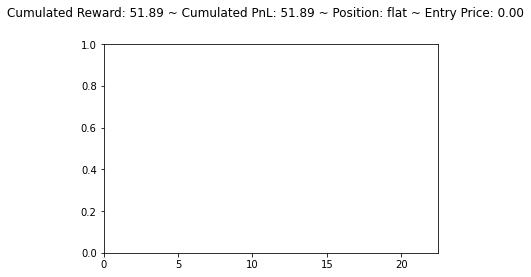

[1586.9132 2844.8809 2641.6196]
flat buy long


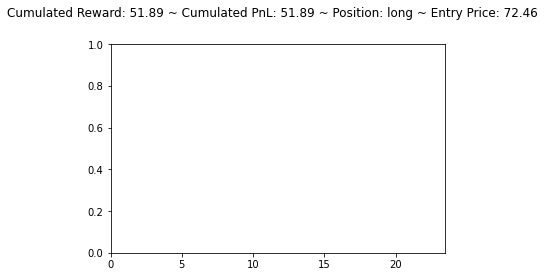

[2506.1533 3429.332  3259.6313]
long sell flat


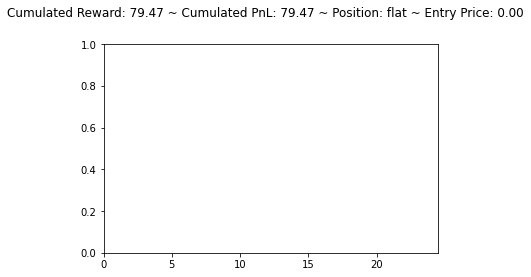

[3437.123  3480.1675 3233.811 ]
flat buy long


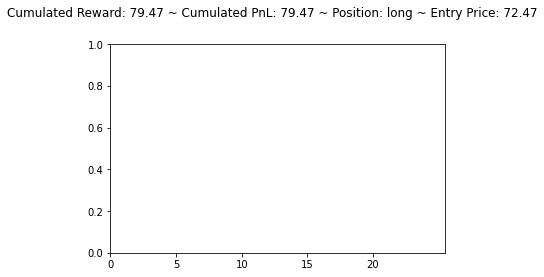

[2350.7961 2584.5066 2881.0898]
long sell flat


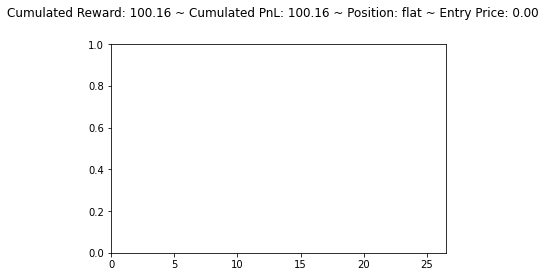

[2194.7605 2732.6375 2432.6594]
flat buy long


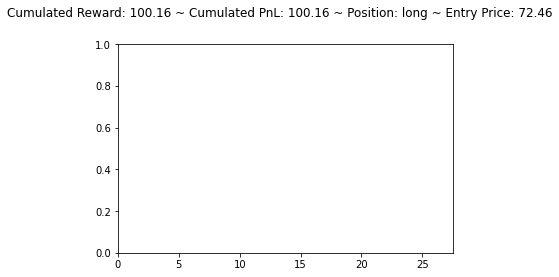

[2322.294 2573.524 2244.608]
long hold long


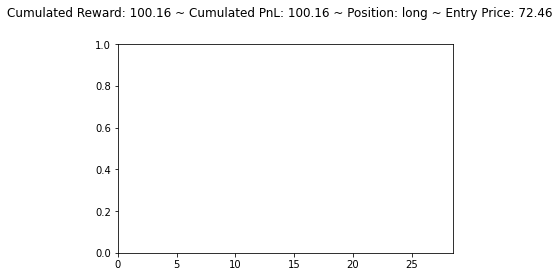

[1722.4069 1684.076  1319.2886]
long hold long


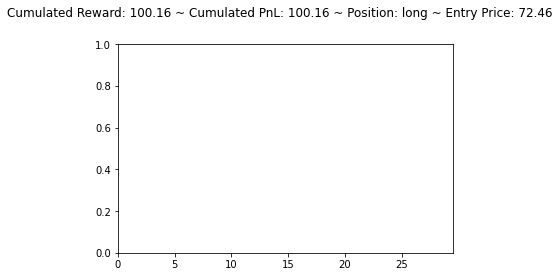

[1307.5444 1673.5457 1289.2957]
long hold long


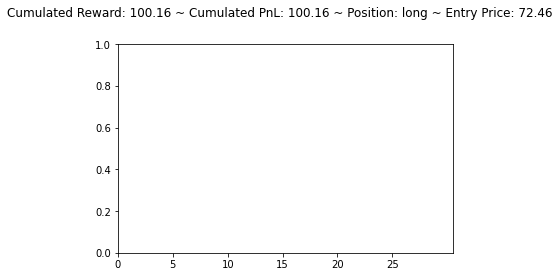

[1353.3887 1427.401  1278.3175]
long hold long


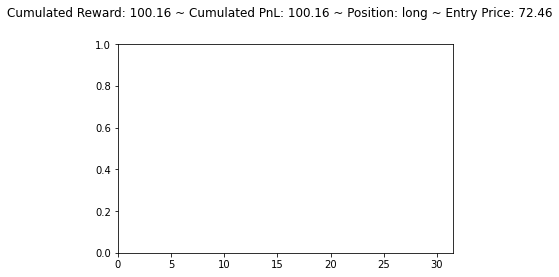

[ 846.68054 1019.6184   779.49475]
long hold long


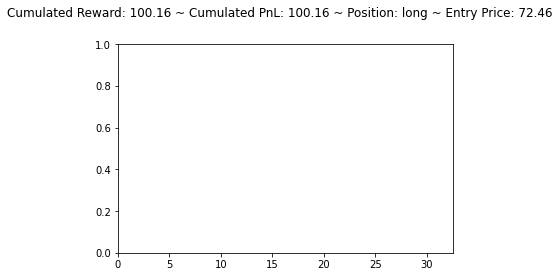

[781.66345 911.738   790.27655]
long sell flat


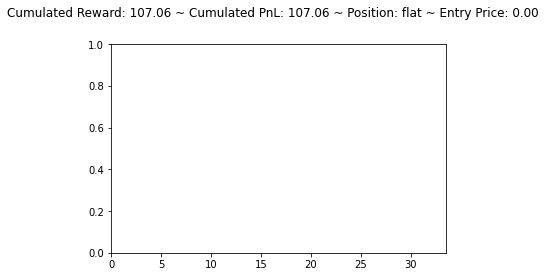

[ 902.63477 1138.9366   978.8089 ]
flat buy long


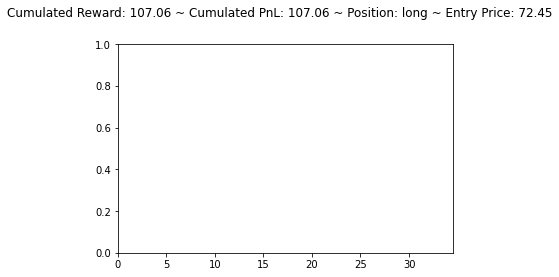

[1324.5663 1384.6038 1251.958 ]
long hold long


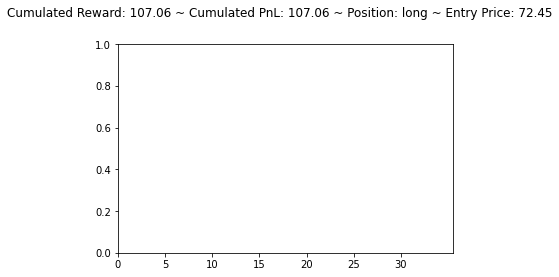

[2452.408  2270.2683 2126.8223]
long hold long


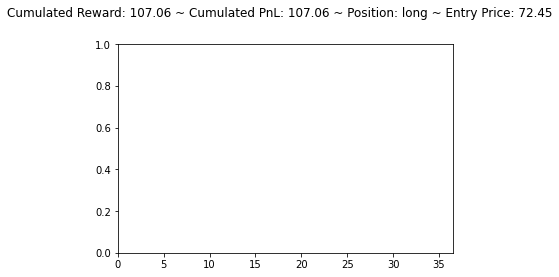

[2518.0417 2572.4746 2351.3408]
long hold long


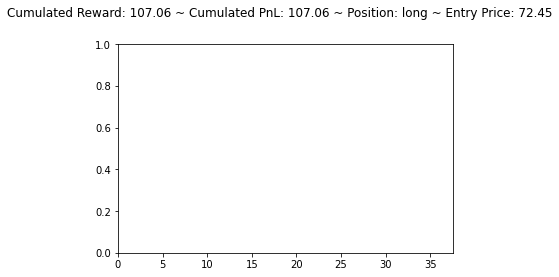

[2470.3408 2538.4275 2326.7954]
long hold long


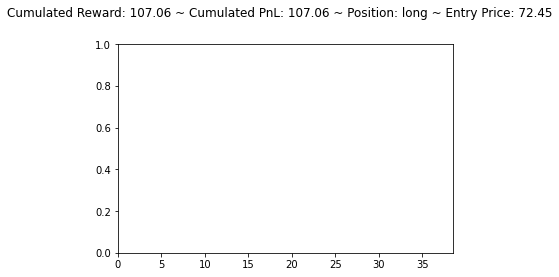

[2263.6897 2436.4712 2235.2283]
long hold long


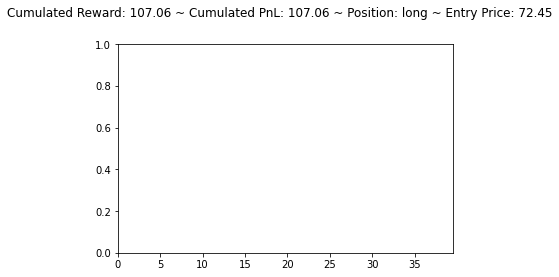

[2398.2632 2410.6807 2206.0212]
long hold long


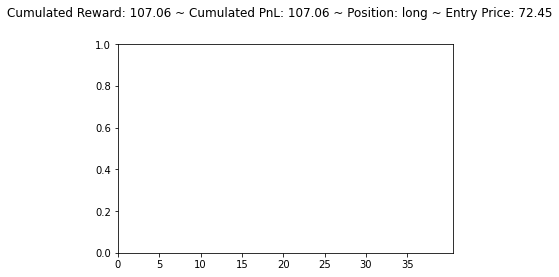

[2473.6853 2331.818  2300.4585]
long hold long


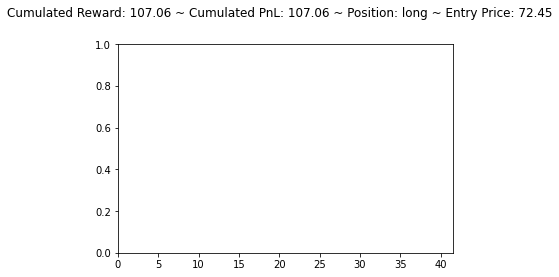

[2274.8005 2171.2324 1973.9482]
long hold long


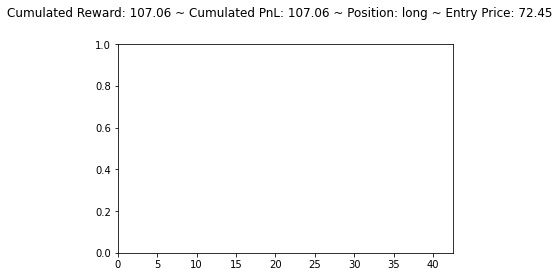

[2327.6008 2374.193  2175.1604]
long hold long


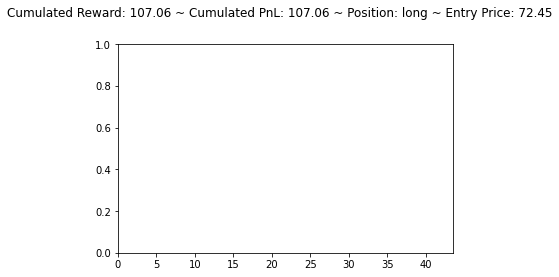

[2300.5222 2341.8604 2145.1494]
long hold long


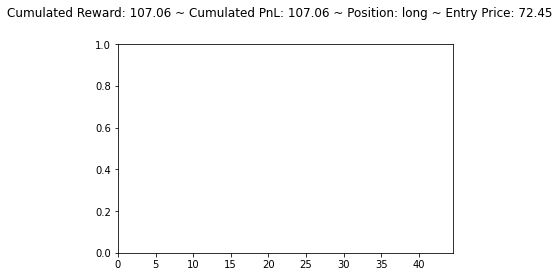

[2339.114  2334.9497 2136.5237]
long hold long


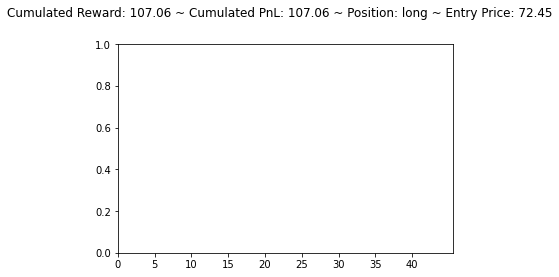

[2273.0293 2310.3623 2116.0881]
long hold long


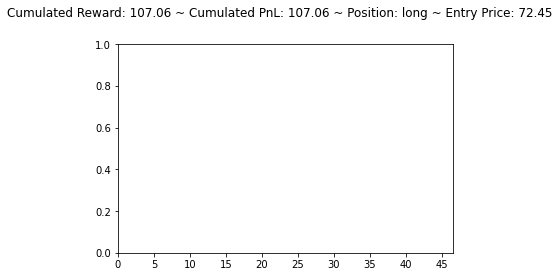

[2304.879 2299.911 2104.266]
long hold long


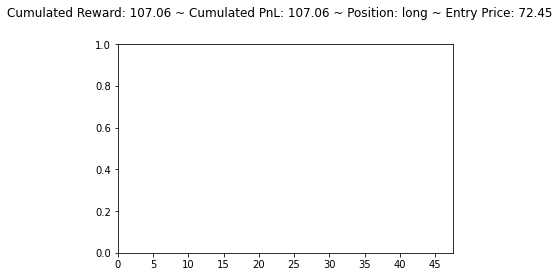

[2275.9817 2286.9521 2093.1812]
long hold long


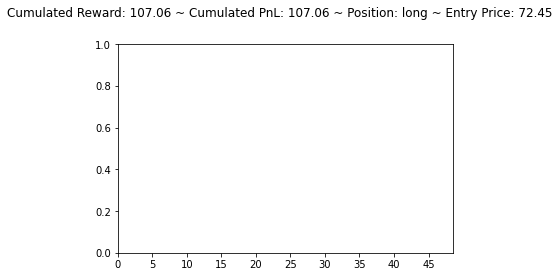

[2203.515  2248.9062 2059.985 ]
long hold long


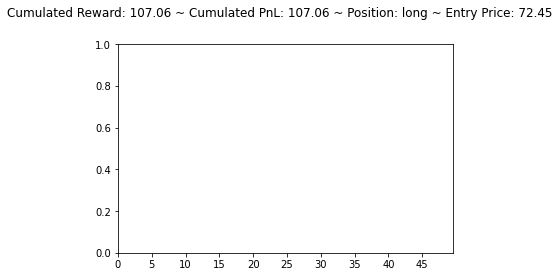

[2250.7227 2235.2444 2044.2434]
long hold long


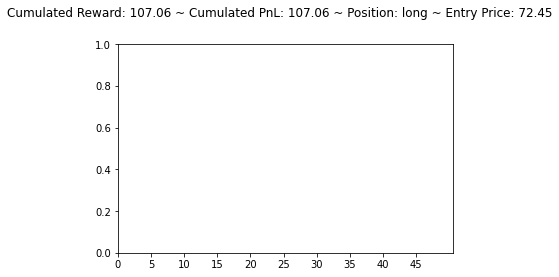

[2378.627  2168.5437 2208.524 ]
long hold long


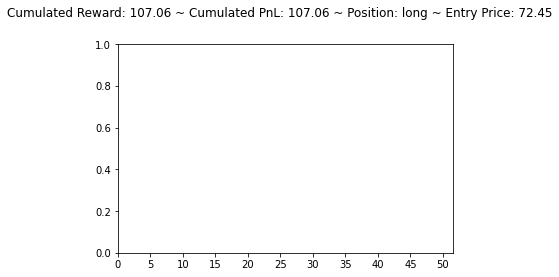

[2107.7485 2091.6914 1814.5144]
long hold long


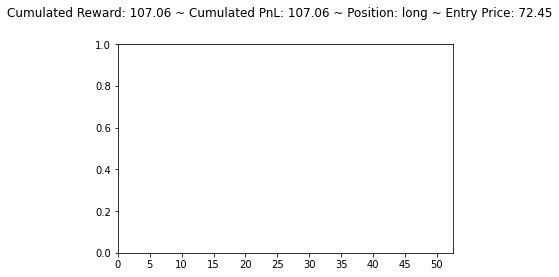

[2246.1194 2229.7493 2039.1418]
long hold long


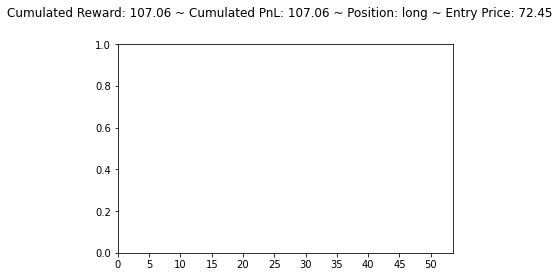

[2243.4116 2226.5168 2036.1416]
long hold long


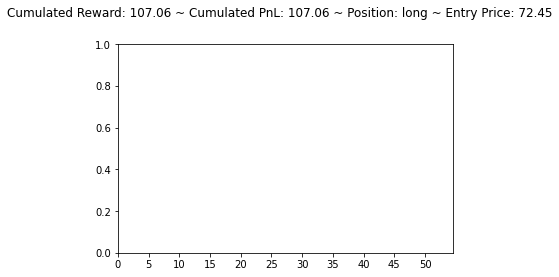

[2240.7043 2223.2817 2033.1396]
long hold long


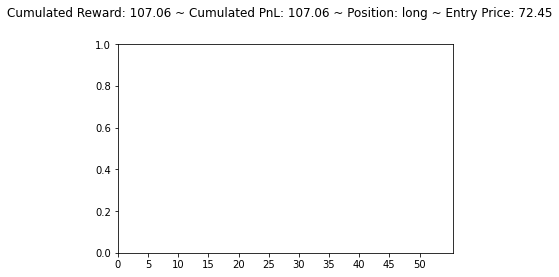

[2380.161  2151.8665 2205.383 ]
long hold long


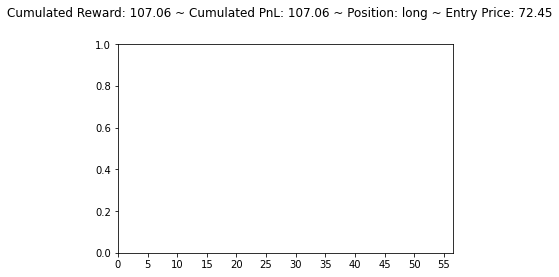

[2090.3057 2083.618  1797.4585]
long hold long


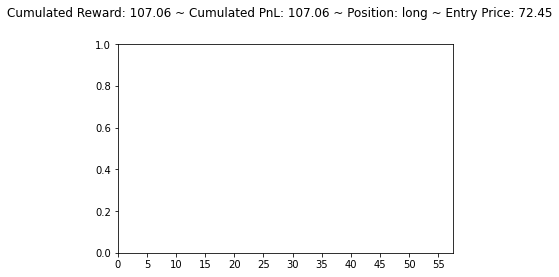

[2231.227  2211.9656 2022.6362]
long hold long


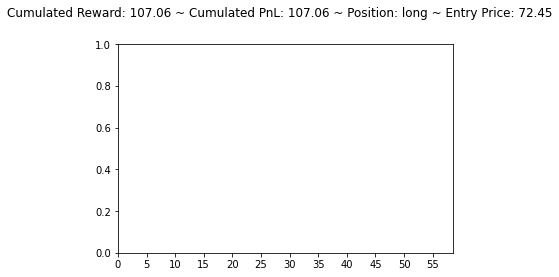

[2202.3284 2199.0076 2011.5503]
long hold long


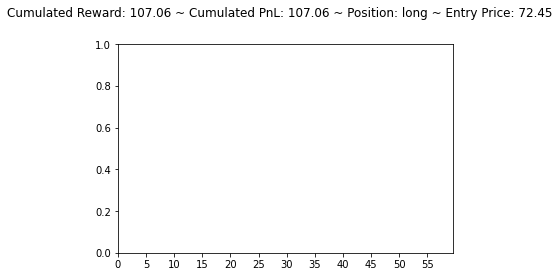

[2214.9795 2192.567  2004.6306]
long hold long


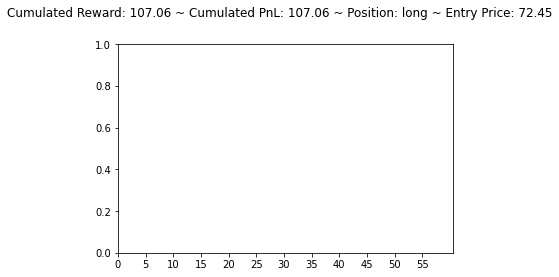

[2212.2712 2189.334  2001.6299]
long hold long


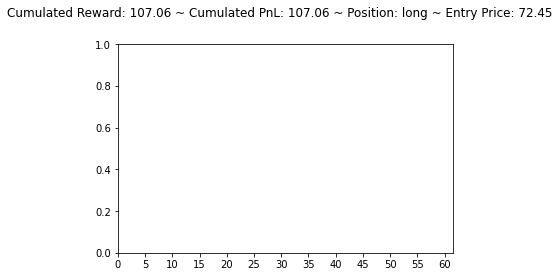

[2219.9575 2214.5842 2028.137 ]
long hold long


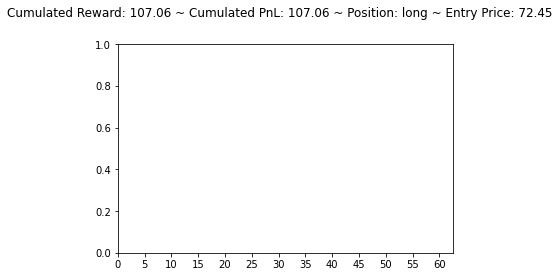

[2186.8062 2200.7085 2016.6814]
long hold long


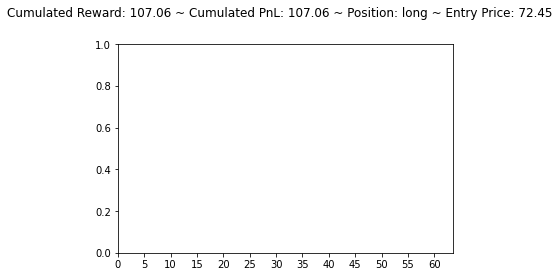

[2475.472  2411.0645 2177.2275]
long hold long


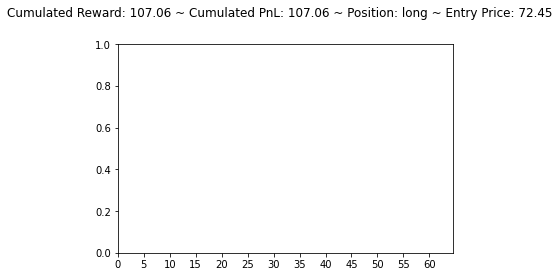

[2314.7756 2403.1775 2204.774 ]
long hold long


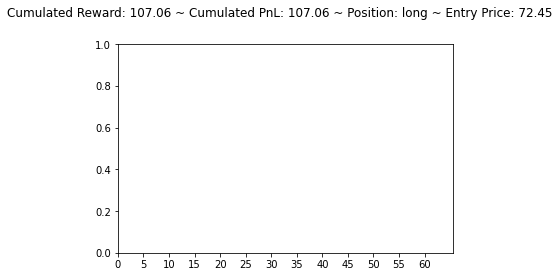

[2162.7446 2317.4238 2131.3743]
long hold long


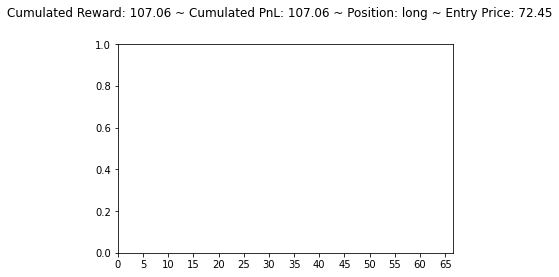

[2179.7222 2256.8926 2071.657 ]
long hold long


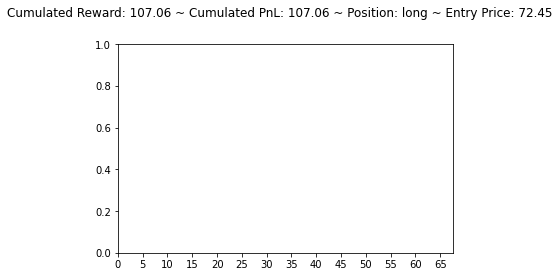

[2106.3672 2196.2385 2016.5361]
long hold long


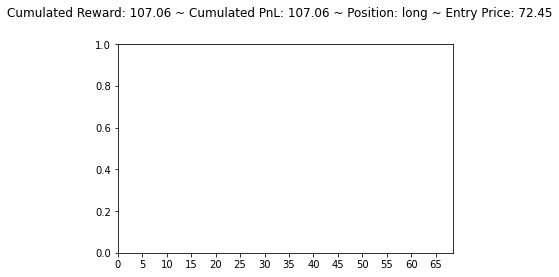

[2124.2334 2158.3145 1978.7462]
long hold long


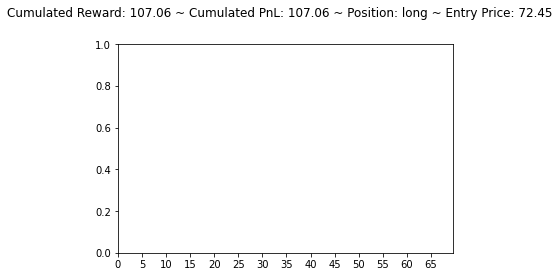

[2152.2432 2148.665  1967.9043]
long hold long


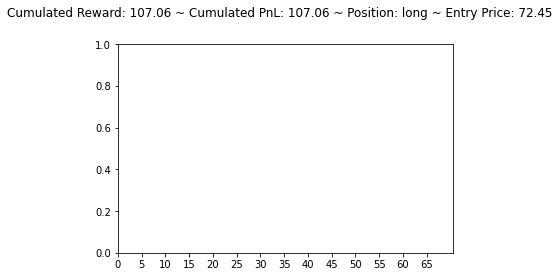

[2149.5352 2145.4324 1964.904 ]
long hold long


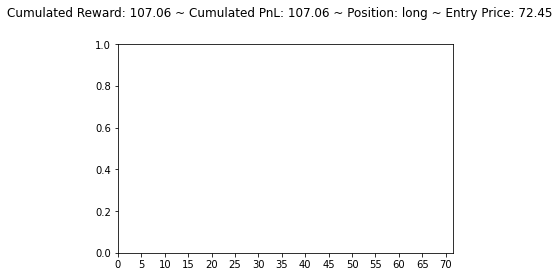

[2146.8274 2142.199  1961.9022]
long hold long


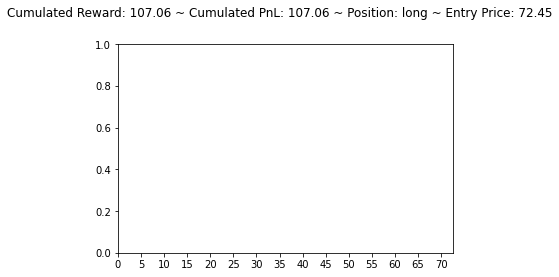

[2111.3823 2126.8105 1948.7959]
long hold long


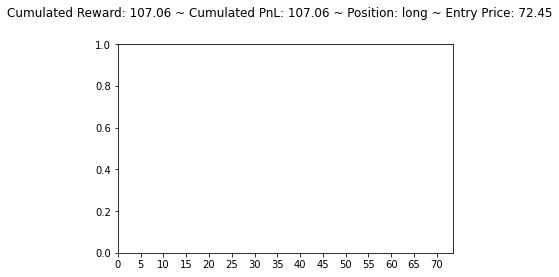

[2003.4696 2073.3743 1902.4958]
long hold long


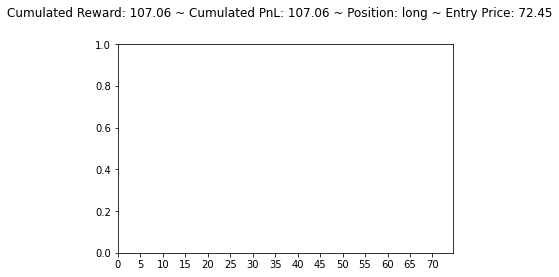

long hold long


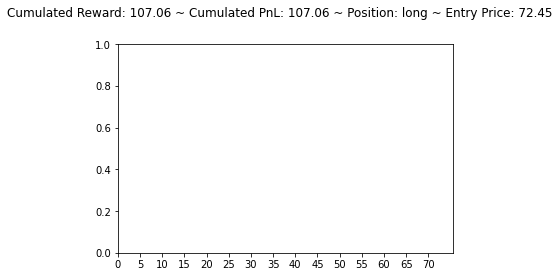

[1710.0486 1830.7567 1682.012 ]
long hold long


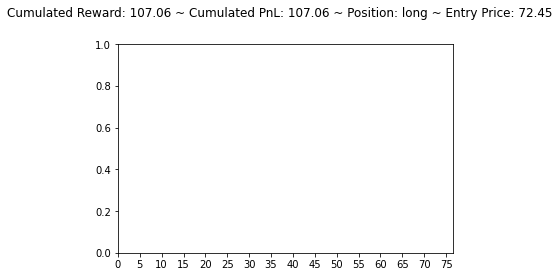

[1837.4464 1788.9479 1634.7269]
long hold long


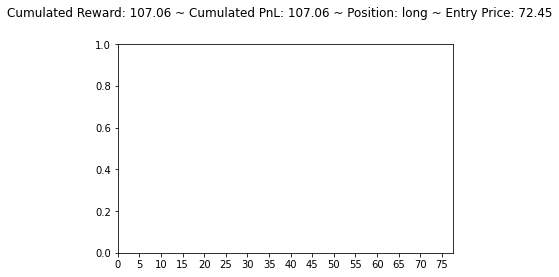

[1689.1167 1724.9612 1580.2811]
long hold long


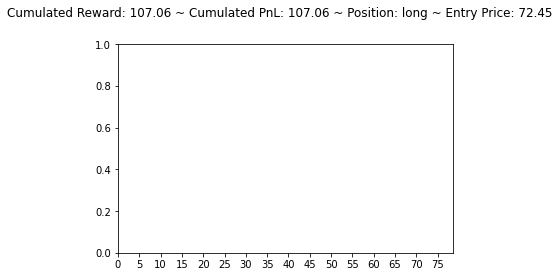

[1758.9191 1695.1843 1547.6968]
long hold long


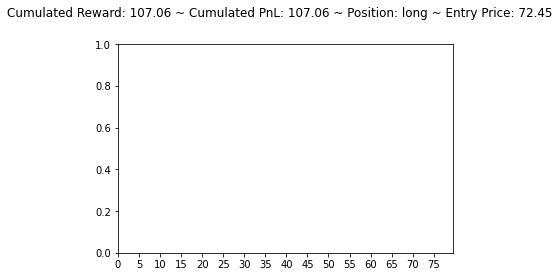

[1741.5397 1679.8201 1533.6711]
long hold long


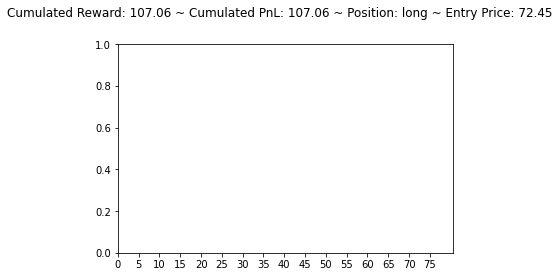

[1734.5485 1666.0856 1520.6877]
long hold long


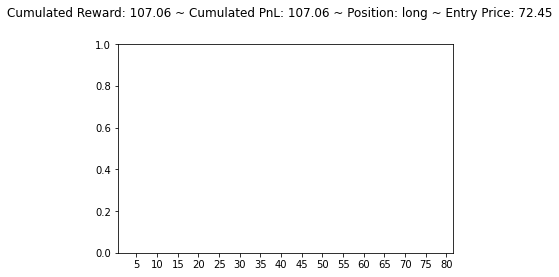

[1743.3596 1660.4447 1514.7458]
long hold long


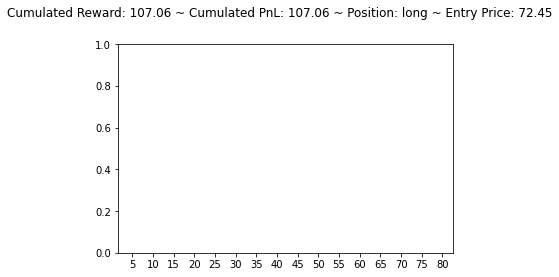

[1648.9865 1623.1763 1483.4513]
long hold long


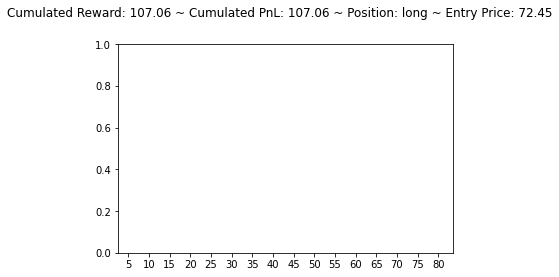

[1641.1068 1586.8333 1448.541 ]
long hold long


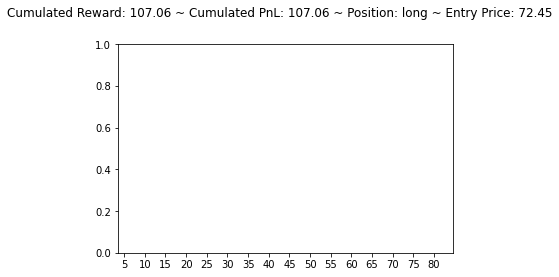

[1679.5686 1579.1825 1439.1321]
long hold long


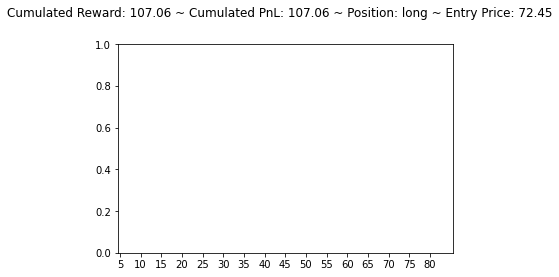

[1391.2747 1472.1195 1350.1313]
long hold long


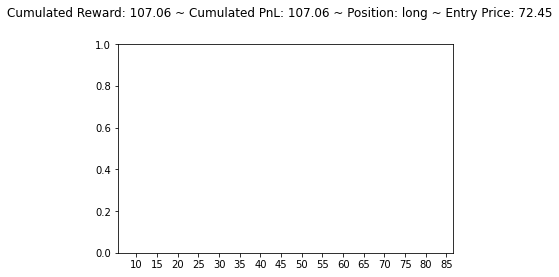

[1285.2247 1334.7196 1222.1267]
long hold long


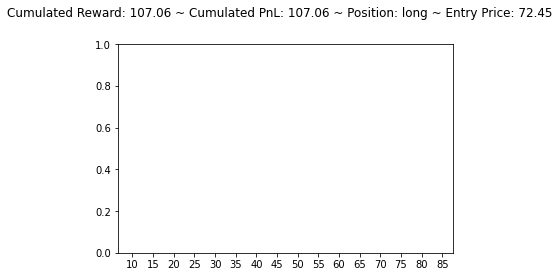

[1368.3287 1268.9453 1134.6227]
long hold long


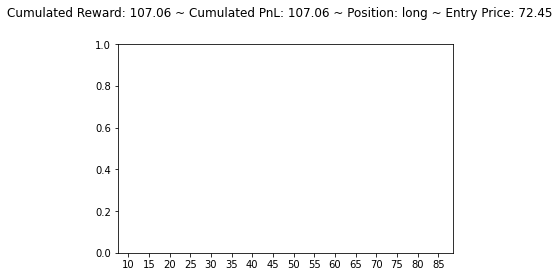

[1083.0319 1220.2831 1109.3903]
long sell flat


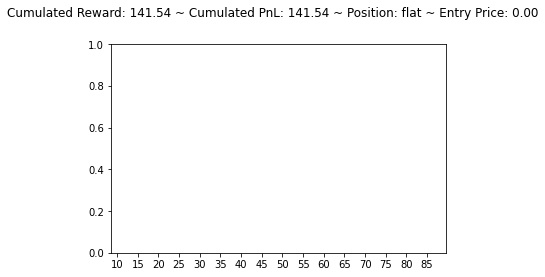

[1059.1733 1165.4363 1065.5839]
flat buy long


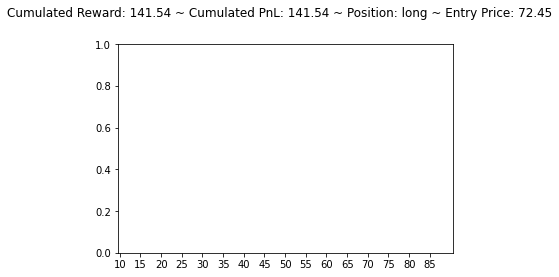

[ 838.06244 1276.0638  1216.0018 ]
long sell flat


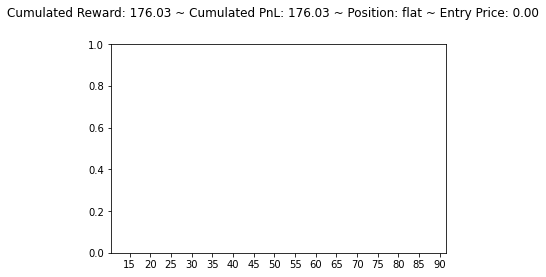

[ 629.5539 1253.5104 1239.1849]
flat buy long


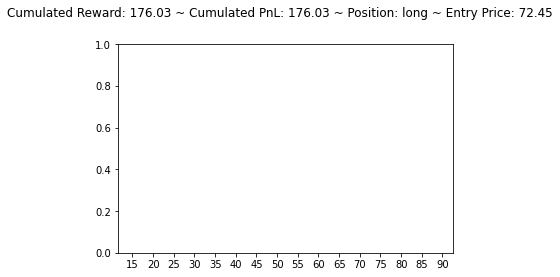

[ 624.8255 1298.7062 1320.2141]
long sell flat


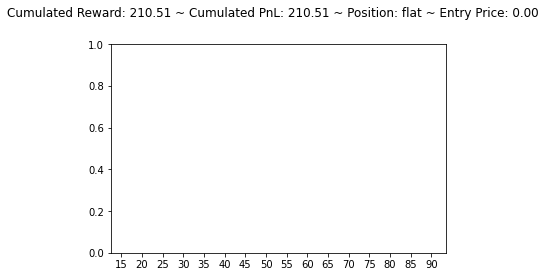

[ 735.17914 1223.175   1233.2366 ]
flat sell short


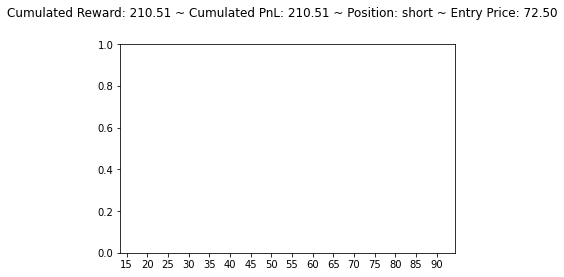

[ 938.39856 1285.0807  1322.9854 ]
short buy flat


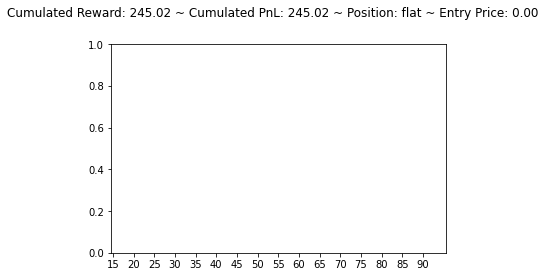

[ 945.5356 1208.9512 1242.1248]
flat sell short


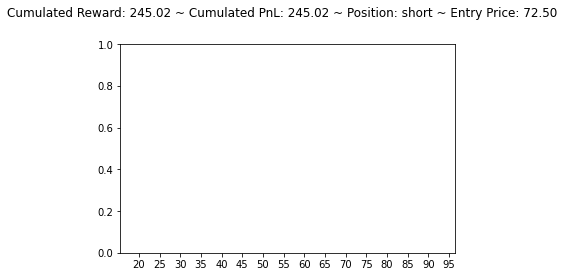

[1174.8322 1336.4458 1318.1987]
short buy flat


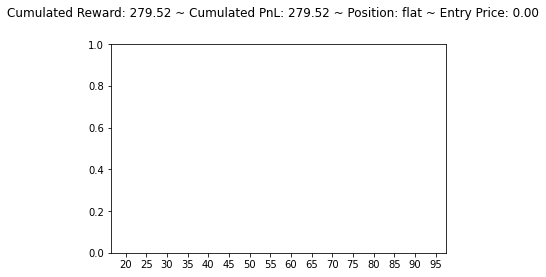

[ 939.8984 1133.5829  913.1591]
flat buy long


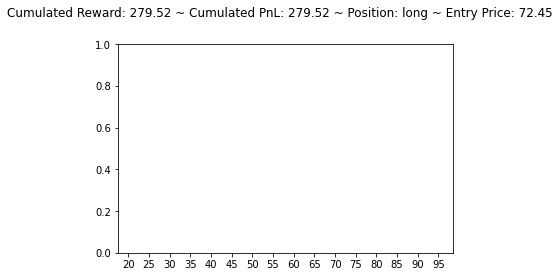

[1299.786  1478.6787 1226.5266]
long hold long


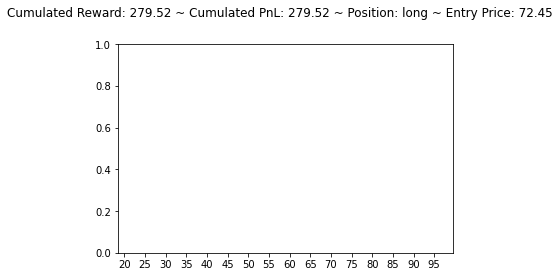

[1454.5239 1453.3778 1316.6176]
long hold long


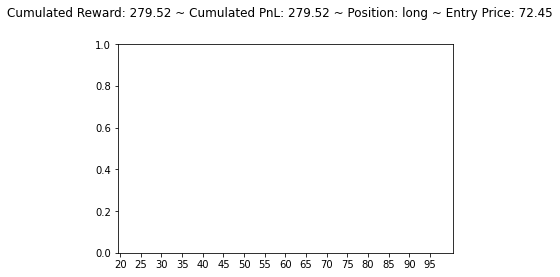

[1514.546  1531.3723 1474.9758]
long hold long


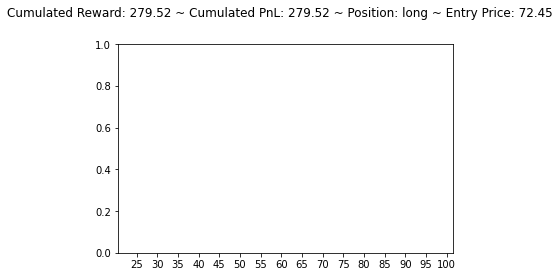

[1647.7339 1706.5667 1631.9956]
long hold long


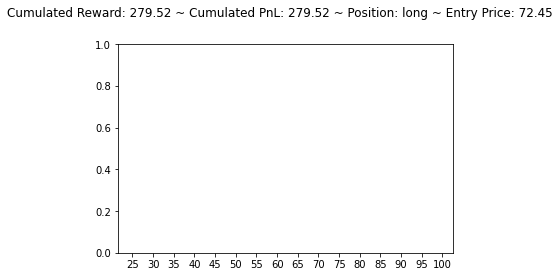

[1681.7777 1720.2283 1663.899 ]
long hold long


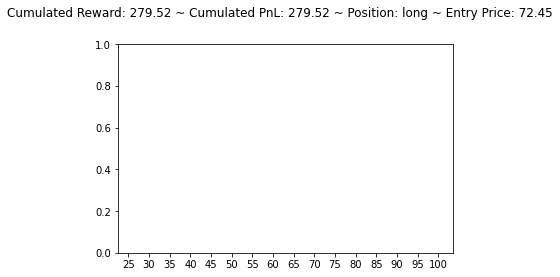

[1686.1921 1787.5201 1741.8292]
long sell flat


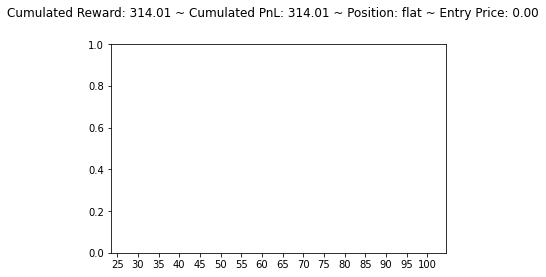

[1558.2589 1585.6046 1579.1528]
flat buy long


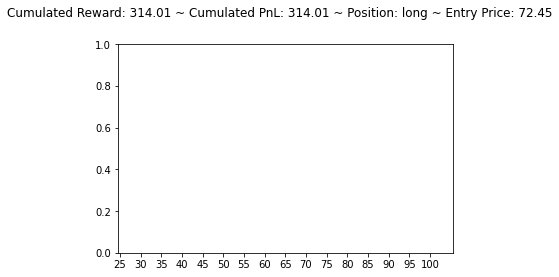

[1410.0453 1454.9792 1422.1354]
long sell flat


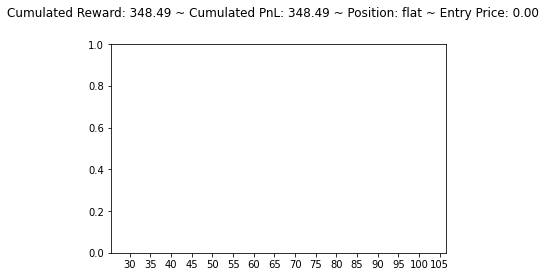

[1044.8594  1002.57385 1013.8314 ]
flat hold flat


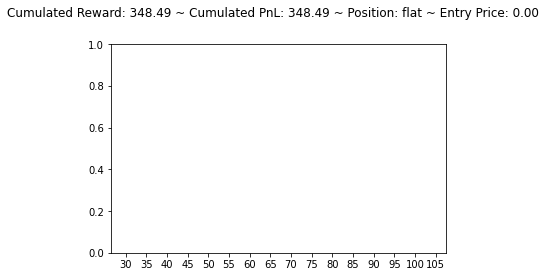

[928.9569 907.9314 891.9662]
flat hold flat


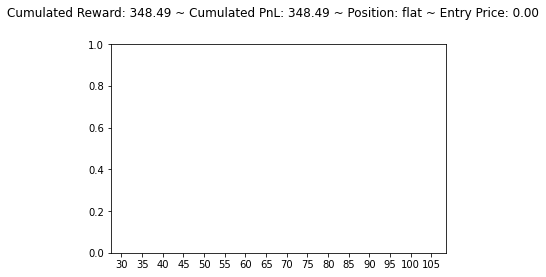

[1183.743  1351.5834 1154.5686]
flat buy long


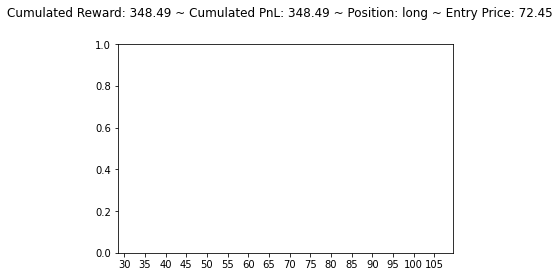

[1425.047  1434.3406 1338.4773]
long hold long


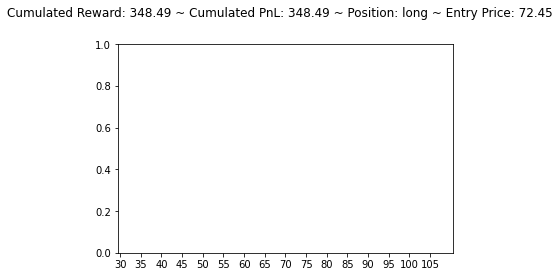

[642.17773 982.21216 936.8505 ]
long sell flat


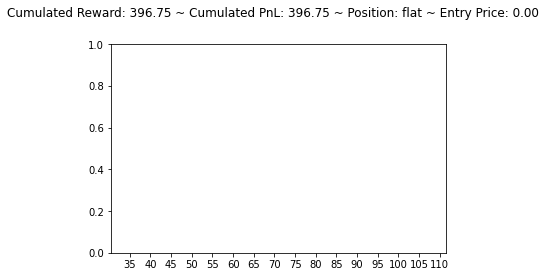

[ 875.11304 1013.88696  905.85614]
flat buy long


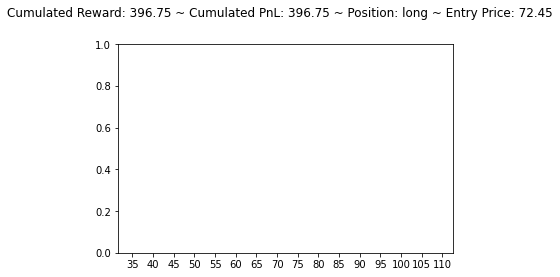

[ 499.5412 1017.6494  883.213 ]
long sell flat


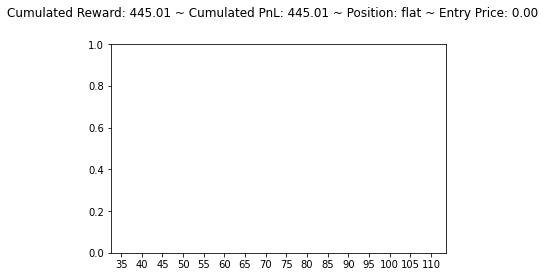

[436.0814  689.3397  708.41064]
flat sell short


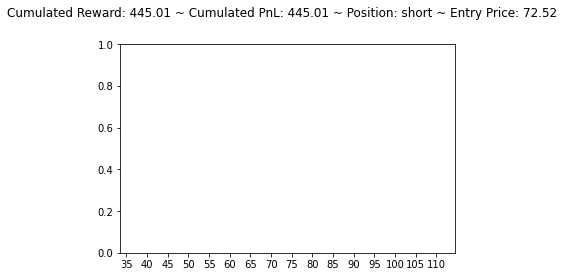

[612.22186 639.30145 698.5786 ]
short buy flat


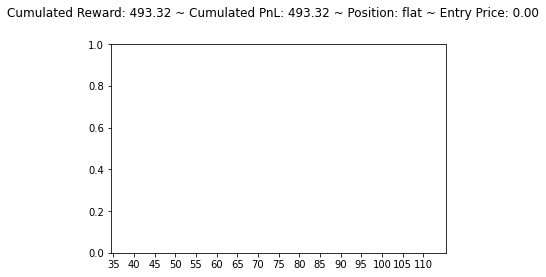

[568.9899 680.2379 720.7843]
flat sell short


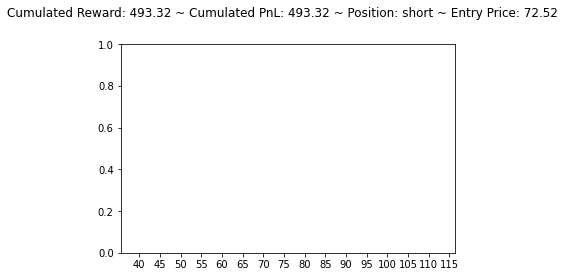

[563.9582 568.4332 788.0232]
short buy flat


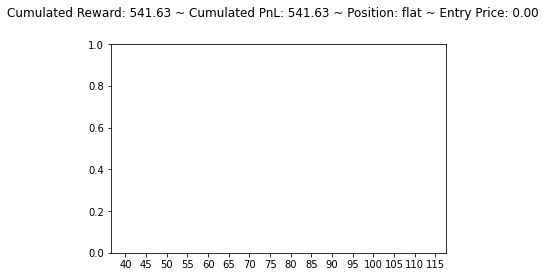

[581.52637 680.77136 795.0327 ]
flat sell short


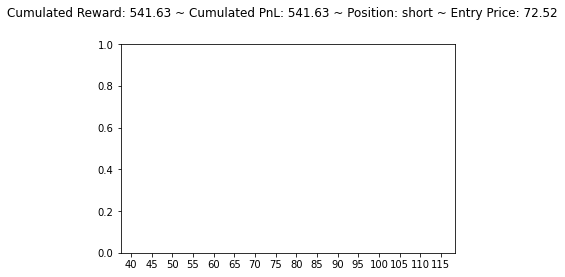

[734.3527 757.6168 844.1716]
short buy flat


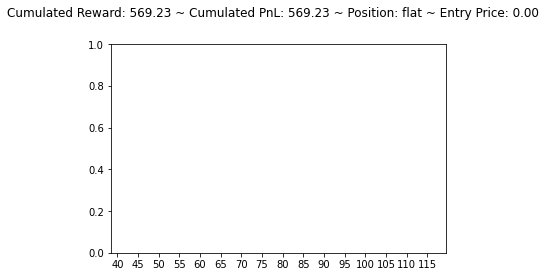

[655.0528  705.75104 820.2942 ]
flat sell short


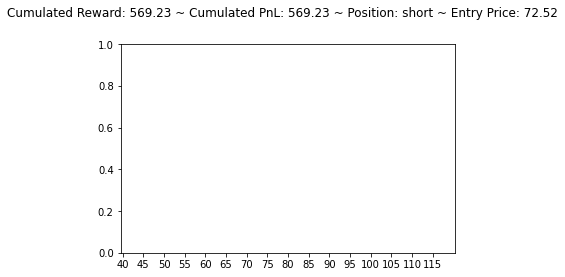

[715.9682  744.556   808.62146]
short buy flat


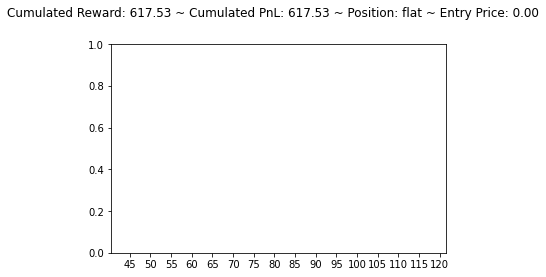

[568.83356 648.05225 711.30505]
flat sell short


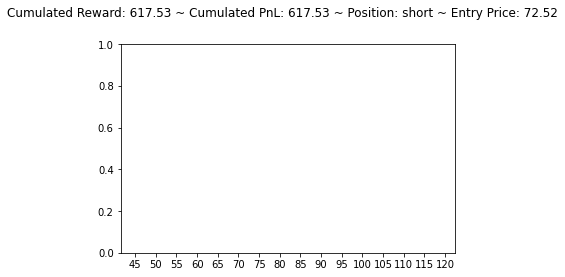

[709.60443 763.65924 897.51843]
short buy flat


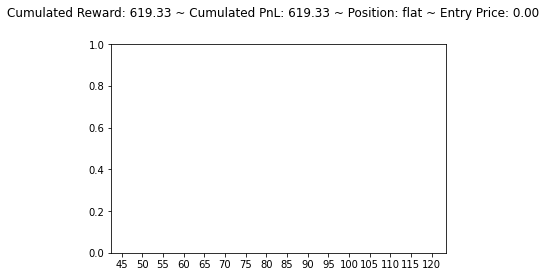

[667.0722 696.5845 767.8625]
flat sell short


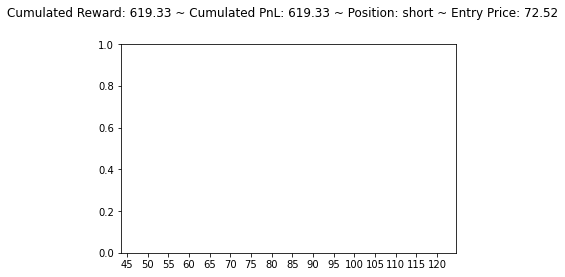

[621.24335 659.5827  780.387  ]
short buy flat


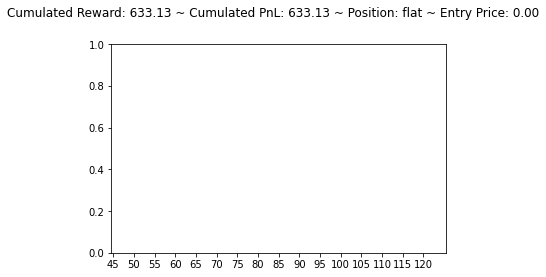

[585.3162  640.926   751.48364]
flat sell short


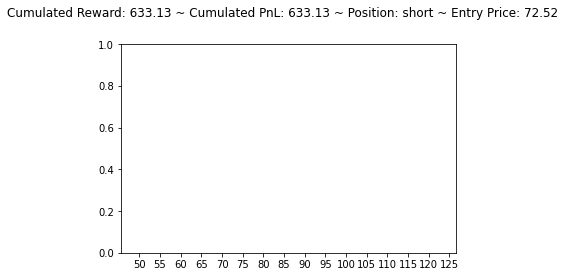

[668.2267  697.4324  791.13684]
short buy flat


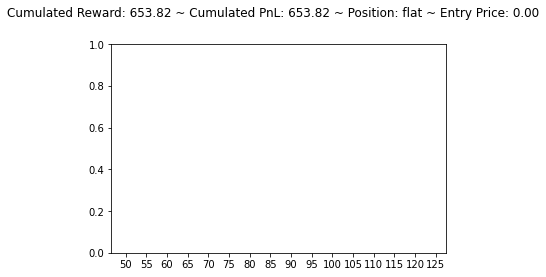

[600.1925 650.0957 774.3584]
flat sell short


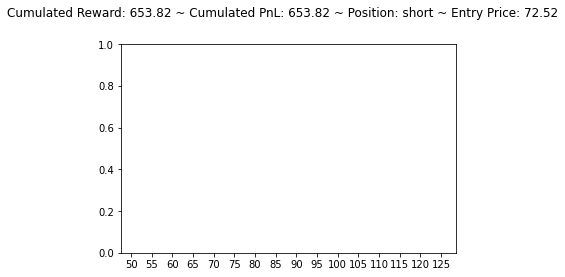

[729.3253  729.8838  862.36084]
short buy flat


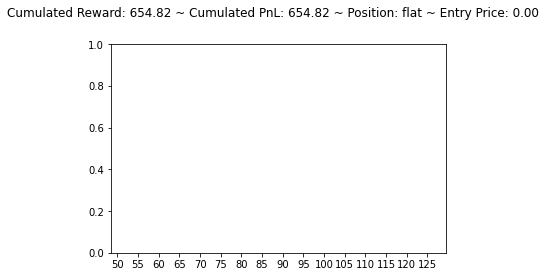

[585.0783  620.7947  688.33545]
flat sell short


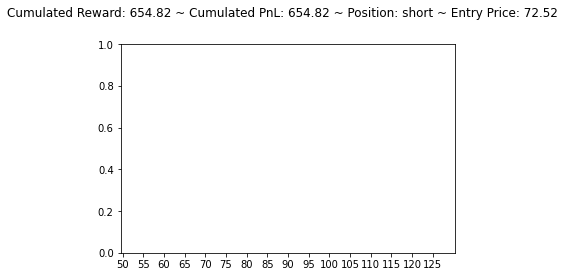

[568.5608  636.55835 709.15204]
short buy flat


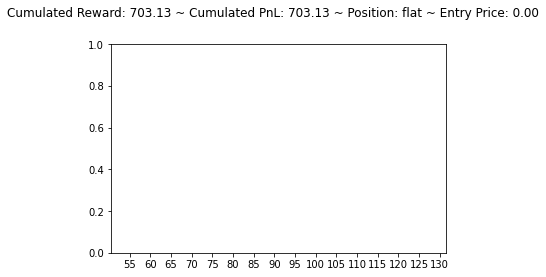

[564.1182  631.2519  759.26733]
flat sell short


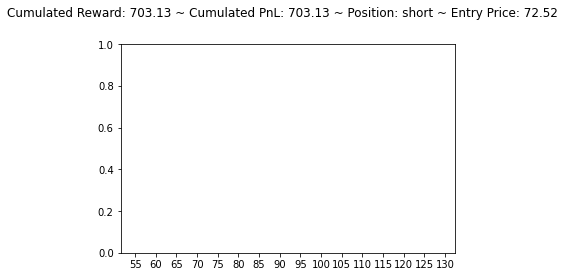

[723.06866 721.30566 859.0519 ]
short hold short


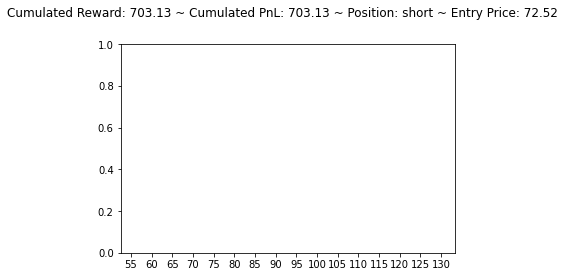

[880.5844  700.76245 889.3132 ]
short hold short


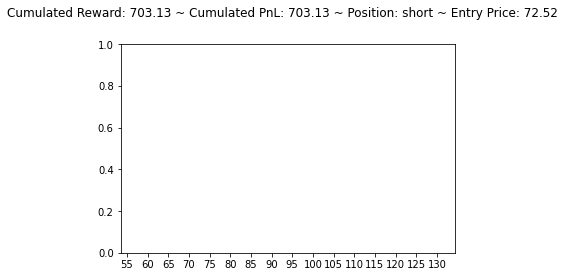

[741.8277  752.89453 523.1105 ]
short buy flat


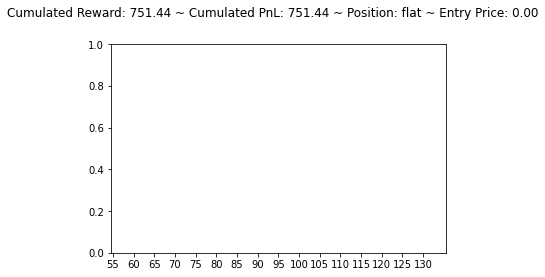

[548.4456  617.33154 742.65375]
flat sell short


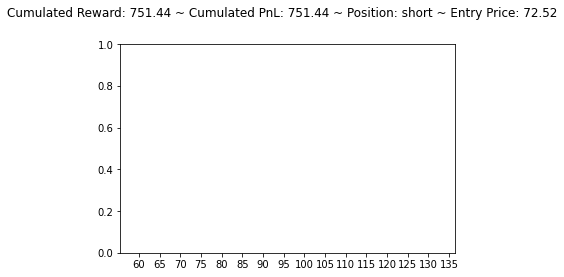

[595.58154 639.29333 742.158  ]
short buy flat


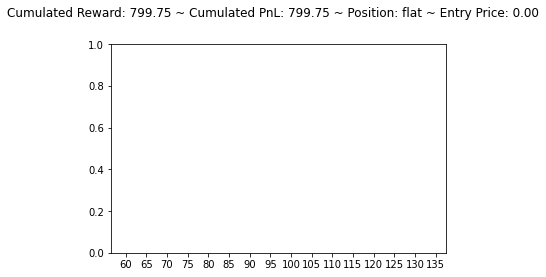

[497.70154 592.32416 720.4125 ]
flat sell short


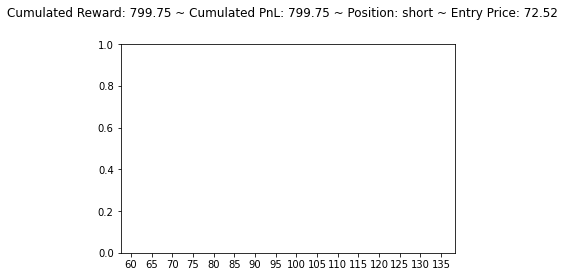

[711.69775 710.203   848.75757]
short hold short


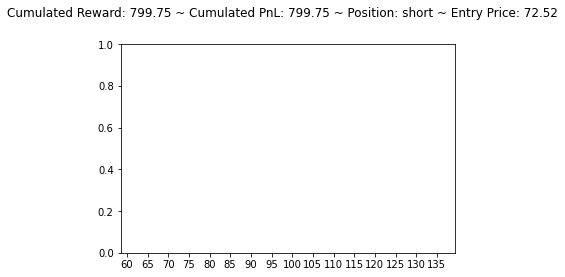

[710.64374 709.7223  847.8688 ]
short hold short


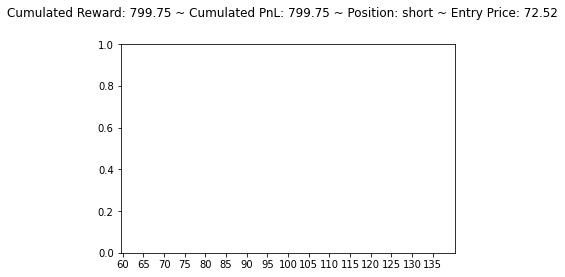

[709.58997 709.24176 846.9803 ]
short hold short


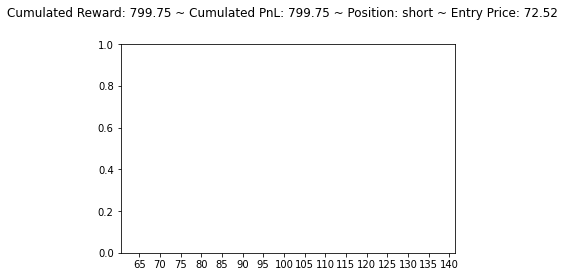

[708.5361 708.7613 846.092 ]
short buy flat


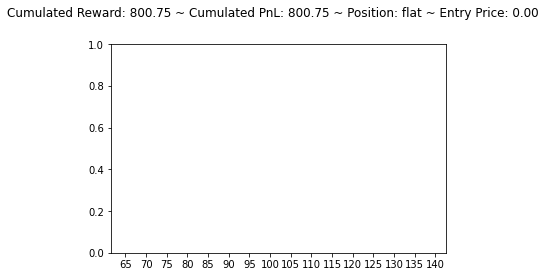

[621.5193  635.19556 758.499  ]
flat sell short


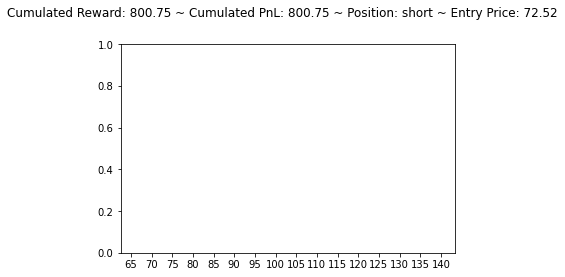

[653.26385 654.90857 796.2702 ]
short buy flat


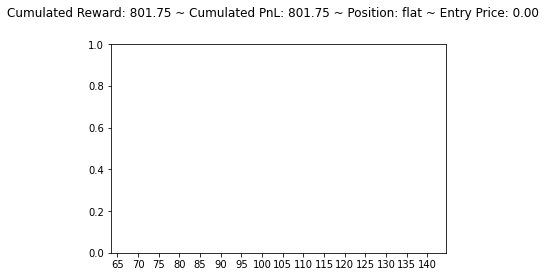

[536.2299 575.0773 658.2122]
flat sell short


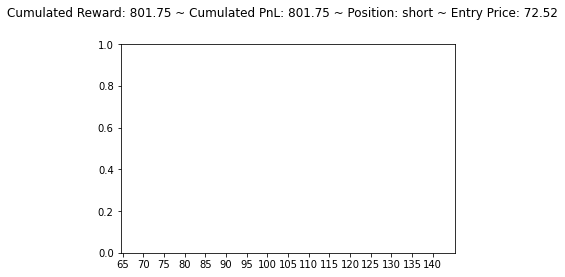

[552.29846 598.3372  694.7137 ]
short buy flat


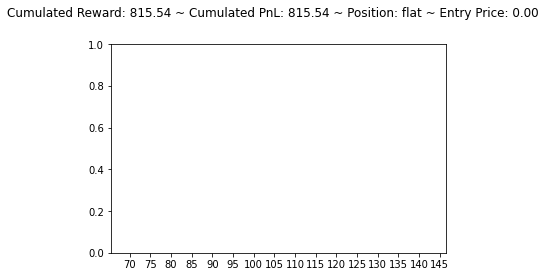

[443.0525  499.0049  610.78644]
flat sell short


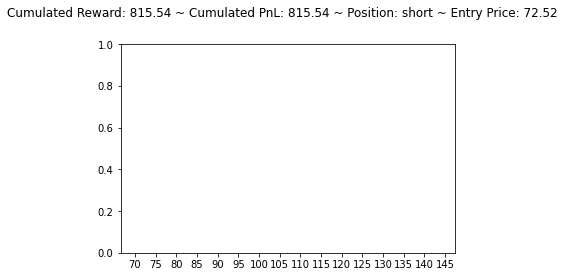

[480.97925 613.8592  697.35394]
short buy flat


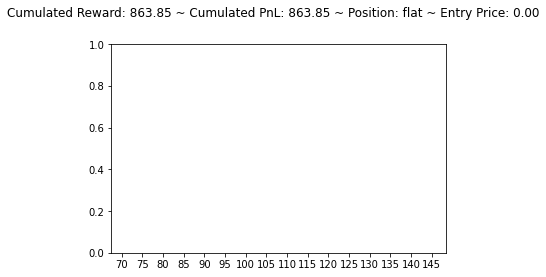

[427.39413 595.76154 766.75305]
flat sell short


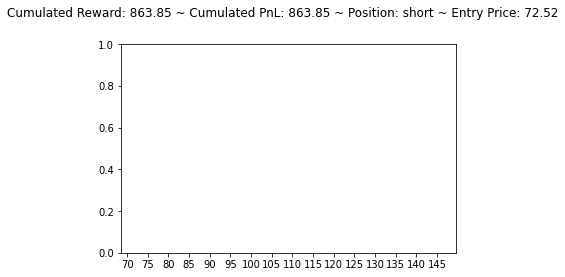

[596.6446  799.5167  820.87024]
short buy flat


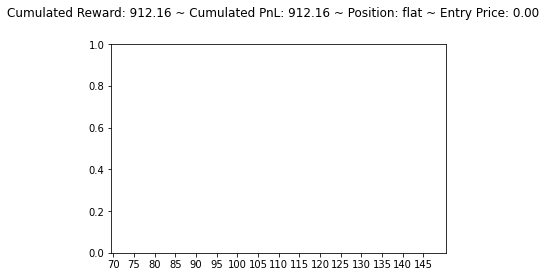

[830.3255 696.4682 836.8214]
flat sell short


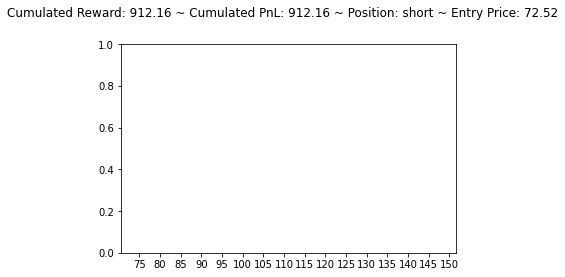

[1164.0819  1181.0107  1022.85156]
short buy flat


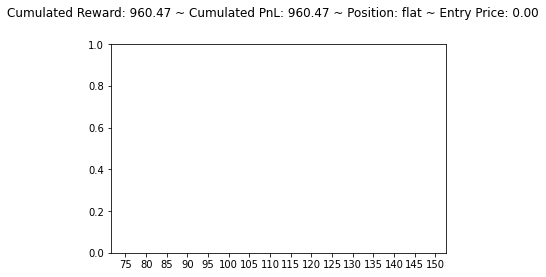

[1021.1724  947.9855  925.1638]
flat hold flat


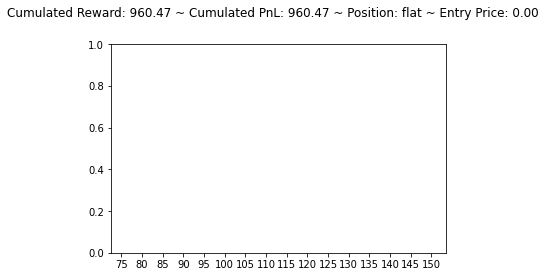

[776.20807 712.1085  683.25745]
flat hold flat


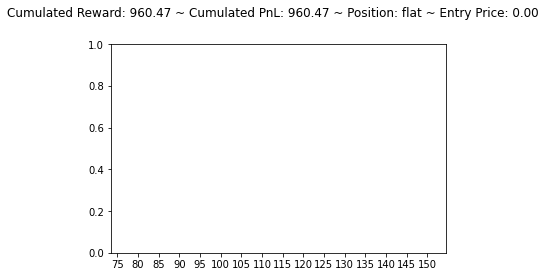

[766.569  729.3065 703.565 ]
flat hold flat


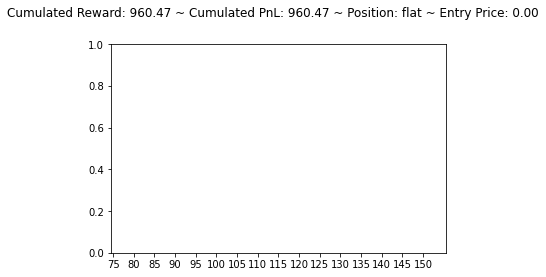

[606.38904 711.79767 590.6991 ]
flat buy long


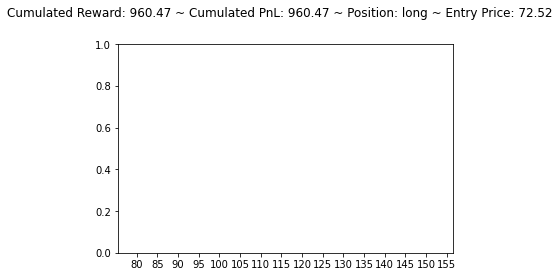

[456.58444 640.8682  702.8297 ]
long sell flat


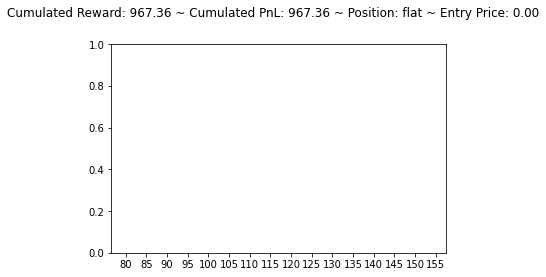

[467.13632 557.0375  635.81616]
flat sell short


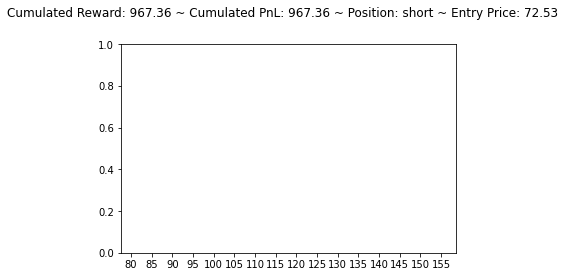

[691.2359  719.5005  799.83704]
short buy flat


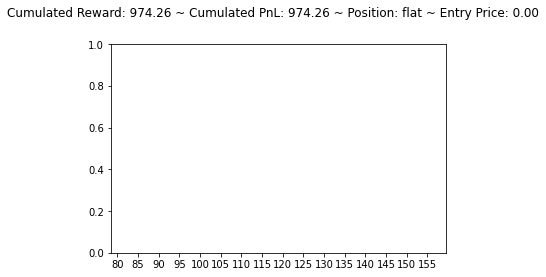

[564.5739 586.2876 760.8943]
flat sell short


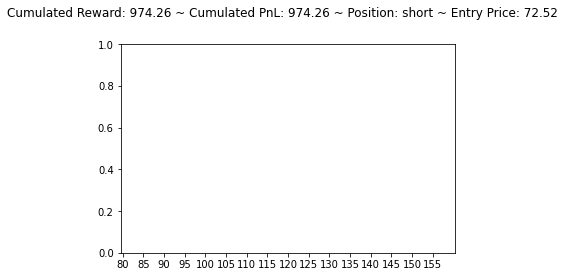

[760.53937 656.3395  760.74475]
short hold short


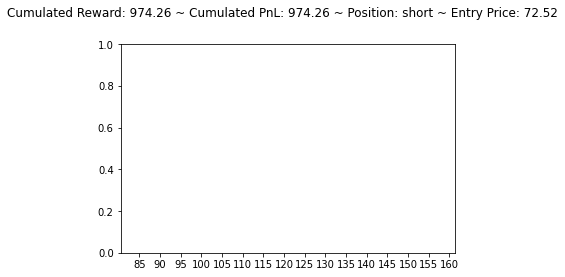

[715.18097 632.50916 732.89575]
short hold short


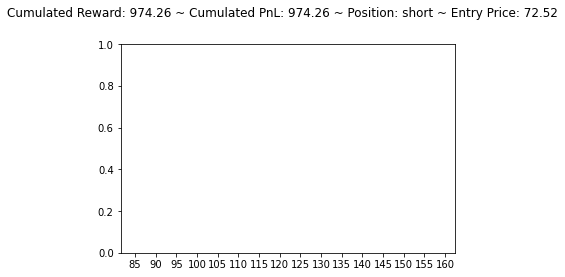

[859.3121  804.6098  756.78534]
short hold short


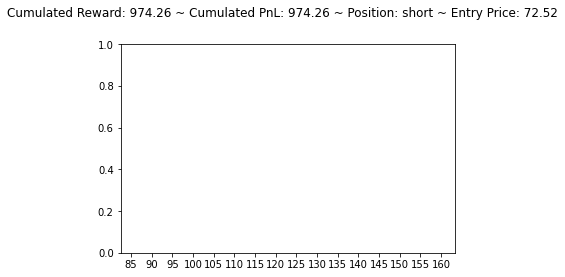

[847.0476  855.15625 624.7355 ]
short buy flat


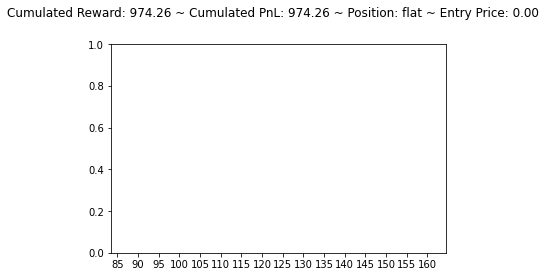

[1008.23334  934.79175  985.7661 ]
flat hold flat


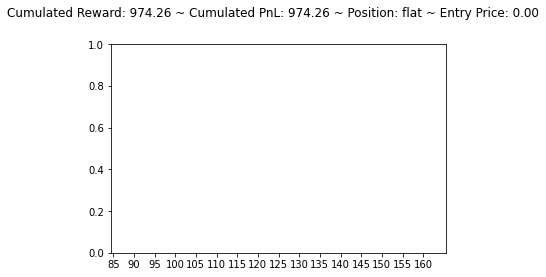

[ 896.2815   926.31824 1007.1118 ]
flat sell short


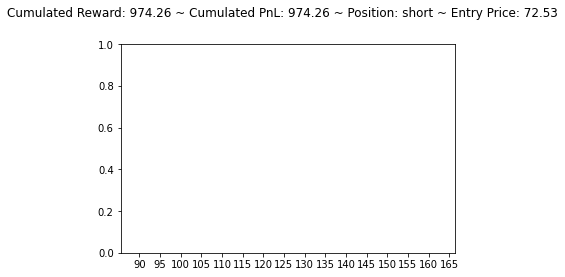

[ 993.2428  999.7211 1103.4365]
short buy flat


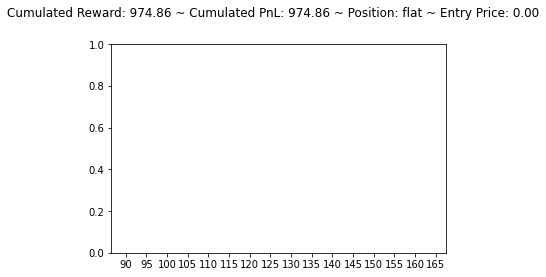

[1313.4729 1207.1782 1236.8665]
flat hold flat


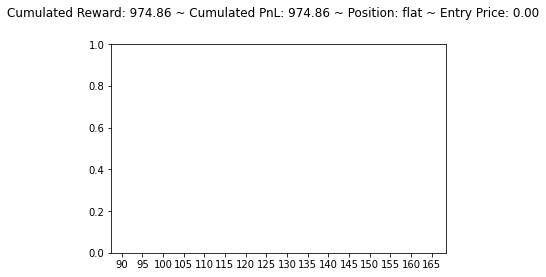

[1231.619  1239.6512 1297.1506]
flat sell short


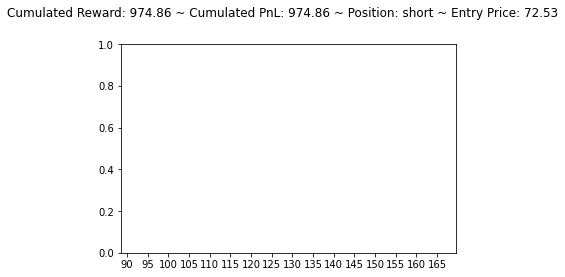

[1370.7919 1365.4674 1430.4302]
short hold short


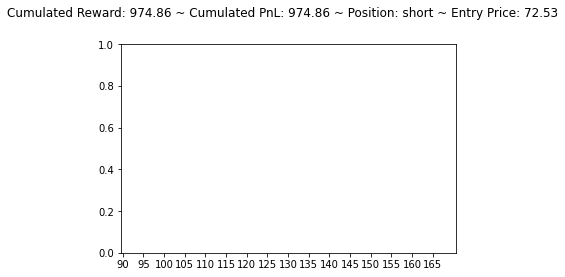

[1706.8839 1720.3322 1406.8743]
short buy flat


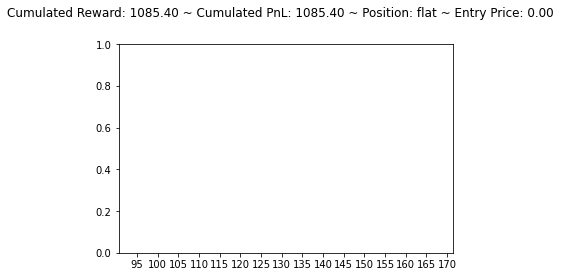

[1147.7996   949.9136   985.40234]
flat hold flat


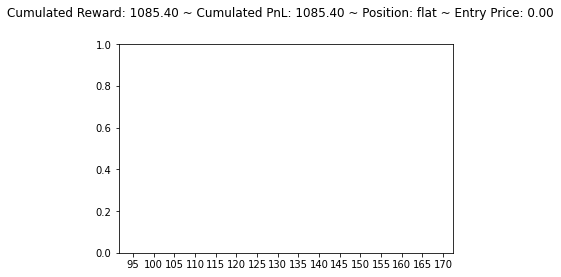

[871.19574 996.69324 931.17566]
flat buy long


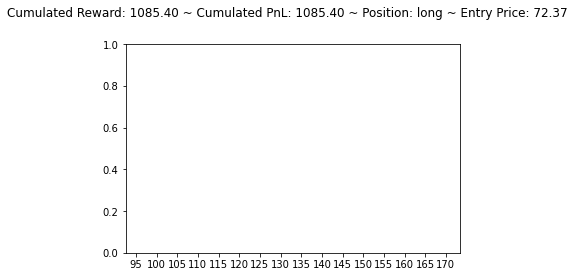

[833.83   802.2631 788.7732]
long hold long


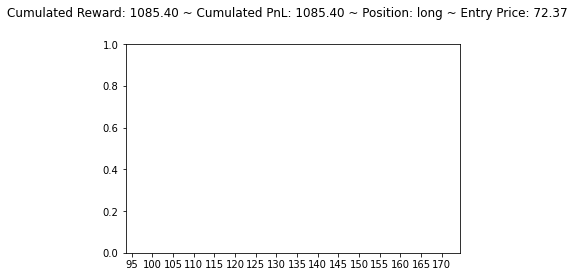

[659.60986 738.7938  765.87976]
long sell flat


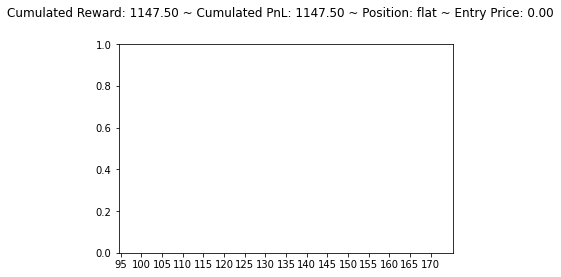

[701.035   714.98114 787.2963 ]
flat sell short


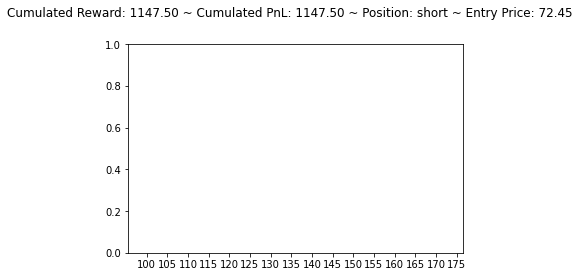

[928.46295 886.0768  877.35815]
short hold short


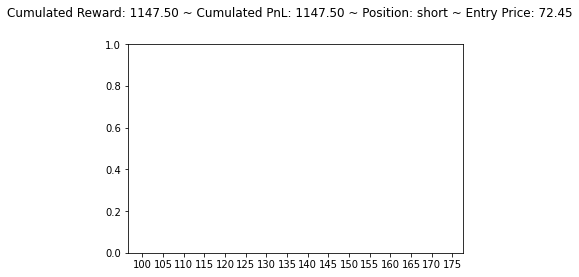

[1002.8119   953.6552   820.28766]
short hold short


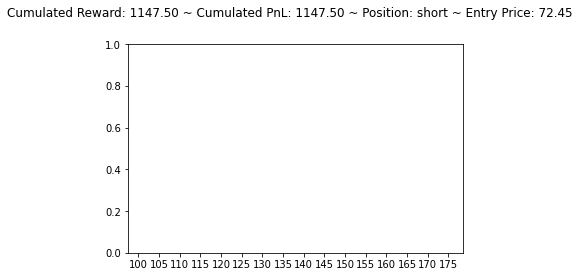

[1120.9049  1121.4636   984.49725]
short buy flat


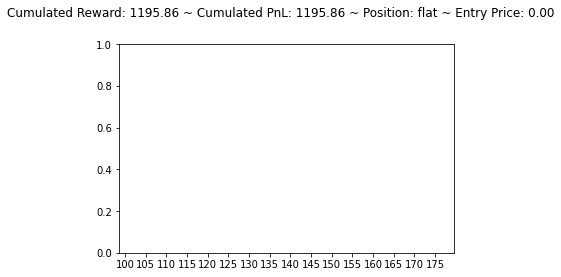

[964.8199  967.65533 912.85333]
flat buy long


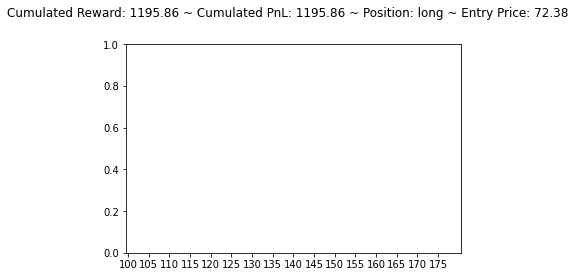

[1083.9819 1006.0112  925.8688]
long hold long


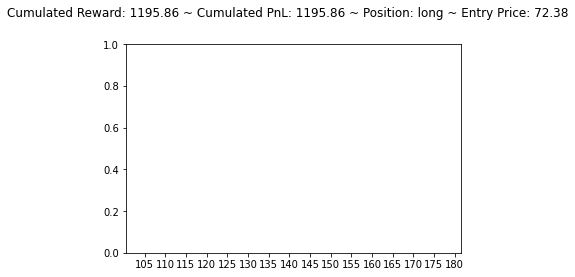

[1119.8699  1069.3287   962.24396]
long hold long


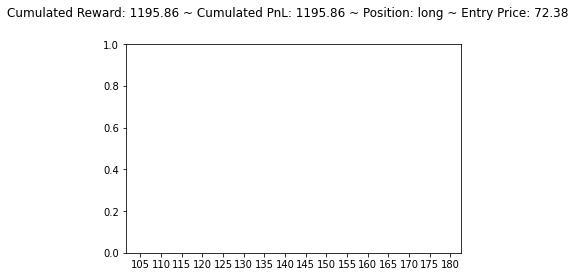

[767.0132  774.09015 603.3113 ]
long hold long


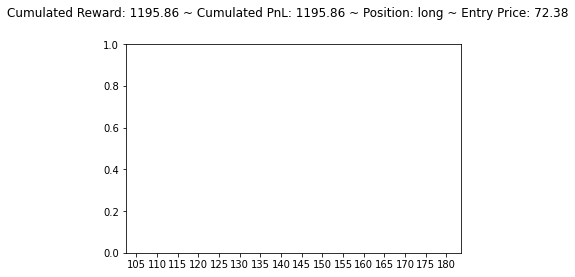

[485.0385  594.49023 701.09106]
long sell flat


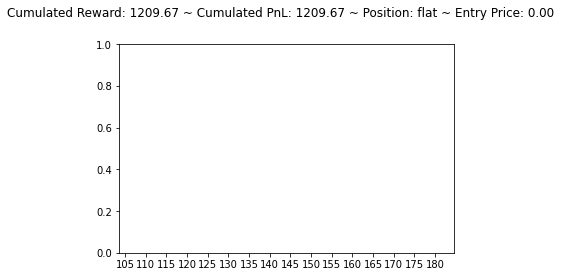

[ 955.9531 1551.3445 1058.839 ]
flat buy long


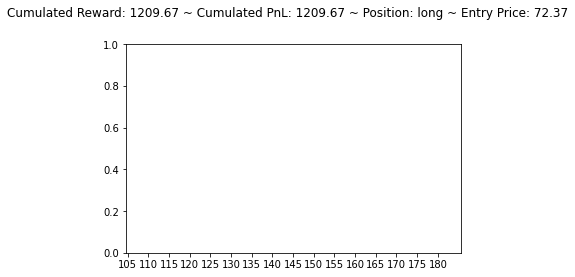

[1530.1156 1630.3861 1473.8345]
long hold long


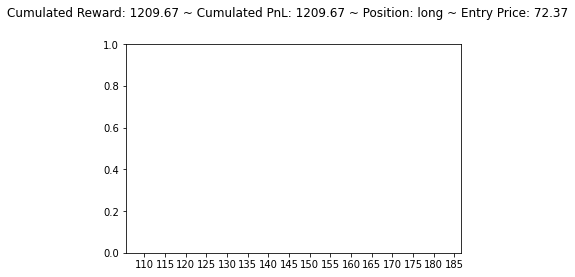

[1488.2174 1499.2758 1428.8599]
long hold long


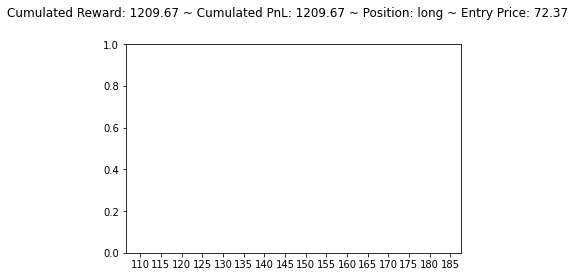

[1396.8679 1488.525  1264.1832]
long hold long


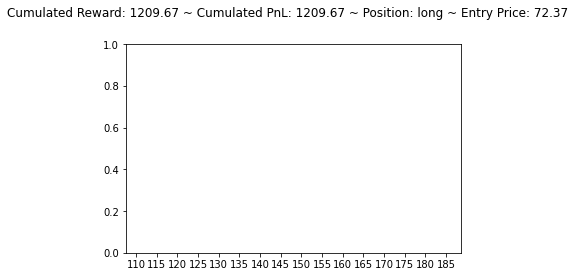

[1455.4879 1585.1277 1372.5347]
long hold long


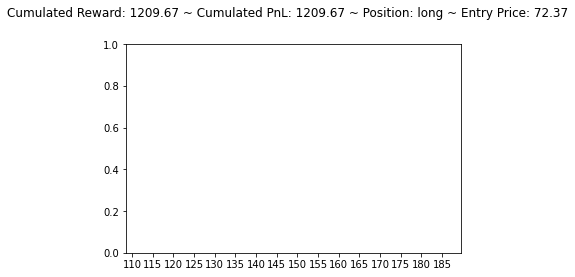

[1504.0061 1499.703  1350.9203]
long hold long


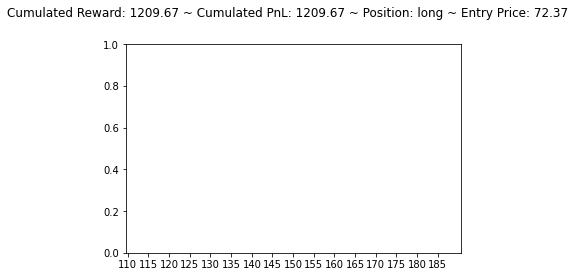

[1404.1078 1497.9125 1353.1794]
long hold long


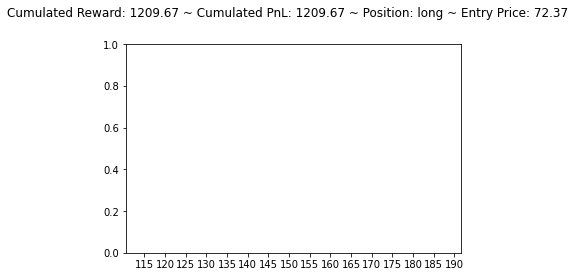

[903.95703 963.30914 774.84656]
long hold long


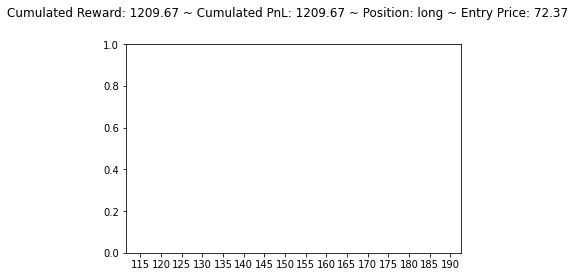

[1064.6447  961.5705  889.003 ]
long hold long


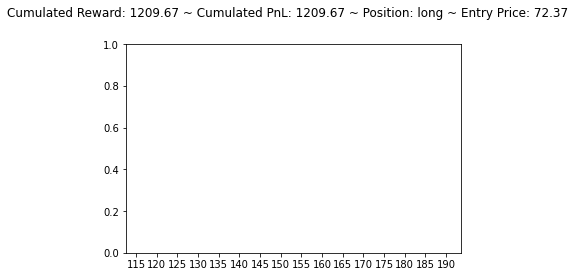

[736.68066 972.5598  803.11206]
long sell flat


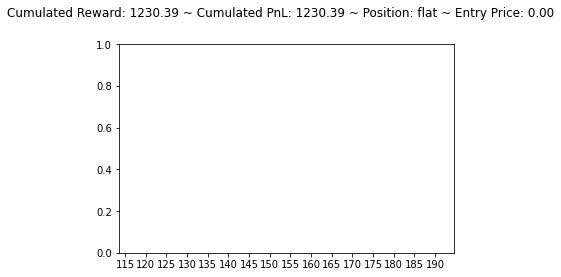

[609.10126 732.31287 753.1358 ]
flat sell short


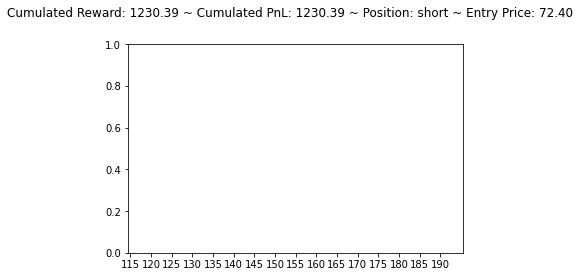

[832.66425 907.9466  821.5352 ]
short buy flat


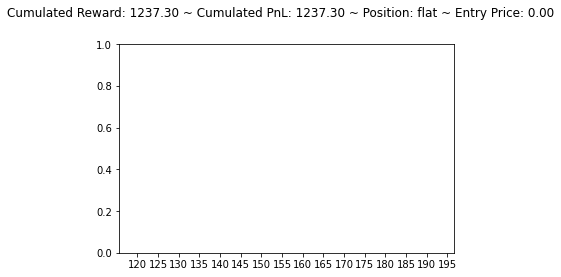

[831.064   850.48755 764.6876 ]
flat buy long


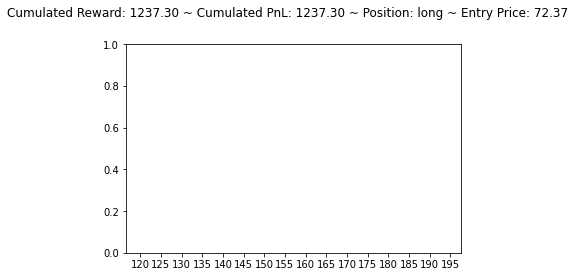

[ 981.45746 1100.4353   960.30414]
long hold long


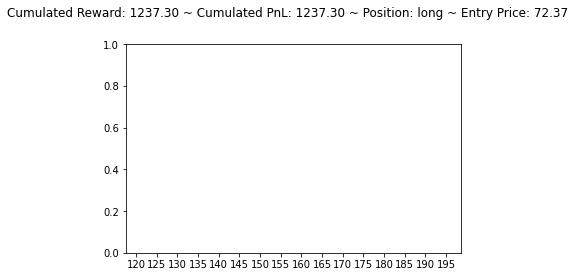

[1037.0414  1058.1062   980.14984]
long hold long


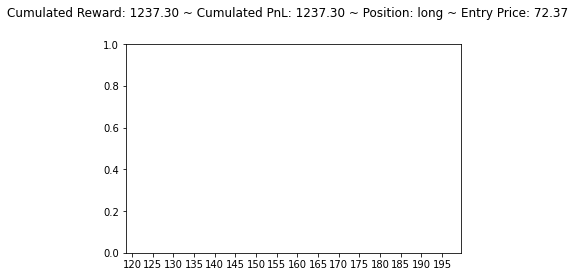

[ 994.40234 1037.9366   947.3833 ]
long hold long


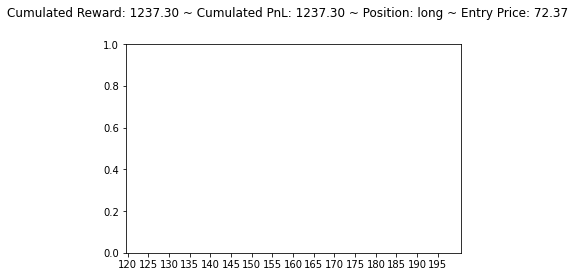

[953.7936 996.1026 871.0514]
long hold long


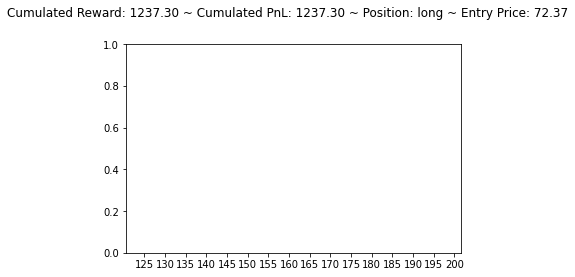

[1086.4907 1093.144  1021.0057]
long hold long


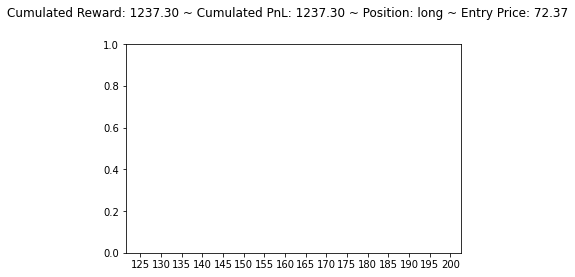

[1157.793  1192.0745 1077.5725]
long hold long


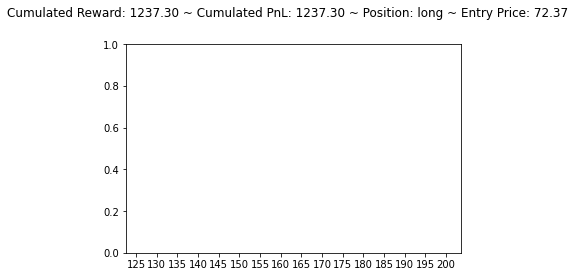

[1244.4417 1263.4636 1142.8145]
long hold long


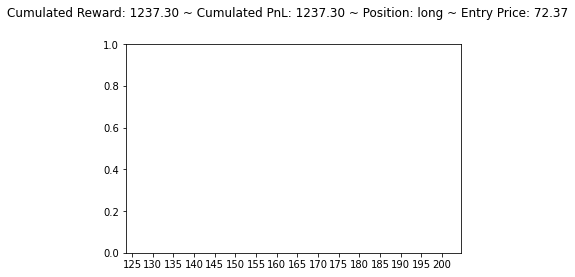

[1247.2468 1261.653  1136.2358]
long hold long


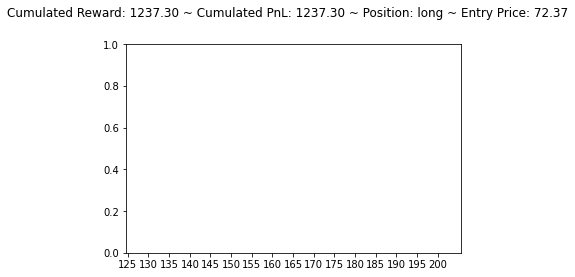

[1127.1095 1242.7714 1059.5323]
long hold long


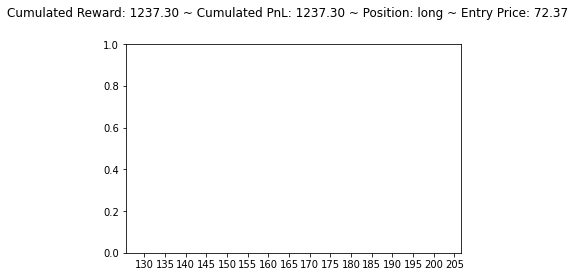

[1192.42   1214.3827 1105.7716]
long hold long


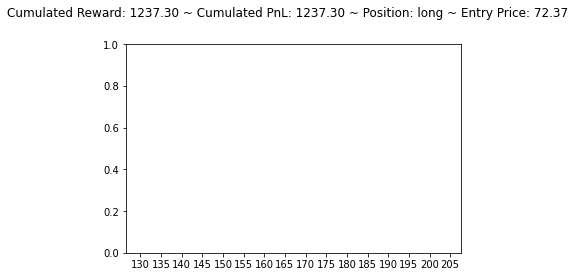

[1191.6534 1194.0739 1085.5703]
long hold long


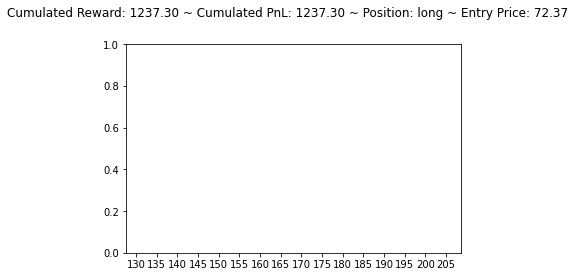

[1268.7324 1361.6927 1175.0154]
long hold long


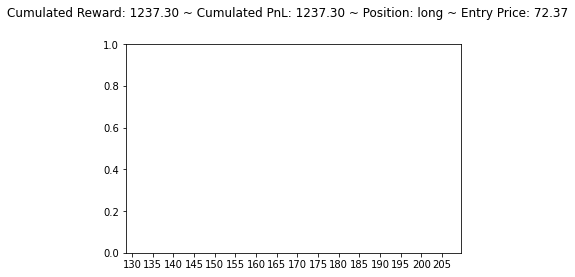

[1055.7618 1115.3639 1117.6509]
long sell flat


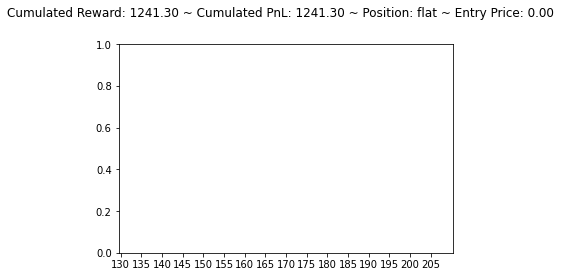

[1010.83234 1020.27515  934.7111 ]
flat buy long


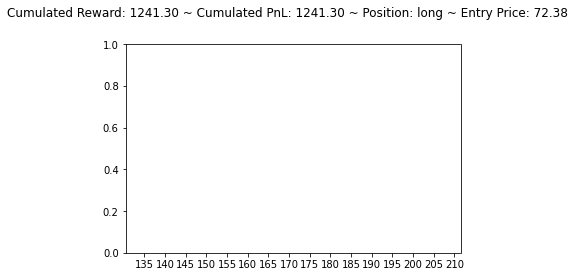

[1171.2346 1200.0496 1067.892 ]
long hold long


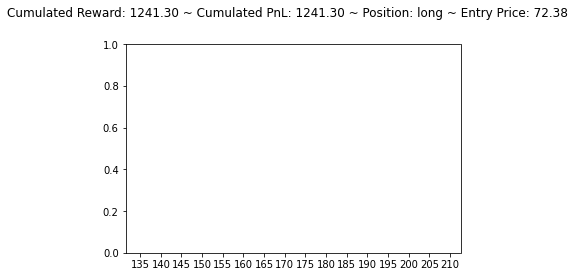

[1097.8766 1126.4779 1035.7035]
long hold long


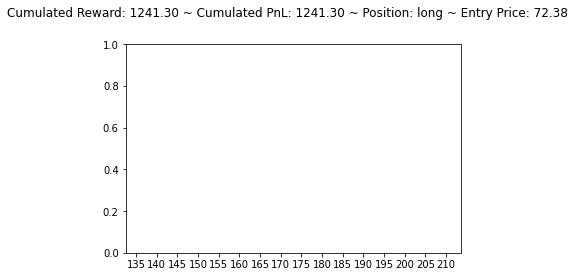

[1311.6863 1271.223  1270.7314]
long hold long


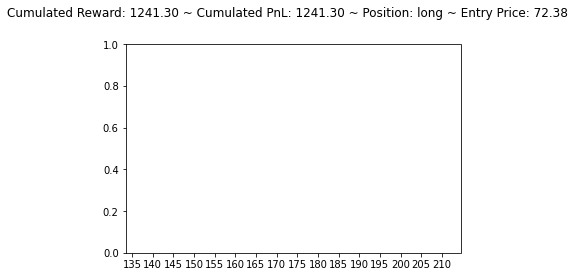

[1098.1913 1057.7572 1053.061 ]
long hold long


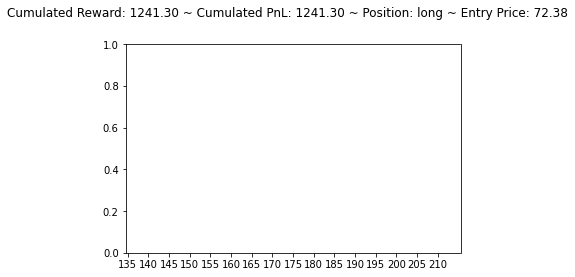

[1143.5322 1358.1492 1152.204 ]
long sell flat


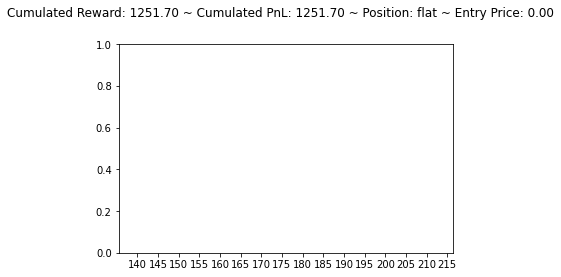

[1038.6088 1065.6312  966.147 ]
flat buy long


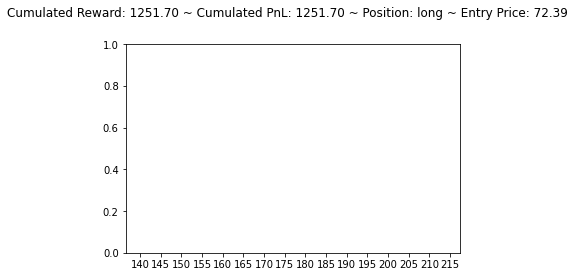

[1230.3557 1237.1005 1122.1965]
long hold long


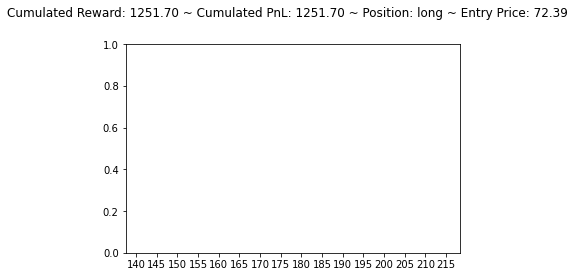

[1055.1945   895.48364  296.39243]
long hold long


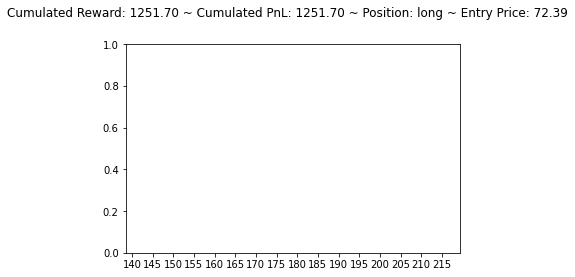

[851.8029  780.38184 672.0543 ]
long hold long


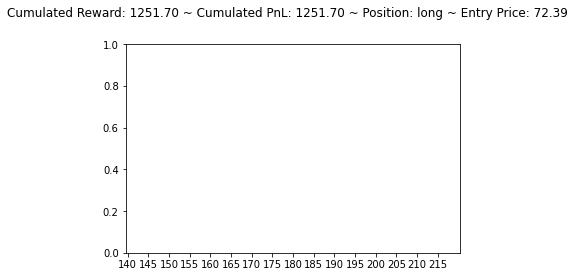

[771.23663 562.9949  529.6866 ]
long hold long


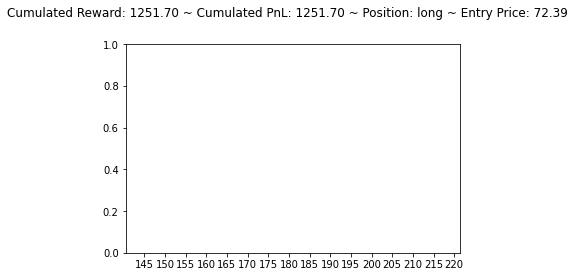

[560.54706 618.2132  724.48706]
long sell flat


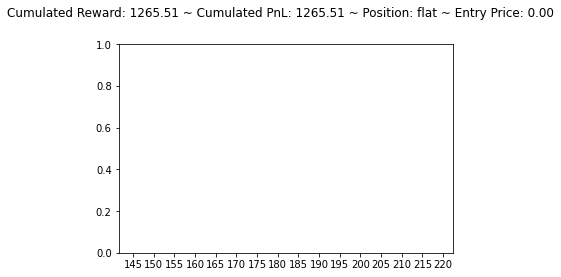

[336.34415 722.62427 809.88477]
flat sell short


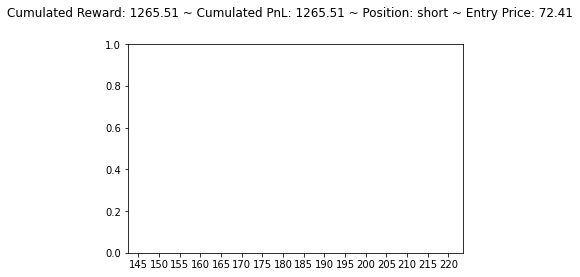

[454.78836 836.7765  913.59125]
short buy flat


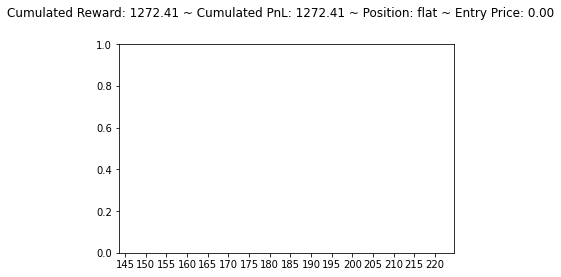

[401.62375 757.6217  849.93353]
flat sell short


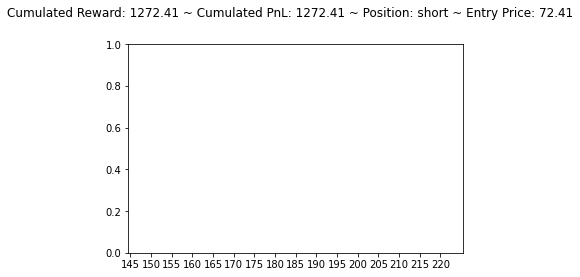

[481.513  694.7526 808.6937]
short buy flat


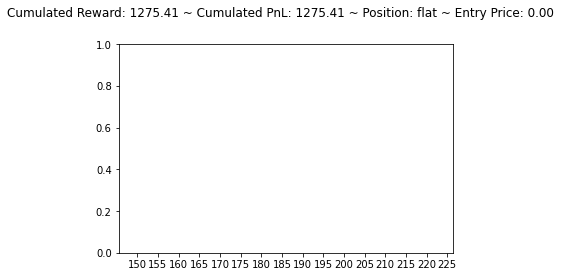

[677.2866  704.8449  807.28033]
flat sell short


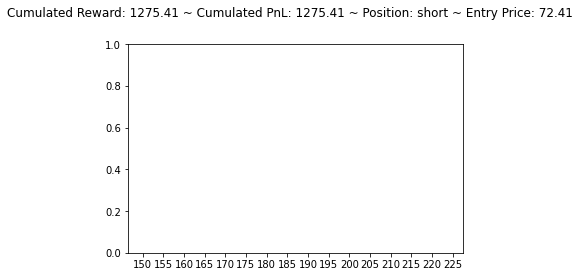

[749.43225 763.9404  882.5282 ]
short buy flat


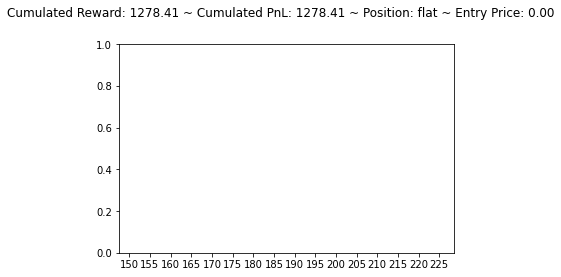

[675.17017 702.1946  806.82996]
flat sell short


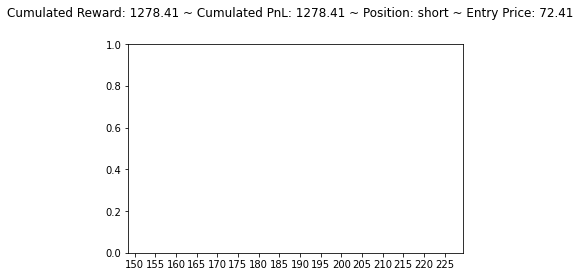

[743.2121  757.19073 877.08417]
short buy flat


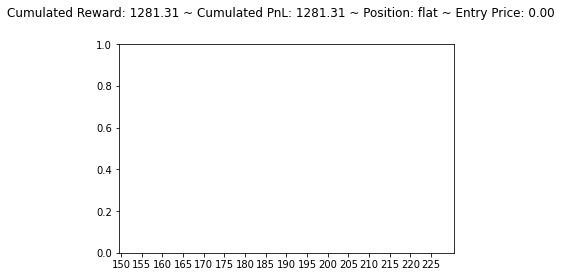

[961.16364 414.5659  856.59503]
flat hold flat


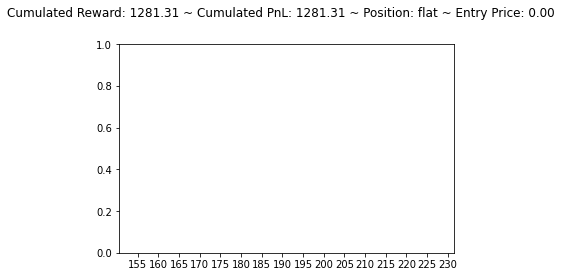

[1159.5328 1197.795  1108.4625]
flat buy long


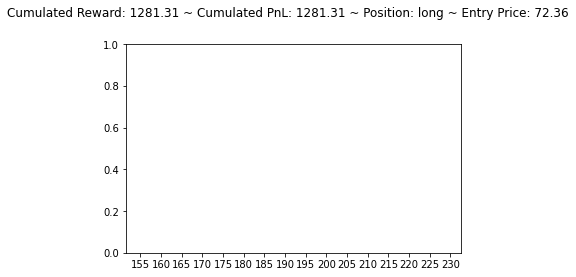

[1081.907  1247.4069 1086.9602]
long sell flat


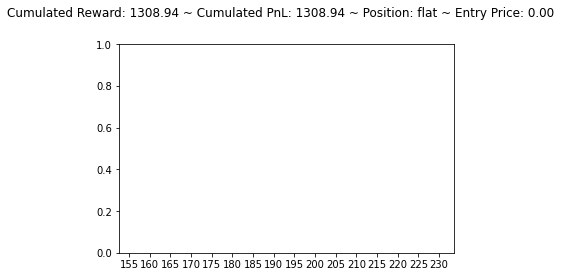

[841.0798  893.75275 833.512  ]
flat buy long


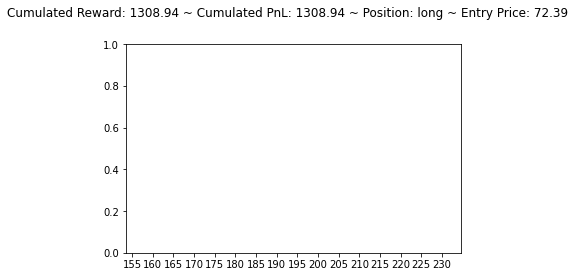

[ 914.74994 1014.9784   809.69653]
long hold long


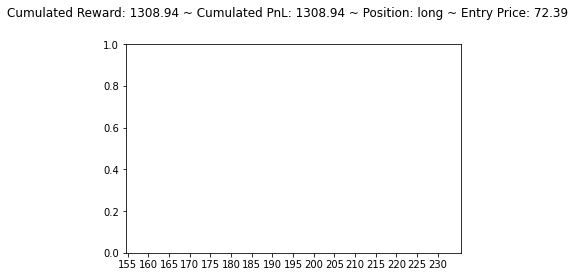

[ 975.44354 1107.5465   988.1553 ]
long sell flat


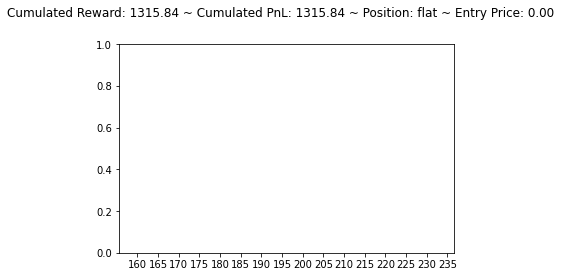

[864.15454 878.0556  772.8284 ]
flat buy long


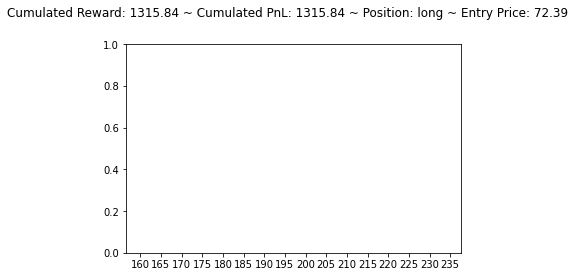

[1032.3572 1014.55    921.117 ]
long hold long


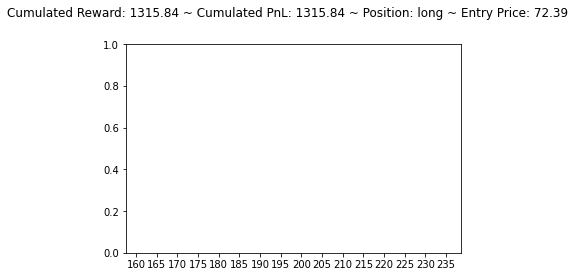

[783.04877 803.69836 585.0419 ]
long hold long


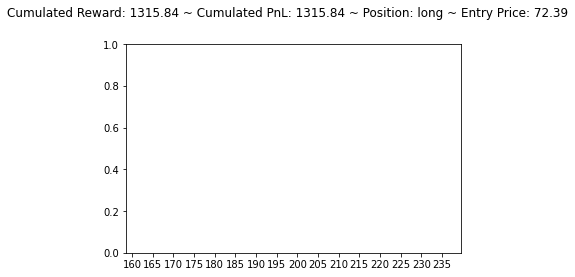

[631.21   667.3668 782.2213]
long sell flat


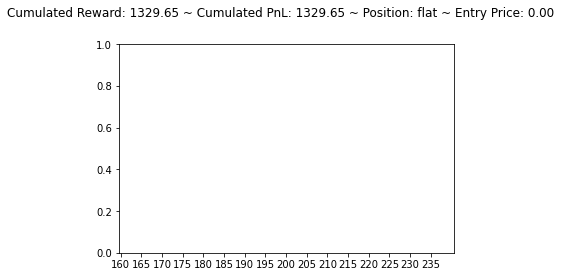

[512.4257 941.9486 536.772 ]
flat buy long


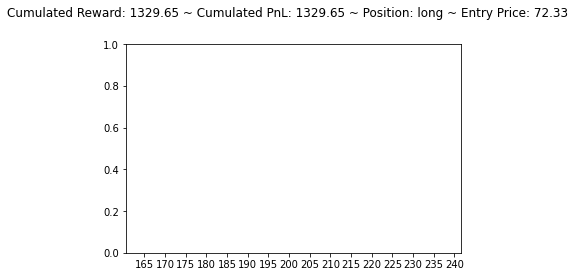

[923.8597  741.0372  482.99045]
long hold long


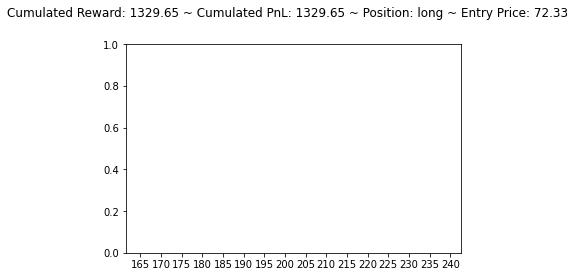

[396.52463 803.28815 817.8119 ]
long sell flat


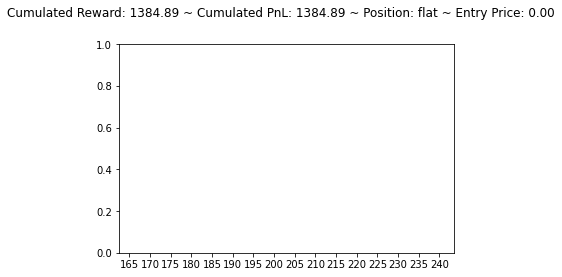

[341.04092 703.87213 753.52356]
flat sell short


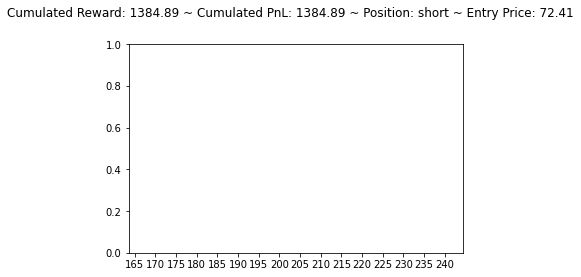

[426.40945 819.2548  843.60297]
short buy flat


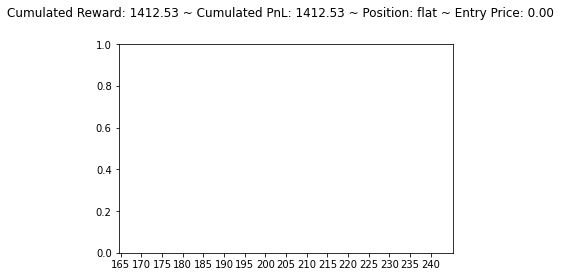

[347.74503 710.60614 765.6423 ]
flat sell short


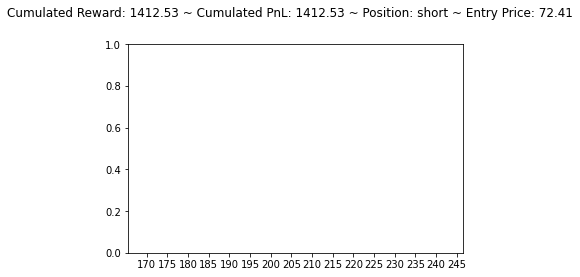

[510.0125 848.3333 860.667 ]
short buy flat


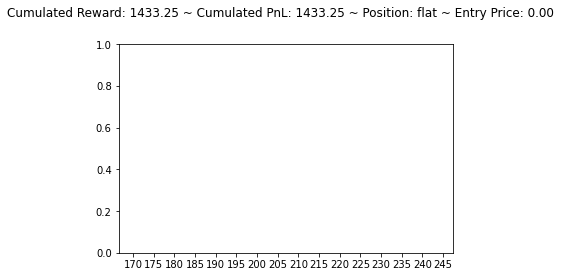

[ 858.1777  1211.7272  1003.54456]
flat buy long


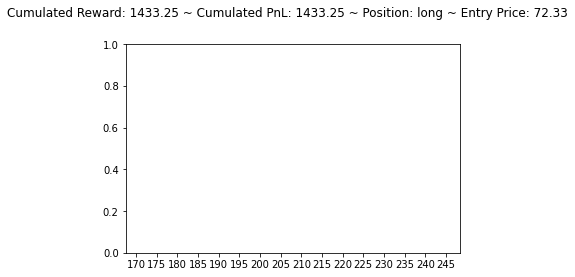

[1064.2789  1138.2369   798.85864]
long hold long


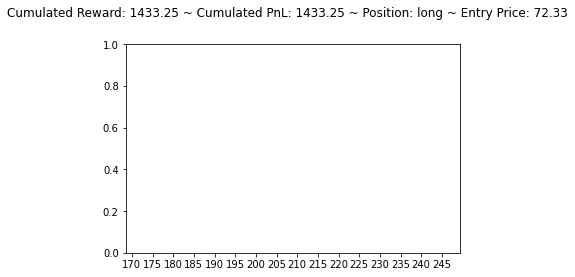

[1085.6771 1387.8434 1162.735 ]
long sell flat


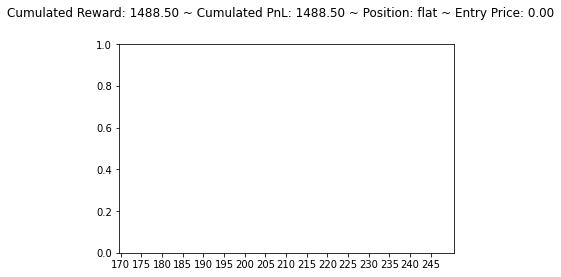

[ 980.50275 1050.5504   736.89624]
flat buy long


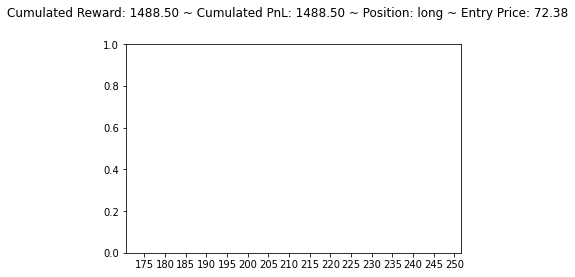

[694.70886 943.5372  891.3394 ]
long sell flat


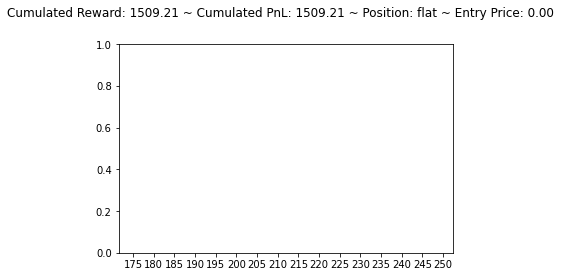

[656.911   832.5894  791.03046]
flat buy long


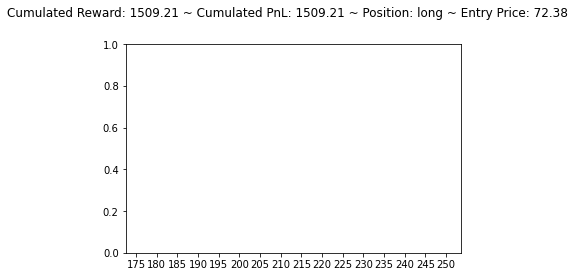

[719.49725 955.2471  838.166  ]
long sell flat


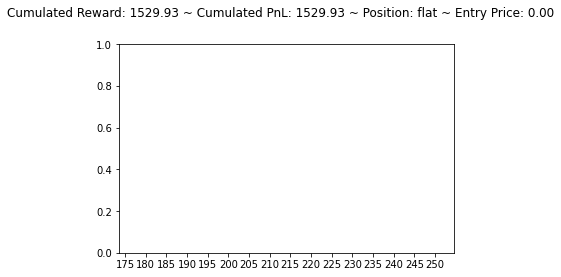

[735.58075 800.8244  714.11096]
flat buy long


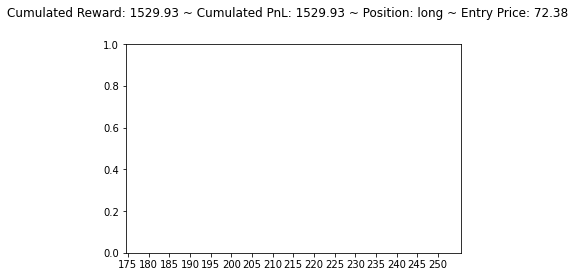

[1305.1931 1542.2574 1221.8036]
long hold long


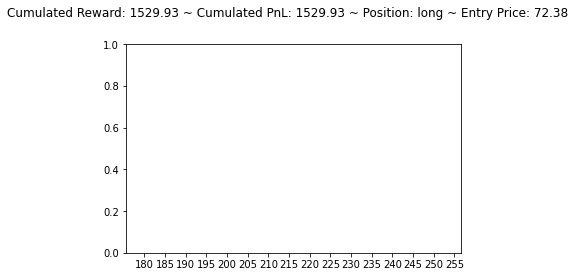

[1031.9567  1133.0072  1018.12024]
long hold long


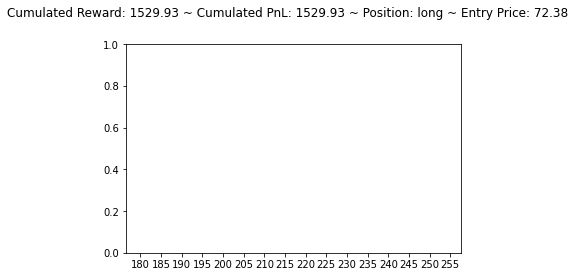

[1045.5408 1107.4845 1037.5272]
long hold long


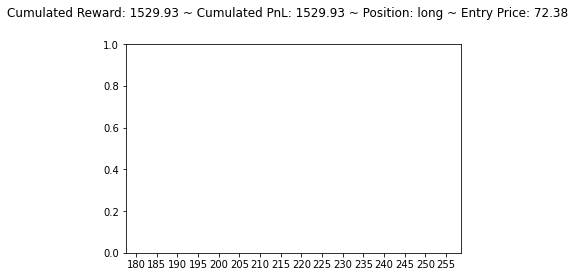

[ 974.8177 1033.1879  908.6931]
long hold long


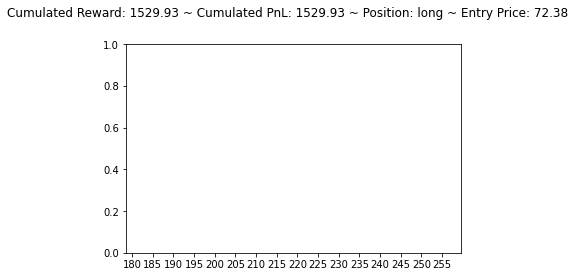

[946.8068  978.67224 914.37634]
long hold long


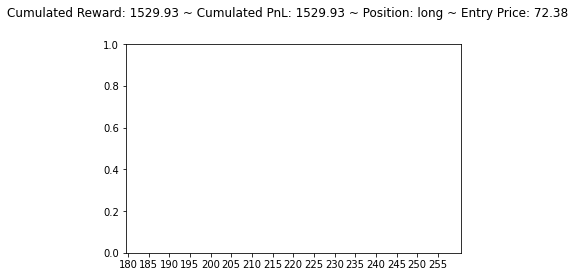

[1037.2994  1001.24146  800.86804]
long hold long


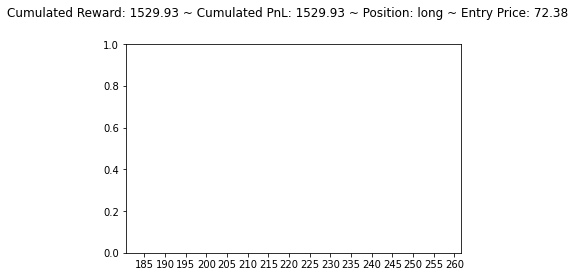

[ 989.4979  1046.4819   928.25165]
long hold long


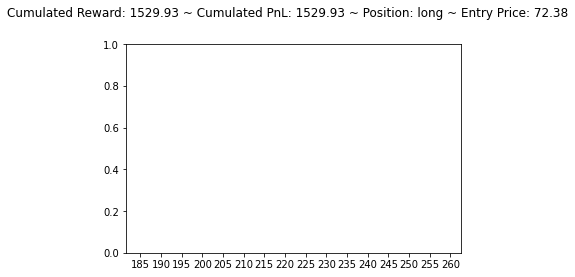

[996.6798  949.8304  967.57947]
long hold long


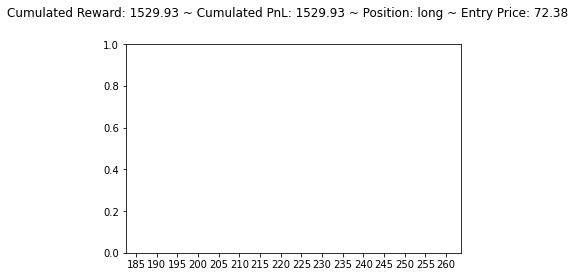

[1000.41925  975.93005  782.387  ]
long hold long


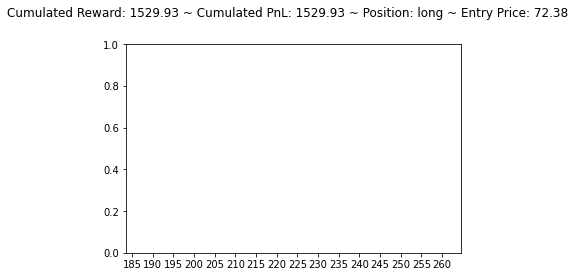

[1131.1648 1176.8151 1042.8633]
long hold long


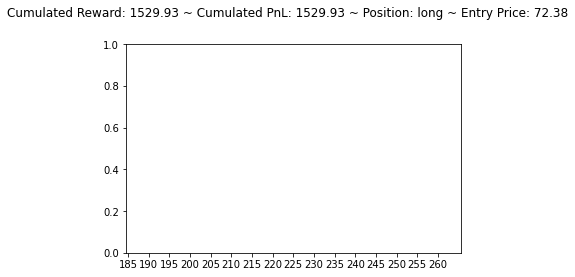

[1135.8047 1193.1202 1070.5149]
long hold long


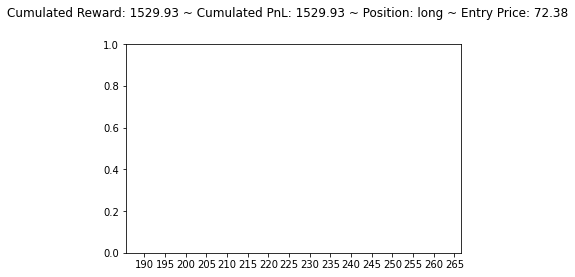

[1102.4199 1159.4724 1042.624 ]
long hold long


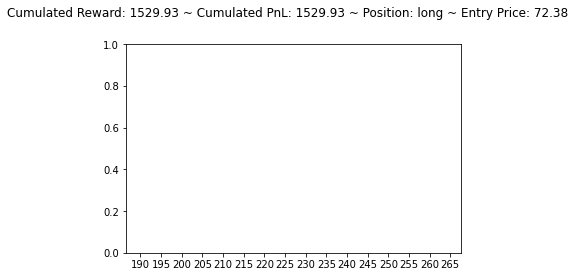

[1018.09174 1070.5267   954.1193 ]
long hold long


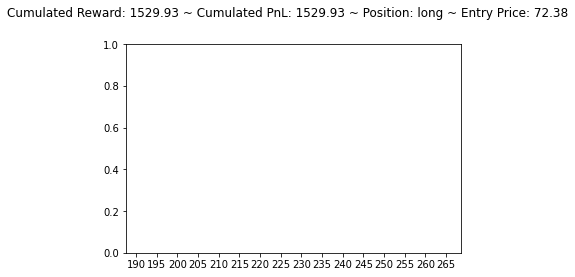

[1002.75446  929.4623   924.94507]
long hold long


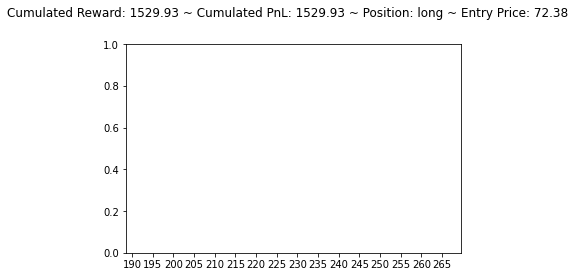

[852.2702  775.09357 742.5884 ]
long hold long


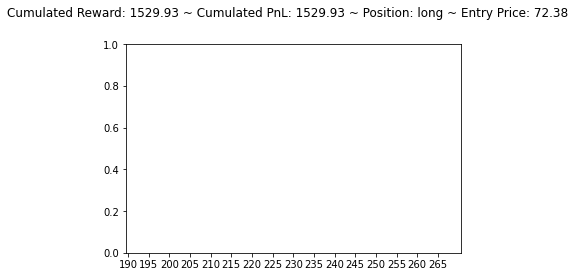

[738.47205 757.11523 875.5462 ]
long sell flat


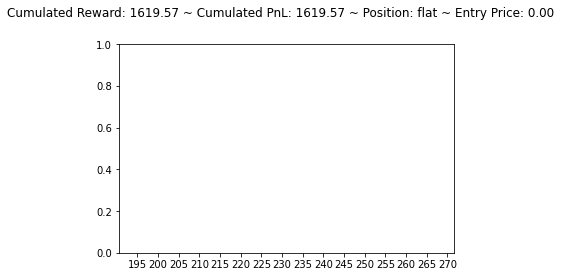

[584.1734 555.8011 777.2618]
flat sell short


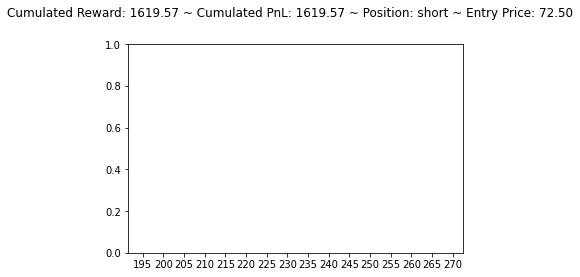

[689.32245 586.5827  678.0492 ]
short hold short


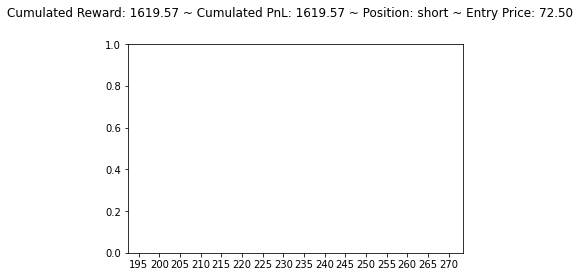

[567.9701  613.71515 711.7837 ]
short buy flat


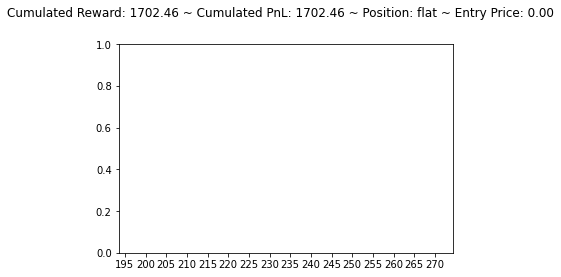

[671.5916  949.1969  759.98157]
flat buy long


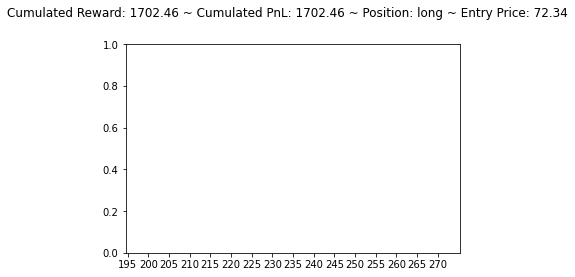

[776.20404 911.53625 705.82135]
long hold long


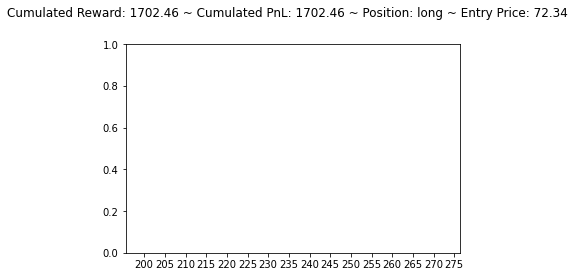

[ 975.6109 1014.579   862.0088]
long hold long


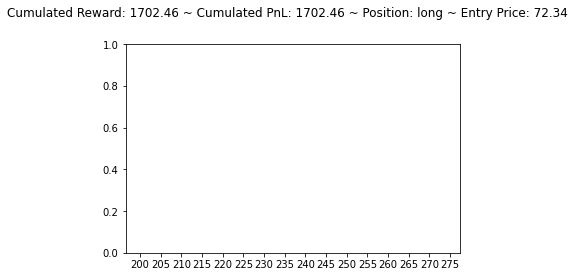

[761.7739  571.8411  922.03906]
long sell flat


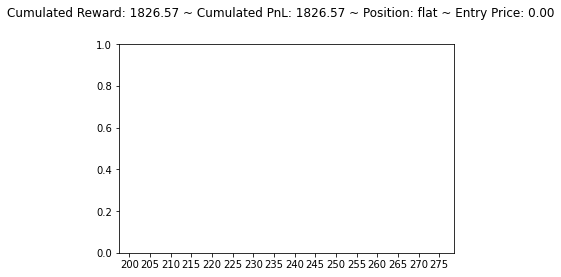

[670.24835 947.3054  758.4132 ]
flat buy long


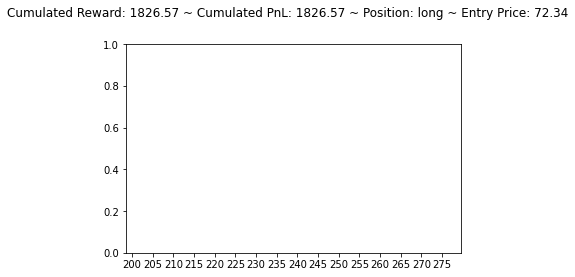

[756.1298 860.4459 674.6796]
long hold long


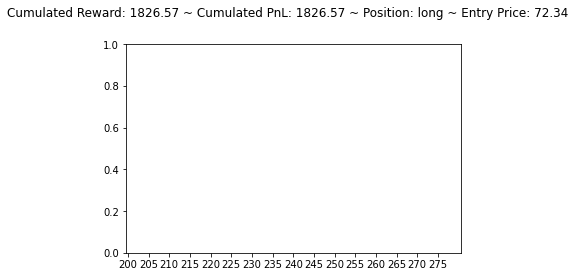

[587.85736 697.592   751.5419 ]
long sell flat


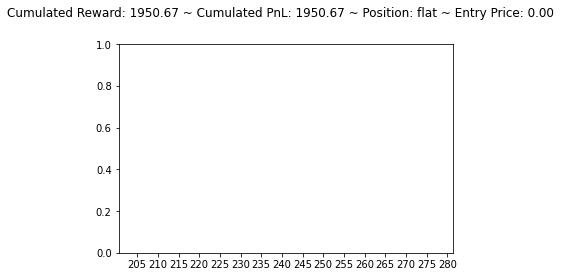

[437.52872 530.6721  640.84406]
flat sell short


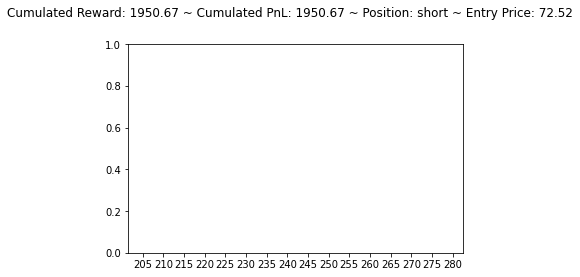

[566.42706 605.0759  709.19653]
short buy flat


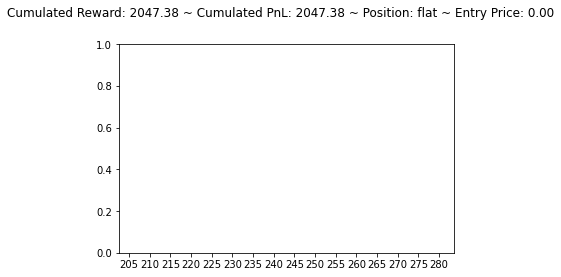

[457.8703  601.1508  665.22546]
flat sell short


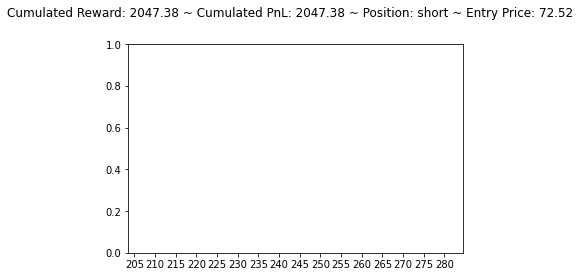

[781.86255 824.7341  834.97406]
short buy flat


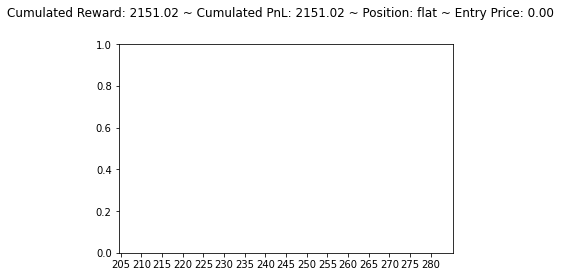

[804.34796 874.9453  781.63055]
flat buy long


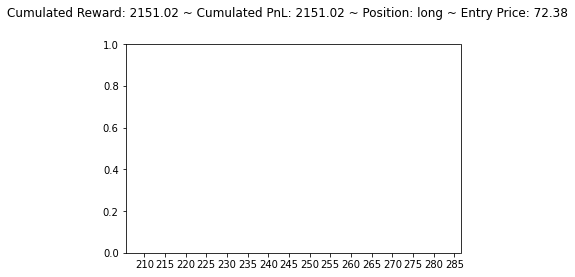

[697.3116 802.9663 646.0099]
long hold long


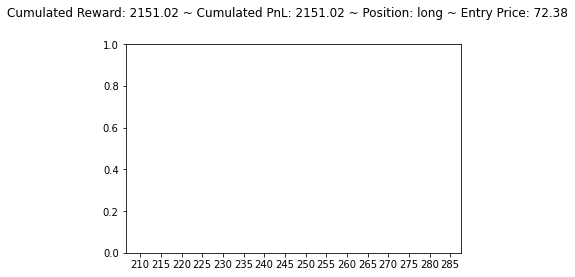

[573.2435 517.9666 705.0676]
long sell flat


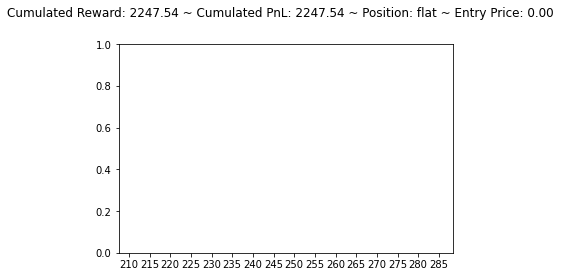

[970.059   952.04767 874.5958 ]
flat hold flat


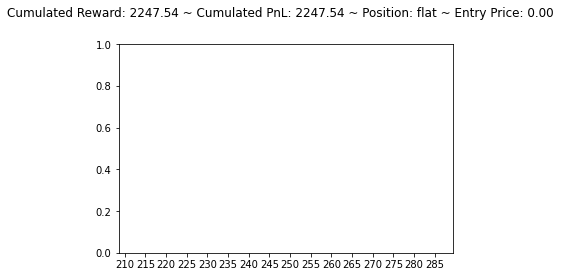

[838.8458  780.91174 827.6871 ]
flat hold flat


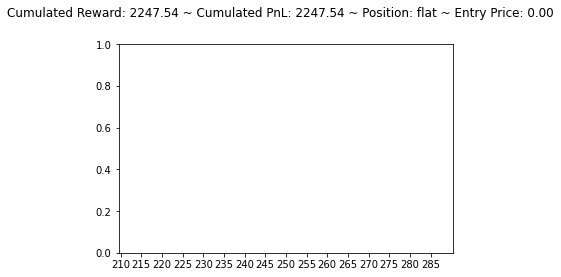

[ 987.5415  1158.3851   990.23016]
flat buy long


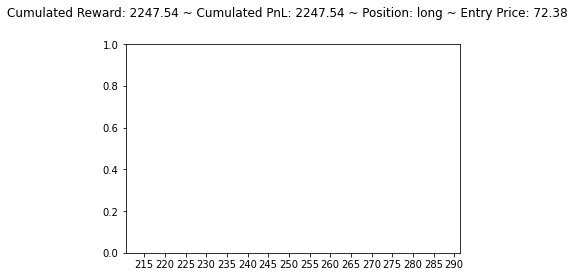

[ 980.0854 1097.6439  984.3784]
long sell flat


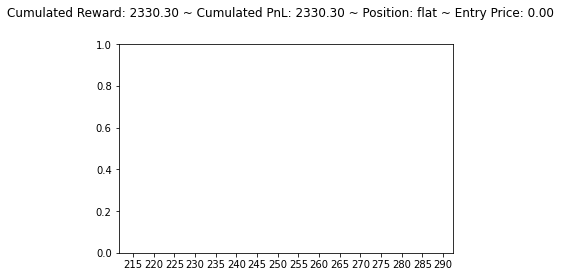

[908.6401  985.3795  932.15344]
flat buy long


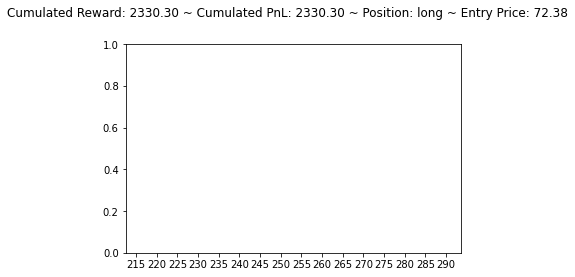

[1251.1749 1285.9299 1158.4788]
long hold long


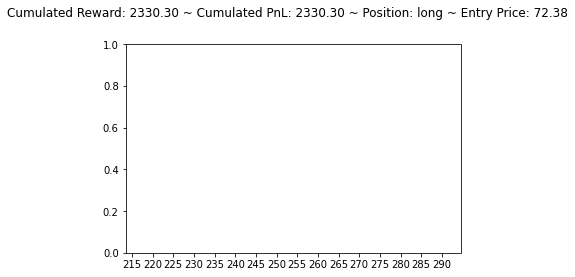

[ 936.5402 1143.9938  948.1219]
long sell flat


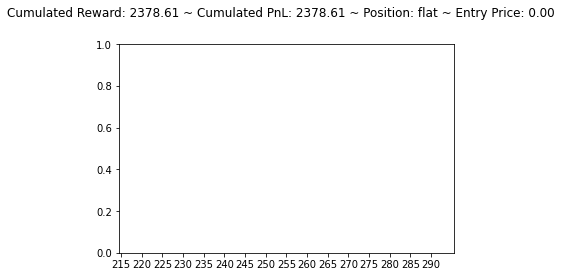

[ 977.6462 1035.148   926.7507]
flat buy long


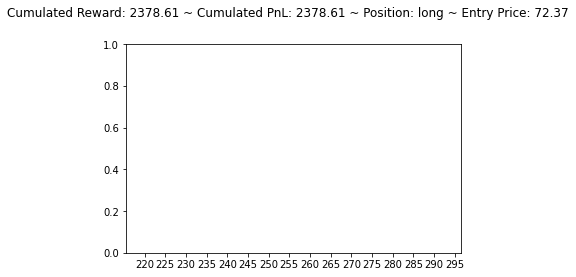

[ 983.3931 1059.8872  982.8041]
long hold long


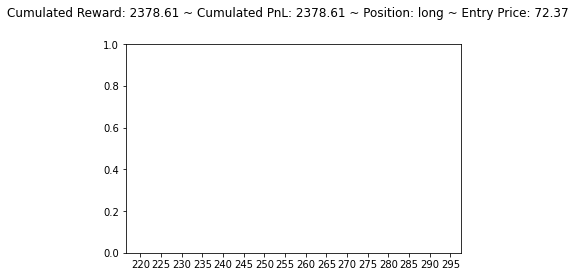

[1108.2788  1131.7317   990.46313]
long hold long


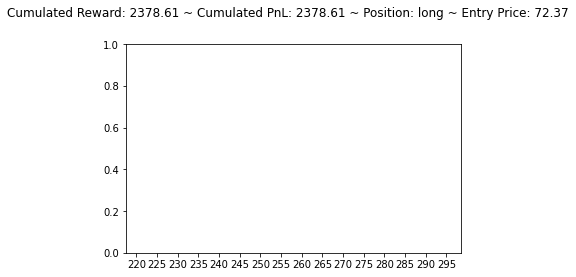

[1049.4019 1098.3052  961.6536]
long hold long


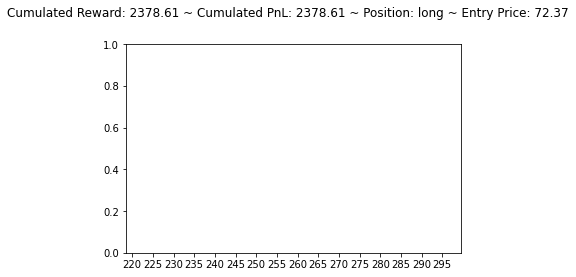

[1069.0413  1008.67224  937.43304]
long hold long


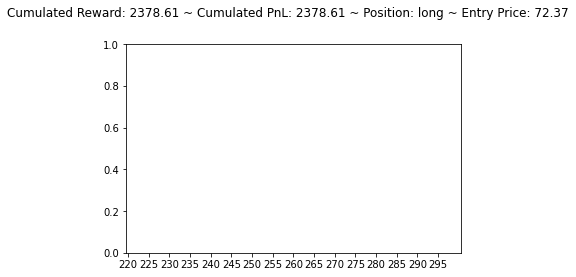

[1132.0234 1049.197   992.5904]
long hold long


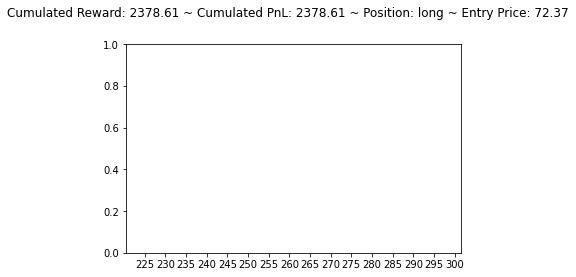

[1137.0657  1086.9485   955.90686]
long hold long


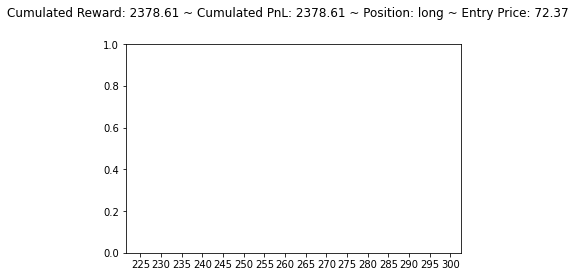

[ 919.2097 1094.2677  988.8745]
long sell flat


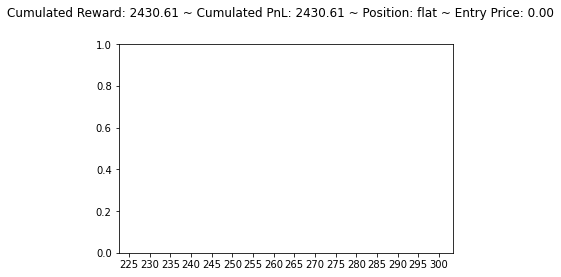

[809.9197 911.747  845.338 ]
flat buy long


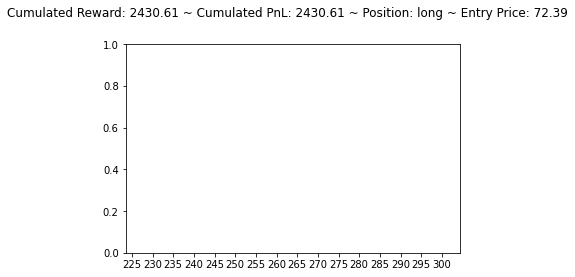

[1010.36743  944.5126   922.2672 ]
long hold long


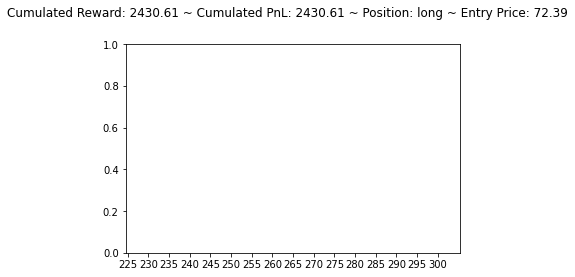

[839.7582  801.4124  664.76843]
long hold long


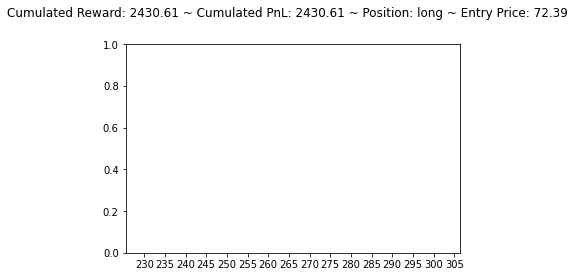

[782.99066 806.0747  825.7827 ]
long sell flat


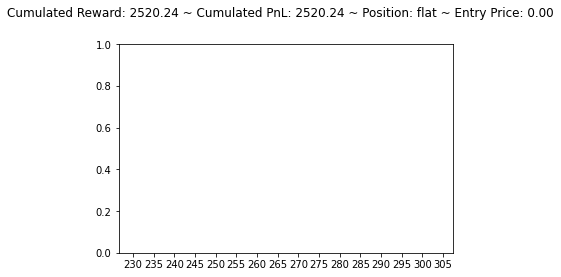

[460.29324 773.9801  722.2124 ]
flat buy long


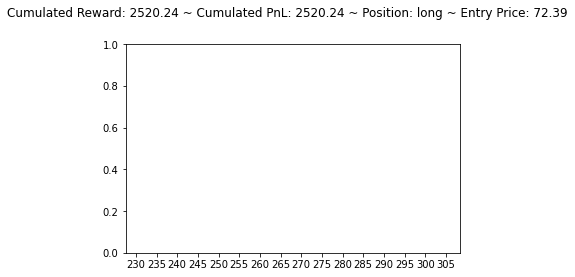

[573.8811  703.2087  800.27295]
long sell flat


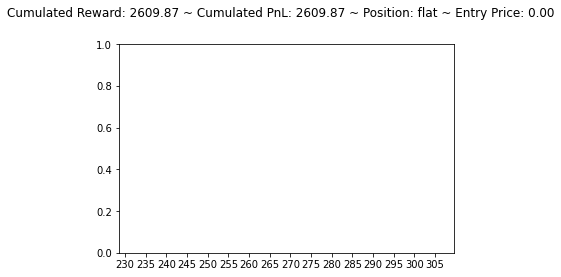

[507.88187 593.65314 664.1969 ]
flat sell short


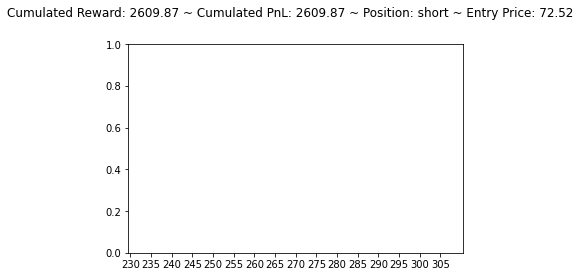

[943.86365 985.96594 822.1101 ]
short buy flat


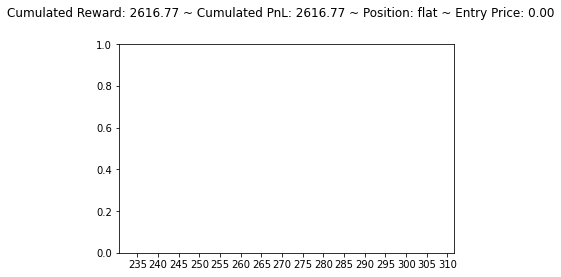

[821.6263  911.9177  936.43896]
flat sell short


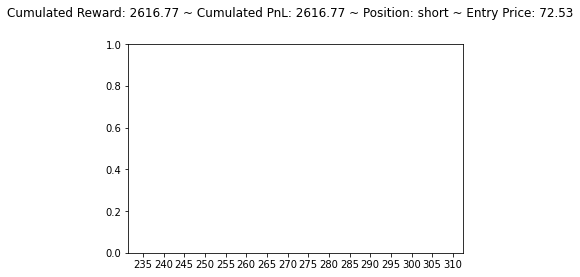

[859.8842 952.7151 961.6064]
short buy flat


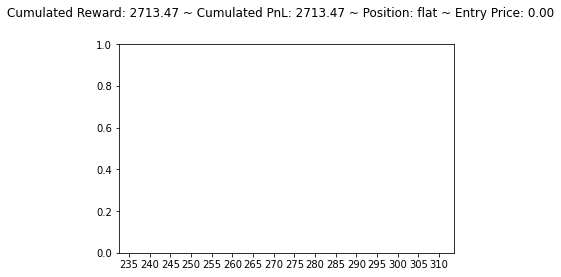

[887.46906 547.6223  838.14105]
flat hold flat


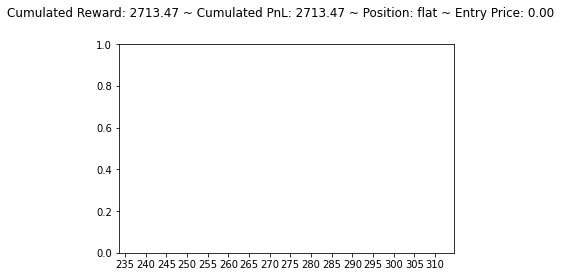

[616.50116 808.3055  705.1921 ]
flat buy long


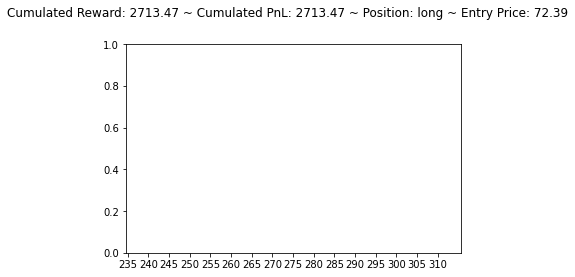

[854.0611  908.0507  785.34985]
long hold long


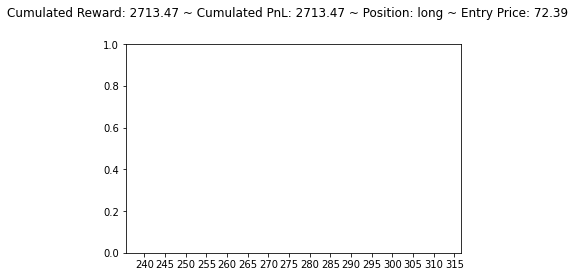

[878.6085  939.98596 798.354  ]
long hold long


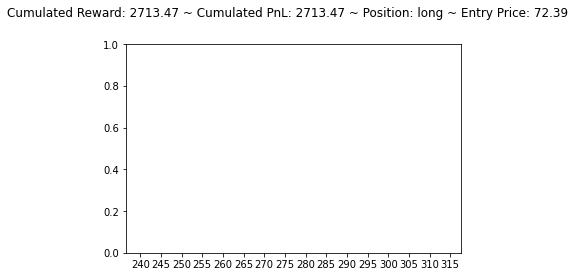

[804.5834 942.7036 811.5598]
long sell flat


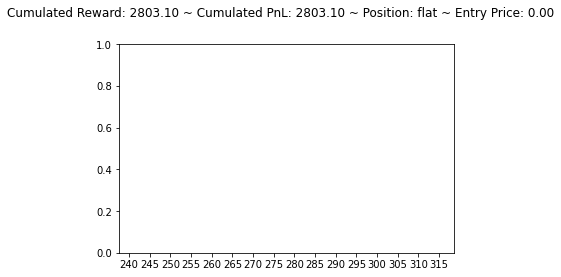

[651.597   780.5194  708.55707]
flat buy long


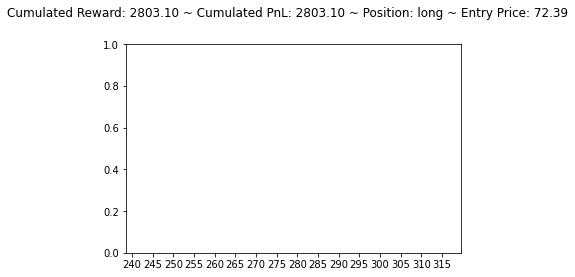

[896.14124 921.05945 788.3578 ]
long hold long


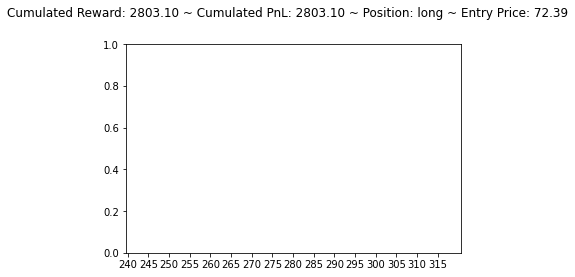

[722.3319  805.1841  599.51013]
long hold long


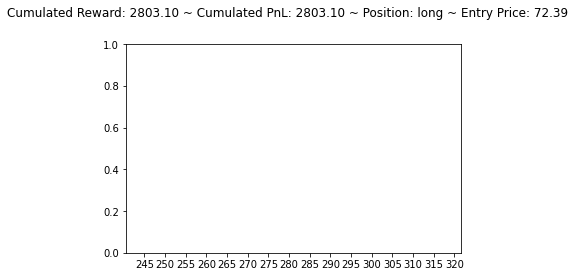

[641.4094 733.7844 794.4131]
long sell flat


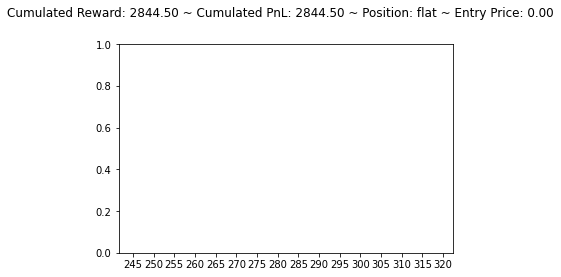

[657.5525  404.10336 768.42615]
flat sell short


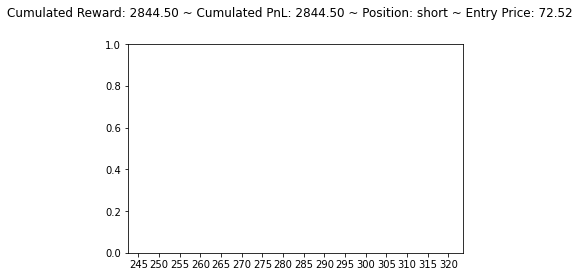

[785.86035 825.9733  825.1924 ]
short buy flat


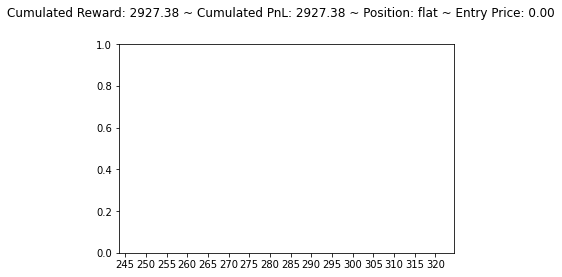

[781.41583 760.5034  799.69147]
flat sell short


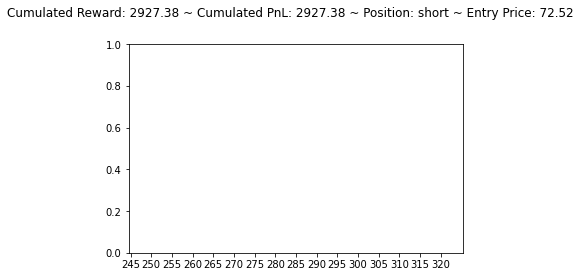

[786.40814 807.3206  731.8404 ]
short buy flat


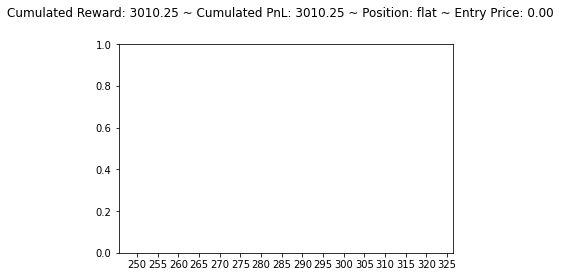

[790.8165  691.62213 837.3875 ]
flat sell short


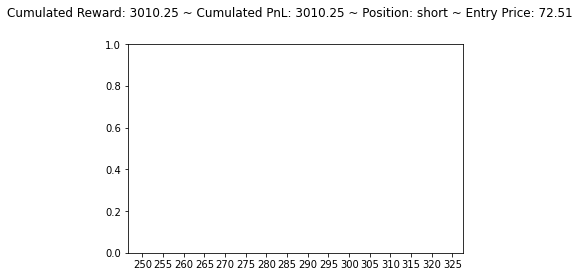

[881.90045 919.8535  747.80176]
short buy flat


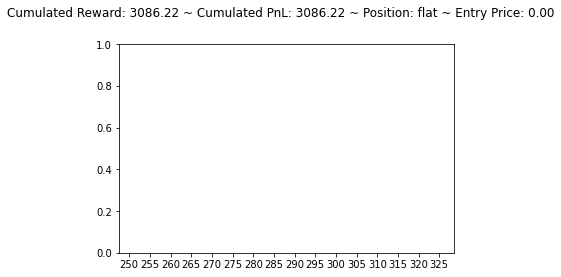

[834.3953  899.11694 950.905  ]
flat sell short


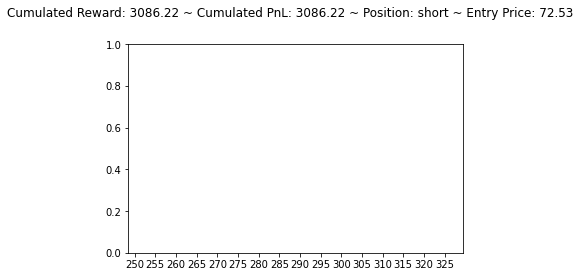

[ 895.07733  949.72034 1009.943  ]
short buy flat


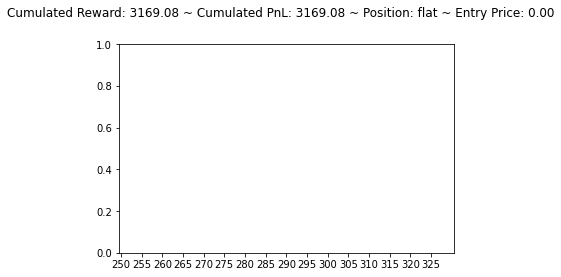

[828.4754 893.837  955.1987]
flat sell short


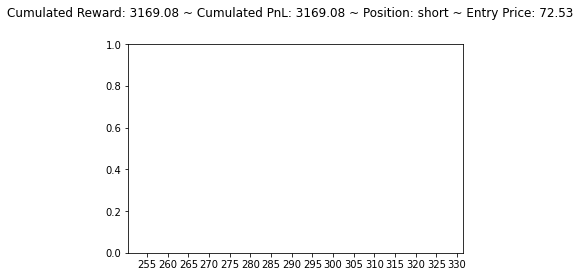

[889.83636 942.2999  984.34375]
short buy flat


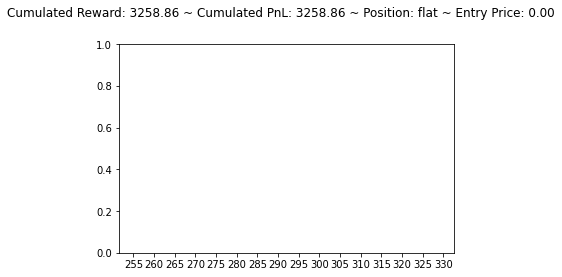

[878.1221  970.07324 992.91785]
flat sell short


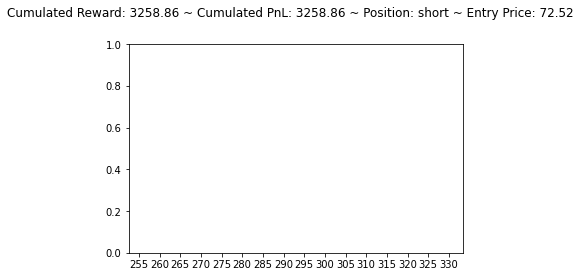

[895.092  974.4898 977.1108]
short buy flat


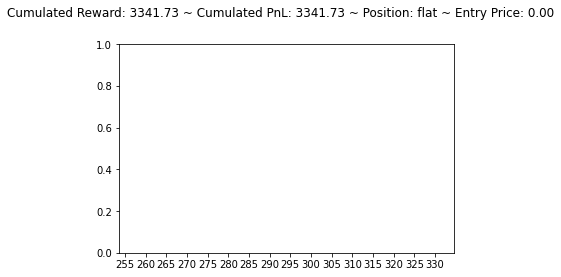

[799.777   933.80975 963.16406]
flat sell short


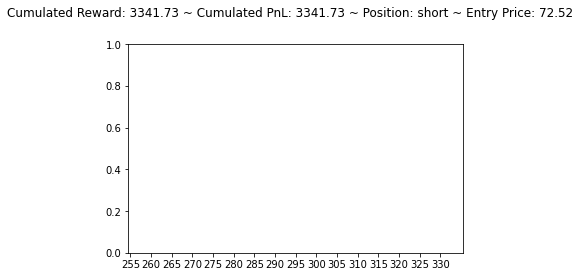

[843.0815 905.7244 972.8037]
short buy flat


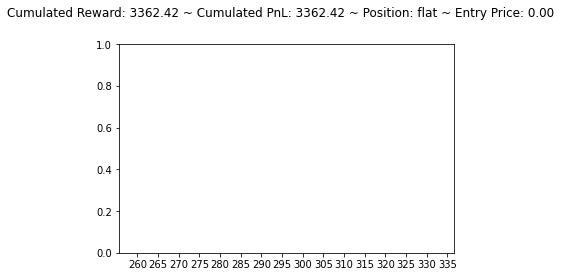

[567.799   488.42233 801.97   ]
flat sell short


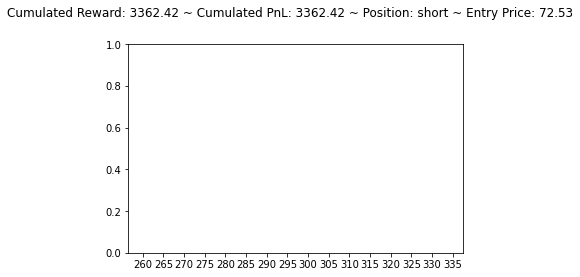

[651.8621  721.2846  797.49316]
short buy flat


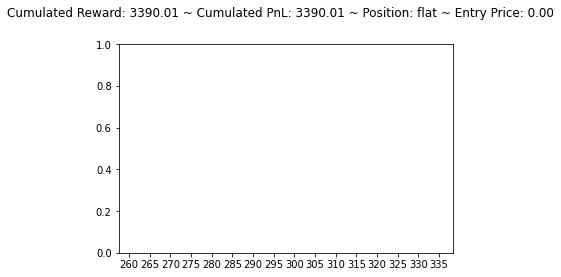

[590.28723 669.9458  742.23413]
flat sell short


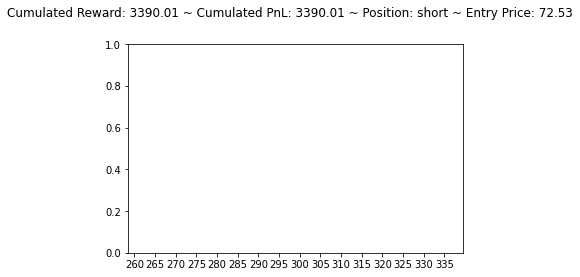

[674.034  733.1345 819.7294]
short buy flat


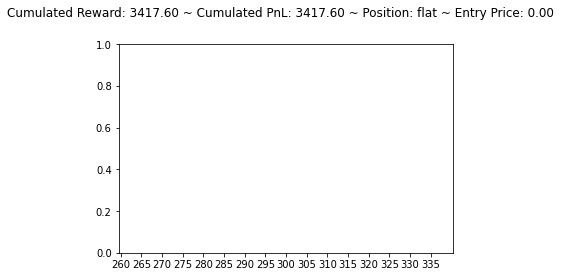

[457.1428  538.5642  652.51917]
flat sell short


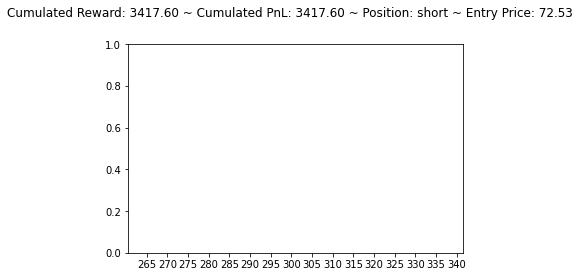

[490.85388 849.78564 917.36755]
short buy flat


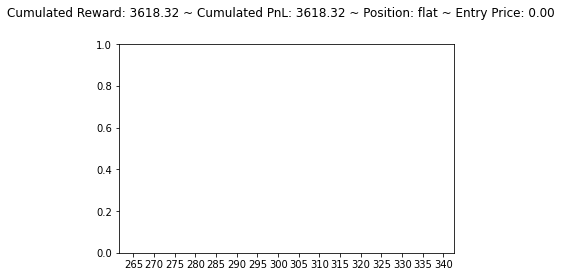

[451.47806 752.917   856.7687 ]
flat sell short


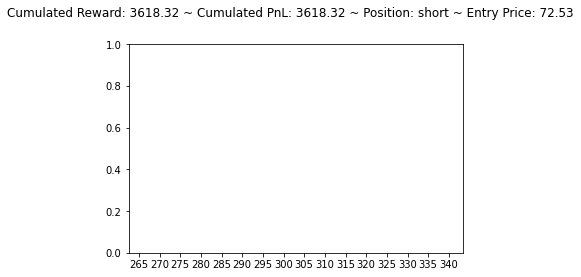

[1217.821  1080.9532  879.7908]
short hold short


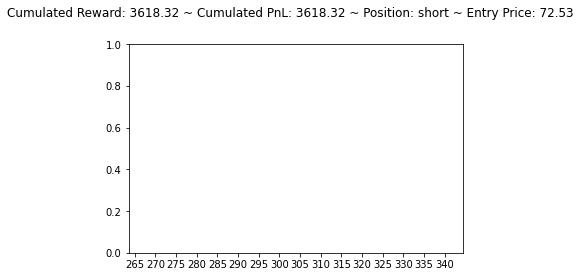

short buy flat


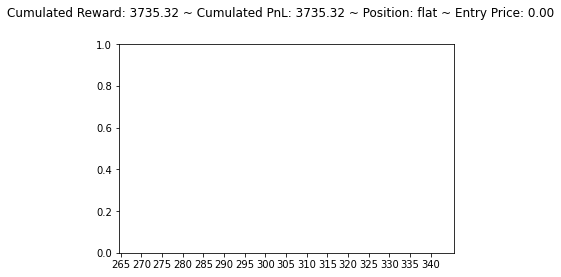

[1047.7457   945.71545 1107.6622 ]
flat sell short


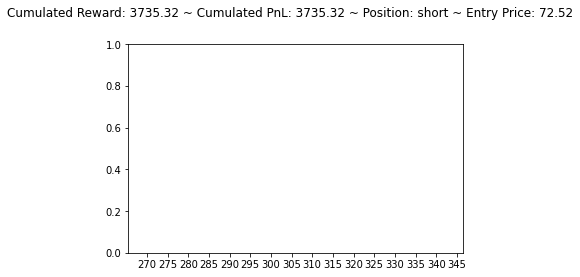

[ 840.3063 1206.4434 1143.8834]
short buy flat


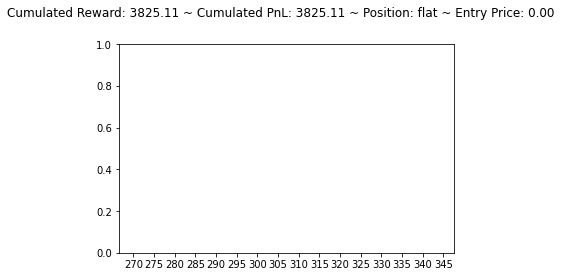

[1016.3963   295.87427  896.36926]
flat hold flat


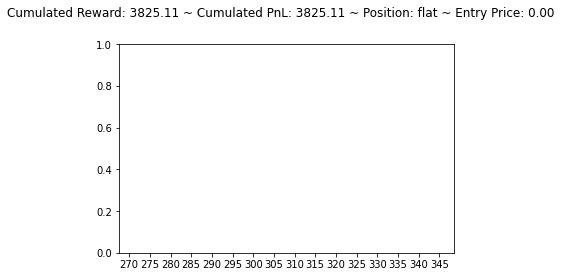

[1172.17   1099.9202 1219.3394]
flat sell short


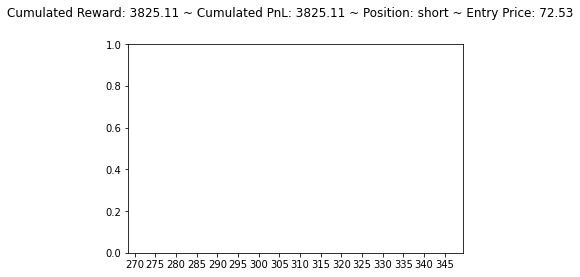

[1739.477  1462.4203 1706.4868]
short hold short


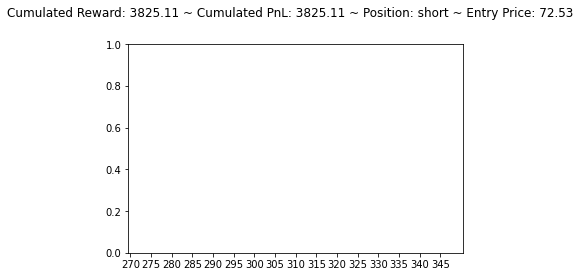

[1315.6995 1474.4716 1317.5476]
short buy flat


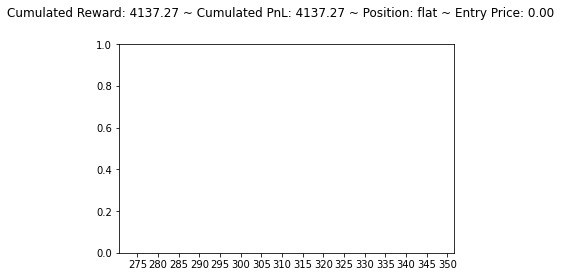

[ 839.6154 1263.6    1083.6454]
flat buy long


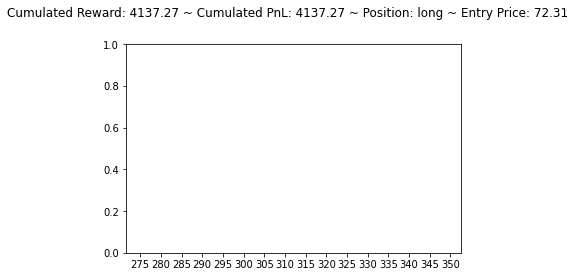

[1305.8363 1329.1978 1316.6971]
long sell flat


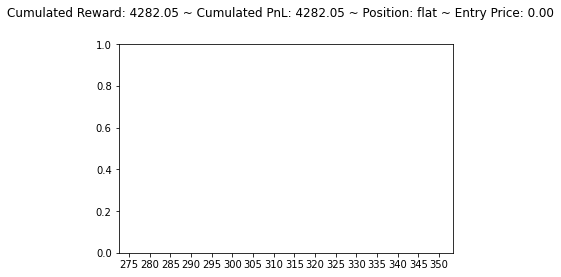

[ 973.2474 1073.9535 1079.2922]
flat sell short


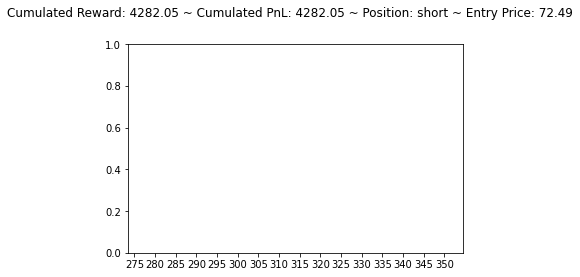

[1184.5151 1211.9454 1058.8054]
short buy flat


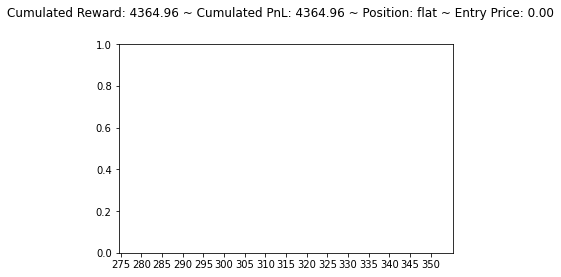

[848.951   916.9863  893.29425]
flat buy long


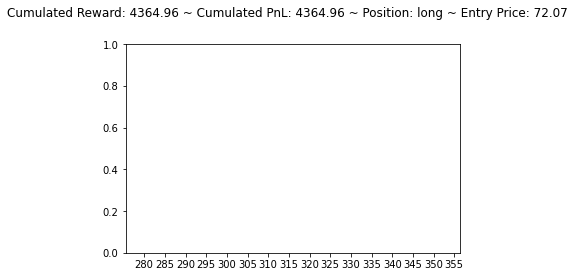

[ 992.1284 1150.9022 1029.992 ]
long sell flat


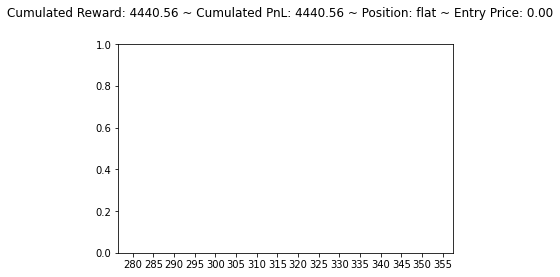

[1725.4277 1462.2909 1615.9016]
flat hold flat


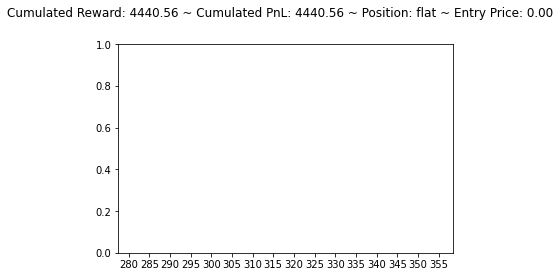

[1481.4215 1629.8243 1601.1062]
flat buy long


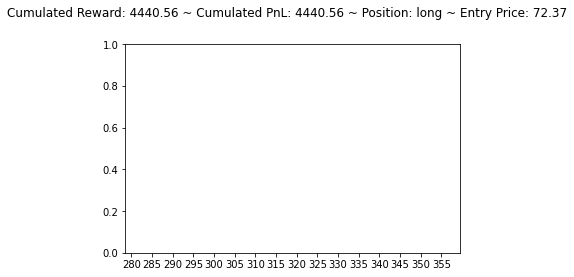

[1154.85   1165.1305 1021.8138]
long hold long


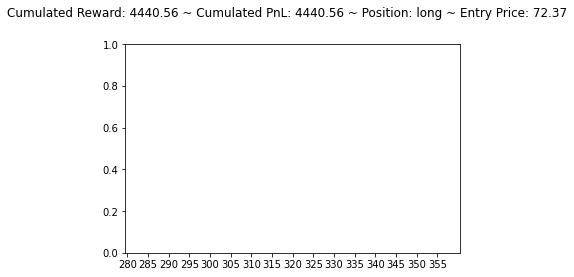

[1223.8794  987.8199 1031.6805]
long hold long


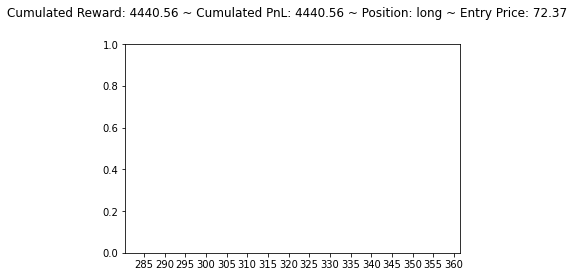

[1911.5067 1686.5074 1792.1577]
long hold long


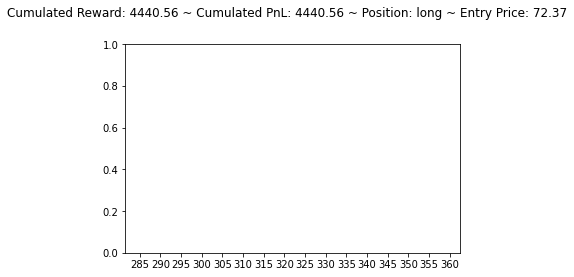

[2016.586  2013.9197 1995.2657]
long hold long


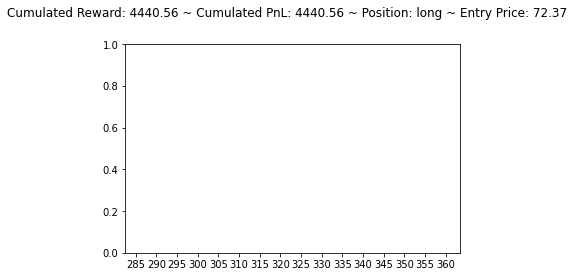

[1448.852  1292.0669 1741.8558]
long sell flat


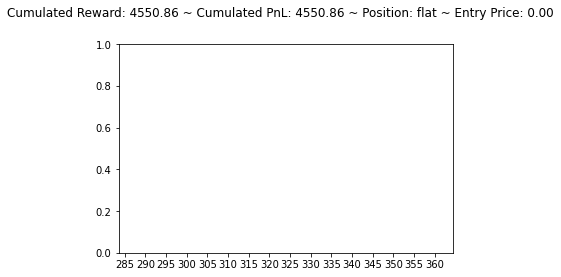

[2101.049  1748.8037 1942.4252]
flat hold flat


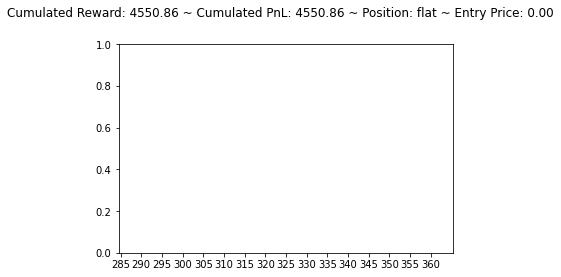

[2114.7905 2173.904  1979.5801]
flat buy long


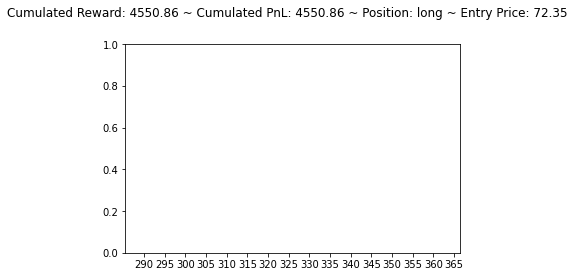

[1703.6815 1194.9708 1580.9944]
long hold long


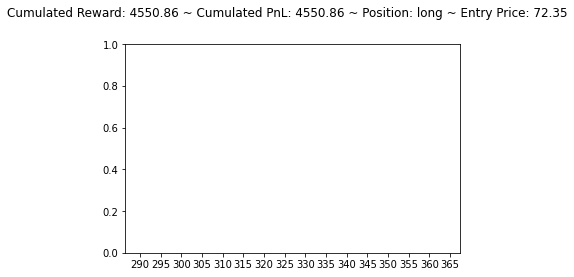

[1710.0726 1496.0018 1512.5913]
long hold long


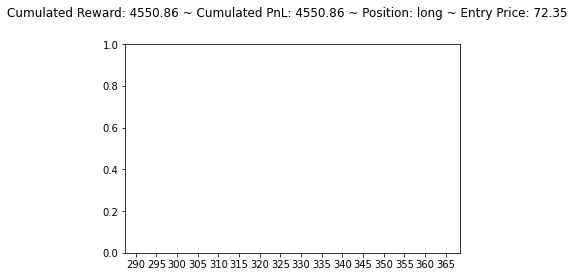

[1773.1476 1898.5262 1848.642 ]
long sell flat


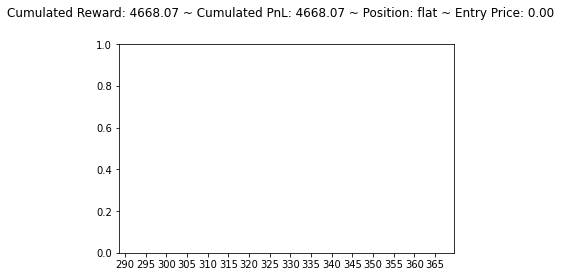

[1309.3992 1063.9171 1430.0808]
flat sell short


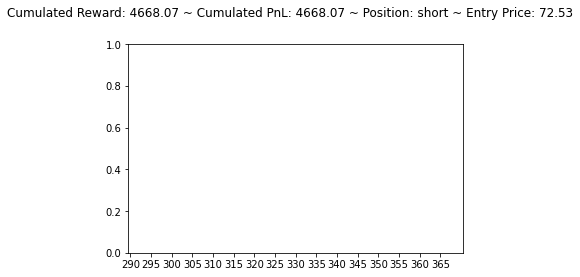

[695.196   751.8841  827.60406]
short buy flat


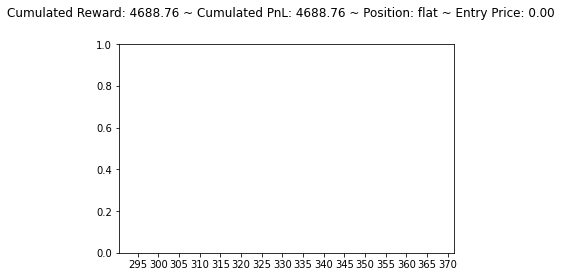

[583.58856 660.9895  731.7308 ]
flat sell short


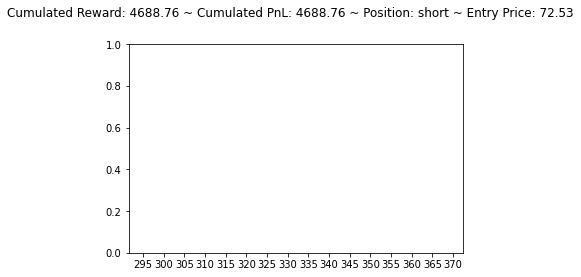

[701.0933  756.0912  838.01105]
short buy flat


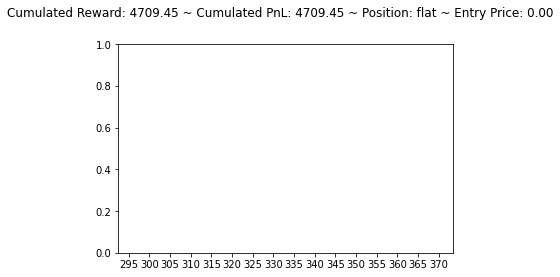

[591.20685 664.28235 735.67834]
flat sell short


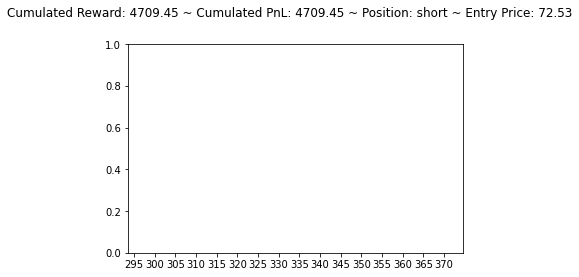

[709.00574 814.9343  778.10565]
short buy flat


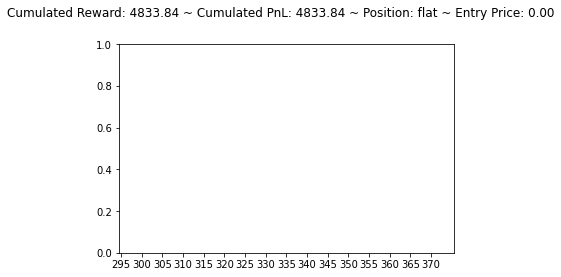

[1590.5692 1379.3407 1391.2262]
flat hold flat


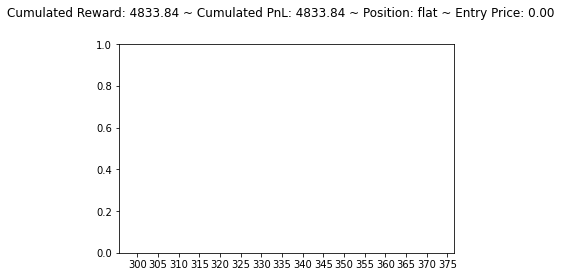

[1475.1477 1648.6398 1516.5822]
flat buy long


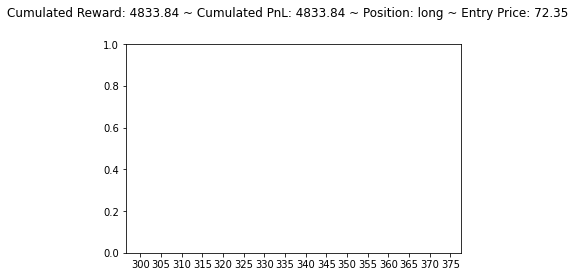

[1704.483  1809.3757 1825.3888]
long sell flat


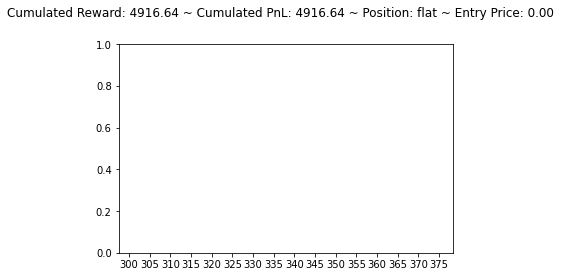

[1707.2667 1744.2457 1651.6915]
flat buy long


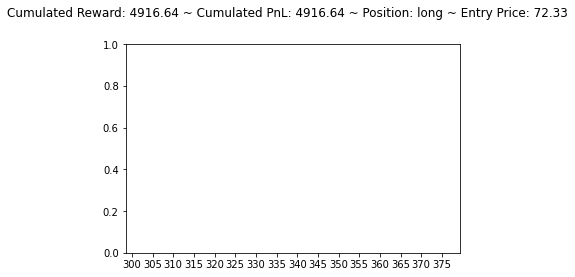

[1749.5428 1818.4297 1814.2227]
long sell flat


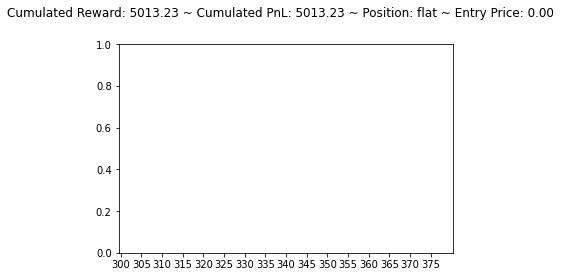

[1744.3651 1768.4215 1744.5697]
flat buy long


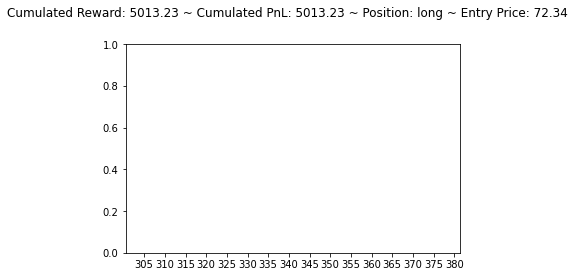

[1611.8394 1626.7897 1632.7544]
long sell flat


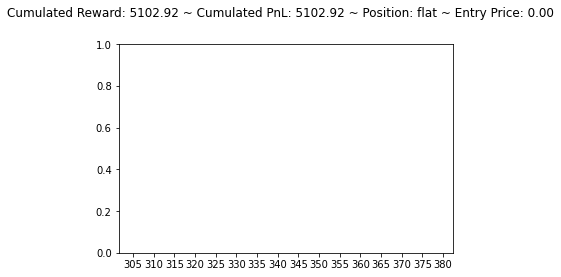

[1594.9657 1613.4417 1625.7135]
flat sell short


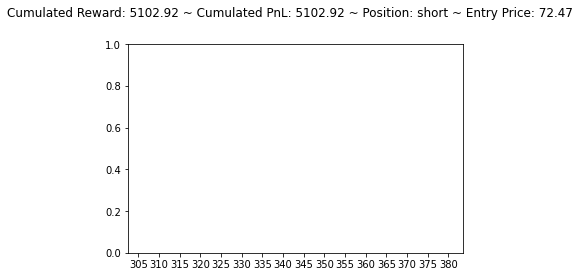

[1653.5496 1659.8529 1649.1884]
short buy flat


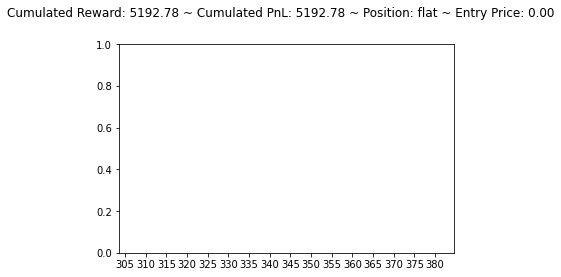

[1229.2092 1186.8822 1338.1841]
flat sell short


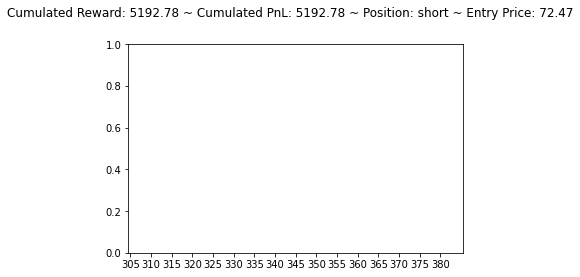

[1278.1697 1319.9287 1346.5881]
short buy flat


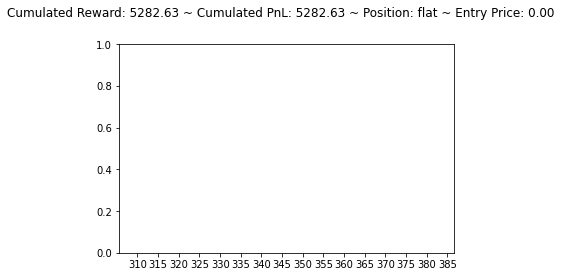

[1233.236  1279.6056 1310.9058]
flat sell short


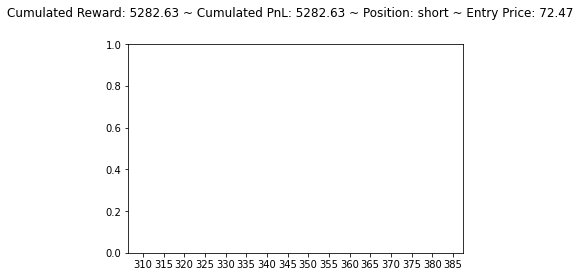

[1255.9175 1303.3187 1277.03  ]
short buy flat


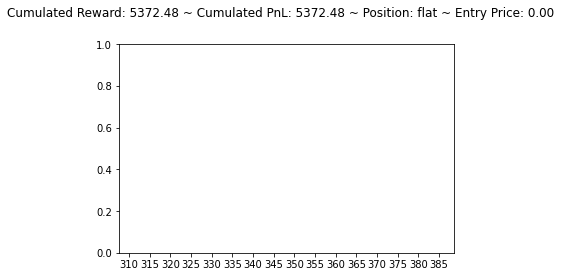

[1989.5812 1819.0693 1897.5616]
flat hold flat


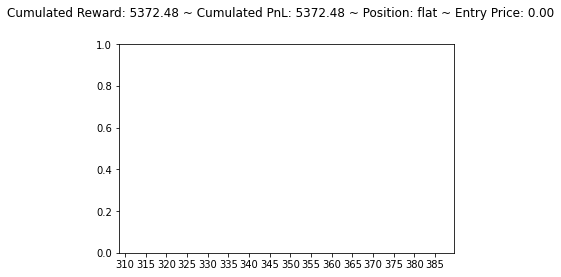

[1413.7341  680.7443 1541.9526]
flat sell short


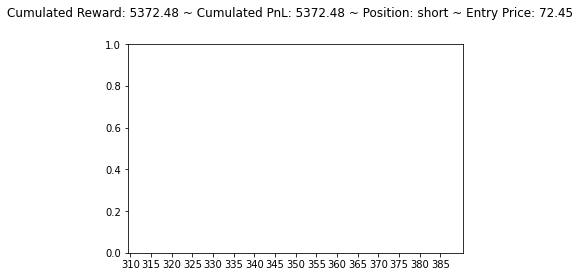

[1195.2119 1286.6241 1312.1697]
short buy flat


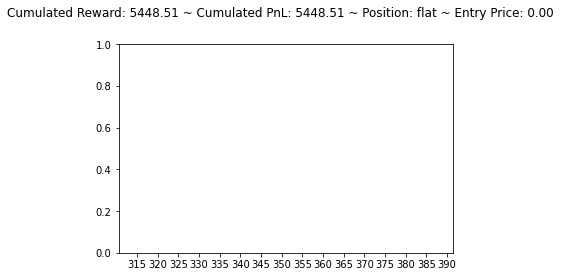

[1177.8539 1242.2786 1251.8778]
flat sell short


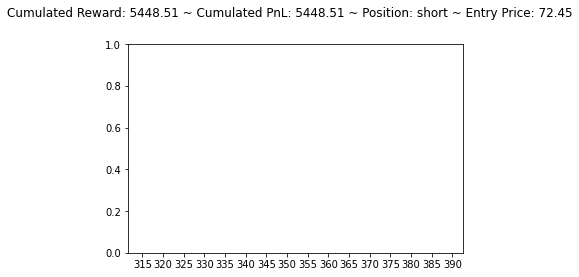

[1304.3684 1336.1334 1403.1772]
short buy flat


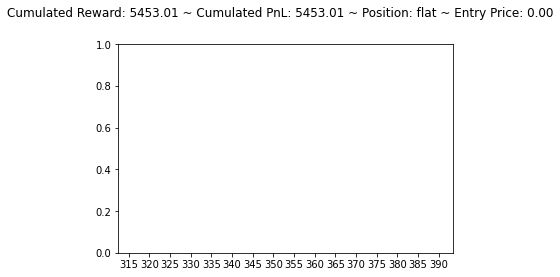

[1207.1862 1242.951  1222.3928]
flat buy long


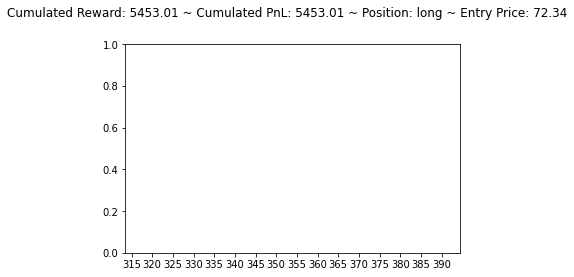

[1218.4032 1292.8148 1315.2623]
long sell flat


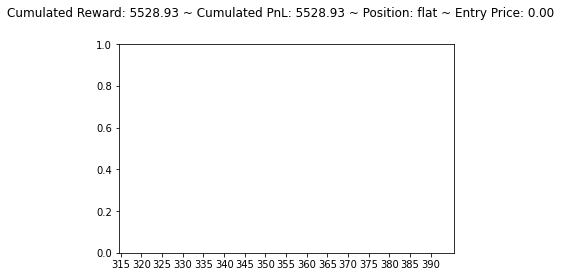

[1199.1047 1256.2697 1288.1904]
flat sell short


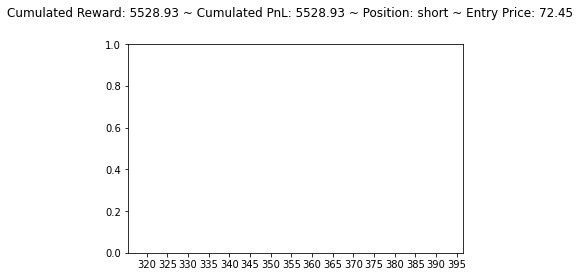

[1262.1304 1301.4983 1301.7053]
short buy flat


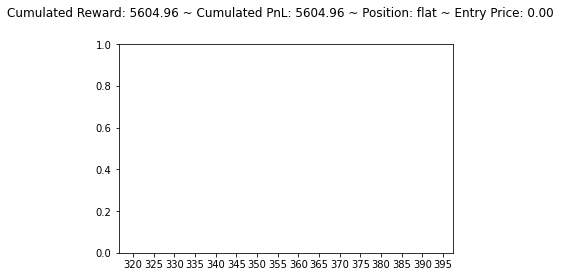

[2188.278  1787.04   1396.4026]
flat hold flat


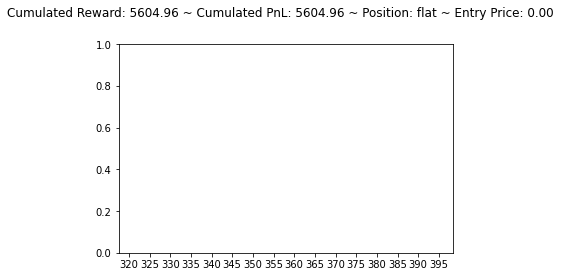

[2114.813  2233.7659 1988.61  ]
flat buy long


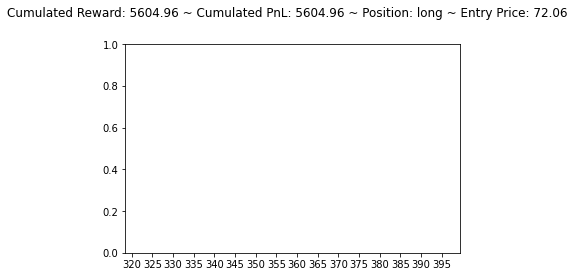

[2088.526  2403.3018 2277.7278]
long sell flat


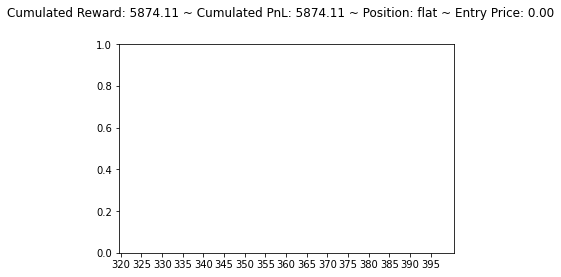

[1576.7943 2383.304  1850.2966]
flat buy long


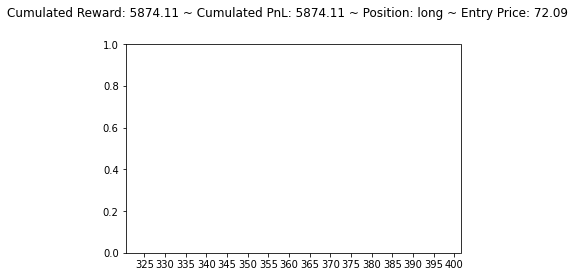

[1709.3708 1941.4318 1736.0736]
long sell flat


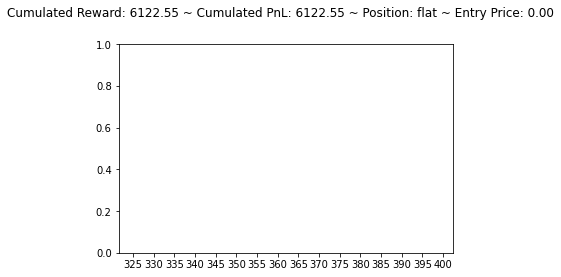

[2540.492  2689.7905 2323.4824]
flat buy long


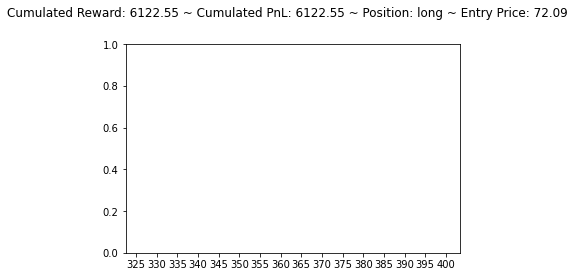

[1769.478  1566.1302 2069.0327]
long sell flat


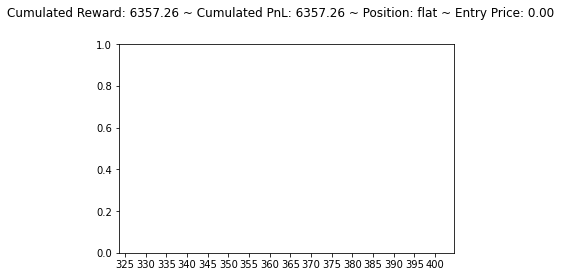

[1588.0912 1847.7096 1668.752 ]
flat buy long


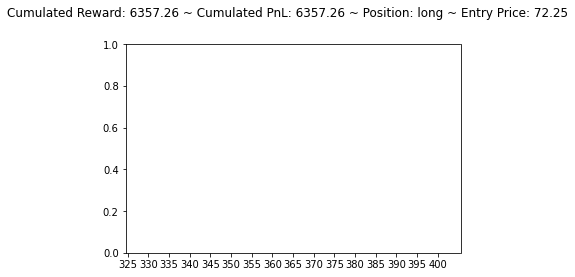

[2934.0151 2888.902  2532.1157]
long hold long


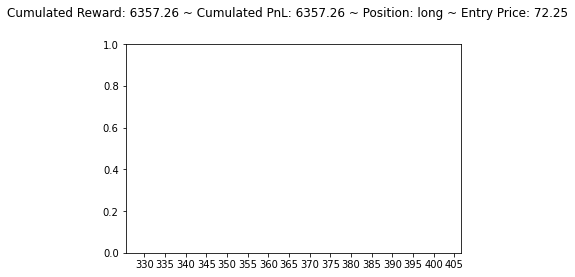

[1770.5109 1312.0839 2178.4536]
long sell flat


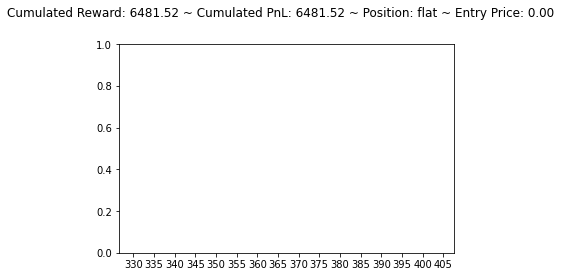

[1387.4493 1403.5419 1330.2468]
flat buy long


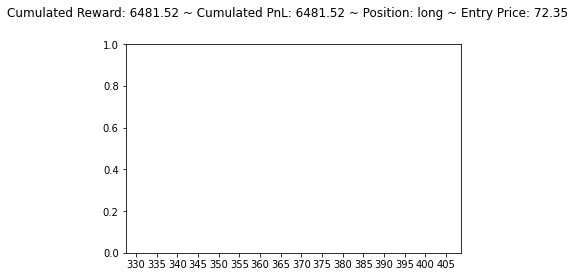

[1499.6202 1200.2013 1402.2678]
long hold long


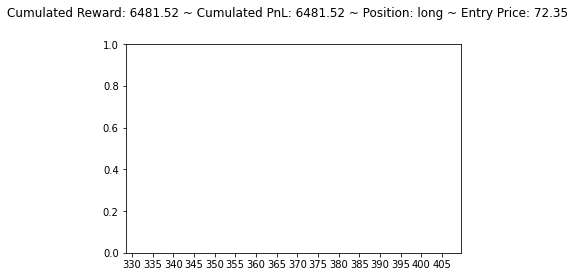

[1227.8705 1250.0309 1056.1858]
long hold long


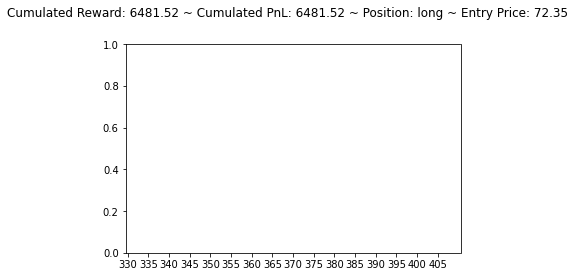

[1192.4093 1286.0807 1203.0825]
long sell flat


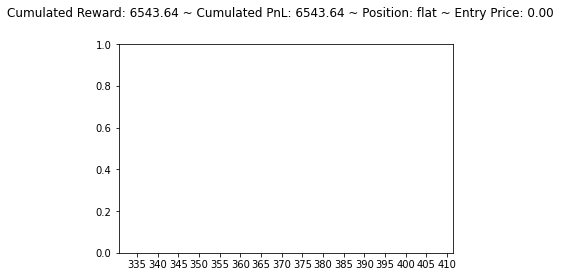

[1276.3593 1547.1056 1572.6698]
flat sell short


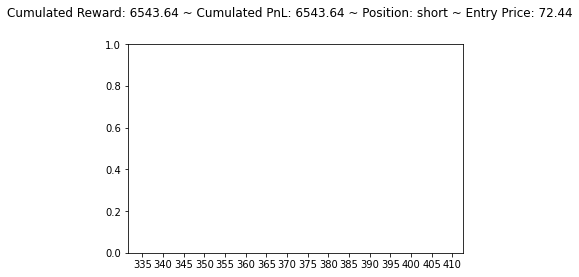

[1579.6112 1631.7961 1639.4218]
short buy flat


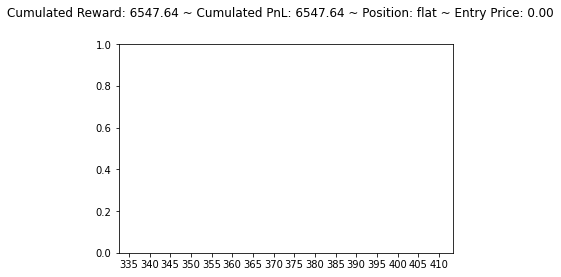

[581.36127 473.02753 611.23663]
flat sell short


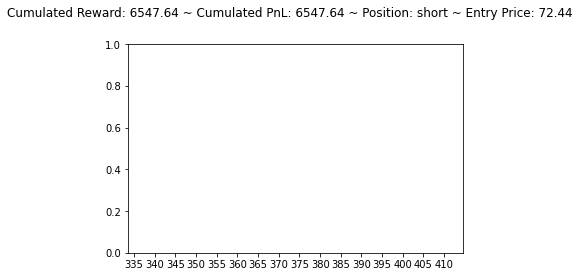

[917.48737 850.244   721.4547 ]
short hold short


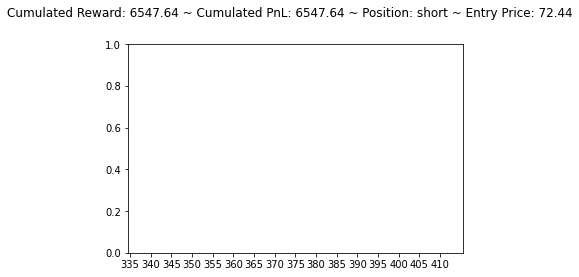

[984.2566  948.88214 966.3578 ]
short hold short


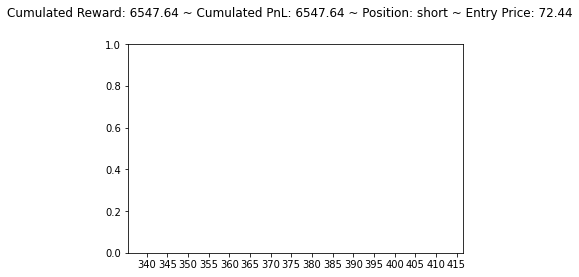

[683.8822  629.1482  722.59216]
short hold short


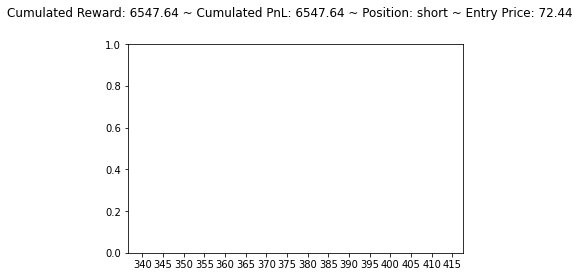

[941.03156 932.4654  819.7233 ]
short hold short


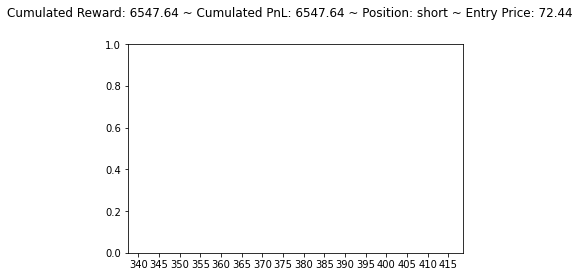

[2239.384  1851.893  2091.6135]
short hold short


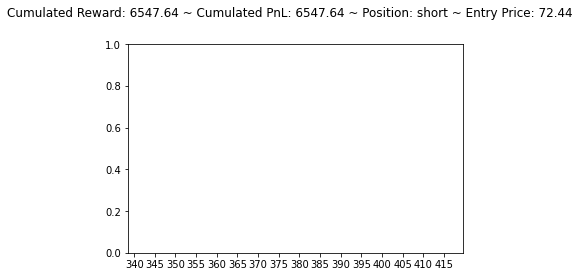

[1619.7194 1216.7101 1944.9216]
short hold short


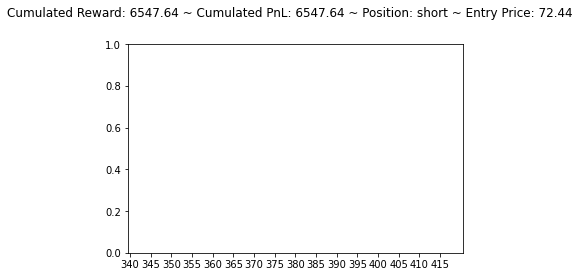

[1462.3511 1575.8021 1515.0225]
short buy flat


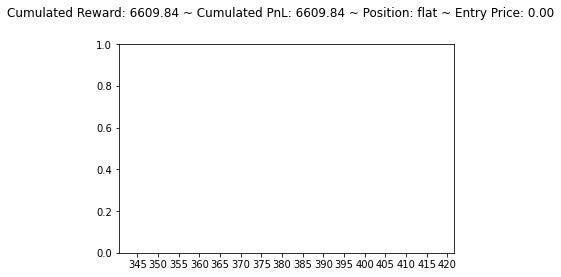

[1383.528  1509.8275 1434.6819]
flat buy long


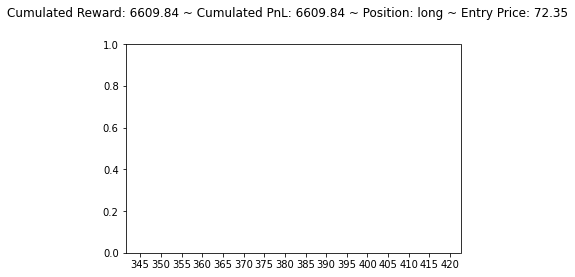

[1455.2599 1568.3722 1509.0352]
long sell flat


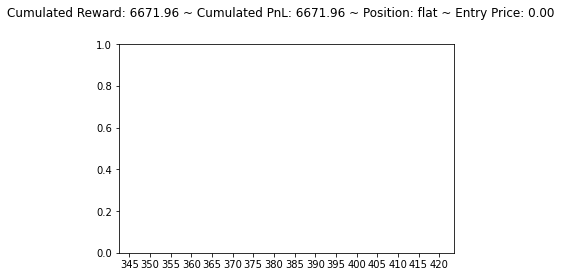

[1163.5193 1253.5303 1272.282 ]
flat sell short


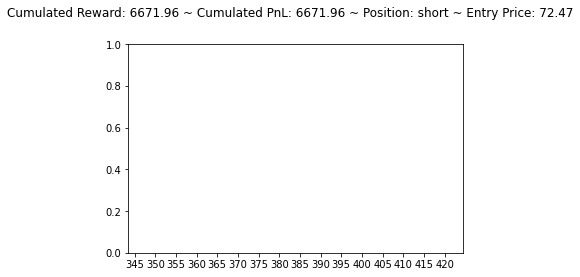

[2219.9038 1838.0131 2072.7222]
short hold short


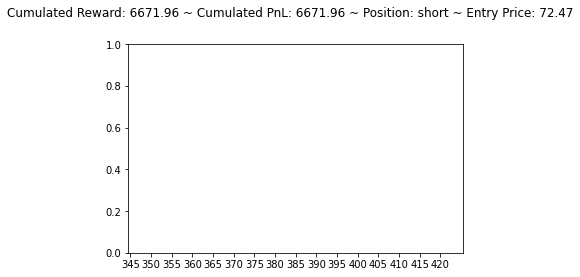

[4210.8486 3869.3804 3347.1204]
short hold short


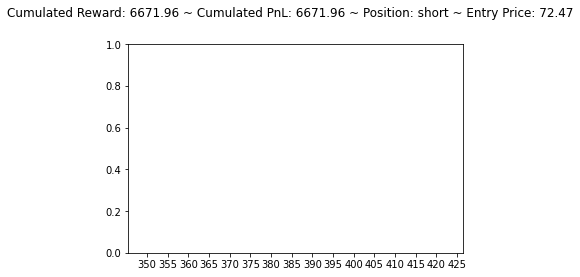

[2720.8826  718.3533 2199.2163]
short hold short


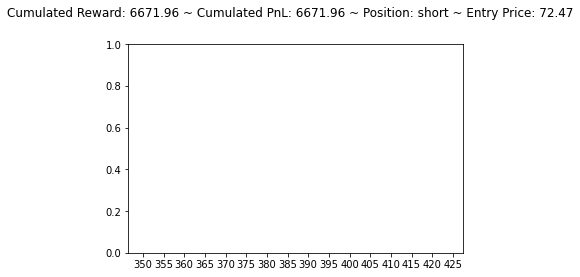

[1578.2914 1657.5673 1675.5082]
short buy flat


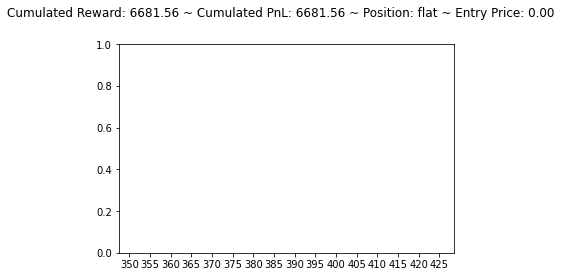

[1605.6992 1626.2539 1623.2102]
flat buy long


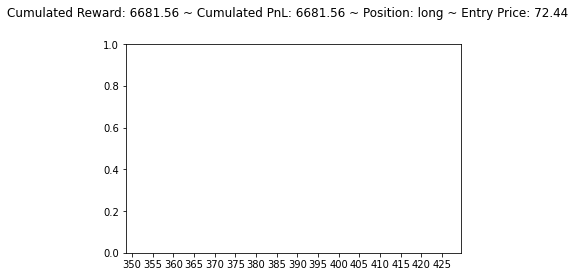

[2920.051  2583.3252 2365.0825]
long hold long


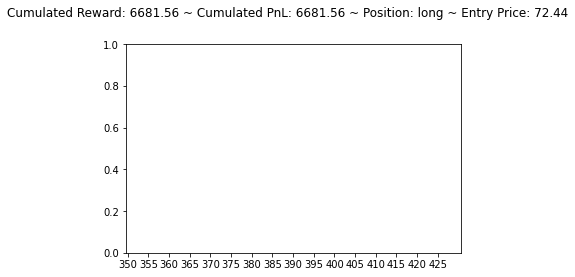

[2195.6204 2202.7012 2140.3733]
long hold long


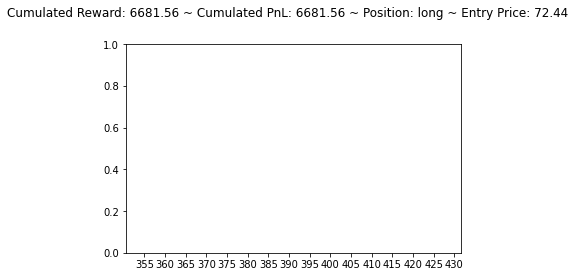

[1545.6527 1312.9963 1785.3997]
long sell flat


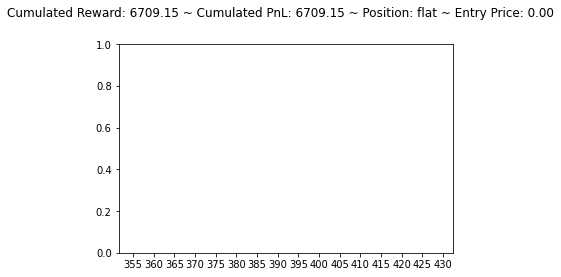

[794.7954 820.3357 914.8907]
flat sell short


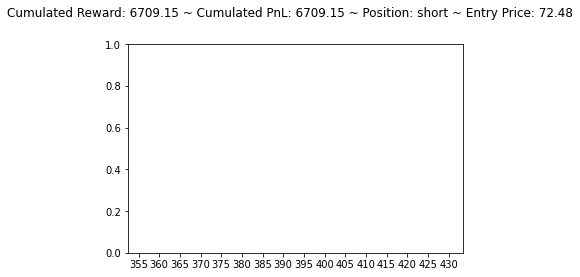

[853.91364 863.1832  973.6371 ]
short buy flat


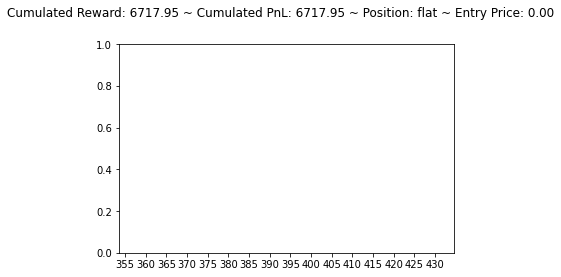

[788.8574  807.90186 910.9081 ]
flat sell short


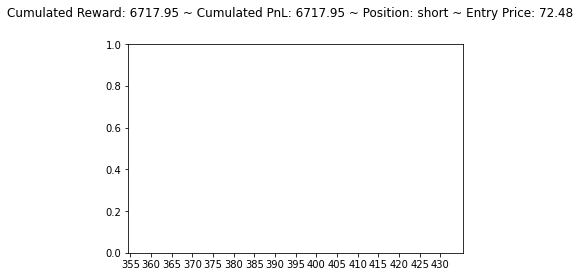

[874.88904 875.0491  992.65576]
short buy flat


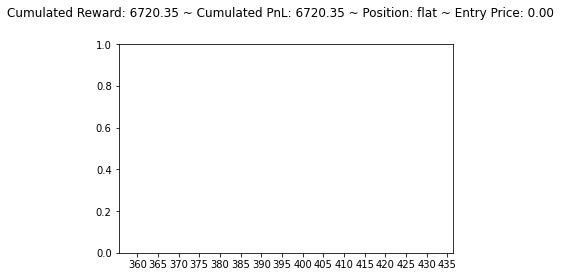

[800.92755 812.6378  917.7542 ]
flat sell short


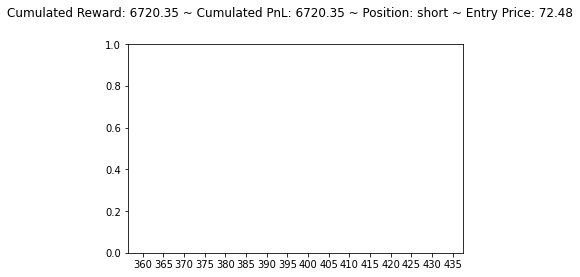

[ 894.929    891.5449  1010.23834]
short hold short


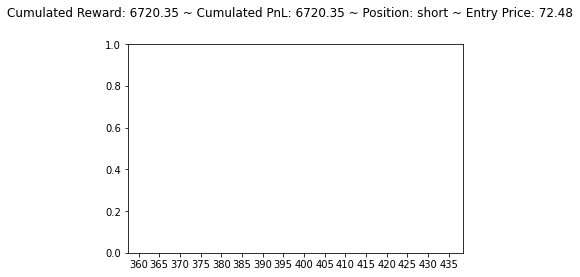

[830.80646 851.00635 913.0657 ]
short buy flat


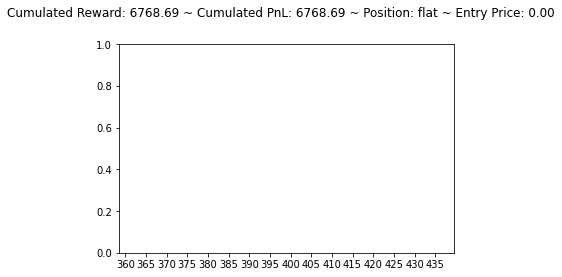

[675.4513  702.9856  762.12573]
flat sell short


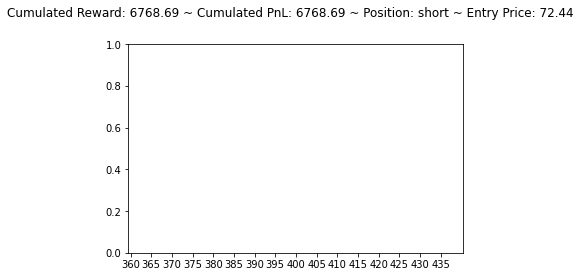

[812.1218 856.6114 656.8781]
short buy flat


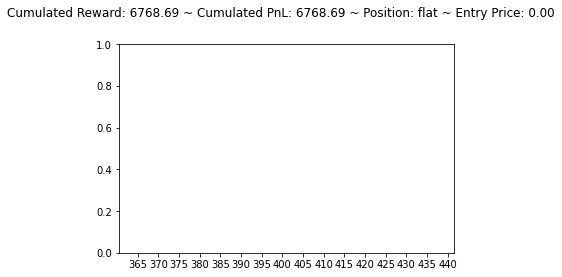

[667.0983  749.8761  802.62964]
flat sell short


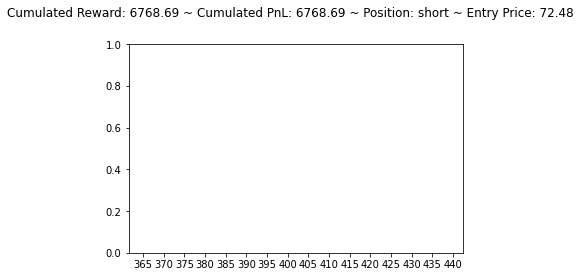

[742.08997 813.65063 877.0183 ]
short buy flat


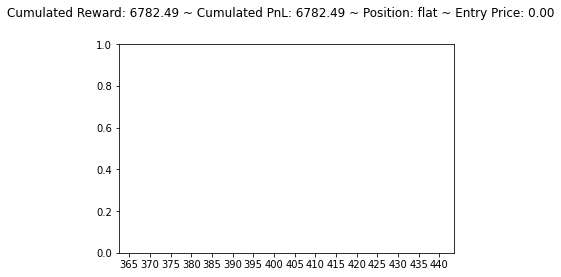

[678.71277 759.6659  826.4314 ]
flat sell short


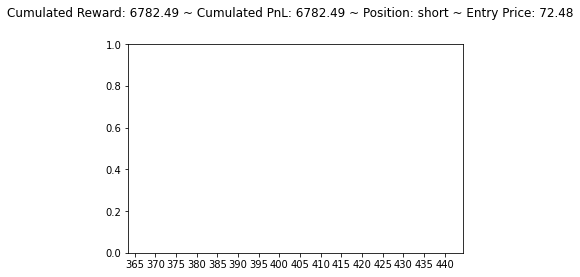

[797.8434  842.99976 940.7687 ]
short buy flat


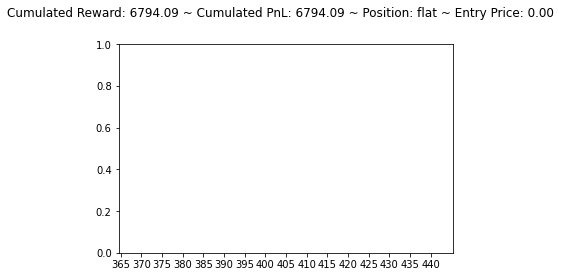

[2096.284  1750.3379 1916.0422]
flat hold flat


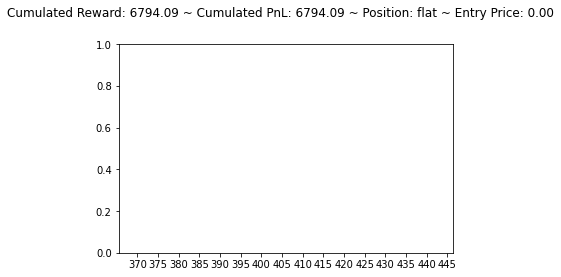

[1628.5046 1354.7686 1846.5786]
flat sell short


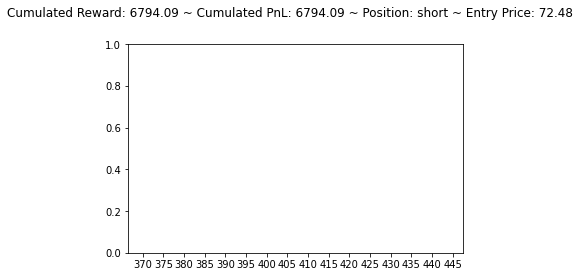

[824.88947 847.23834 963.0544 ]
short buy flat


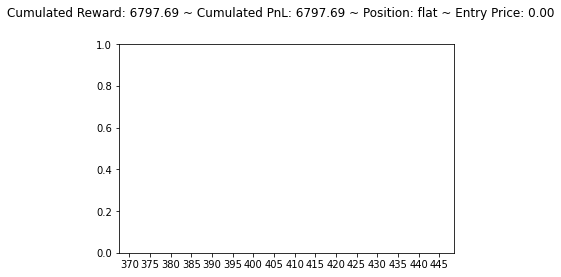

[737.78326 758.1017  860.03613]
flat sell short


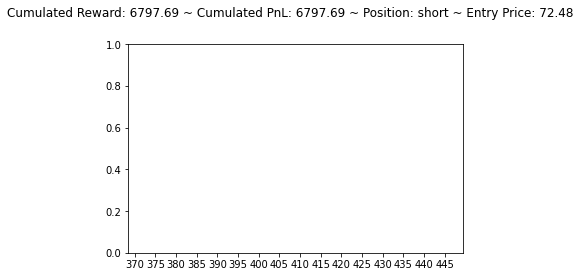

[793.3333 811.0154 902.758 ]
short buy flat


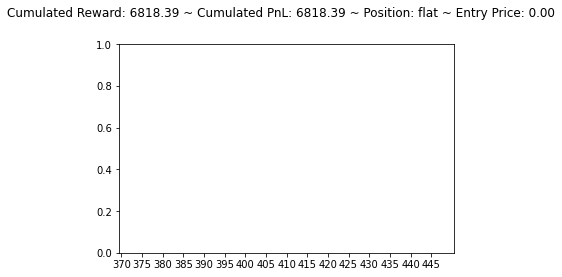

[697.33014 750.1573  828.2967 ]
flat sell short


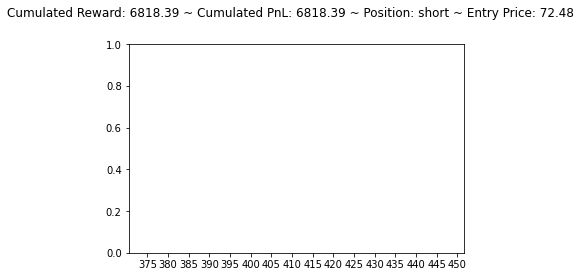

[786.90875 821.1776  927.81354]
short buy flat


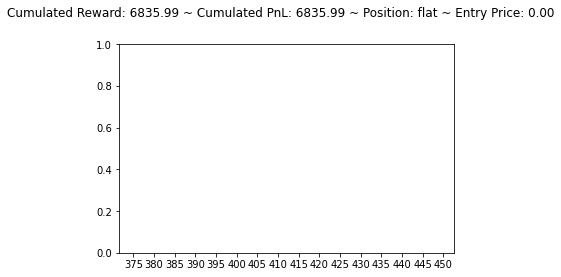

[733.03937 765.87164 861.13464]
flat sell short


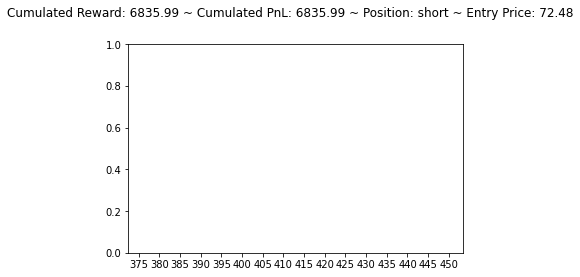

[1173.9603   426.20993  986.7496 ]
short hold short


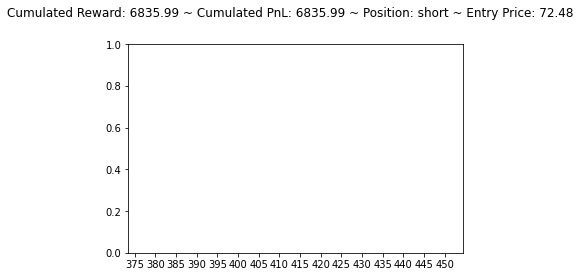

[820.6011  977.08276 823.5404 ]
short buy flat


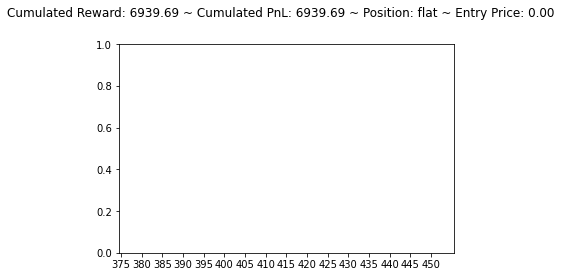

[513.7813  787.9914  808.03894]
flat sell short


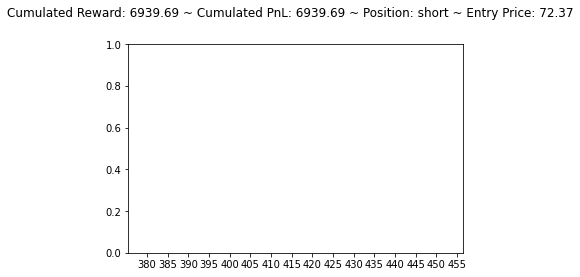

[ 967.2951 1002.7494  936.5791]
short buy flat


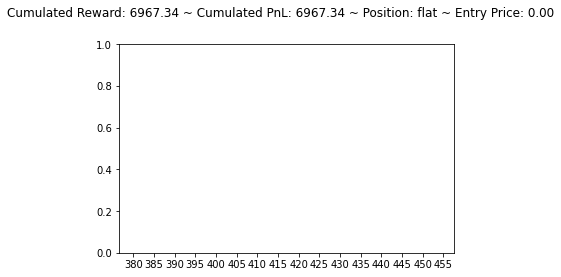

[746.816  915.1844 846.4222]
flat buy long


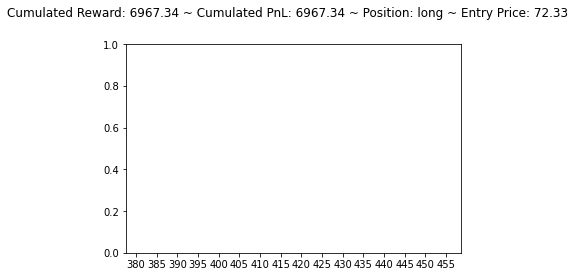

[ 934.9138  1003.69824  951.4511 ]
long sell flat


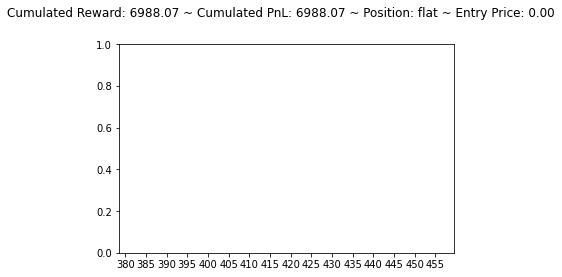

[ 941.98627 1017.8573   979.28284]
flat buy long


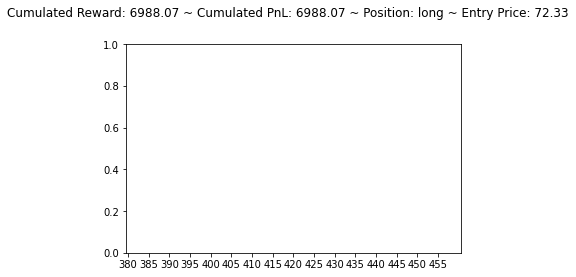

[809.1517  973.93536 805.72705]
long hold long


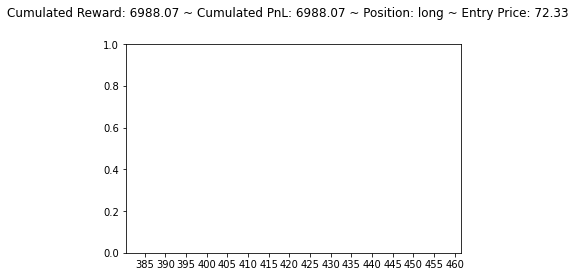

[1567.4579 1375.639  1416.2788]
long hold long


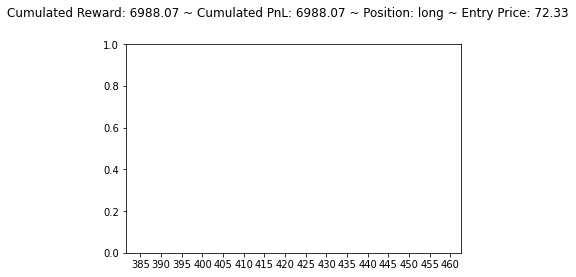

[1376.2262  994.9393 1211.4009]
long hold long


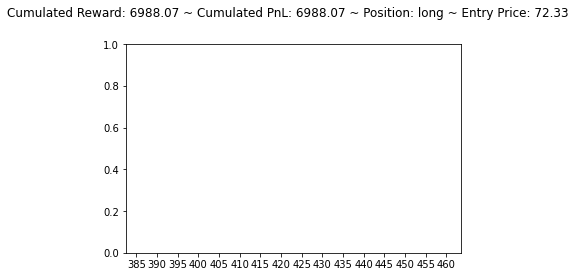

[535.66144 876.75977 851.8467 ]
long sell flat


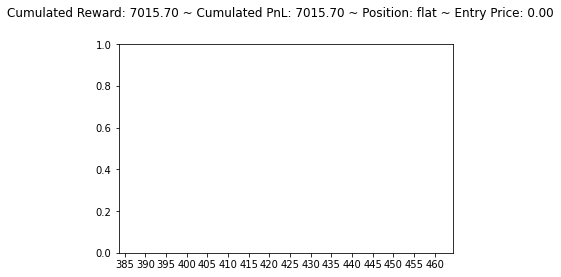

[387.64786 731.90857 753.56415]
flat sell short


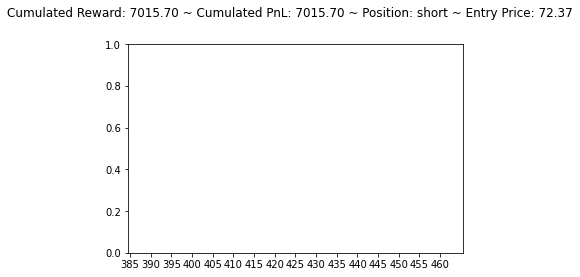

[580.1775  865.02924 853.21783]
short buy flat


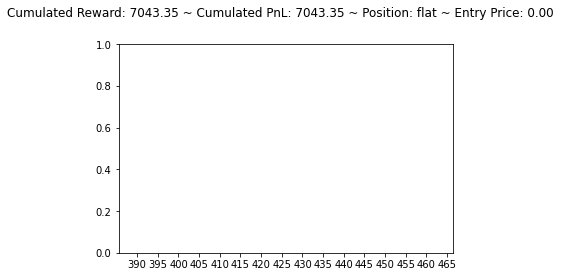

[733.4704  799.05566 713.0377 ]
flat buy long


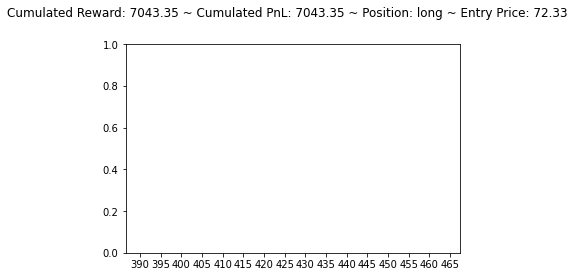

[803.08984 941.51855 741.45966]
long hold long


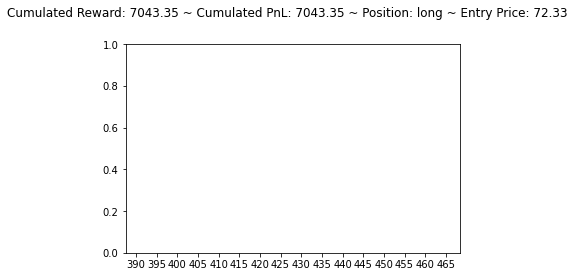

[464.5739  636.95026 781.2612 ]
long sell flat


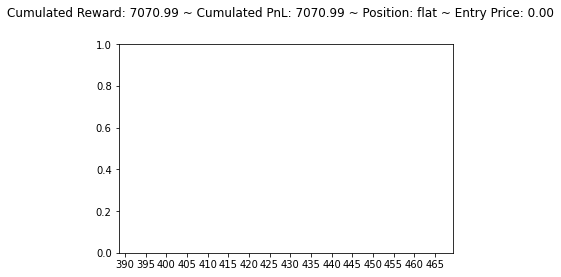

[513.61017 524.50305 665.5508 ]
flat sell short


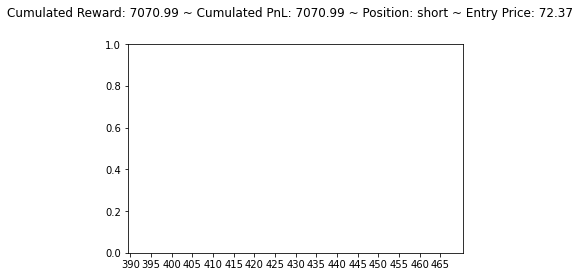

[956.9234  839.90686 890.66675]
short hold short


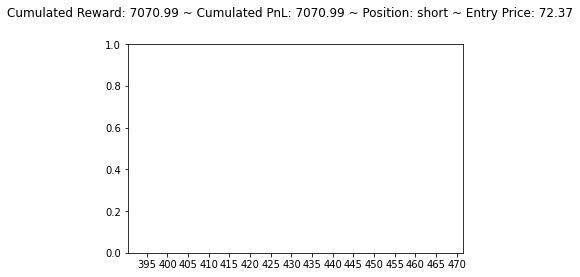

[628.26825 525.92773 828.3829 ]
short hold short


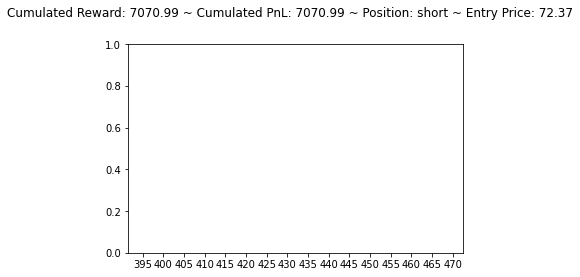

[1019.32477  485.37033  793.565  ]
short hold short


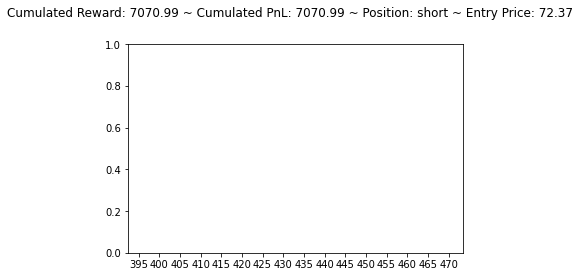

[1096.0021 1249.8971 1101.0446]
short buy flat


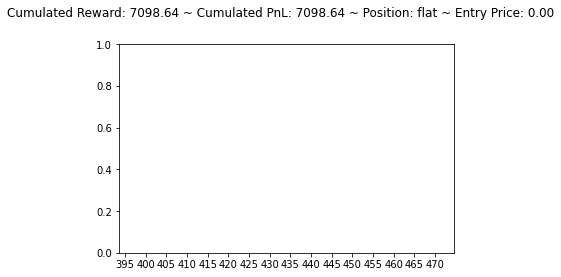

[806.5145 763.357  431.0527]
flat hold flat


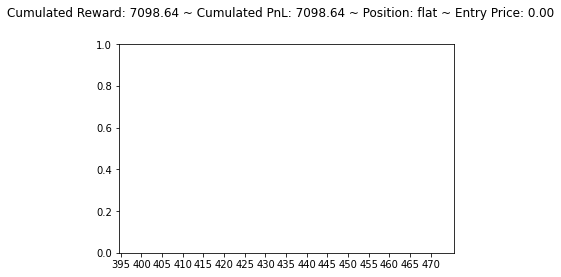

[509.2964  484.77905 708.3214 ]
flat sell short


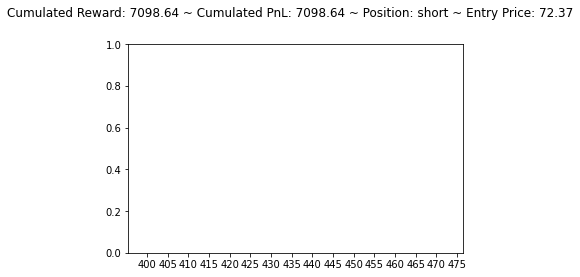

[610.022  641.8817 752.5391]
short buy flat


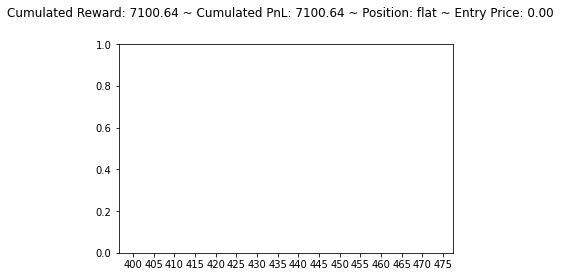

[705.6437 850.5307 752.89  ]
flat buy long


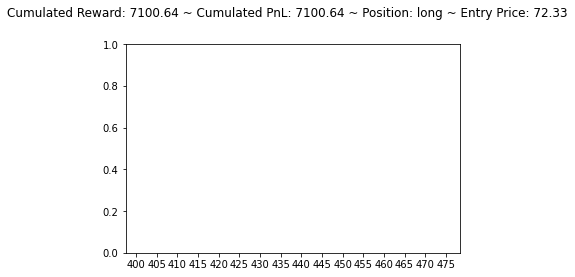

[1169.6198 1160.6145 1054.5863]
long hold long


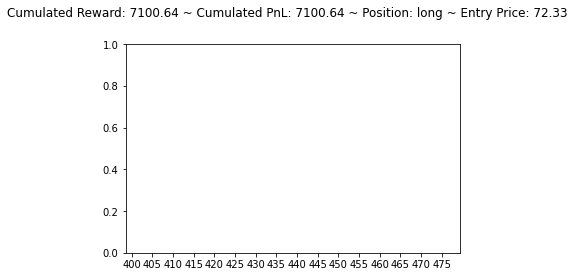

[1120.5406 1169.8757 1027.9265]
long hold long


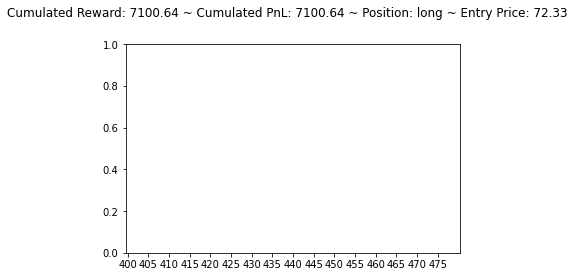

[1045.4327  1053.6542   989.20306]
long hold long


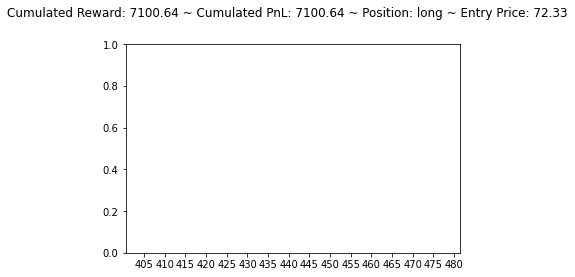

[1179.7379 1290.6091 1123.347 ]
long hold long


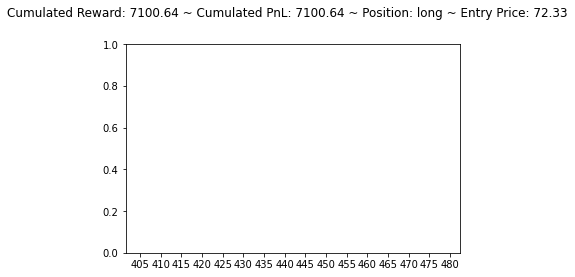

[ 898.139  1017.0168  883.7361]
long hold long


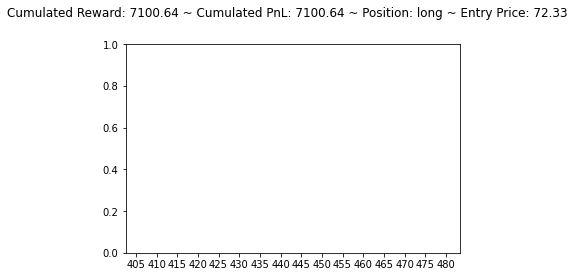

[ 960.91534 1021.6537   944.7638 ]
long hold long


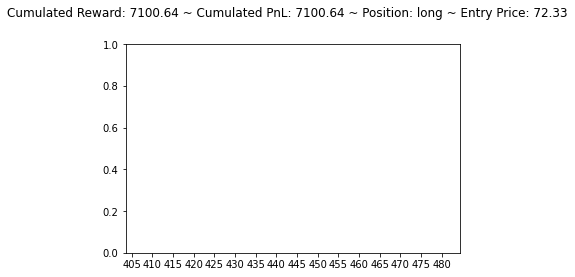

[803.2627 964.9394 805.2831]
long sell flat


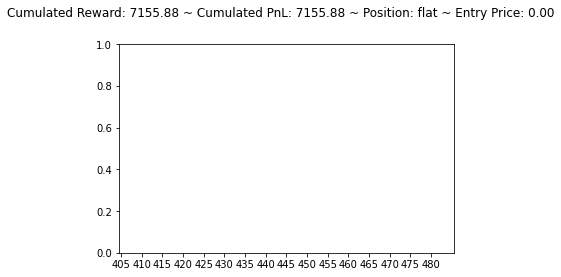

[450.81824 752.74945 790.57855]
flat sell short


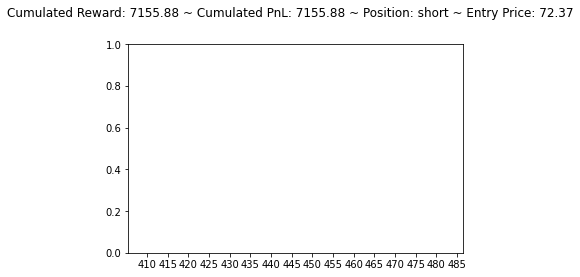

[ 849.454   1016.10034  928.5024 ]
short buy flat


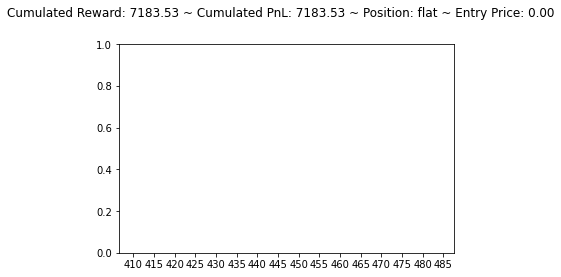

flat buy long


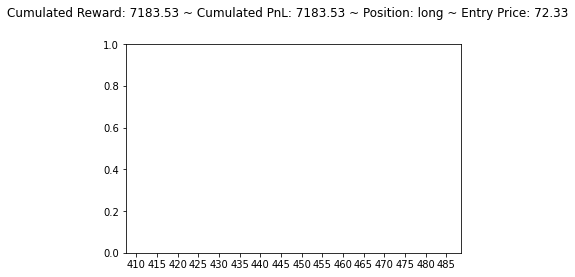

[579.82214 894.2741  903.2612 ]
long sell flat


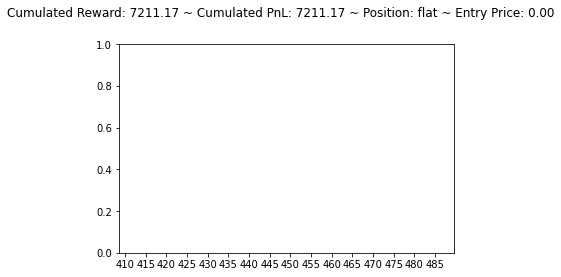

[662.40283 802.29626 800.86597]
flat buy long


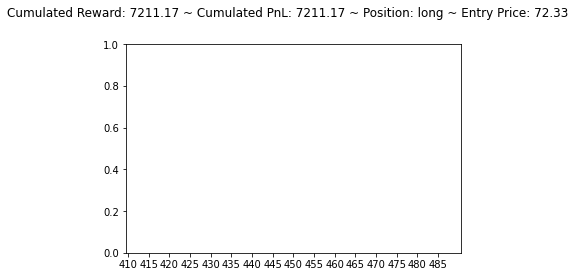

[751.81586 937.9351  603.20154]
long hold long


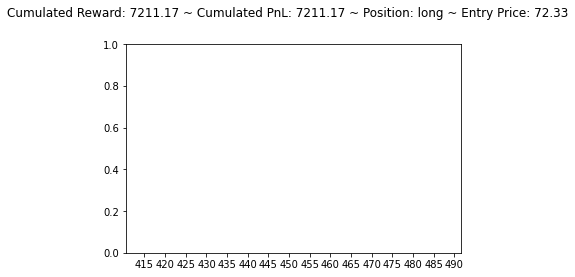

[467.99173 545.518   755.64246]
long sell flat


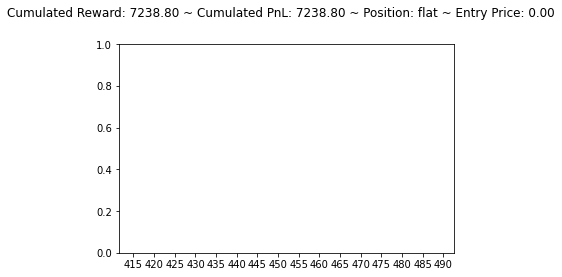

[588.75903 684.14044 694.94556]
flat sell short


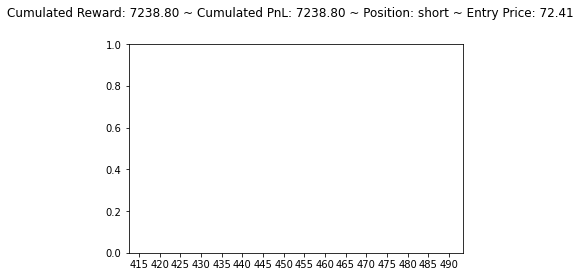

[505.79114 461.23618 762.02295]
short hold short


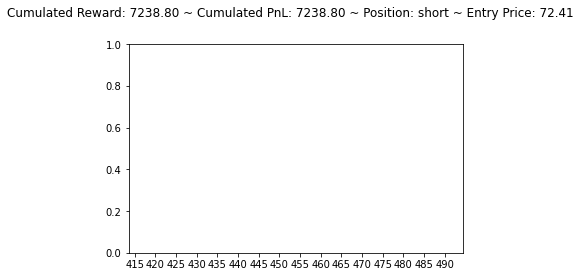

[710.679   787.05084 809.4706 ]
short buy flat


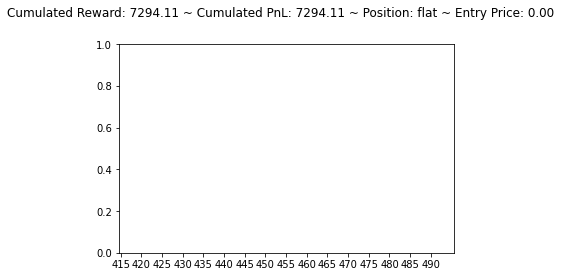

[715.767   789.7786  826.79004]
flat sell short


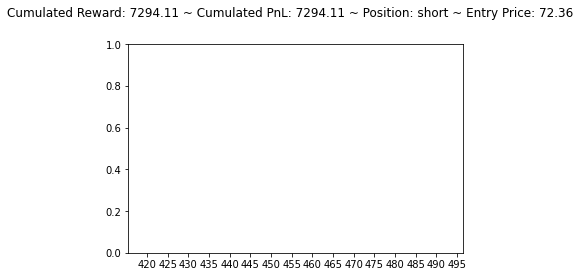

[ 838.3065   891.77234 1007.0886 ]
short buy flat


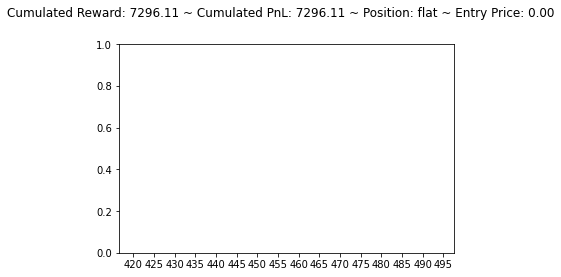

[775.8069 813.9169 853.2519]
flat sell short


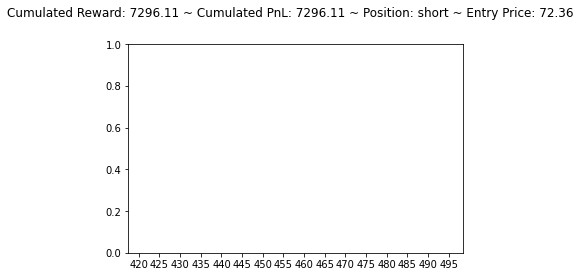

[793.95087 863.5183  935.26746]
short buy flat


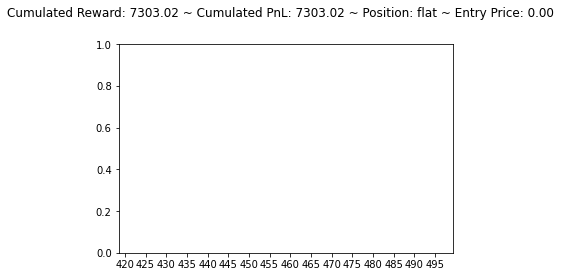

[706.22156 784.934   815.8361 ]
flat sell short


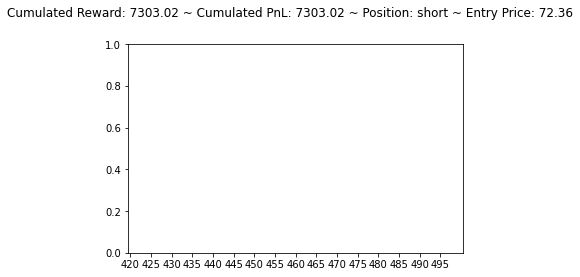

[854.9331  925.03564 952.7013 ]
short buy flat


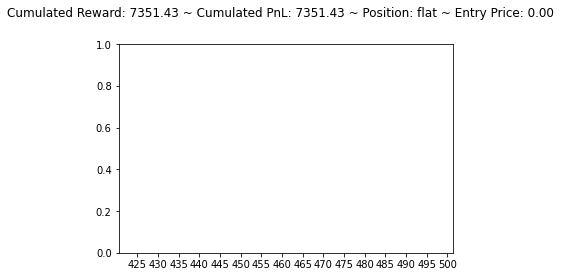

[ 834.1891  910.6426 1002.1312]
flat sell short


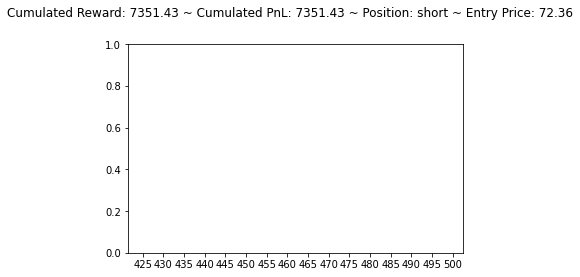

[1322.5475 1222.427  1286.3618]
short hold short


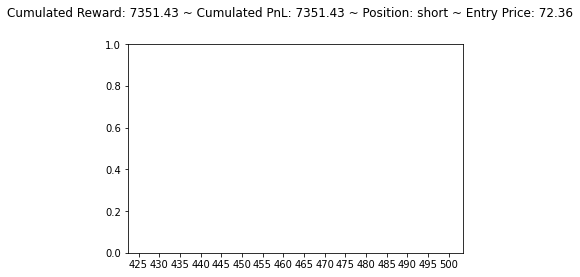

[1096.2405 1097.5608 1183.0067]
short buy flat


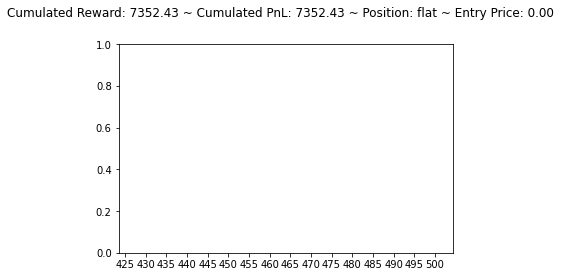

[828.3604 764.1925 976.8856]
flat sell short


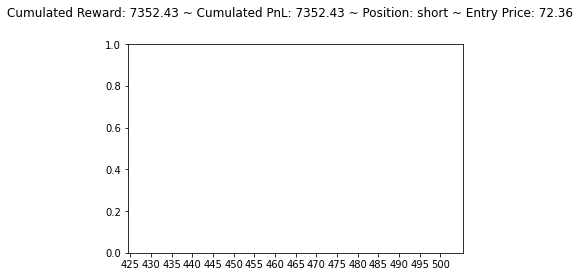

[ 955.35583  980.4226  1022.2124 ]
short buy flat


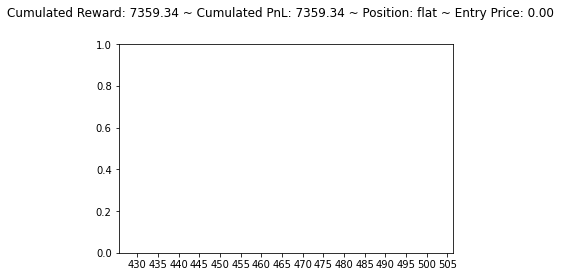

[658.35   689.8785 826.3098]
flat sell short


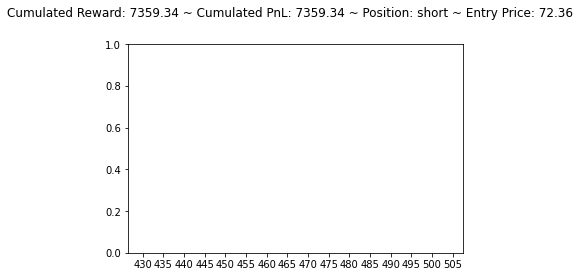

[613.40216 393.08868 820.71875]
short hold short


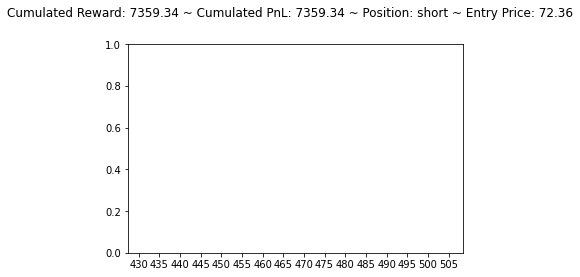

[651.1383 722.3302 747.4935]
short buy flat


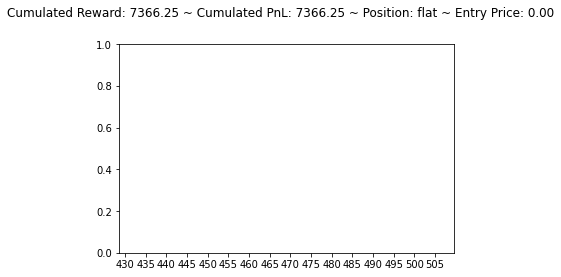

[673.2033  586.7756  747.93494]
flat sell short


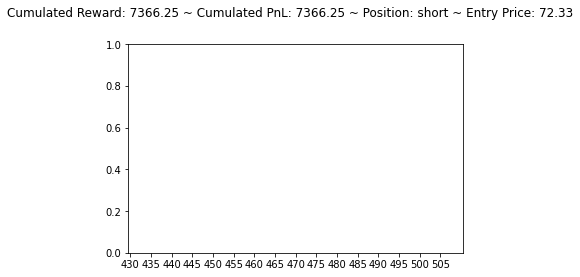

[746.3028 779.0619 547.5646]
short buy flat


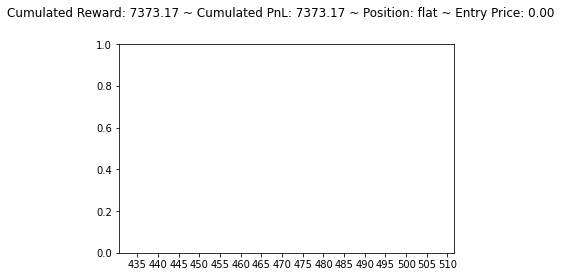

[618.8532 684.4325 801.5066]
flat sell short


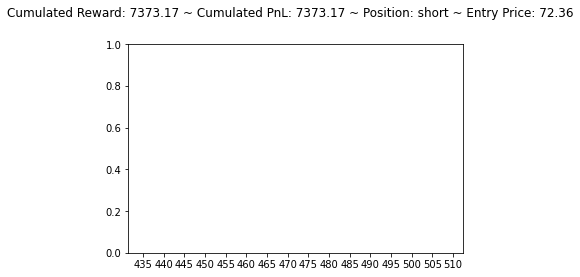

[724.57684 728.4042  858.621  ]
short buy flat


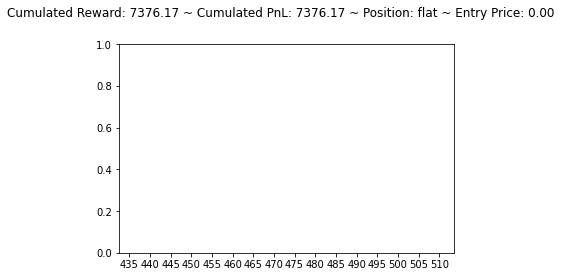

[591.47736 608.8694  729.86224]
flat sell short


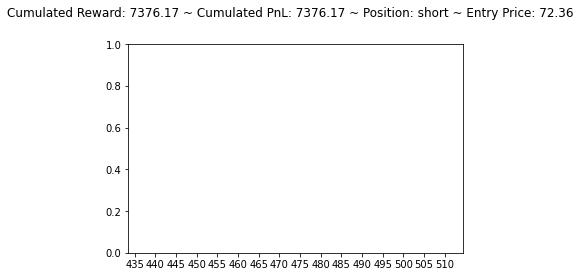

[679.8383 683.5205 820.8877]
short buy flat


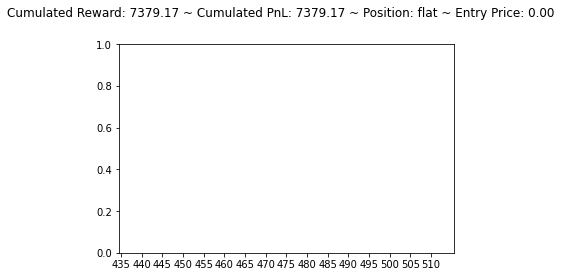

[497.72235 409.29025 680.89044]
flat sell short


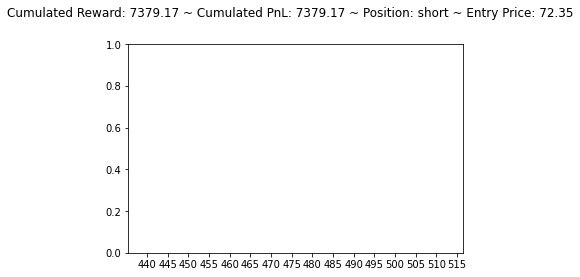

[673.22925 712.6107  670.6992 ]
short buy flat


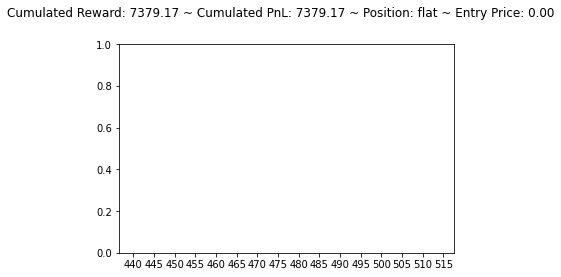

[835.7664 761.0306 830.9823]
flat hold flat


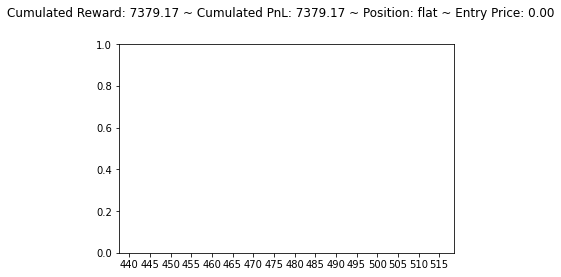

[745.9033 777.0596 839.6858]
flat sell short


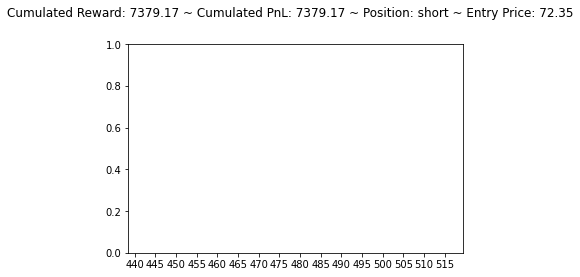

[777.236   827.9615  912.73444]
short buy flat


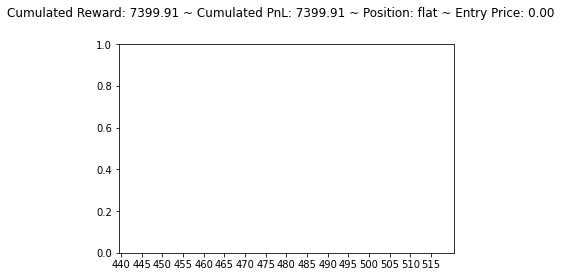

[800.40796 858.14734 921.65   ]
flat sell short


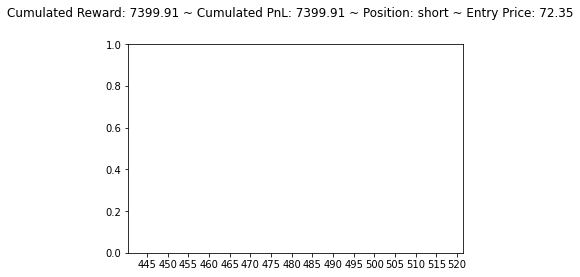

[859.47015 905.3017  981.9894 ]
short buy flat


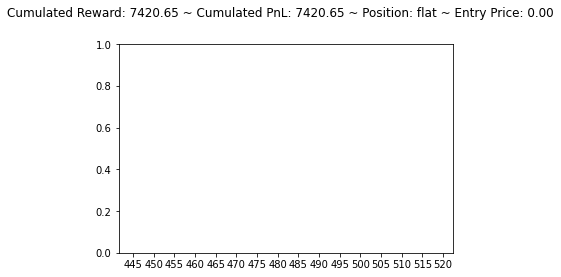

[718.7177  777.94507 844.23444]
flat sell short


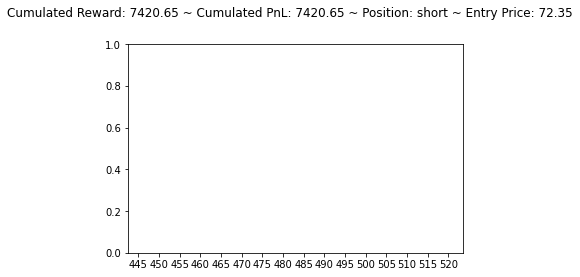

[786.8128  840.58765 903.23254]
short buy flat


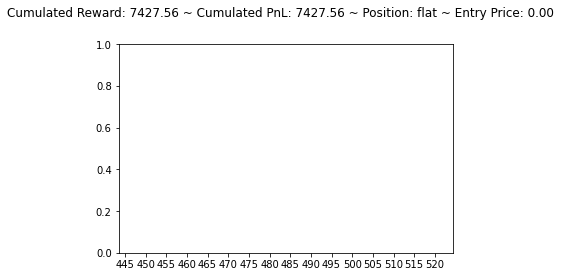

[715.10675 787.45715 865.3678 ]
flat sell short


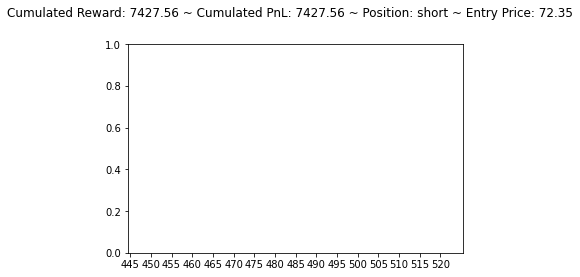

[784.5832 835.9381 885.9346]
short buy flat


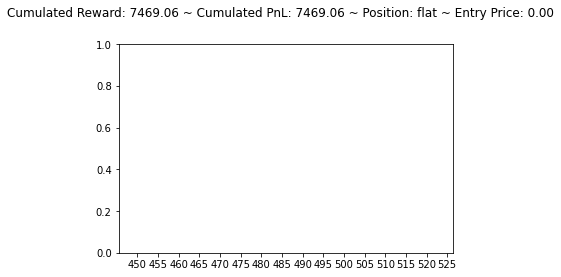

[679.79144 770.1937  830.8414 ]
flat sell short


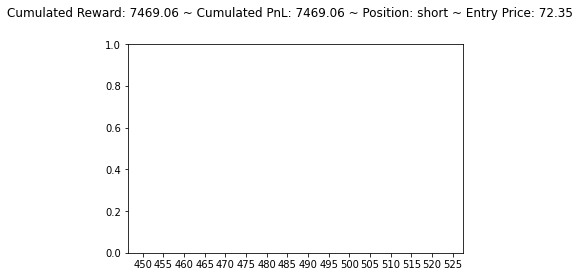

[780.9365  586.68506 922.732  ]
short hold short


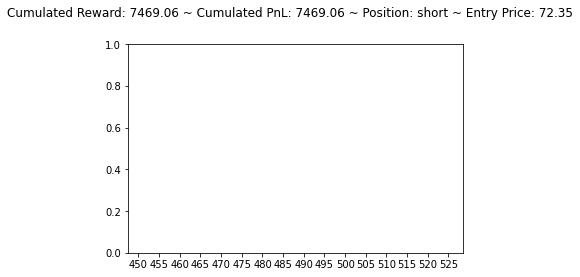

[1090.0634   937.04895  968.7159 ]
short hold short


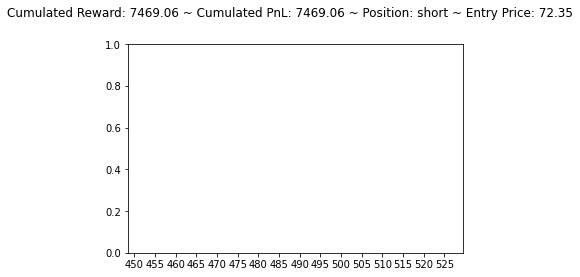

[826.142   871.50385 678.7445 ]
short buy flat


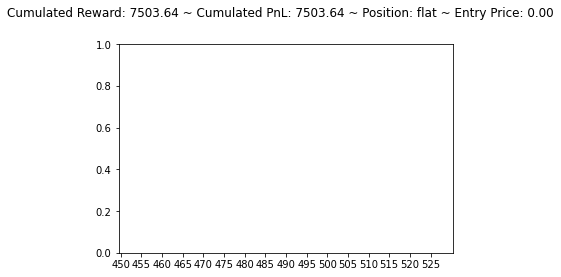

[620.3958  665.90063 773.48505]
flat sell short


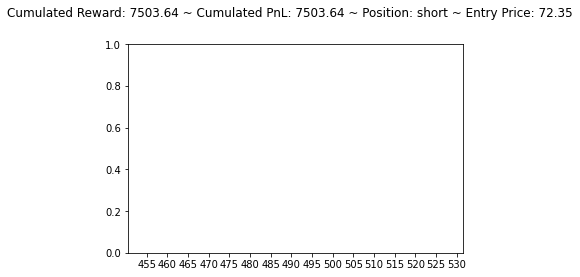

[708.5451  768.0592  850.31976]
short buy flat


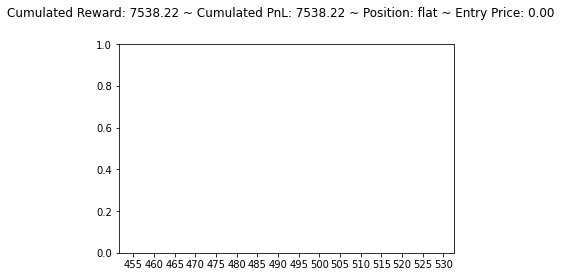

[571.9767 630.6621 724.0806]
flat sell short


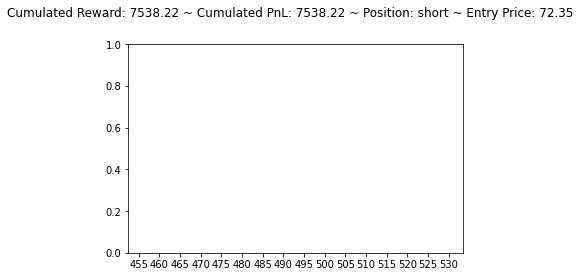

[657.5692  716.589   804.66504]
short buy flat


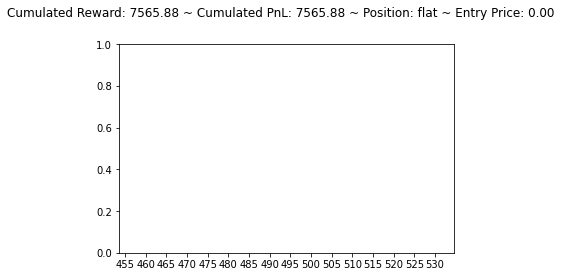

[617.3573 374.24   753.9845]
flat sell short


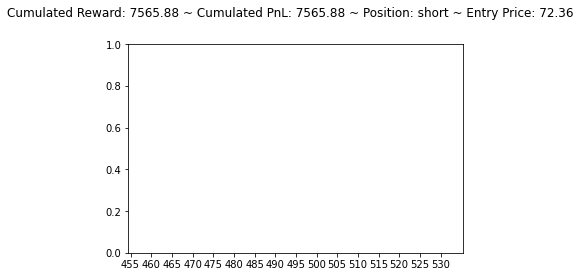

[922.67487 881.30255 890.35455]
short hold short


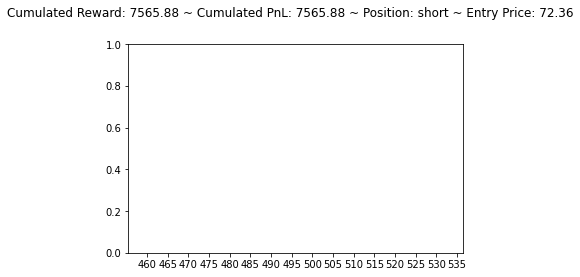

[749.0218 795.2315 726.4805]
short buy flat


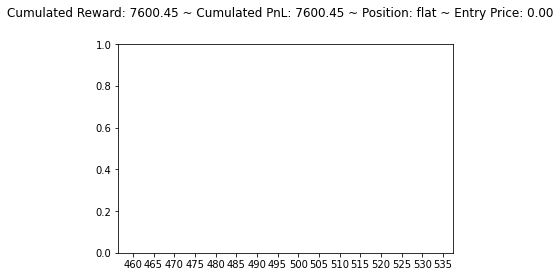

[417.38242 554.36273 642.23566]
flat sell short


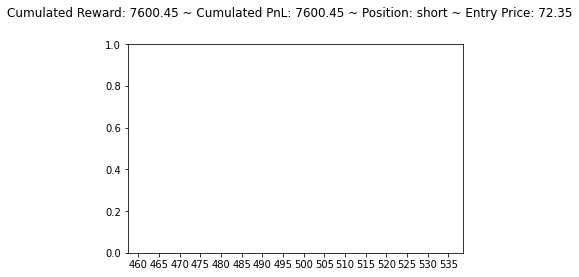

[806.1024 790.2799 771.4104]
short hold short


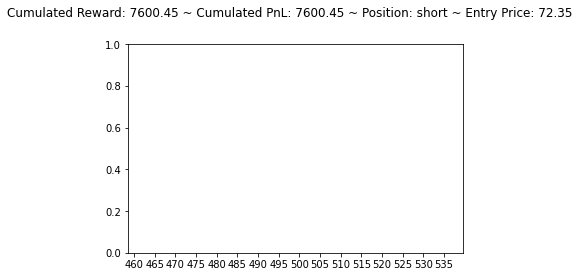

[696.26117 738.17944 837.73193]
short buy flat


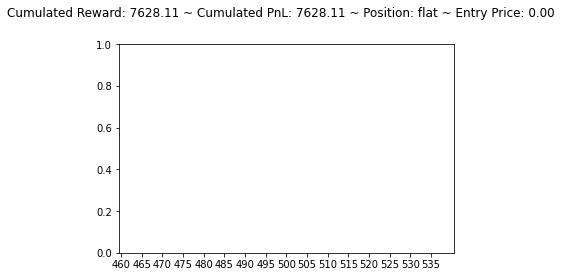

[582.2748  637.79016 725.1769 ]
flat sell short


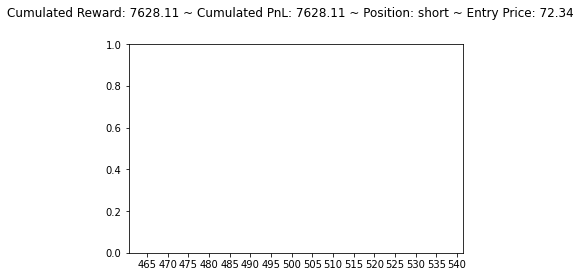

[760.525   786.28064 876.35724]
short buy flat


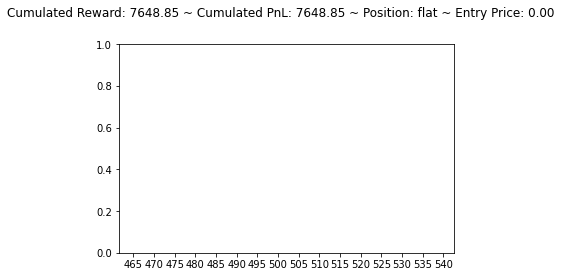

[689.3383  734.49976 836.3413 ]
flat sell short


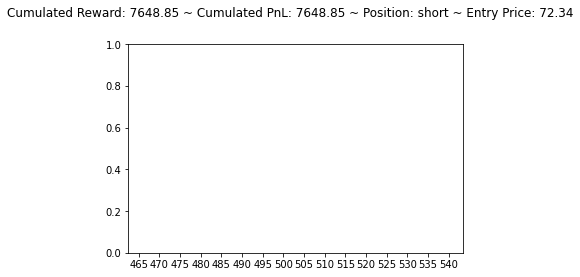

[774.4826  795.07935 891.2191 ]
short buy flat


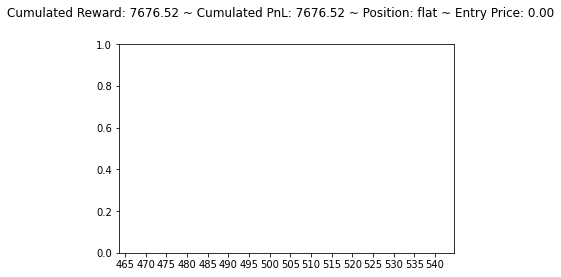

[688.0983 732.3548 828.5912]
flat sell short


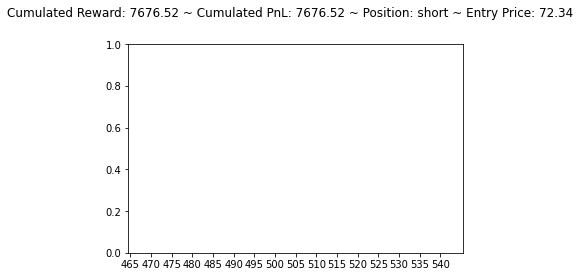

[714.55286 760.074   807.897  ]
short buy flat


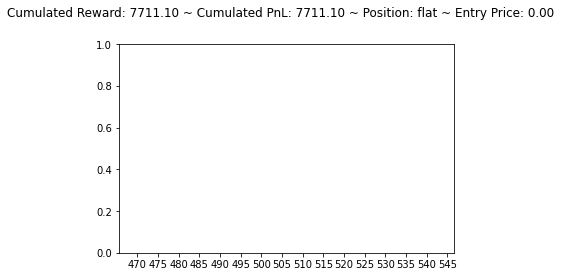

[579.0315  656.8898  714.74884]
flat sell short


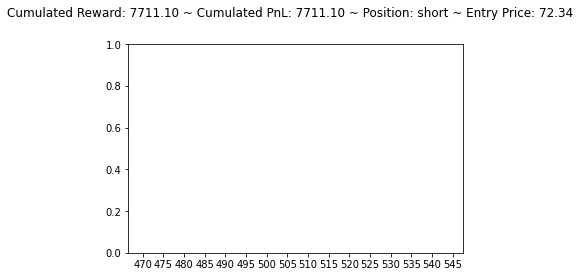

[664.2771  745.37787 817.2398 ]
short buy flat


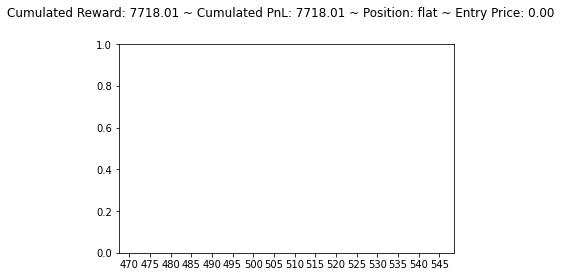

[643.91534 725.35486 780.68384]
flat sell short


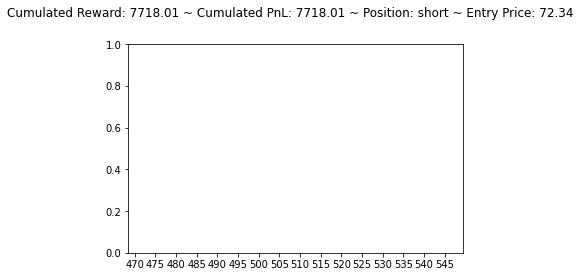

[619.14746 370.73666 745.6072 ]
short hold short


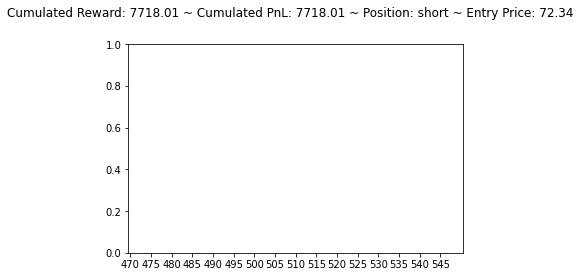

[576.89386 495.7861  688.73114]
short hold short


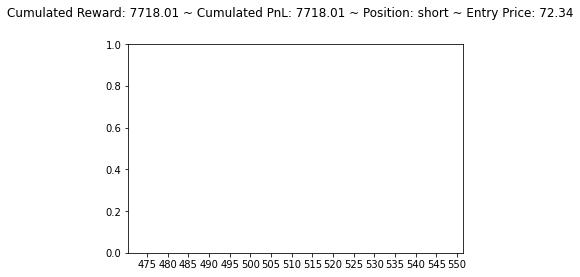

[691.1576  701.29944 747.6086 ]
short buy flat


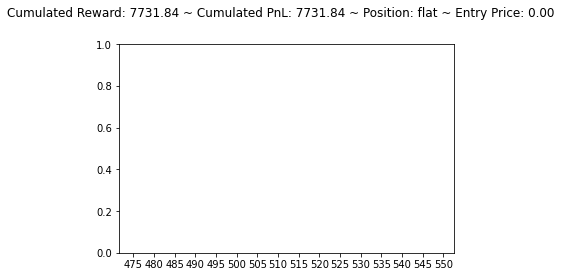

[795.7893 763.0564 811.4971]
flat sell short


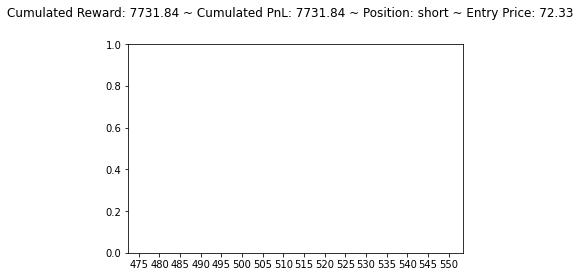

[836.39844 872.6604  626.50885]
short buy flat


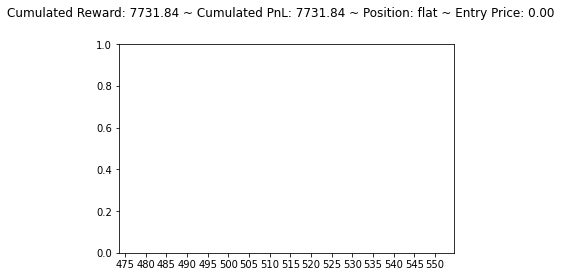

[731.0936  768.64185 875.51135]
flat sell short


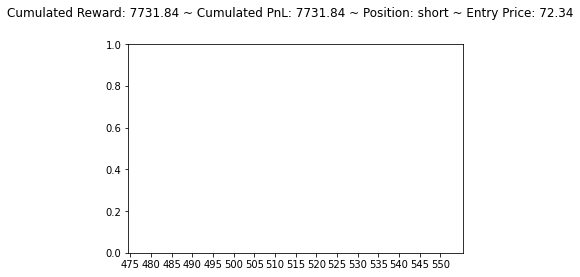

[677.4616 717.7367 813.1885]
short buy flat


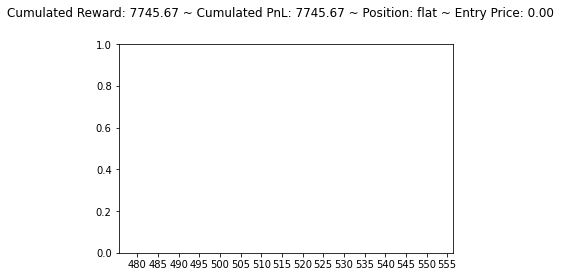

[367.39948 572.25256 662.76685]
flat sell short


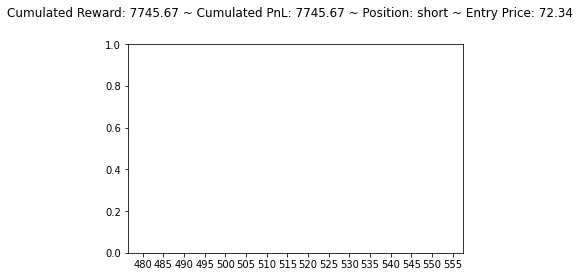

[492.0111  666.8324  708.41187]
short buy flat


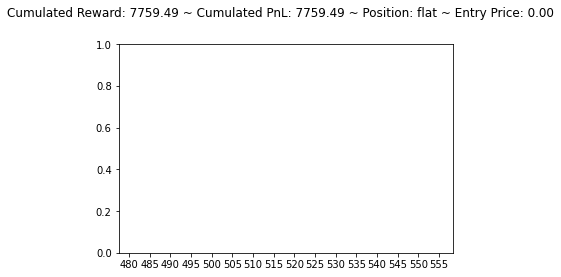

[524.1513  590.73096 643.5609 ]
flat sell short


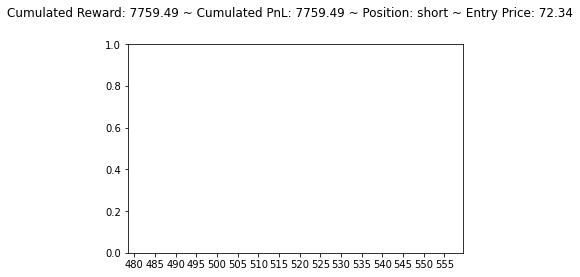

[614.0842  688.3467  736.73126]
short buy flat


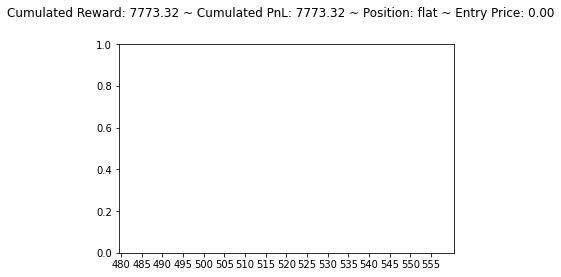

[796.05334 428.9486  782.5299 ]
flat hold flat


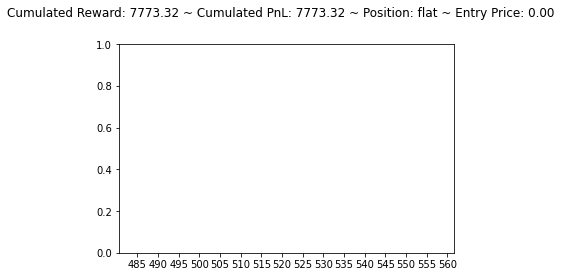

[866.18256 925.16833 826.40546]
flat buy long


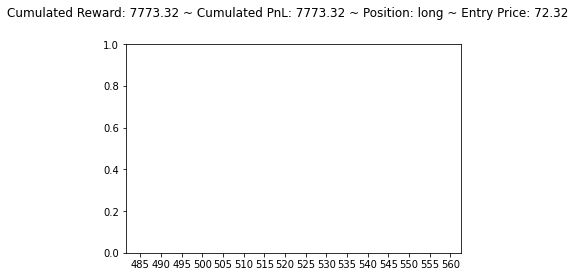

[ 989.0164 1024.7877  889.9661]
long hold long


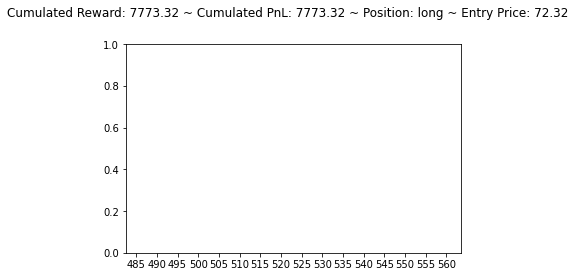

[922.1712  971.75793 826.28284]
long hold long


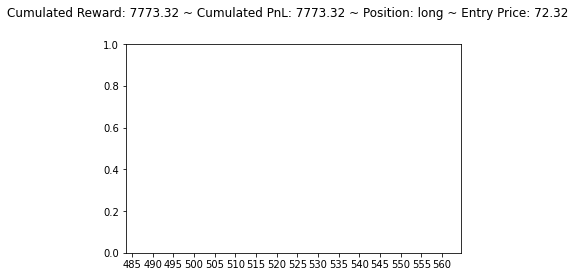

[898.95404 921.2571  830.52515]
long hold long


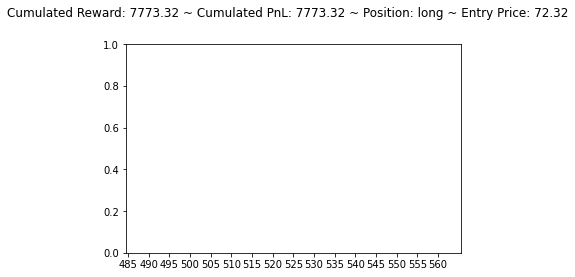

[973.2664  911.6708  898.31213]
long hold long


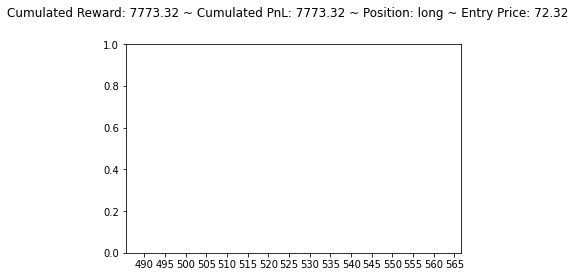

[773.54144 813.9722  692.2393 ]
long hold long


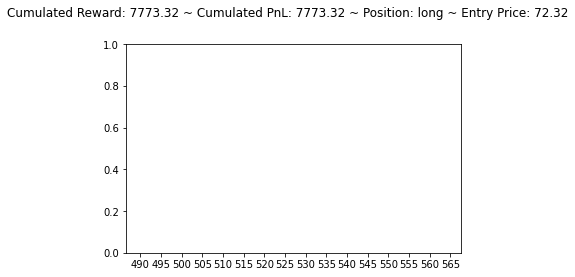

[925.202  752.5989 927.3512]
long sell flat


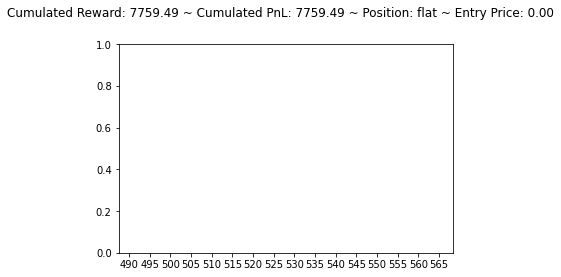

[930.04376 822.00745 881.04535]
flat hold flat


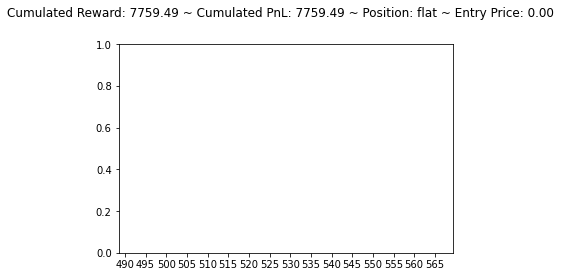

[655.54486 766.6592  598.6833 ]
flat buy long


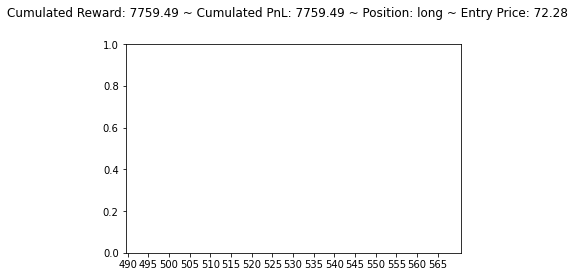

[1068.649  1027.8379  950.7372]
long hold long


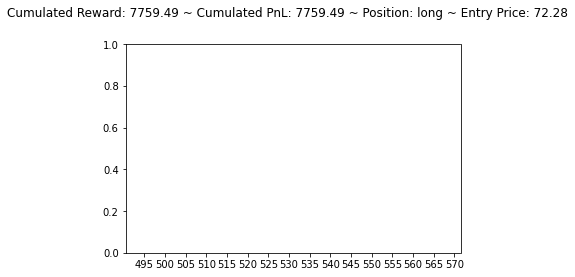

[1094.6942  1188.5334  1008.63544]
long hold long


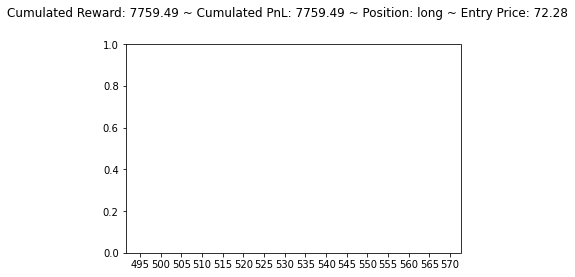

[1003.63995 1050.9945   910.9359 ]
long hold long


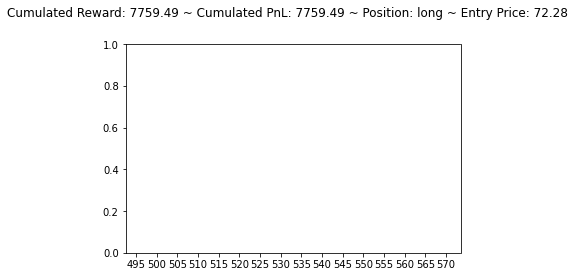

[ 989.9162  1003.5131   859.10736]
long hold long


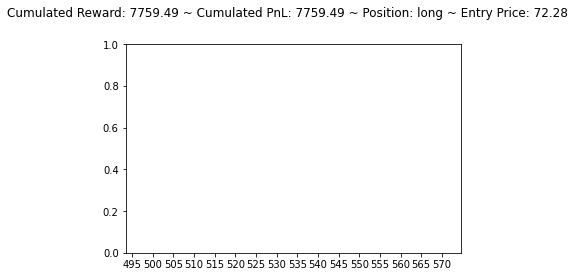

[1091.3462  1079.0182   899.85724]
long hold long


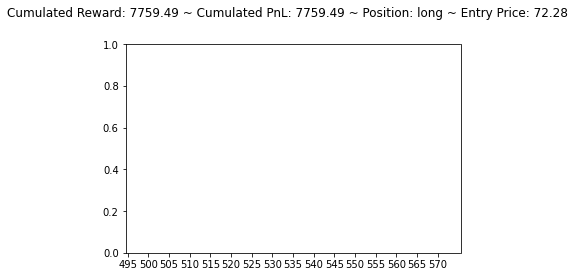

long sell flat


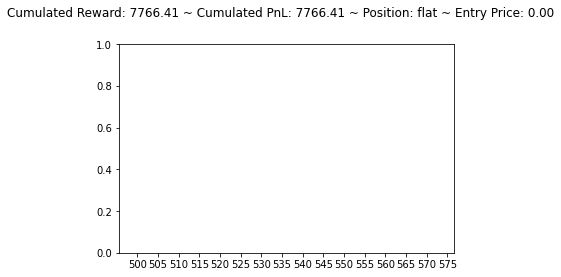

[872.09436 837.5789  812.6376 ]
flat hold flat


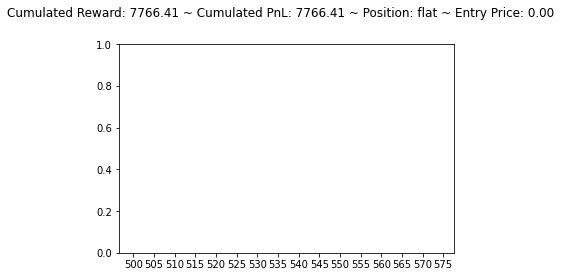

[701.6507  822.05743 605.5963 ]
flat buy long


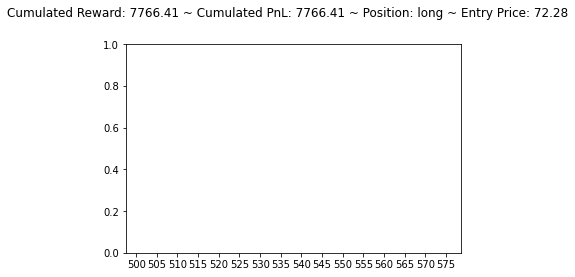

[877.51825 952.5289  805.4958 ]
long hold long


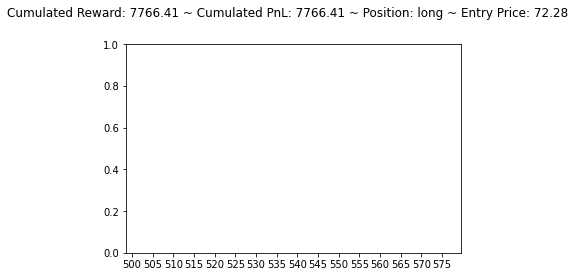

[853.63086 936.2488  799.01337]
long hold long


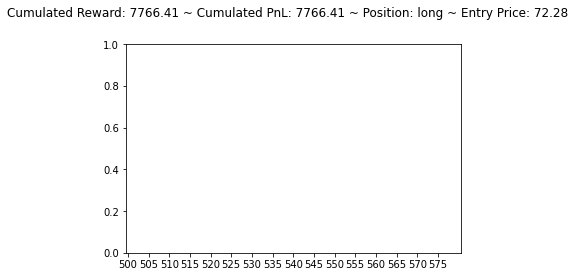

[1029.5311   972.24664  869.9416 ]
long hold long


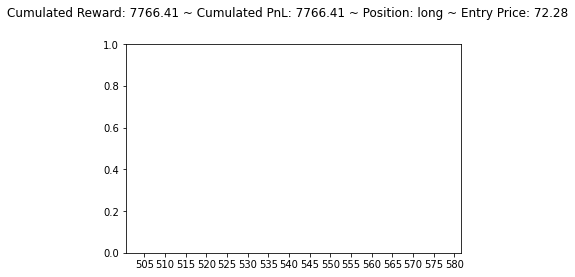

[1052.4412 1077.6774 1040.9485]
long hold long


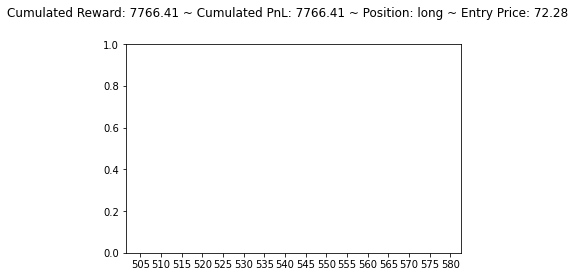

[1165.3969 1182.9845 1114.7649]
long hold long


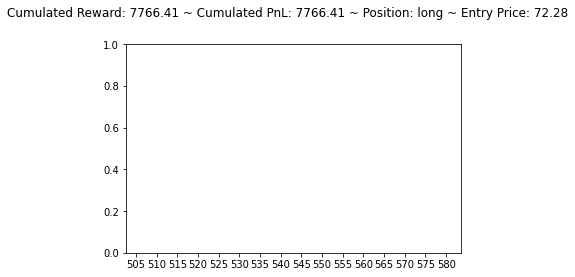

[1077.4532 1285.5579 1114.3638]
long sell flat


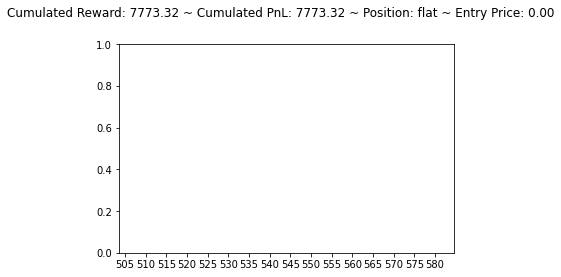

[1031.357  1096.5582 1011.9673]
flat buy long


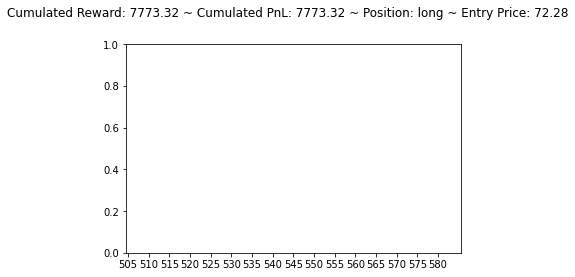

[1236.926  1278.0171 1142.9498]
long hold long


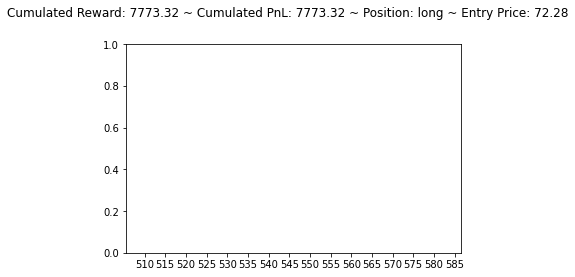

[1227.5153 1247.8344 1125.6156]
long hold long


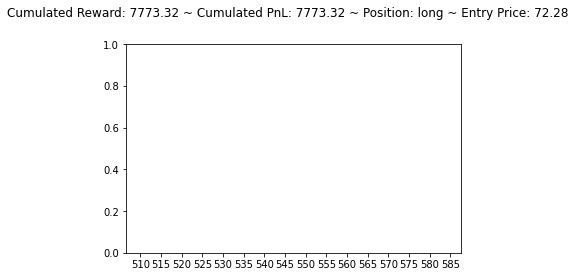

[1182.8685 1175.3098 1085.0604]
long hold long


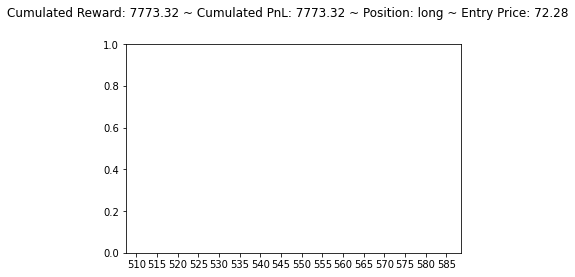

[1057.8026 1143.168  1033.0092]
long hold long


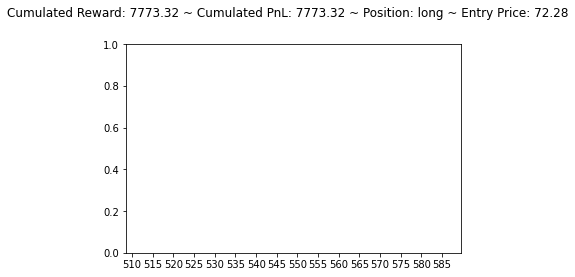

[1145.923  1145.732   975.9289]
long hold long


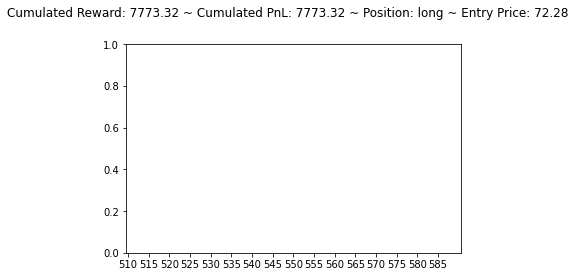

[1161.1146 1183.966  1026.225 ]
long hold long


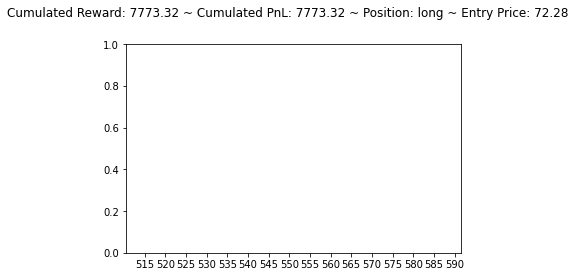

[1159.7262 1175.318  1013.138 ]
long hold long


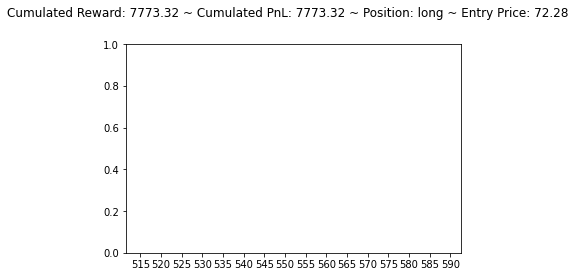

[928.72906 844.5625  678.1226 ]
long hold long


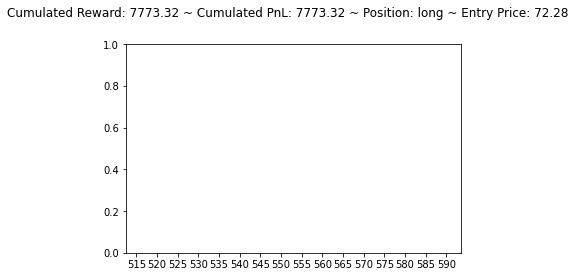

[556.15784 665.0455  749.29596]
long sell flat


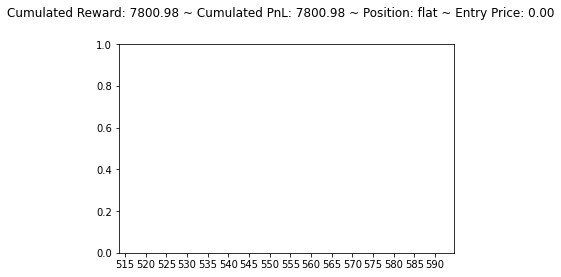

[683.6461  684.5023  849.86554]
flat sell short


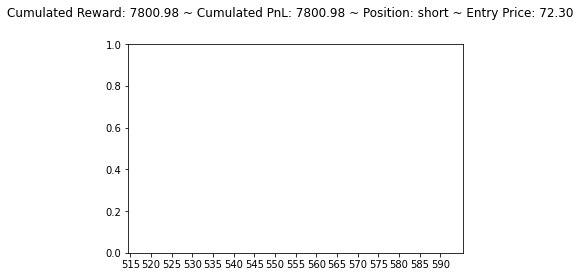

[1166.2107  1049.4847   997.27826]
short hold short


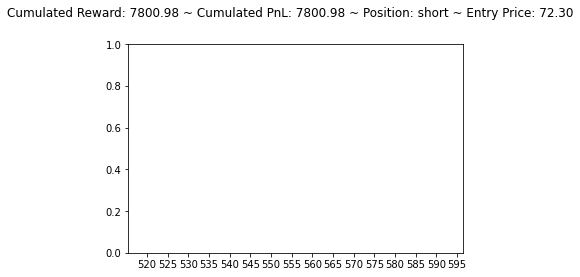

[1002.2127  1082.3927   885.28015]
short buy flat


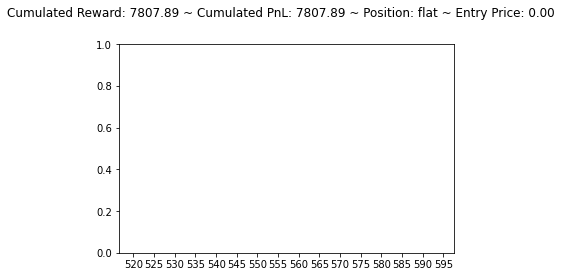

[728.01807 814.28015 710.074  ]
flat buy long


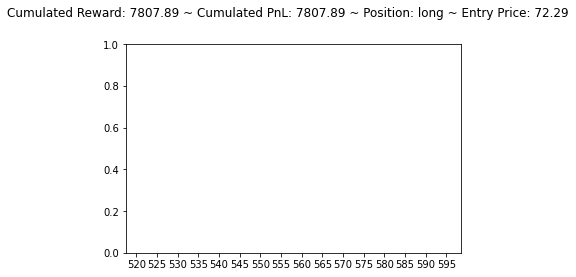

[1018.4597   977.7082   886.55914]
long hold long


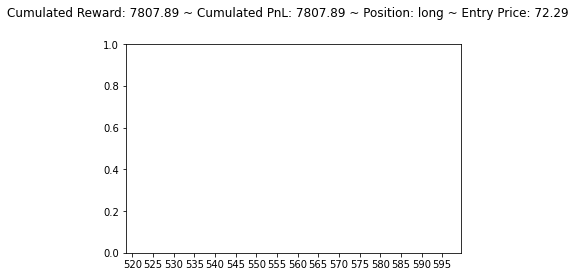

[871.1159 924.8789 787.7017]
long hold long


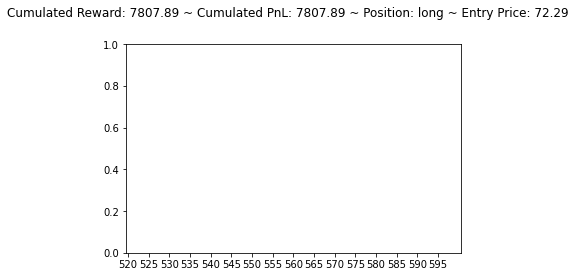

[1060.2112  897.0657  926.5792]
long hold long


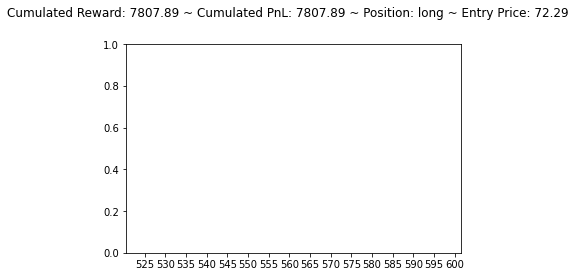

[918.02997 983.9941  772.87   ]
long hold long


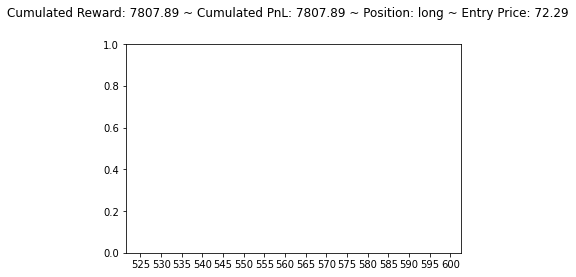

[1187.4364 1142.86   1068.0193]
long hold long


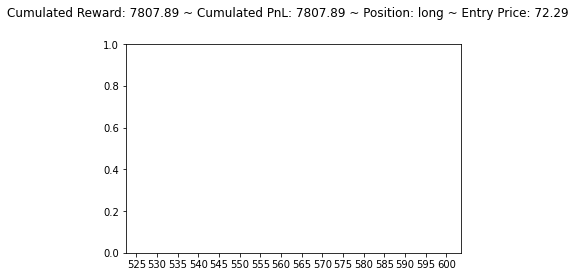

[ 962.6831   798.85065 1061.5632 ]
long sell flat


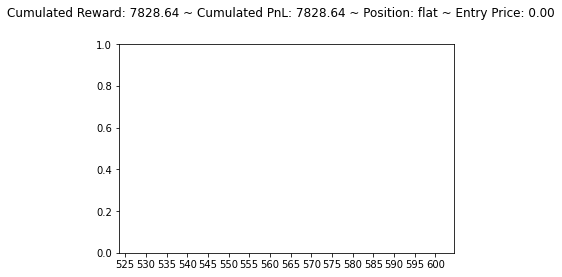

[422.7752 586.3848 668.129 ]
flat sell short


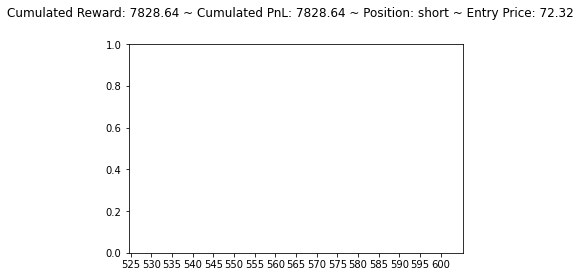

[566.27216 617.69836 704.19257]
short buy flat


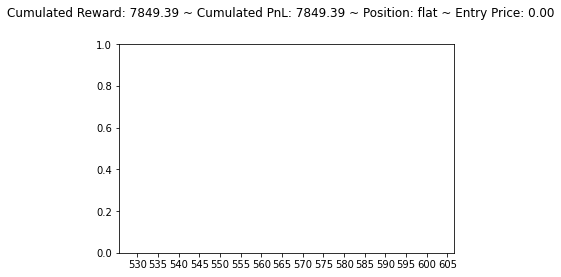

[574.2233  605.64197 668.8233 ]
flat sell short


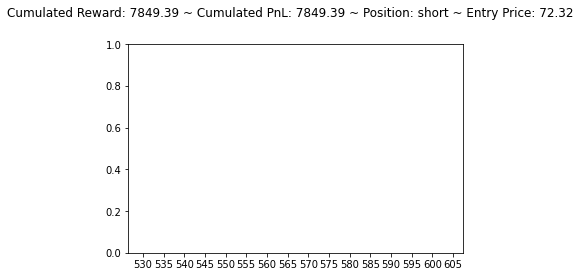

[714.5086  548.076   852.39355]
short hold short


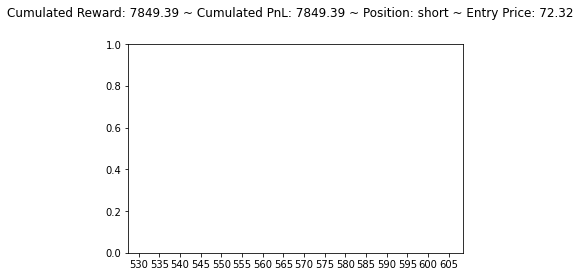

[888.0201  833.98914 871.4273 ]
short hold short


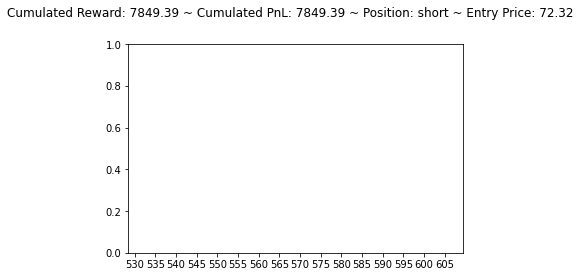

[930.17255 854.53094 873.27246]
short hold short


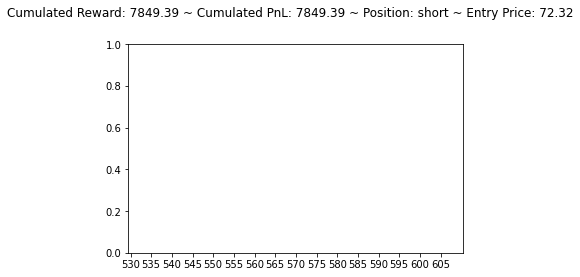

[940.6687  862.79425 874.45123]
short hold short


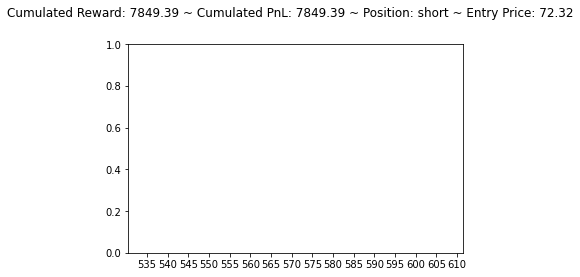

[932.1817  788.15204 889.7509 ]
short hold short


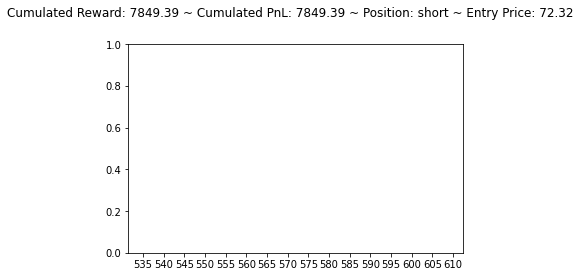

[778.44336 640.4262  769.93066]
short hold short


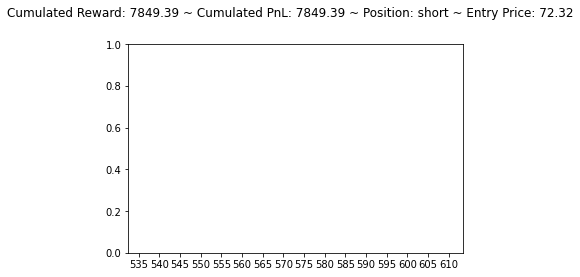

[731.1395  569.97327 720.92267]
short hold short


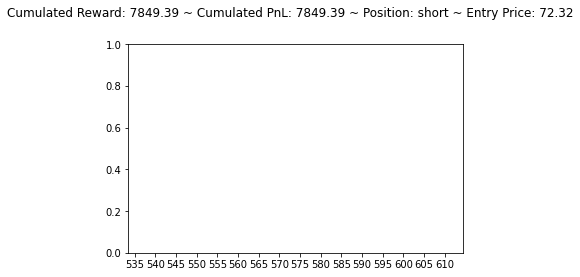

[763.4757  991.2895  794.02747]
short buy flat


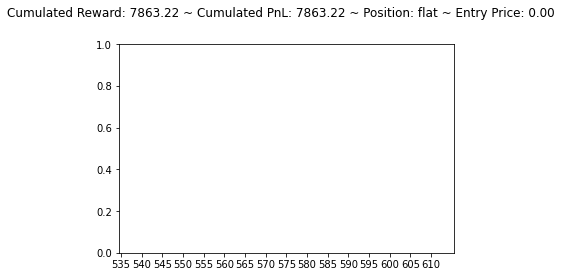

[1101.9987 1142.9852 1057.9912]
flat buy long


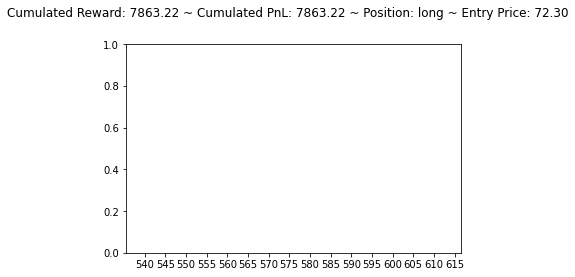

[1272.7759 1312.0698 1163.1672]
long hold long


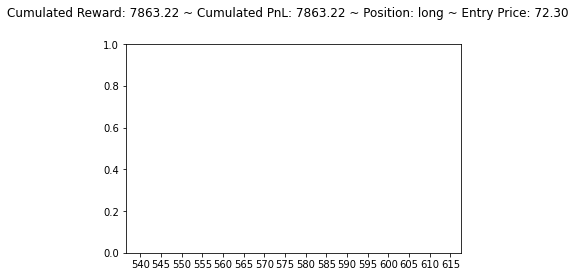

[1271.8833 1302.8243 1171.6089]
long hold long


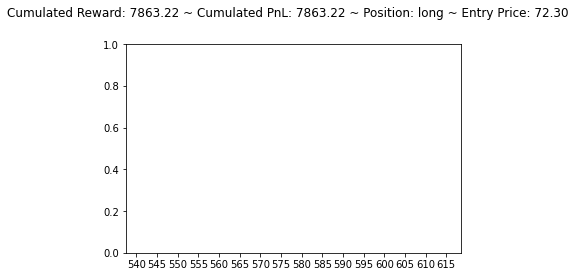

[1275.9418 1319.3718 1165.1489]
long hold long


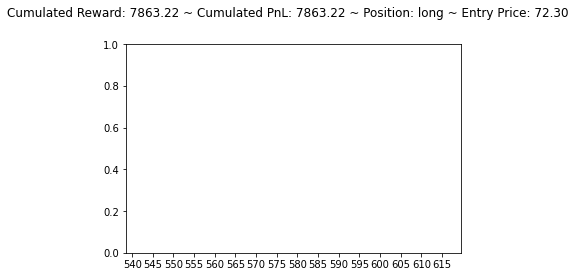

[1274.7189 1296.4935 1170.1882]
long hold long


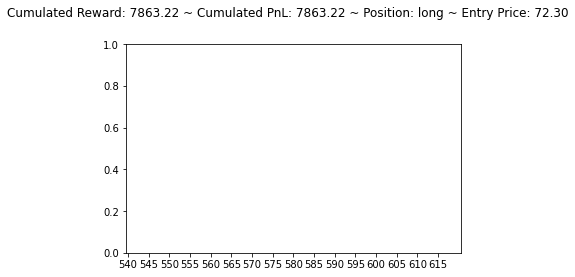

[1264.1588 1290.3873 1161.7594]
long hold long


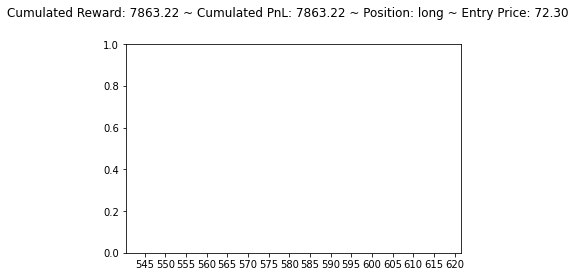

[1263.5032 1288.4854 1162.5629]
long hold long


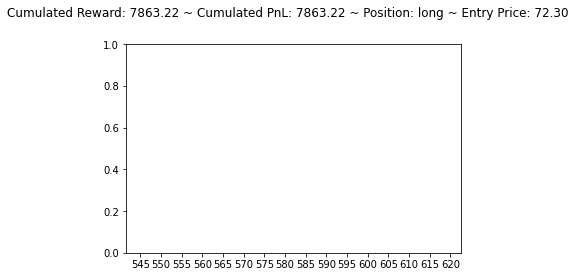

[1263.5109 1289.0162 1161.9918]
long hold long


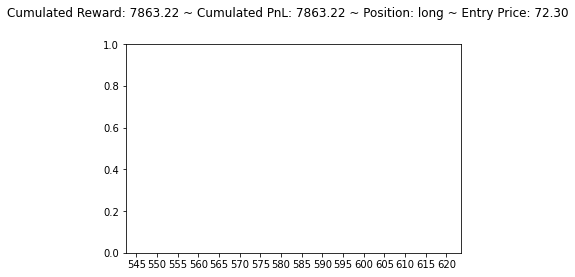

[1249.7899 1303.7762 1143.1124]
long hold long


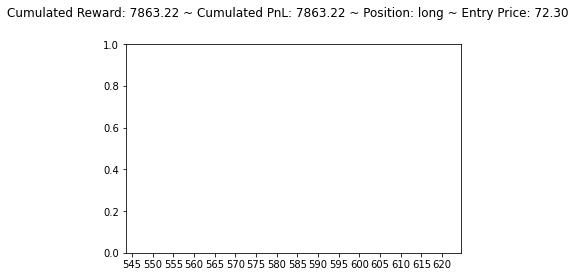

[1267.4574 1288.4623 1170.4082]
long hold long


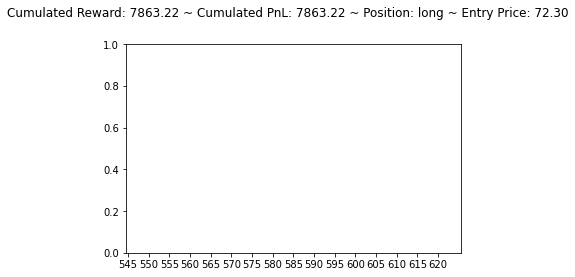

[1268.23   1294.423  1163.9546]
long hold long


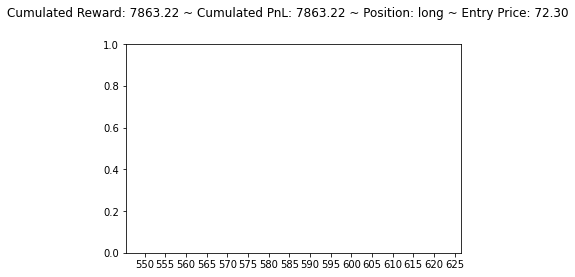

[ 971.87366 1077.4027   955.3496 ]
long hold long


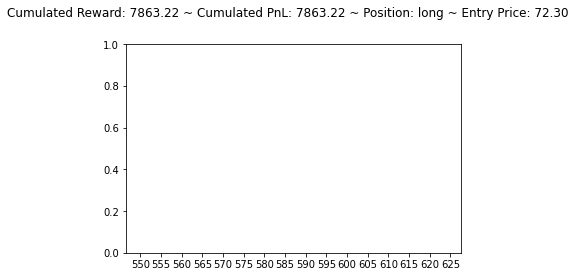

[ 968.63446 1077.9146  1015.23926]
long sell flat


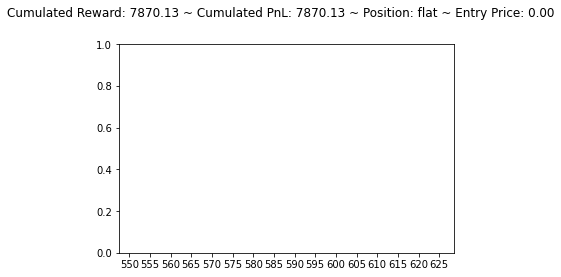

[1043.7772 1047.9108  971.5171]
flat buy long


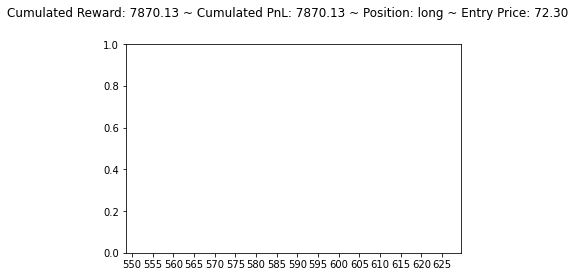

[885.6066 993.0626 645.6543]
long hold long


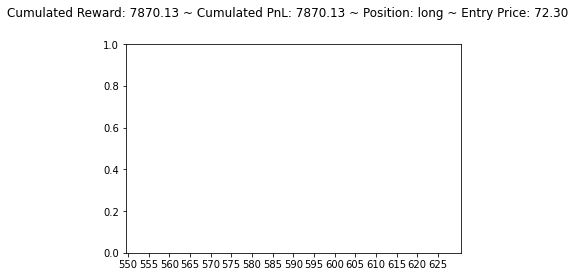

[545.9745  590.9685  711.18555]
long sell flat


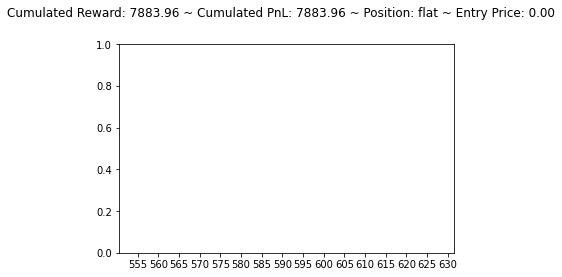

[474.77222 534.7142  620.5898 ]
flat sell short


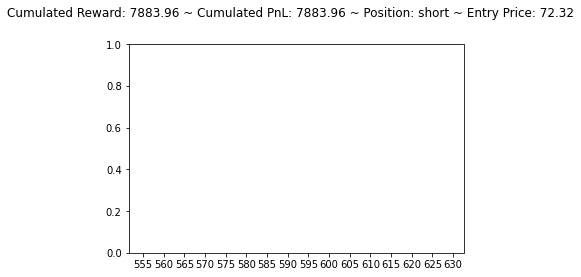

[550.64343 593.24194 691.77026]
short buy flat


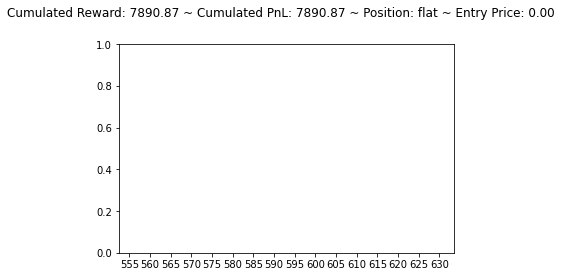

[417.70505 479.4571  626.49646]
flat sell short


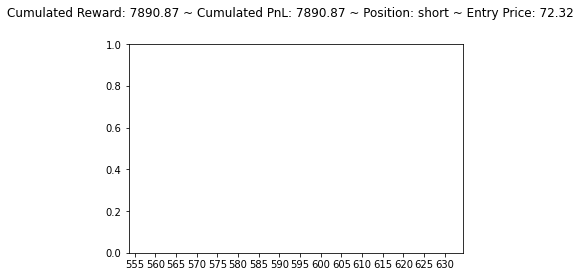

[493.56613 604.6376  703.4033 ]
short buy flat


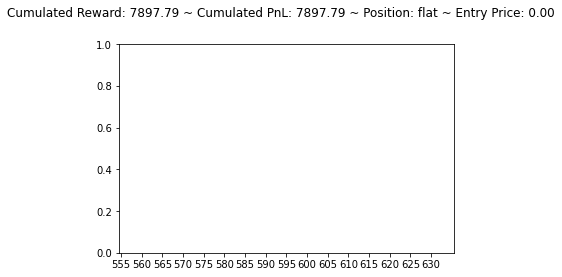

[409.5276  517.31476 609.41956]
flat sell short


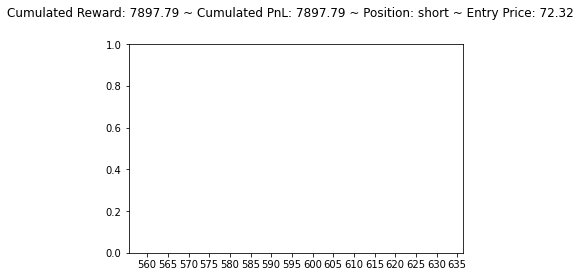

[1039.0924 1033.1117 1003.5977]
short hold short


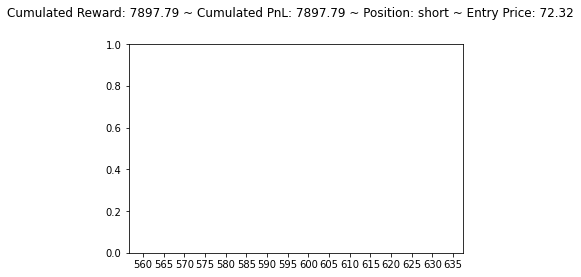

[ 915.488   1062.2451   972.21606]
short buy flat


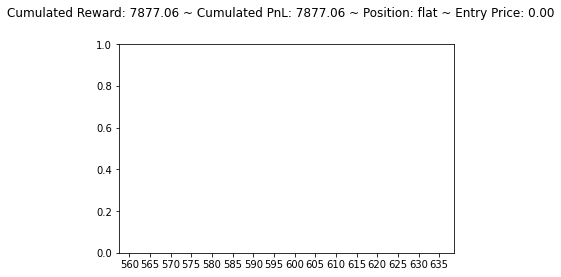

[822.5009  933.3789  893.98364]
flat buy long


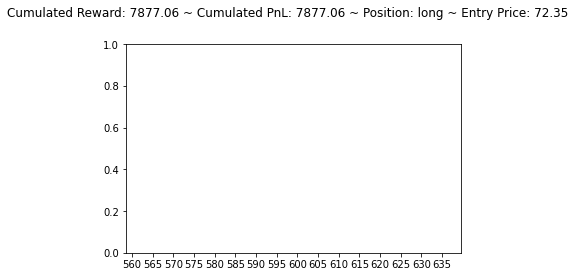

[ 976.50085 1004.43964  921.6737 ]
long hold long


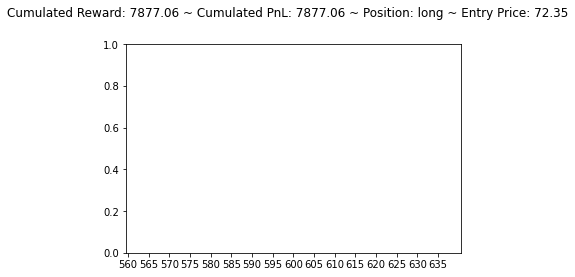

[1046.1432 1150.7205 1131.3906]
long sell flat


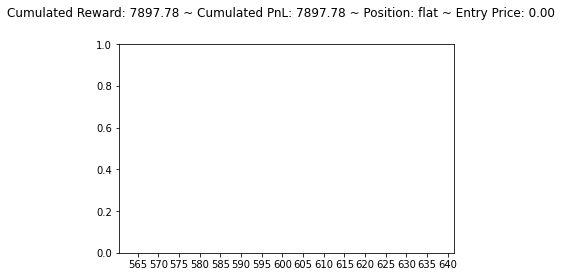

[ 921.9428 1032.4895 1002.0066]
flat buy long


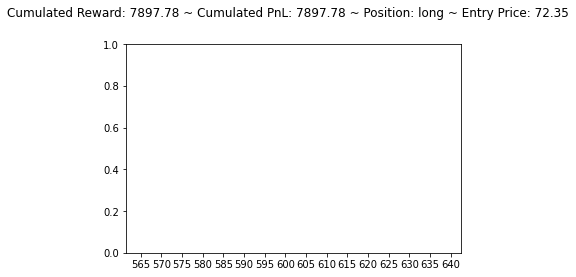

[ 955.33325 1087.7648  1013.7403 ]
long sell flat


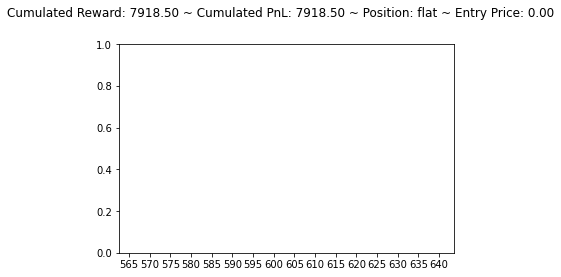

[861.0157 958.5702 934.4154]
flat buy long


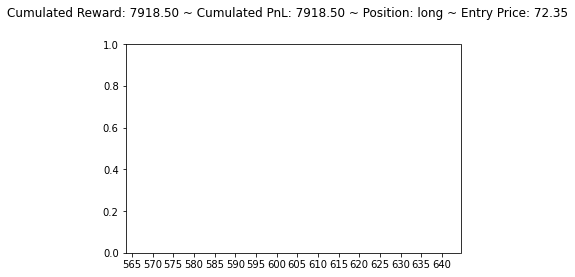

[ 974.04443 1087.1106  1018.5257 ]
long sell flat


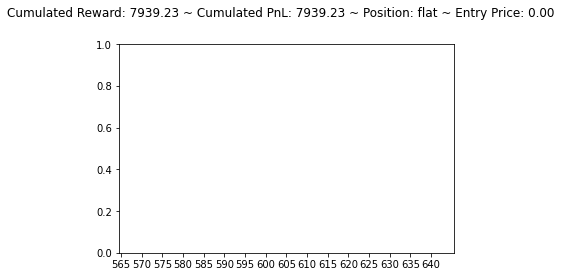

[1623.9064 1346.0131 1432.5797]
flat hold flat


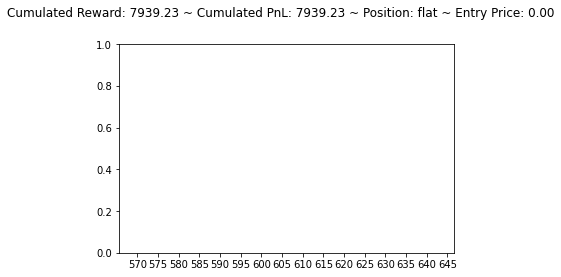

[1585.7296 1791.8799 1613.4614]
flat buy long


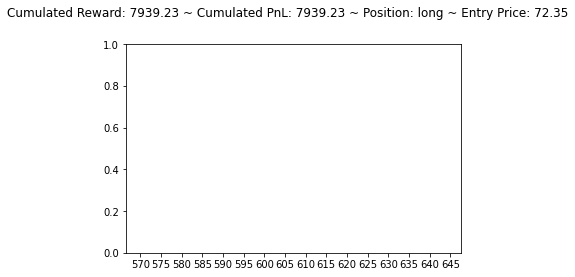

[1765.9525 1122.8213 1305.8401]
long hold long


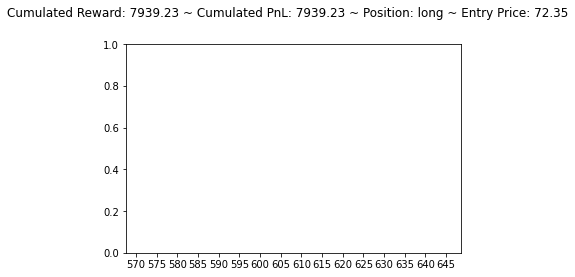

[ 913.37445 1072.9075  1009.15454]
long sell flat


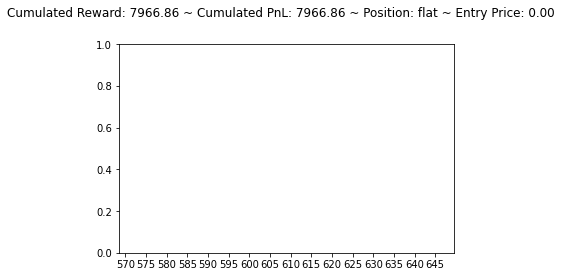

[1193.3964 1138.005   991.5056]
flat hold flat


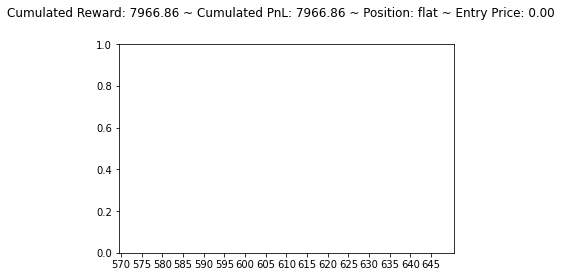

[1127.3705 1230.5258 1155.0591]
flat buy long


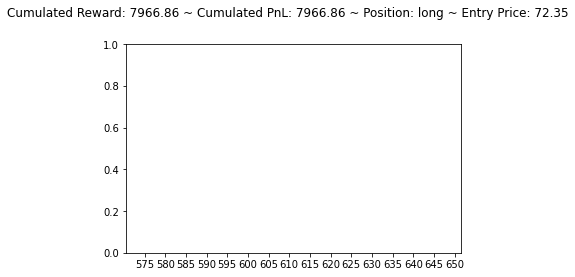

[1253.6747 1498.4677 1472.371 ]
long sell flat


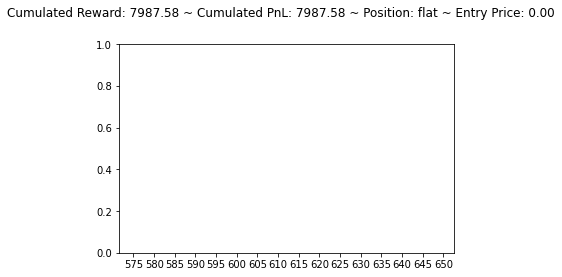

[1415.181  1513.8651 1467.3127]
flat buy long


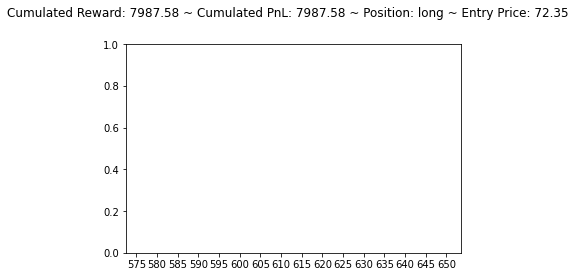

[1570.4979 1622.5353 1652.2286]
long sell flat


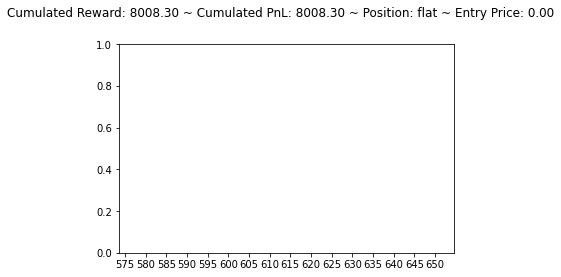

[1424.2025 1479.3895 1490.9487]
flat sell short


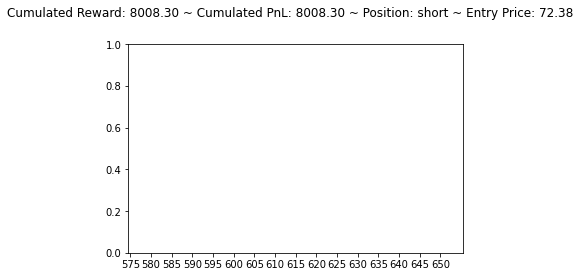

[948.828  801.0539 812.208 ]
short hold short


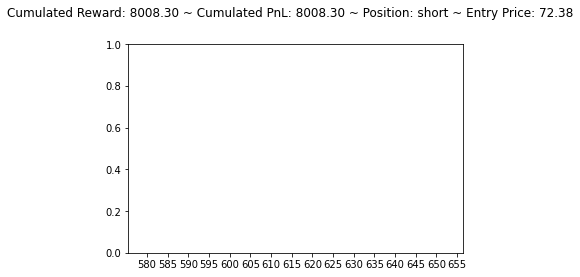

[1506.2428 1347.2557 1358.6765]
short hold short


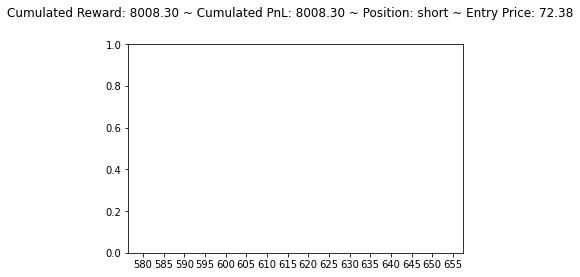

[1257.8248 1299.0148 1326.999 ]
short buy flat


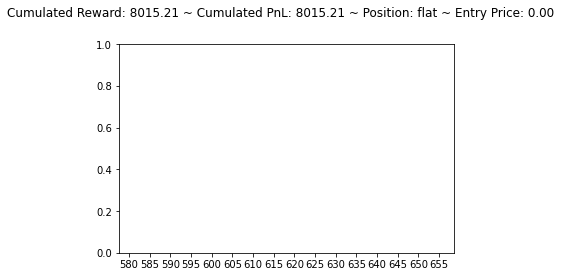

[1127.4634 1430.2213 1030.091 ]
flat buy long


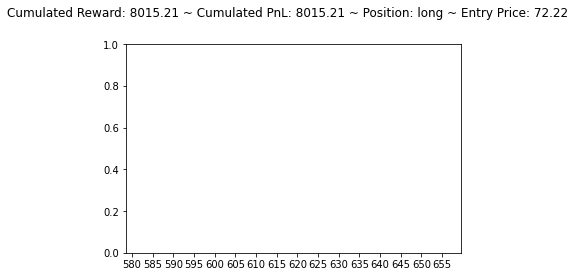

[1791.14   2033.6556 1598.7354]
long hold long


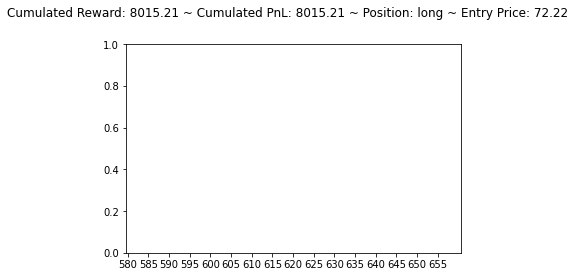

[1236.414  1791.1991 1445.5074]
long sell flat


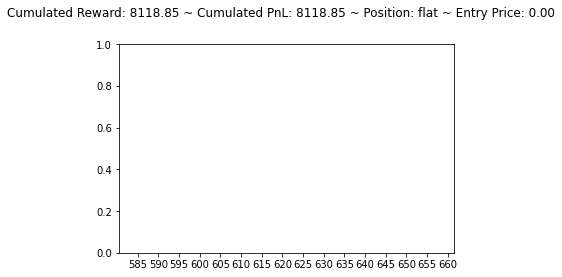

[1587.7028 1639.6548 1549.7538]
flat buy long


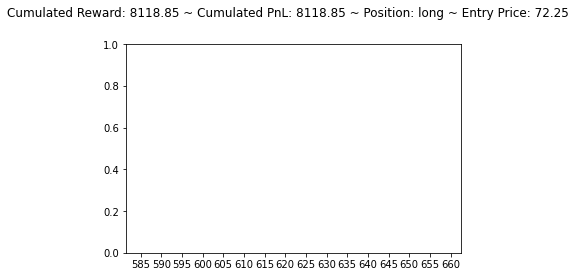

[2257.317  2240.9912 2112.2686]
long hold long


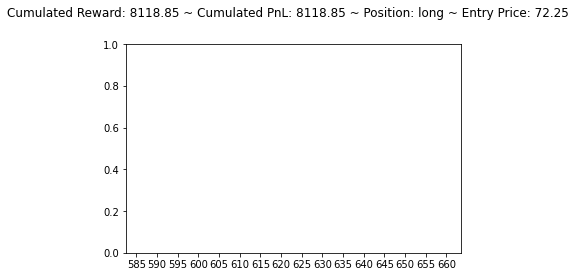

[1487.71   1246.5397 1719.266 ]
long sell flat


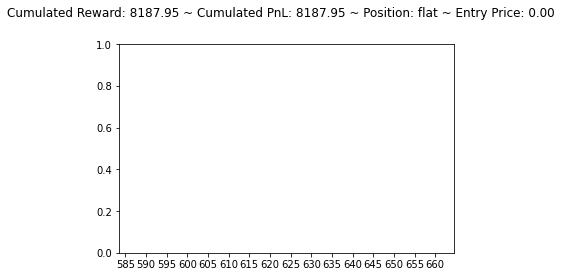

[1451.2332 1553.7156 1528.6539]
flat buy long


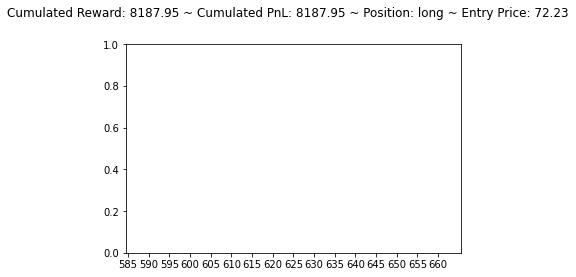

[1586.0038 1634.2643 1616.2728]
long sell flat


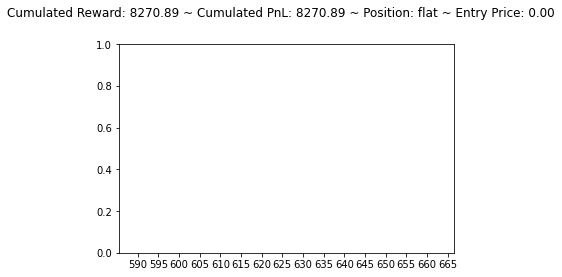

[1527.7961 1583.9844 1573.19  ]
flat buy long


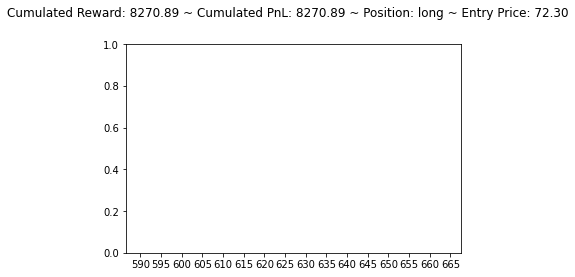

[1176.8759  675.046  1266.8536]
long sell flat


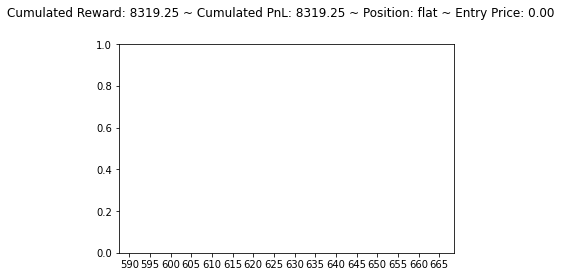

[664.07196 722.3339  772.8803 ]
flat sell short


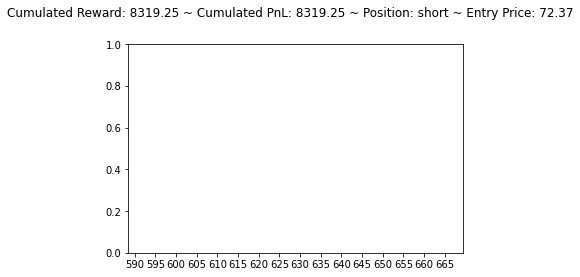

[1492.4766 1380.568  1307.9778]
short hold short


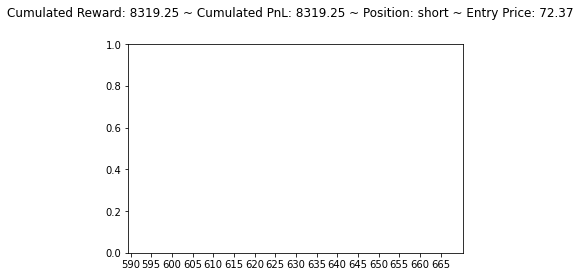

[1170.9633   398.32797 1098.5703 ]
short hold short


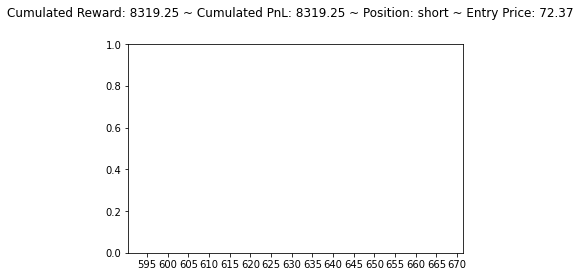

[676.1768  748.04443 822.9339 ]
short buy flat


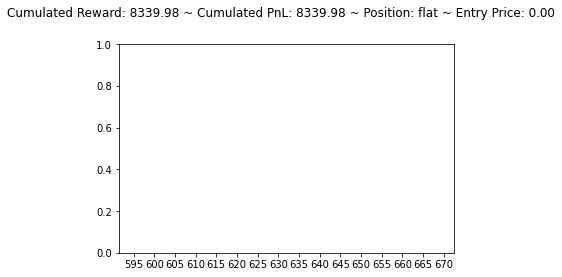

[609.6452  697.06274 752.54736]
flat sell short


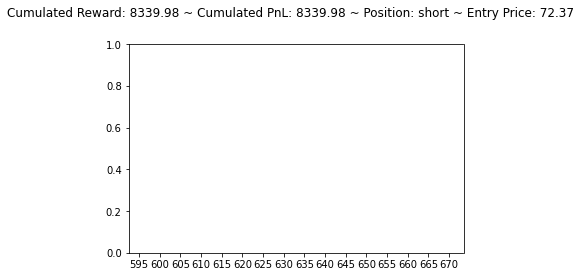

[639.18256 714.25806 789.223  ]
short buy flat


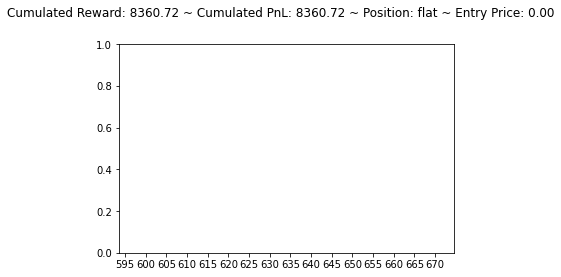

[665.0694  730.621   773.30005]
flat sell short


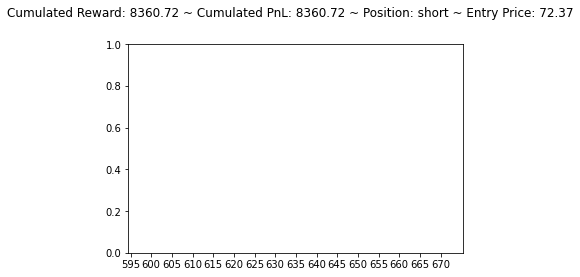

[911.5021 947.1543 982.9706]
short buy flat


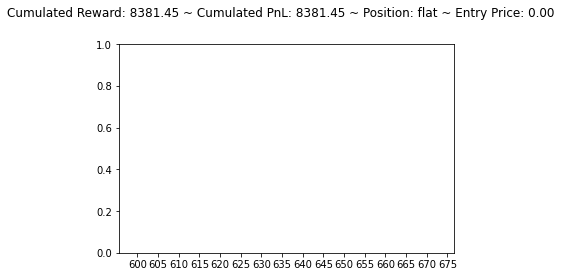

[807.2614 894.2024 926.5155]
flat sell short


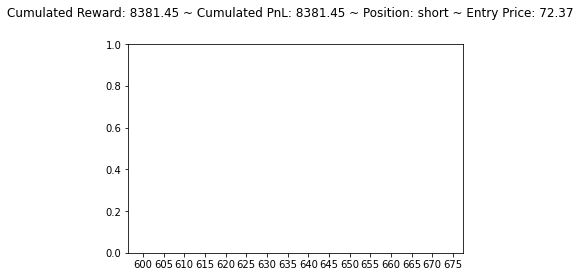

[819.2653  740.05756 894.0065 ]
short hold short


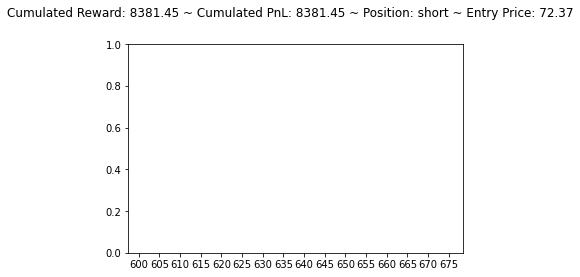

[789.57623 862.10187 659.749  ]
short buy flat


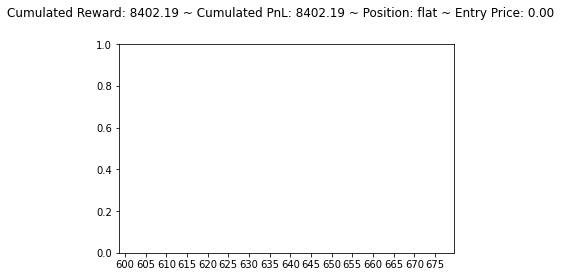

[701.42285 788.4901  834.54083]
flat sell short


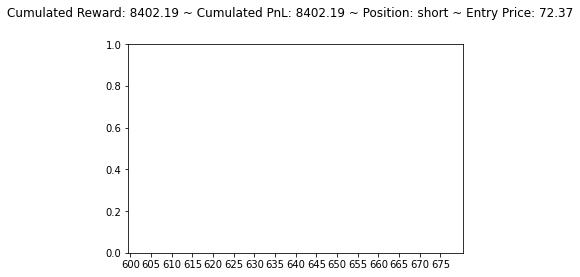

[761.3729  836.70557 896.87634]
short buy flat


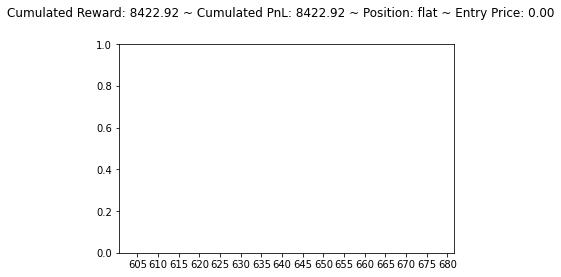

[551.3567  711.23914 833.8343 ]
flat sell short


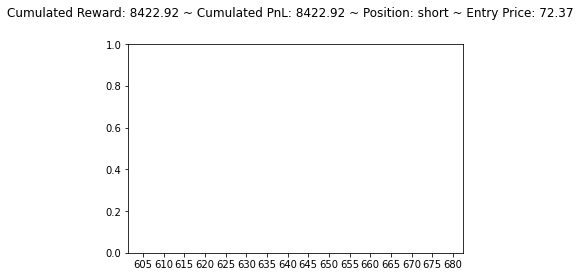

[1016.893   1093.7578   992.14465]
short buy flat


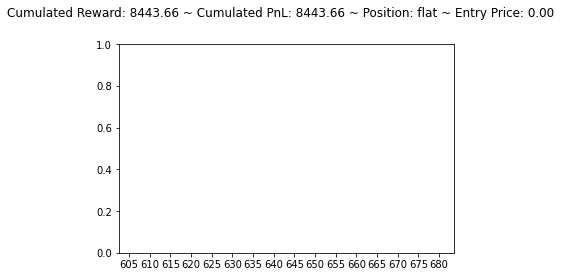

[1129.9714 1250.5437 1250.4958]
flat buy long


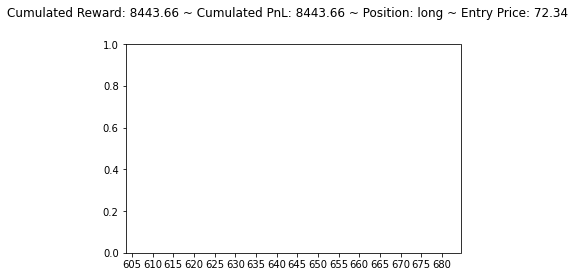

[1227.3875 1299.0646 1258.0735]
long sell flat


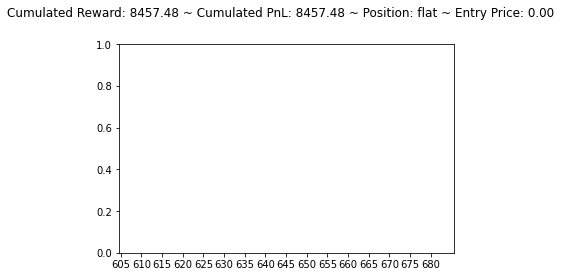

[1123.6125 1201.8676 1167.1694]
flat buy long


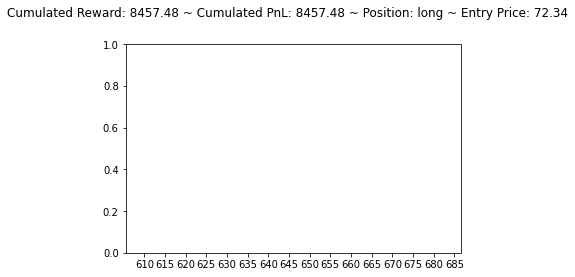

[1126.9286 1243.0525 1259.7024]
long sell flat


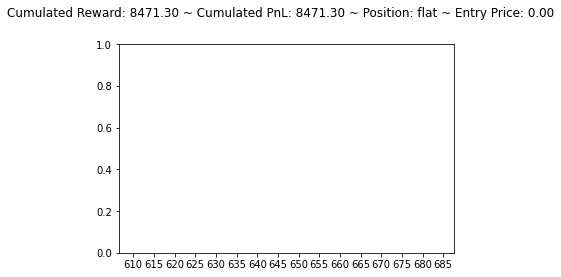

[1019.79285 1100.9965  1107.4279 ]
flat sell short


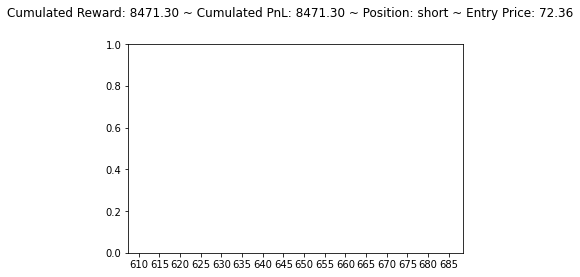

[1089.284  1174.2935 1160.6715]
short buy flat


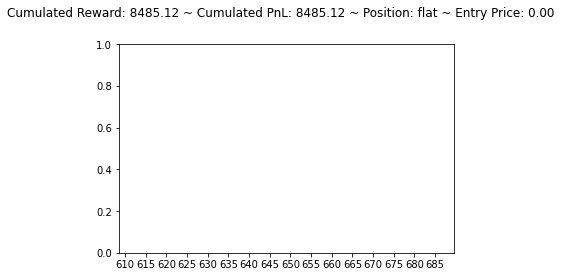

[ 958.1696 1039.2164 1027.9427]
flat buy long


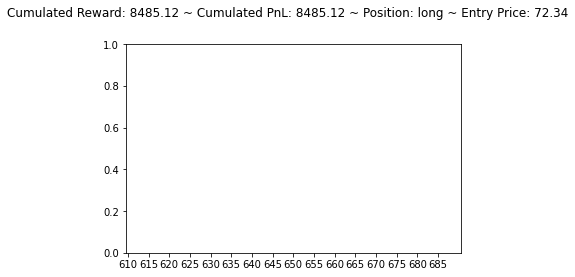

[1154.8712 1219.4152 1162.7218]
long sell flat


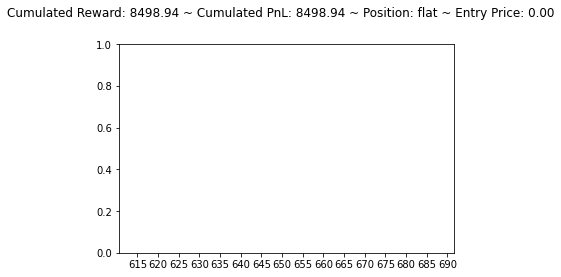

[ 965.49774 1069.0151  1007.5531 ]
flat buy long


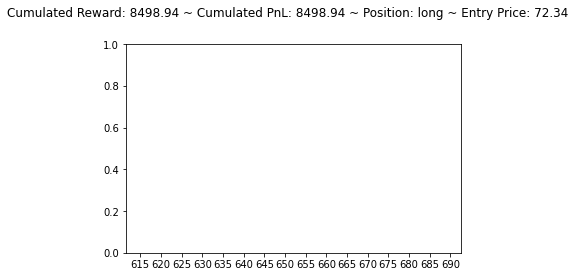

[1147.452  1200.806  1149.2593]
long sell flat


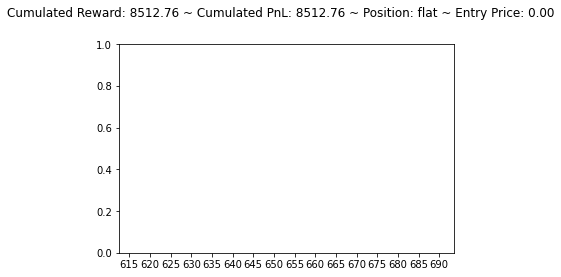

[1059.9542 1154.007  1093.3416]
flat buy long


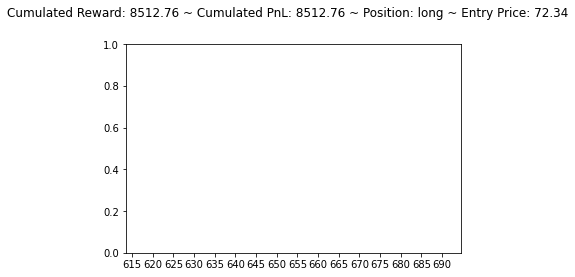

[ 950.6134  1083.4772  1004.76495]
long sell flat


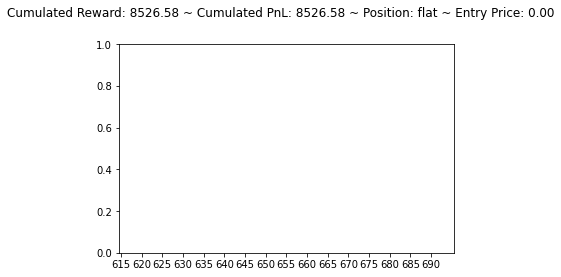

[855.8643 946.2293 925.8181]
flat buy long


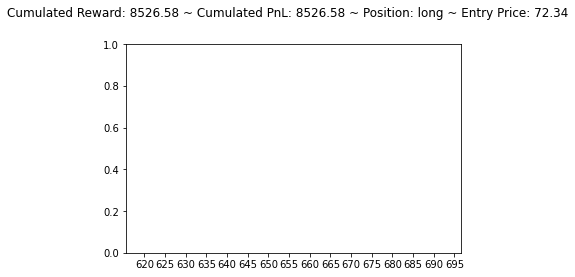

[ 937.63934 1058.5251   985.14215]
long sell flat


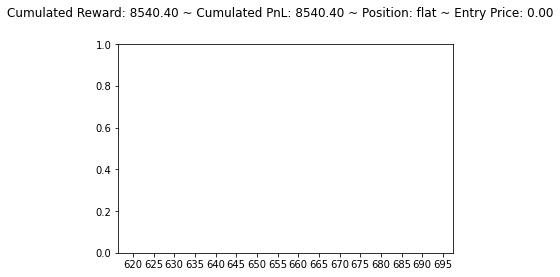

[910.4684  995.941   951.49316]
flat buy long


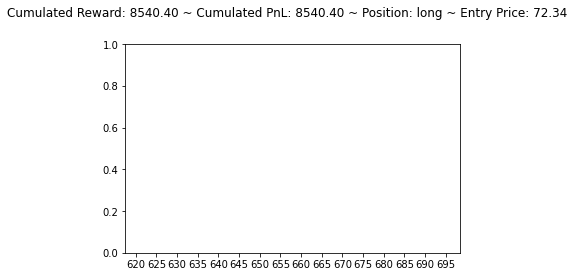

[ 987.88324 1085.122    987.6443 ]
long hold long


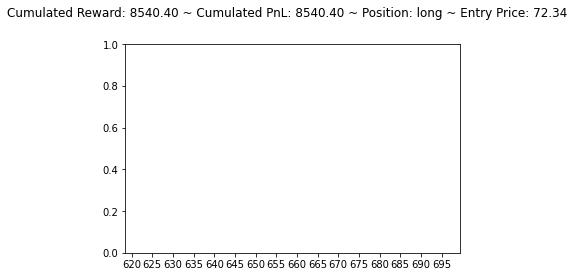

[697.2357  891.58923 794.3536 ]
long sell flat


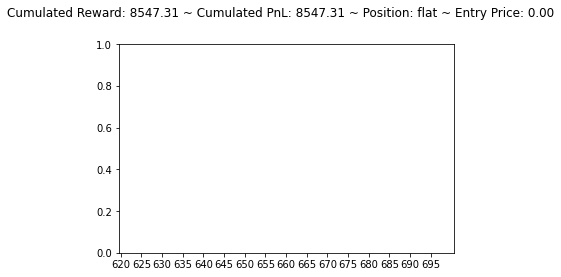

[767.888  729.1511 628.4649]
flat hold flat


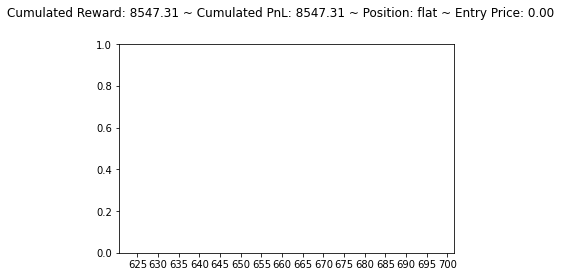

[1001.7798 1052.6351 1039.932 ]
flat buy long


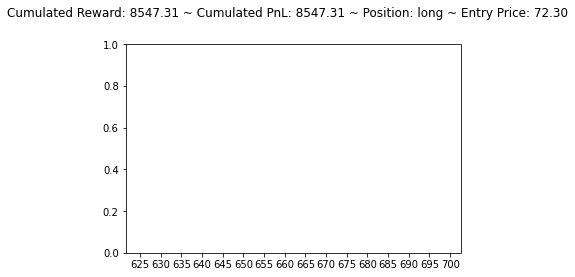

[1125.9651 1478.3024 1239.8896]
long sell flat


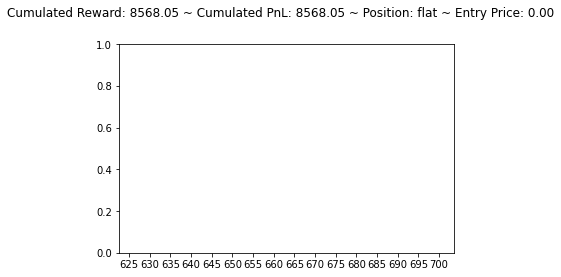

[597.382   747.87305 652.64844]
flat buy long


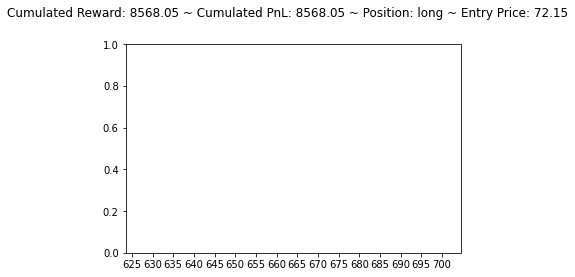

[673.52997 900.3673  828.9272 ]
long sell flat


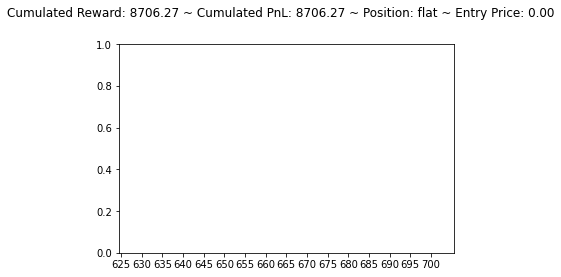

[1513.9629 1305.5544 1385.1437]
flat hold flat


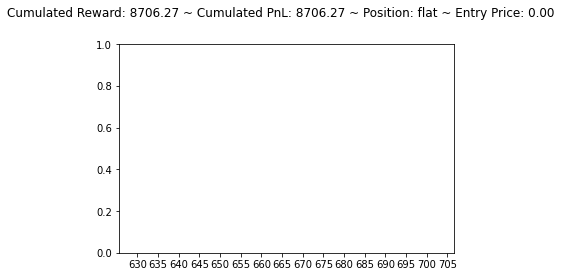

[1296.0226 1217.2539 1247.7015]
flat hold flat


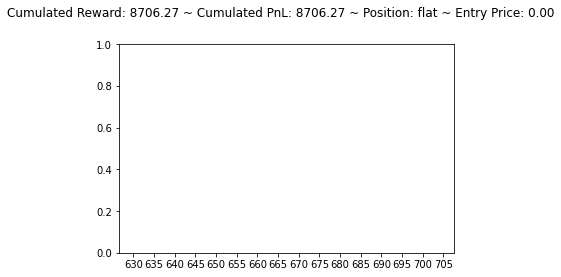

[1590.8363 1352.7292 1467.1838]
flat hold flat


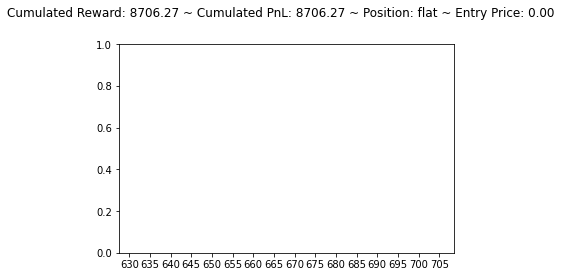

[1231.9093 1138.1785 1410.112 ]
flat sell short


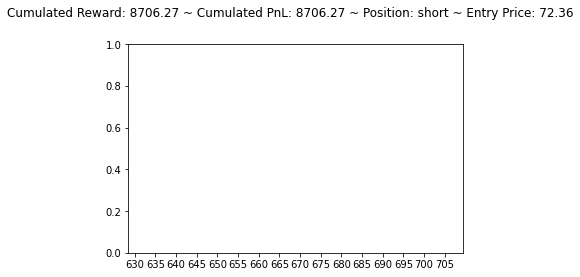

short buy flat


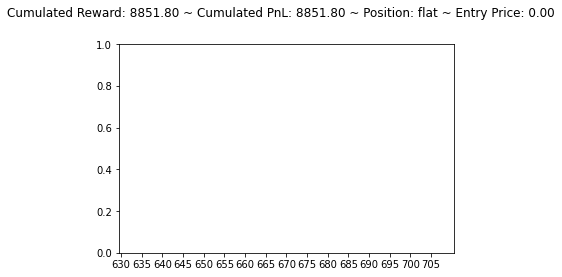

[1514.6002 1670.0546 1491.9309]
flat buy long


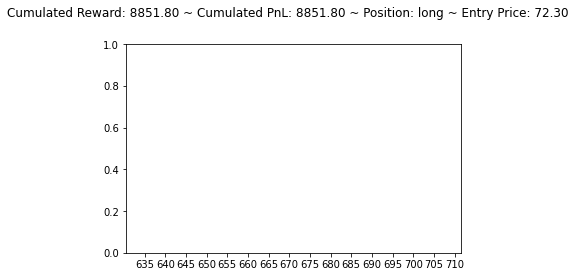

[1144.8118 1128.1544 1362.5358]
long sell flat


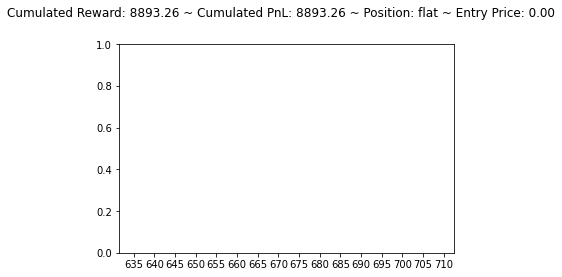

[1183.9187 1333.1978 1256.3225]
flat buy long


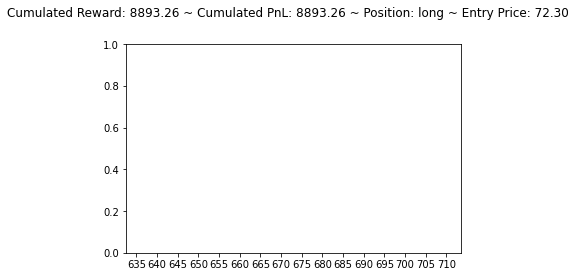

[2149.6025 2069.3572 2169.5442]
long sell flat


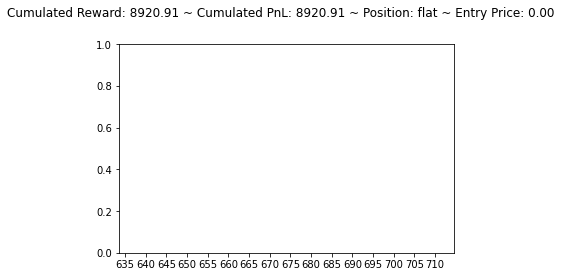

[2468.2507 2654.618  2450.0386]
flat buy long


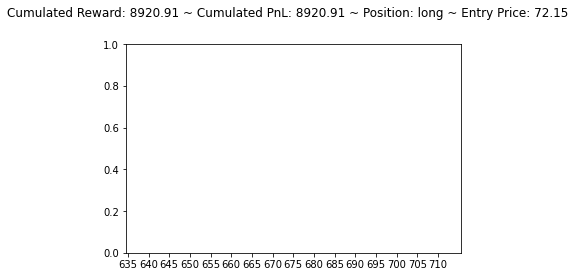

[1809.1636 1344.0951 2147.7114]
long sell flat


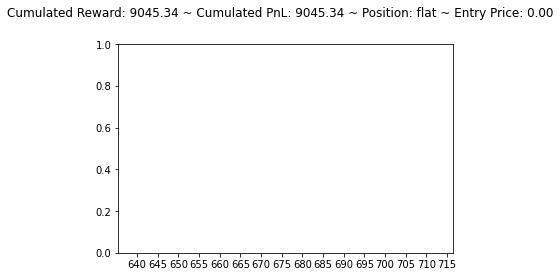

[1642.1404 1730.9042 1723.5796]
flat buy long


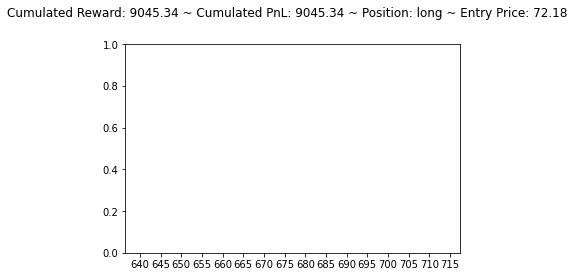

[1491.9906 1423.1722 1562.755 ]
long sell flat


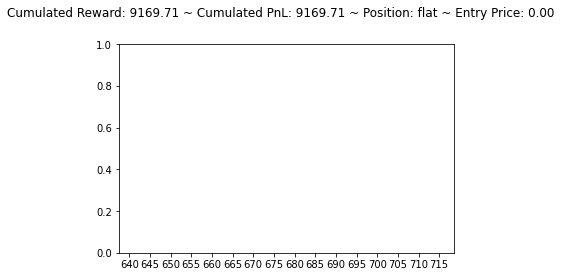

[1786.3125 1798.2391 1785.3894]
flat buy long


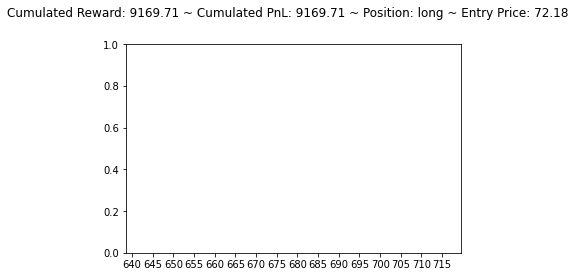

[1792.2899 1793.6538 1794.3708]
long sell flat


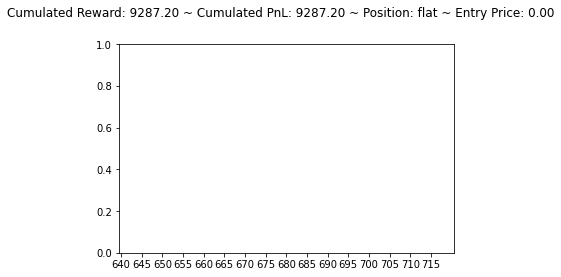

[1545.9875 1601.0914 1605.8823]
flat sell short


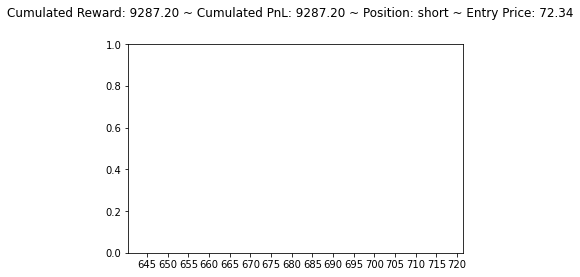

[902.861  930.1051 778.0708]
short buy flat


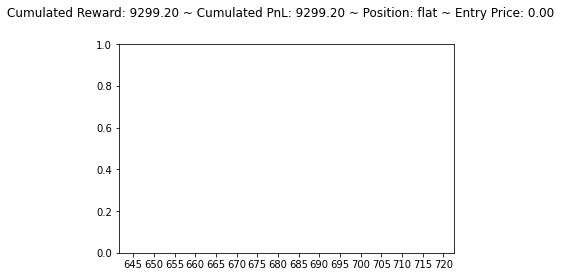

[780.18854 813.7064  885.62506]
flat sell short


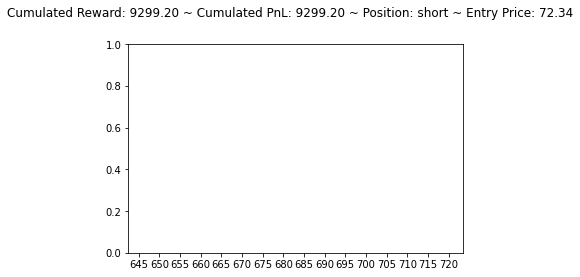

[1714.6935 1509.2448 1513.6388]
short hold short


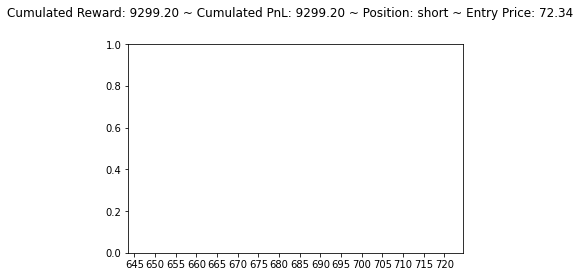

[1644.5537 1674.7754 1667.0515]
short buy flat


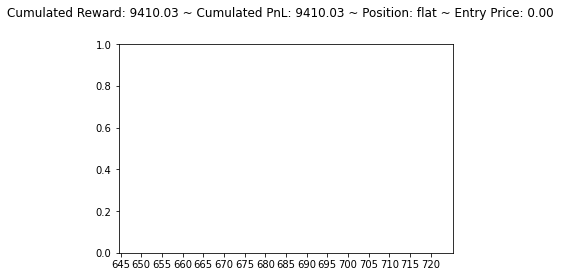

[1604.9437 1637.8899 1639.348 ]
flat sell short


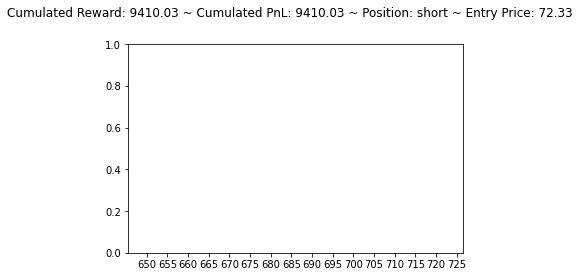

[1183.6266   612.54333 1288.5745 ]
short hold short


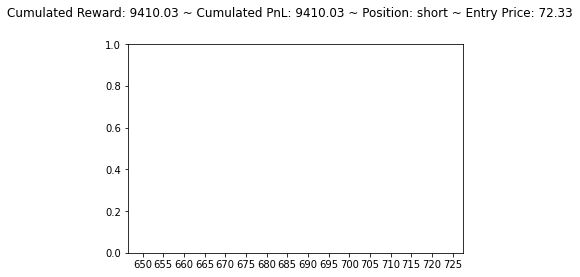

[838.6101 864.6065 928.6781]
short buy flat


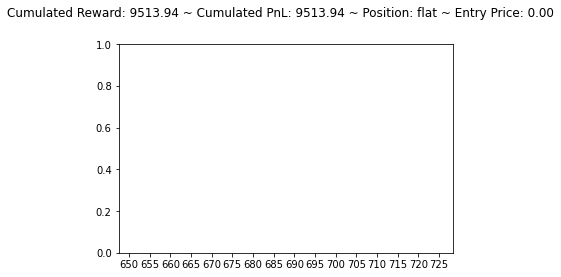

[1536.4185 1370.5085 1358.2583]
flat hold flat


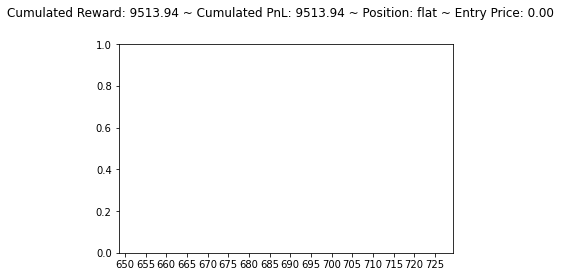

[1551.5347 1621.8821 1579.1599]
flat buy long


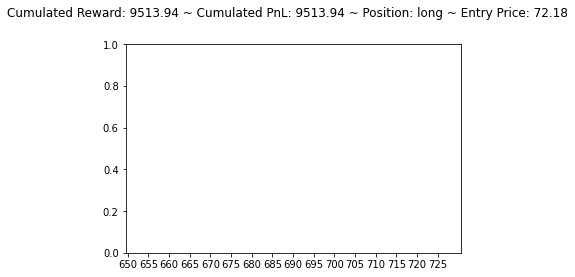

[1647.6066 1695.8364 1690.001 ]
long sell flat


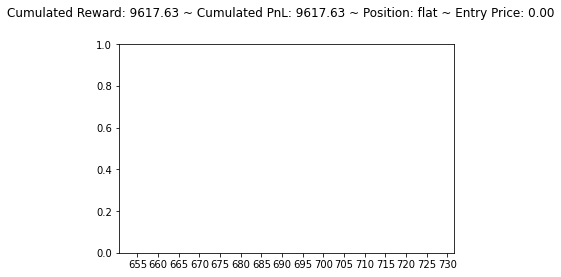

[1632.8324 1662.1294 1669.7914]
flat sell short


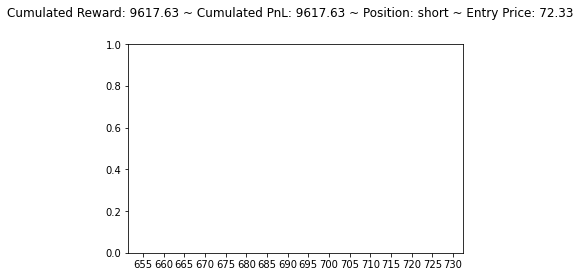

[1724.9991 1723.8123 1721.5754]
short hold short


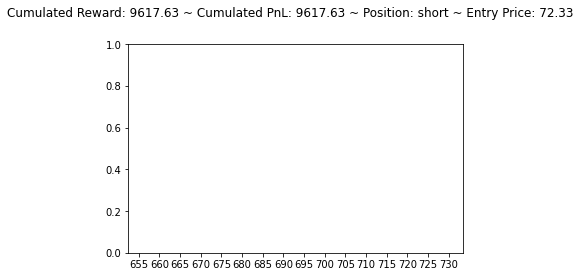

[1686.9833 1705.4513 1705.5851]
short buy flat


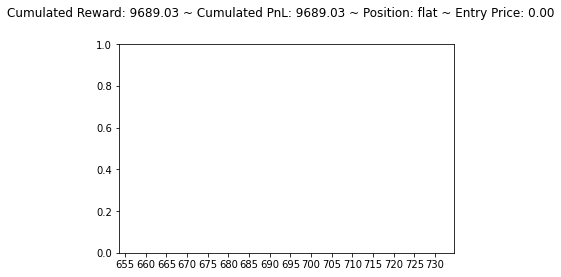

[1570.2831 1617.4667 1564.7173]
flat buy long


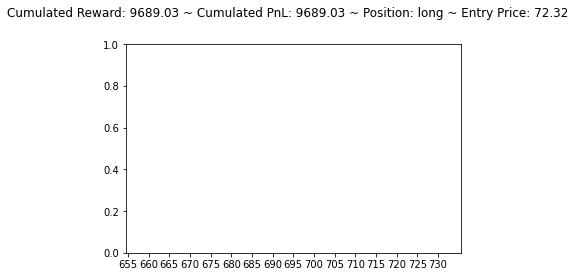

[1316.6337 1403.3577 1404.723 ]
long sell flat


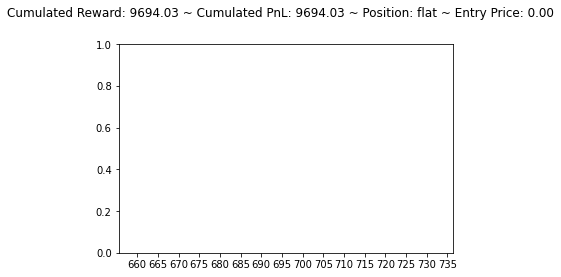

[ 992.0948  1187.3451   957.93567]
flat buy long


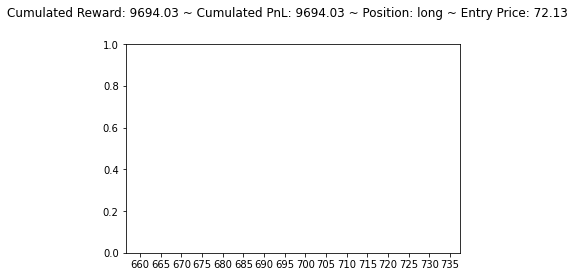

[1336.8368 1610.1195 1099.8806]
long hold long


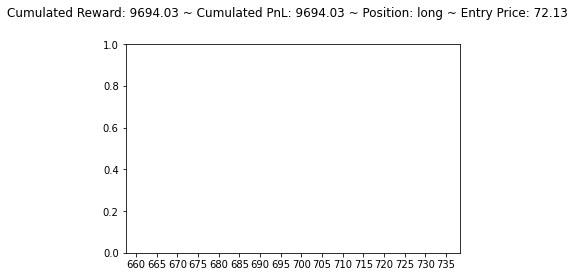

[1165.2263 1438.1411 1405.812 ]
long sell flat


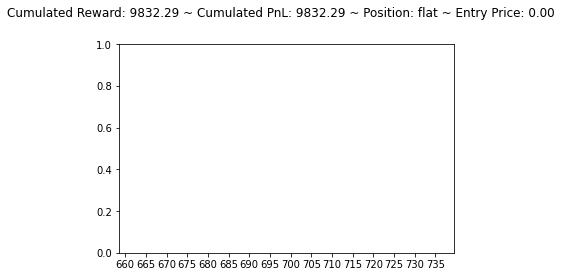

[ 665.1394 1428.8434 1408.481 ]
flat buy long


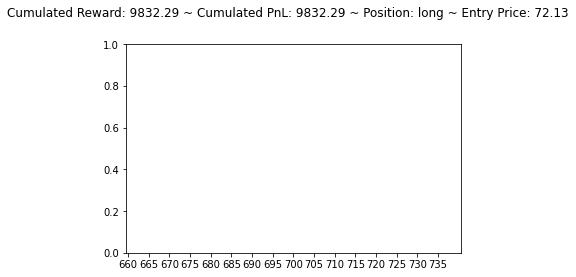

long sell flat


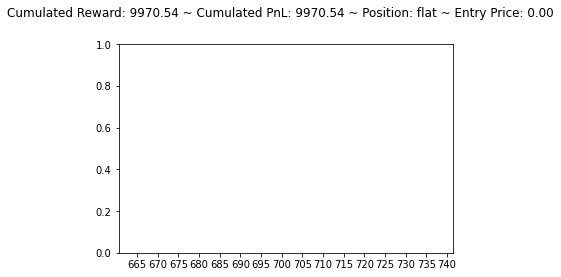

[1375.2258 1516.9    1375.0308]
flat buy long


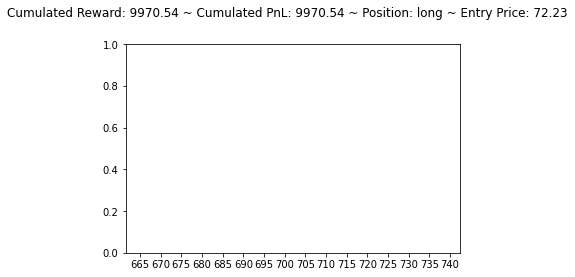

[1405.7451 1582.4827 1502.4304]
long sell flat


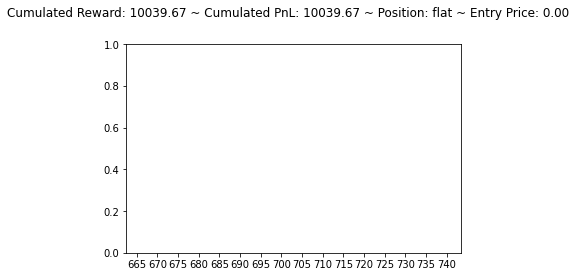

[1445.1776 1573.7646 1528.9751]
flat buy long


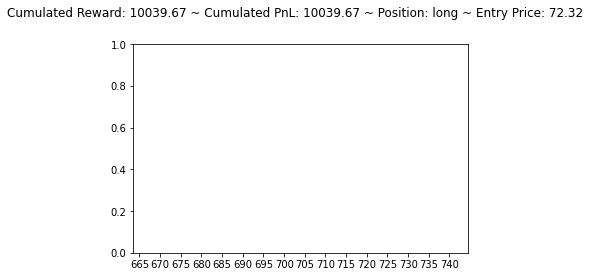

[1321.2838 1421.035  1414.6029]
long sell flat


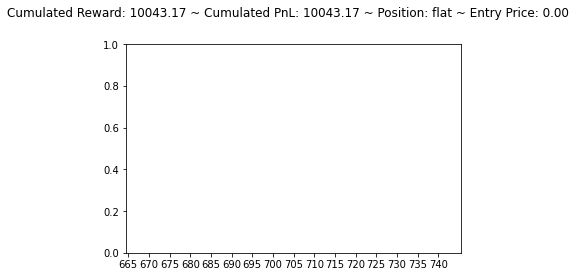

[695.7273 743.7188 581.8604]
flat buy long


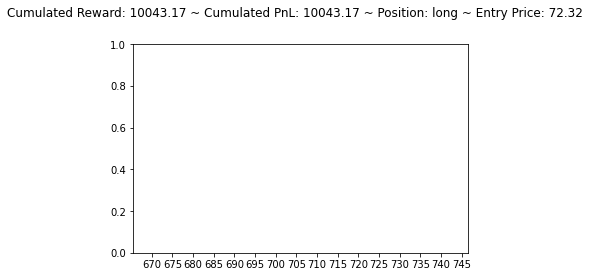

[596.9749 637.7078 471.5368]
long hold long


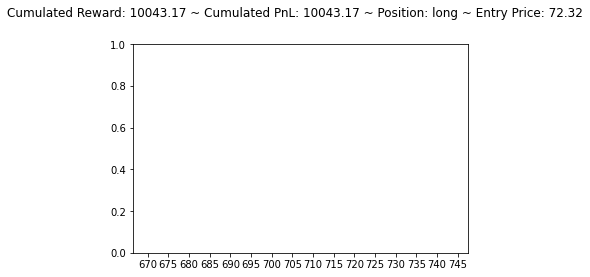

[872.1732  583.4383  595.42114]
long hold long


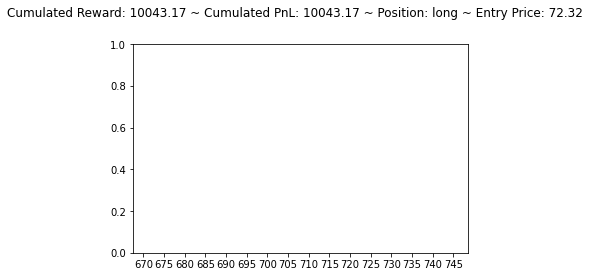

[1570.6566 1408.6382 1365.491 ]
long hold long


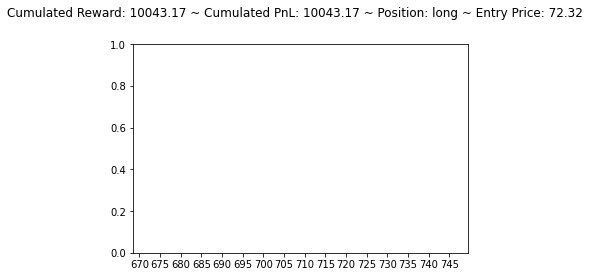

[1583.1962 1715.5405 1671.7261]
long sell flat


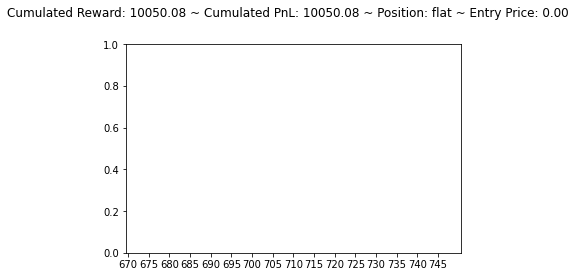

[1519.8715 1634.7134 1503.8855]
flat buy long


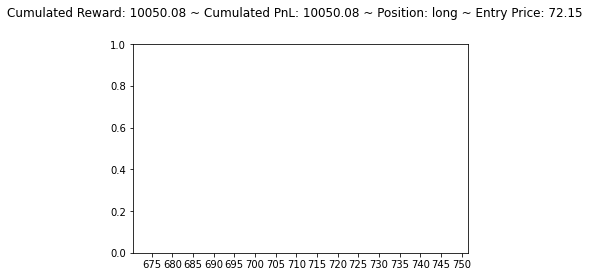

[1469.199  1640.1505 1492.6143]
long sell flat


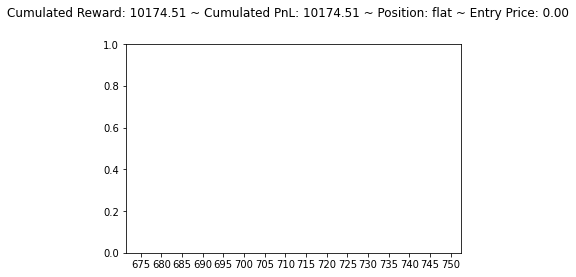

[1404.9362   203.59515  927.5469 ]
flat hold flat


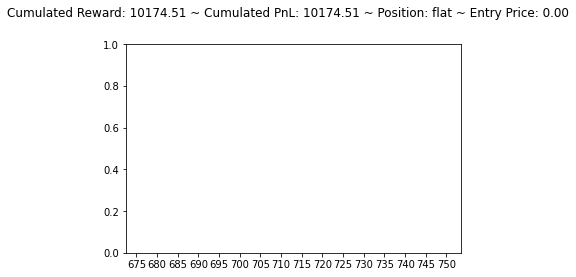

[445.2593  581.81134 627.7079 ]
flat sell short


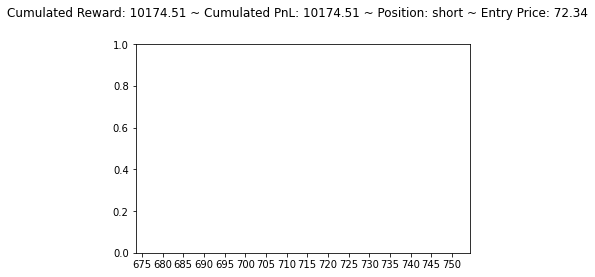

[651.4888  761.80615 867.8832 ]
short buy flat


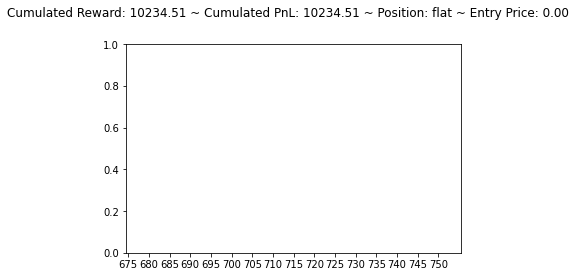

[1527.6864 1342.0964 1362.4883]
flat hold flat


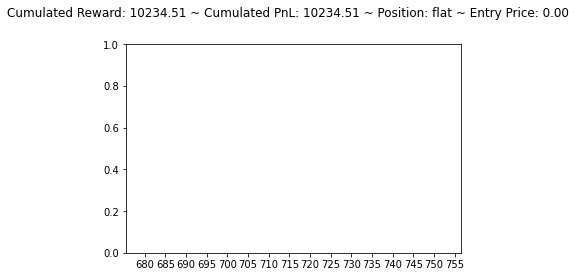

[1476.9565 1526.7108 1478.6268]
flat buy long


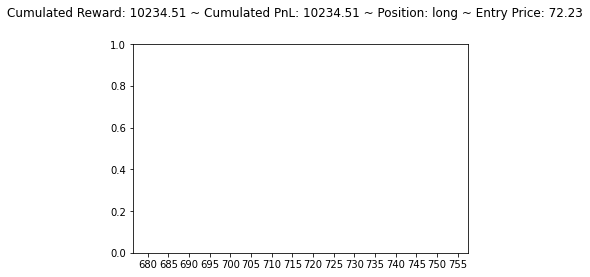

[1399.9409 1512.2079 1394.3231]
long hold long


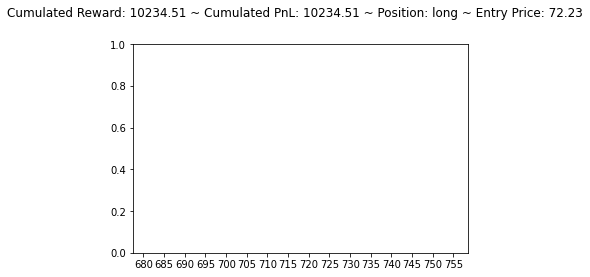

[1406.2894 1550.3423 1550.2147]
long sell flat


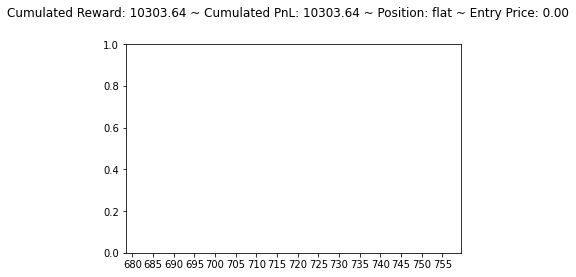

[1285.1943   377.76437 1122.5026 ]
flat hold flat


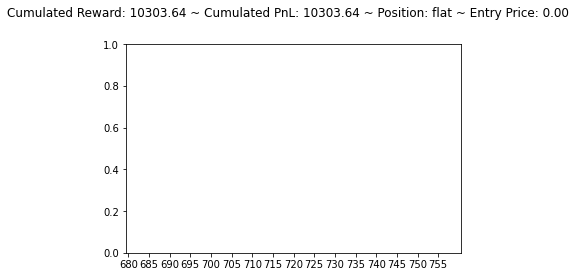

[1431.347  1259.5502 1239.6995]
flat hold flat


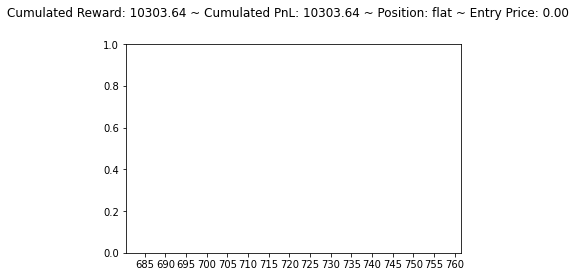

[1309.0885 1198.503  1249.3582]
flat hold flat


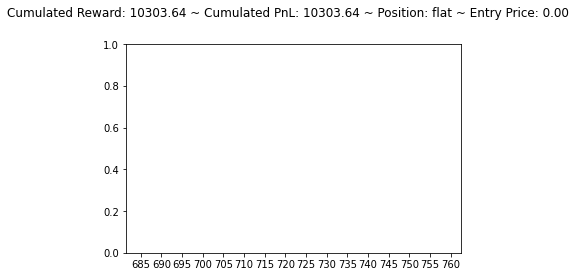

[1086.6173 1354.543  1281.1072]
flat buy long


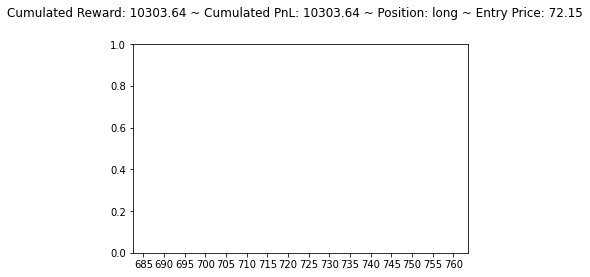

[1490.4259 1660.9475 1658.6317]
long sell flat


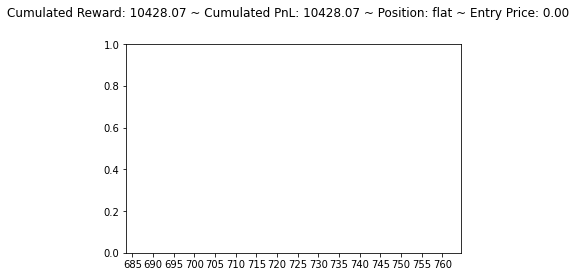

[1604.3815 1655.5908 1616.93  ]
flat buy long


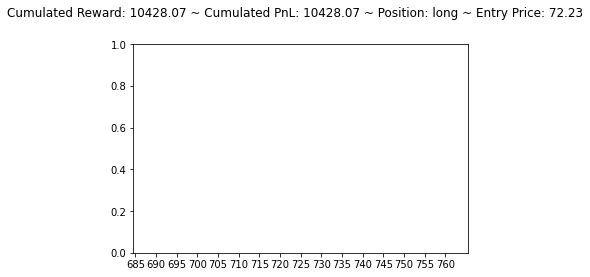

[1655.1737 1706.4573 1670.5453]
long sell flat


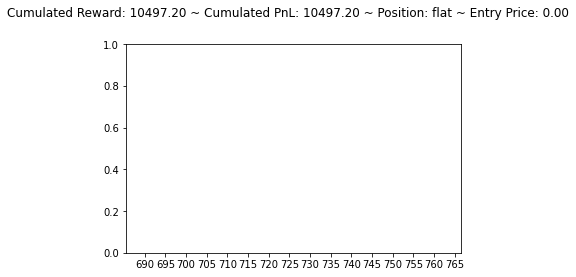

[1264.6544 1315.3392 1342.1937]
flat sell short


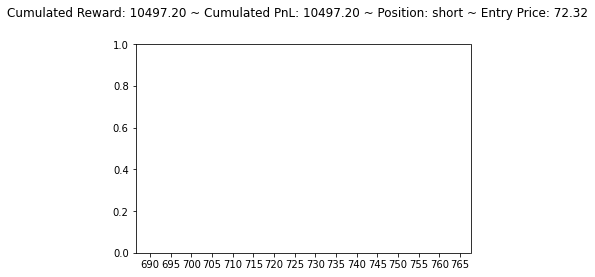

[1526.2219 1367.3738 1404.3245]
short hold short


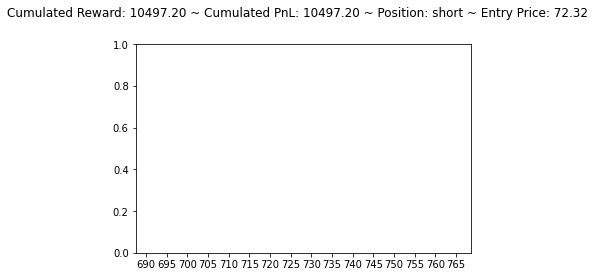

[1518.3397 1613.3213 1506.7577]
short buy flat


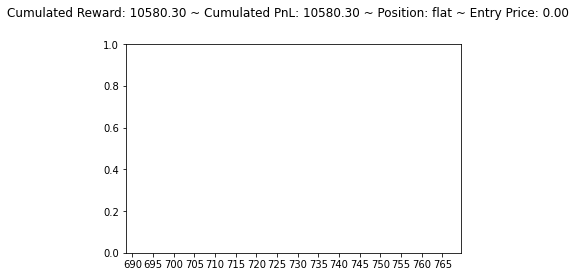

[2345.751  2319.8171 2124.3176]
flat hold flat


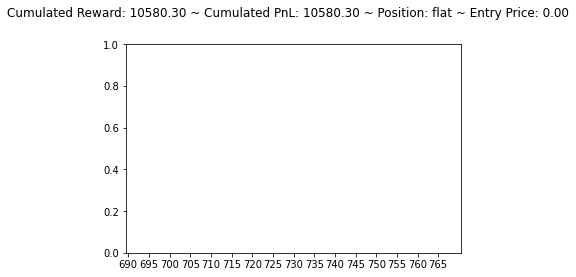

[1507.2711 1033.0217 1864.9558]
flat sell short


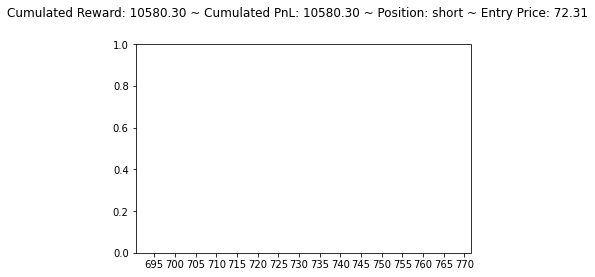

[1284.8442 1444.308  1344.3888]
short buy flat


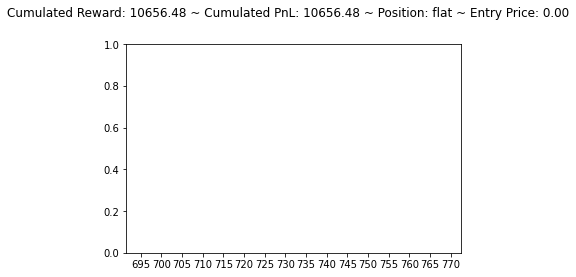

[1104.1526  295.0673  914.9101]
flat hold flat


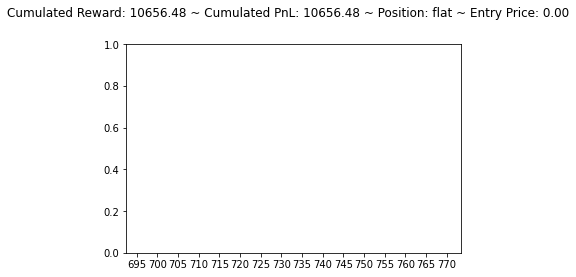

[1325.7886 1189.355  1136.5374]
flat hold flat


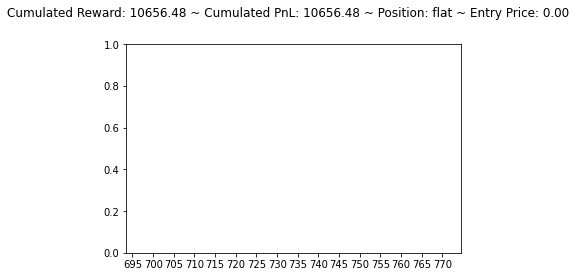

[1229.0815 1410.7657 1308.4598]
flat buy long


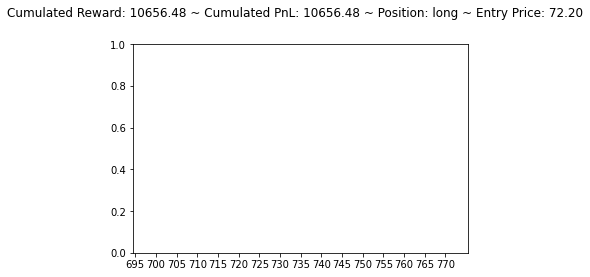

[1440.7616 1566.7009 1588.18  ]
long sell flat


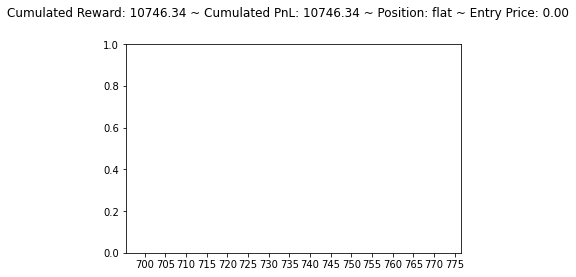

[1545.7537 1568.2699 1586.0696]
flat sell short


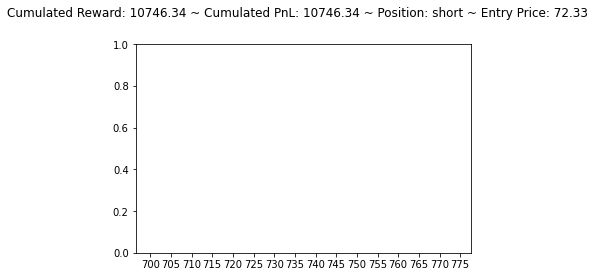

[1110.8009   710.98486 1290.8655 ]
short hold short


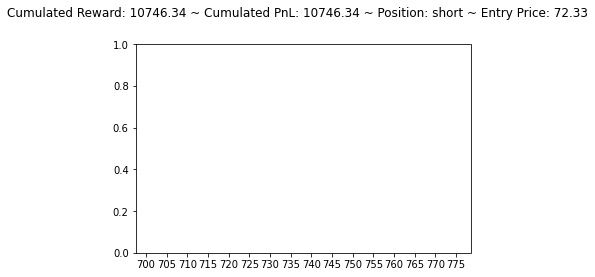

[604.2931  652.9502  788.68463]
short buy flat


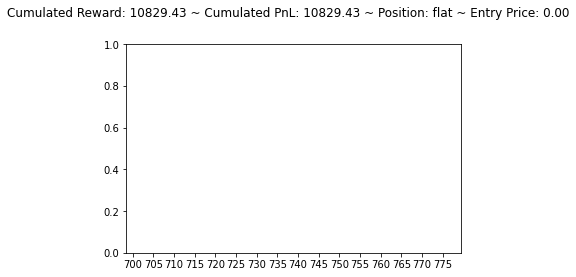

[1282.7053 1141.0398  997.5084]
flat hold flat


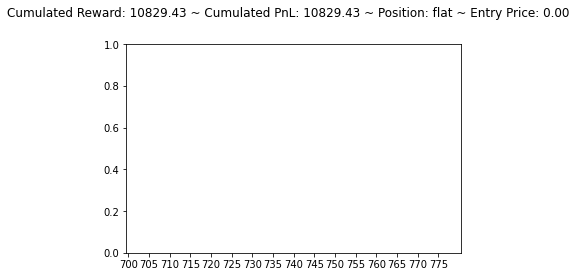

[1217.5194 1444.7855 1459.846 ]
flat sell short


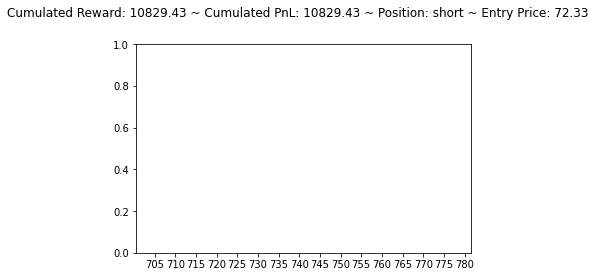

[1590.8195 1606.5833 1628.6035]
short buy flat


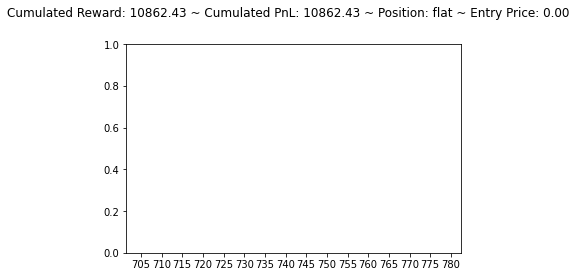

[2715.655  2412.7053 2343.4177]
flat hold flat


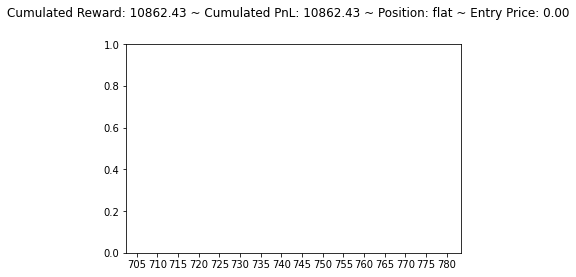

[1700.4974  932.3838 1914.7056]
flat sell short


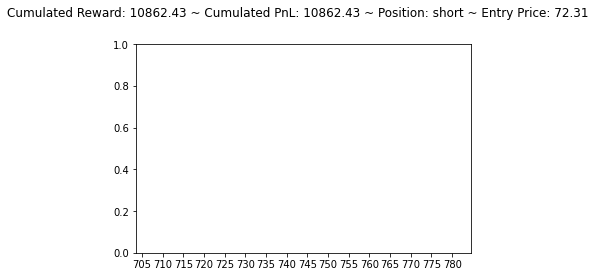

[1539.8297 1551.5295 1569.0491]
short buy flat


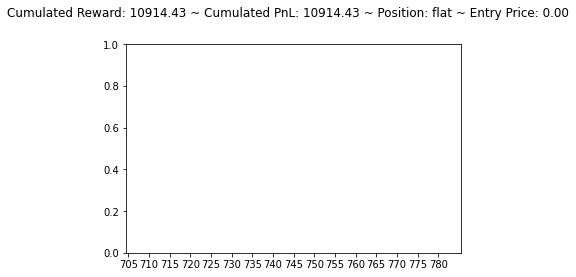

[1451.4244 1484.1494 1488.6766]
flat sell short


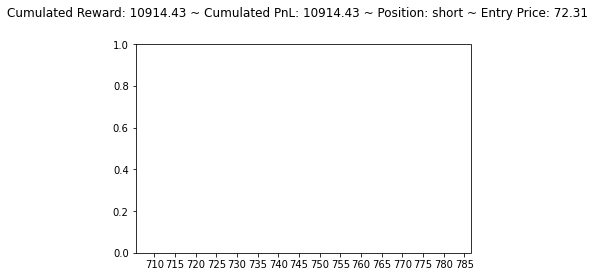

[1572.7727 1591.0006 1607.2354]
short buy flat


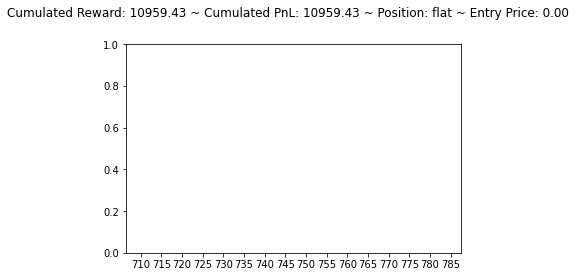

[1501.9684 1528.0966 1541.9436]
flat sell short


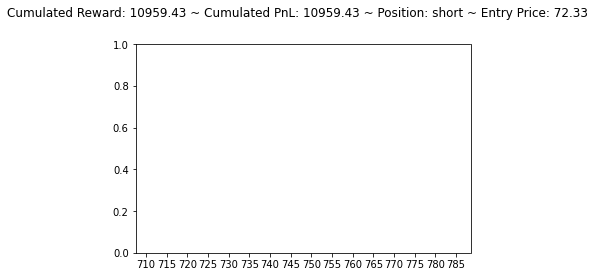

[1104.3014  633.2442 1240.9438]
short hold short


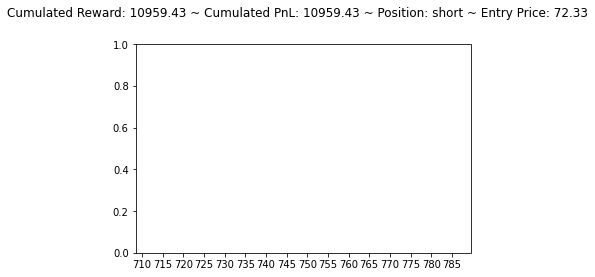

[643.10333 480.35272 841.9254 ]
short hold short


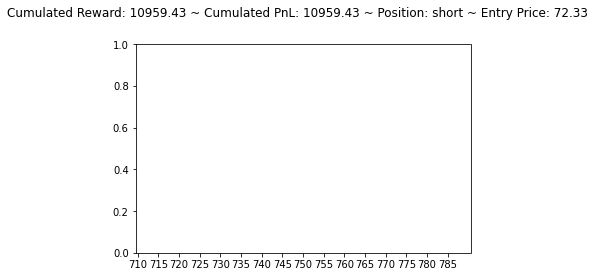

[570.19495 591.16846 716.6985 ]
short buy flat


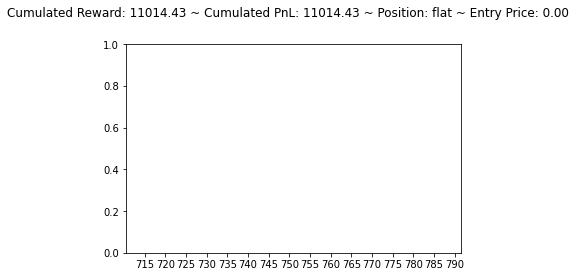

[1403.1791 1256.9572 1312.0093]
flat hold flat


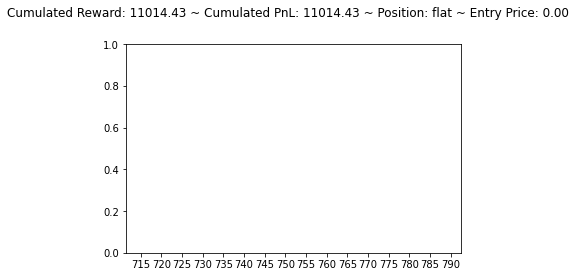

[1482.4604 1517.6304 1518.5477]
flat sell short


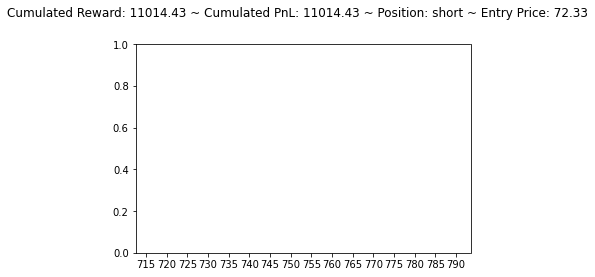

[1126.2799  577.4449 1206.7499]
short hold short


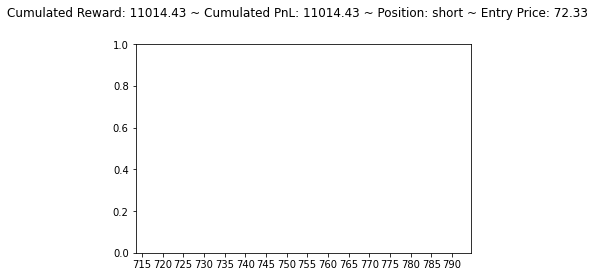

[735.5436 762.0426 869.077 ]
short buy flat


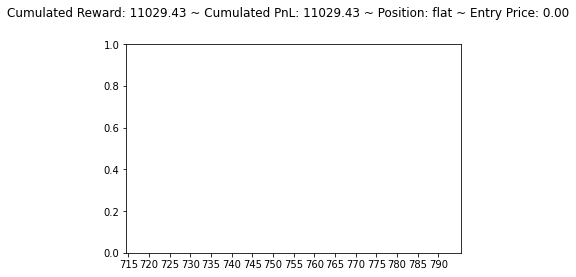

[764.8243  801.40625 889.00665]
flat sell short


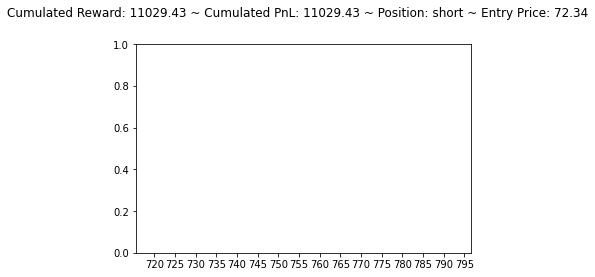

[ 948.74347  961.41315 1053.0027 ]
short buy flat


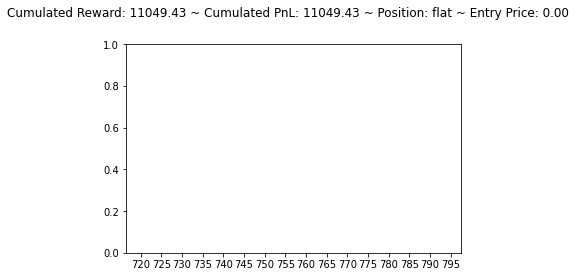

[887.6719 923.7958 995.1293]
flat sell short


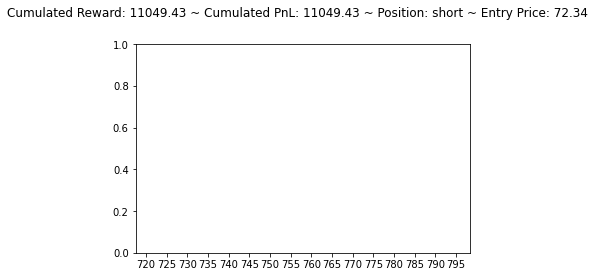

[839.1714  859.04395 961.5082 ]
short buy flat


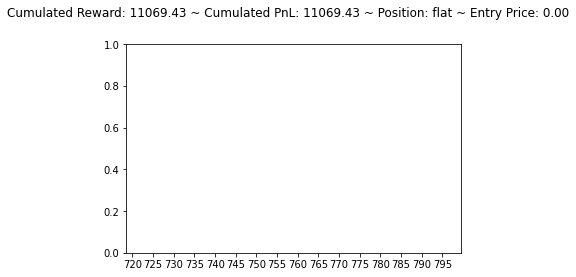

[620.2152  650.01013 801.6609 ]
flat sell short


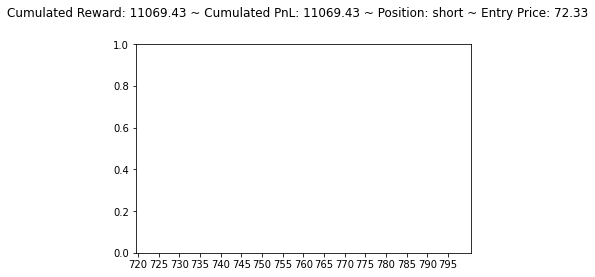

[768.1411 715.3441 802.1902]
short hold short


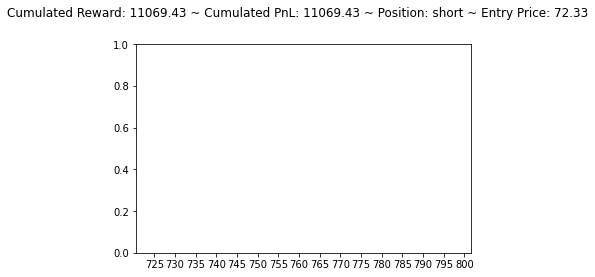

[859.1716  802.29224 692.6844 ]
short hold short


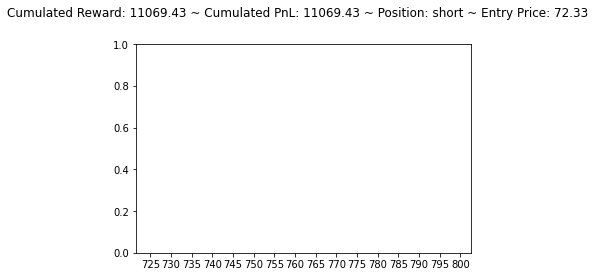

[622.625  625.5903 782.5214]
short buy flat


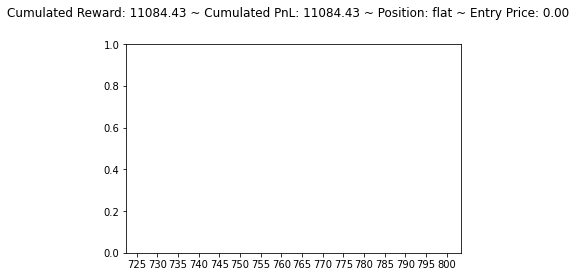

[841.79706 779.61945 840.12085]
flat hold flat


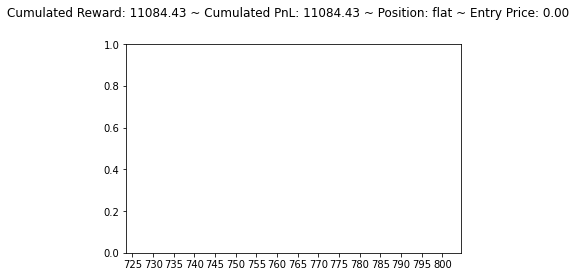

[710.2742  749.02844 836.115  ]
flat sell short


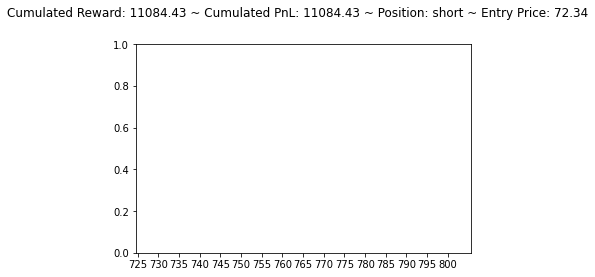

[ 782.3321 1633.9354  773.4478]
short buy flat


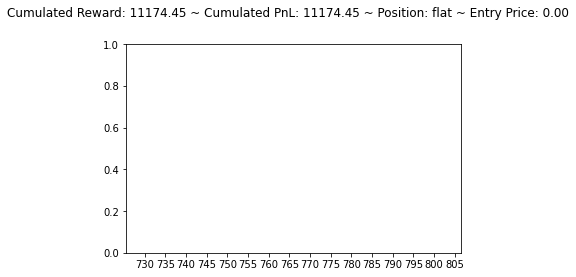

[3274.7517 3188.3032 2823.4502]
flat hold flat


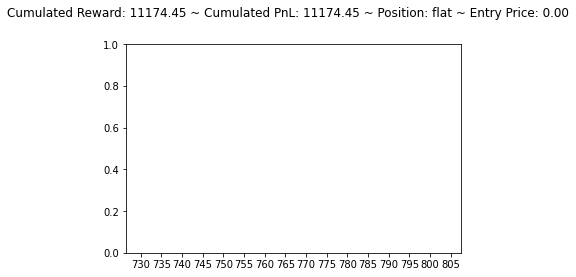

[3597.4412 3707.77   3621.9736]
flat buy long


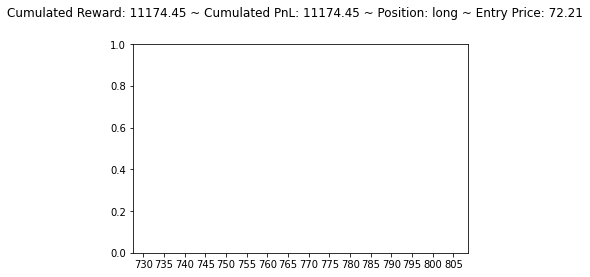

[4155.082  3913.8765 3733.6323]
long hold long


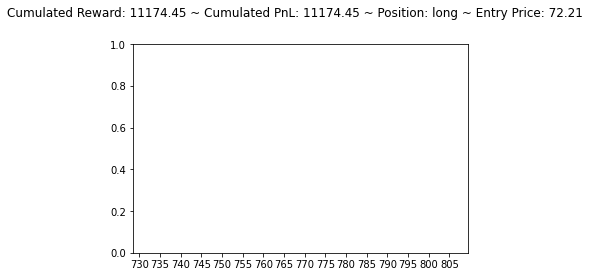

[1282.7225   907.66095  940.0264 ]
long hold long


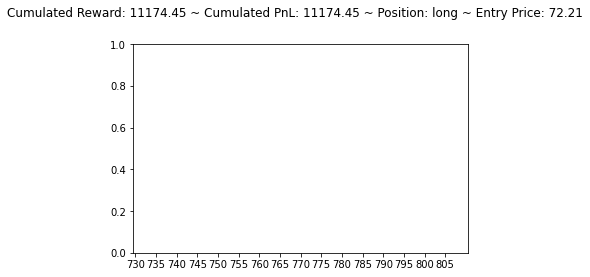

[1621.9014 1666.917  1654.2416]
long sell flat


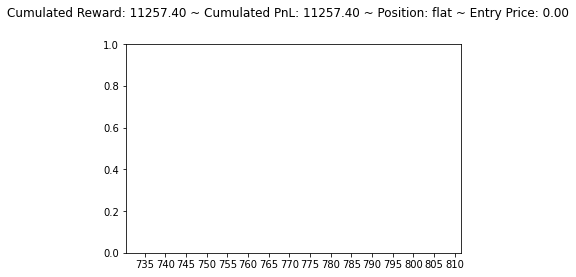

[1565.1782 1609.9982 1615.1122]
flat sell short


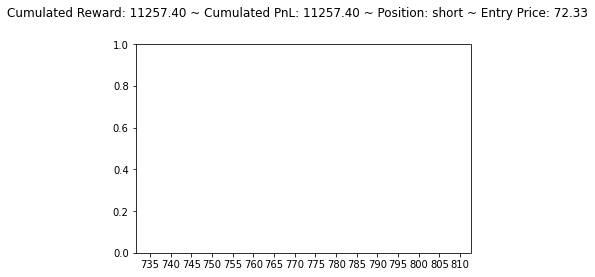

[1481.4313 1490.605  1629.6288]
short buy flat


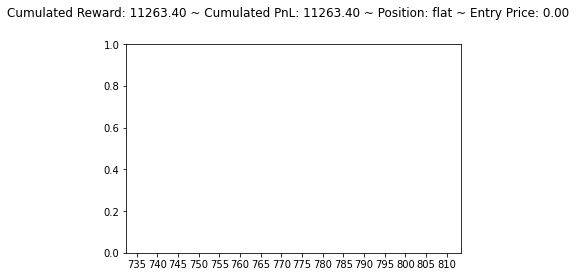

[537.8631  592.0341  639.27673]
flat sell short


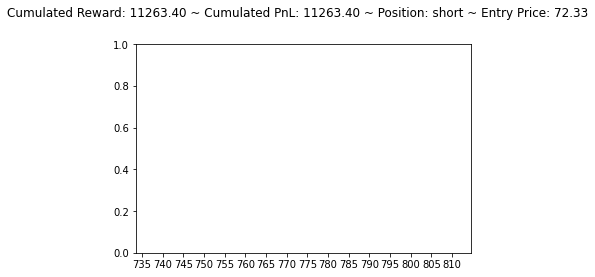

[1431.3481 1312.7482 1308.051 ]
short hold short


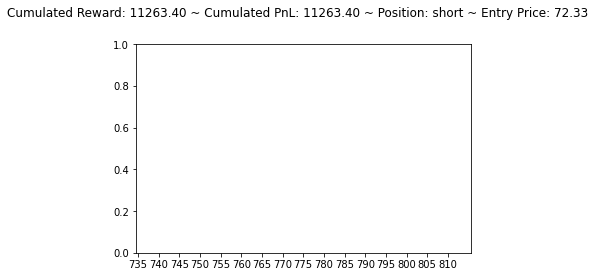

[1215.9451 1255.7281 1278.914 ]
short buy flat


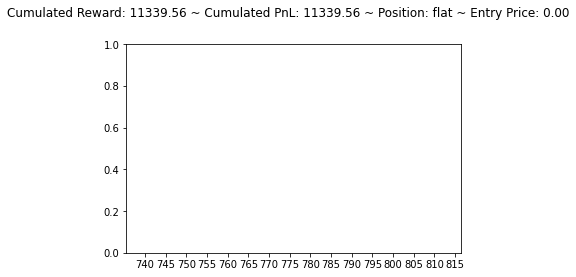

[770.6351  782.79065 766.3764 ]
flat buy long


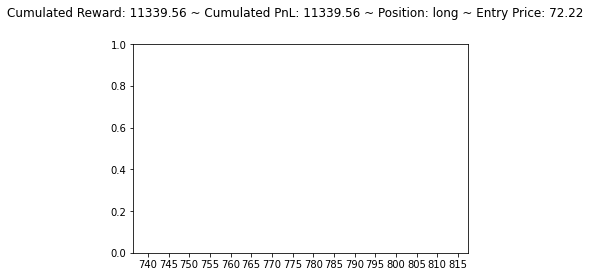

[941.26587 890.9387  879.05133]
long hold long


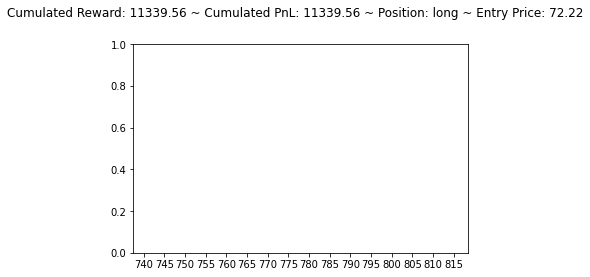

[987.25586 990.8403  813.79645]
long hold long


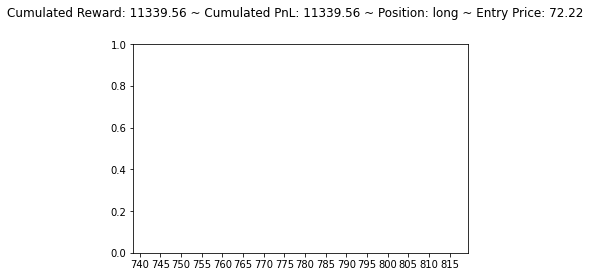

[868.75024 987.3636  843.67065]
long hold long


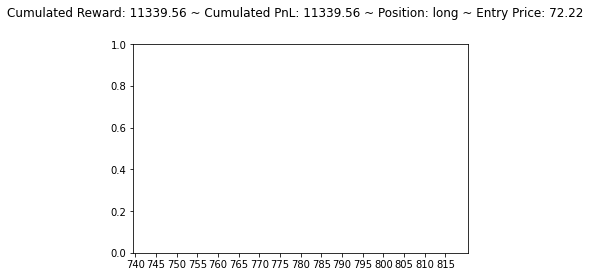

[647.4424  927.59894 851.24677]
long sell flat


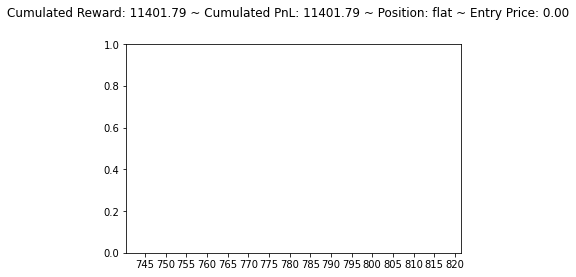

[787.3576  805.00824 775.39746]
flat buy long


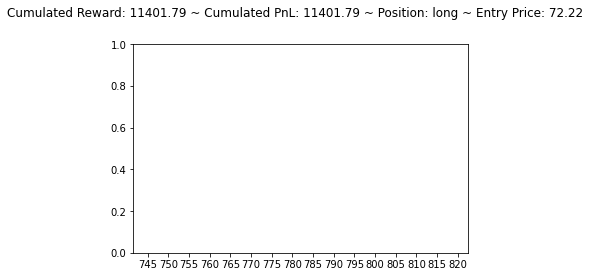

[732.58386 931.2601  830.3987 ]
long sell flat


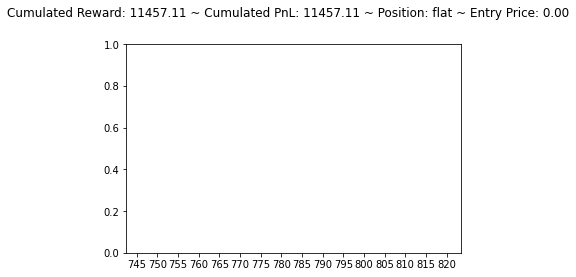

[862.76245 868.2601  718.06665]
flat buy long


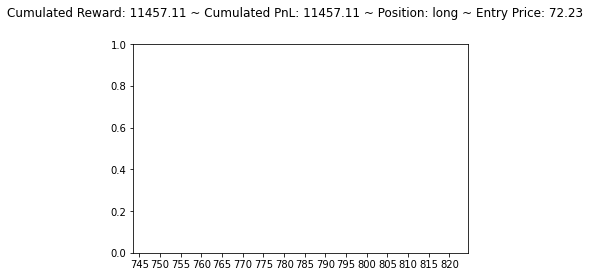

[ 964.8241 1033.2518  909.0769]
long hold long


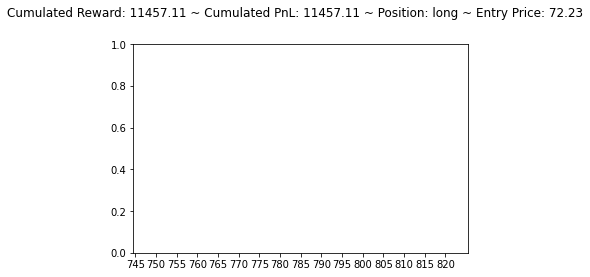

[1073.1779 1078.0983  895.6844]
long hold long


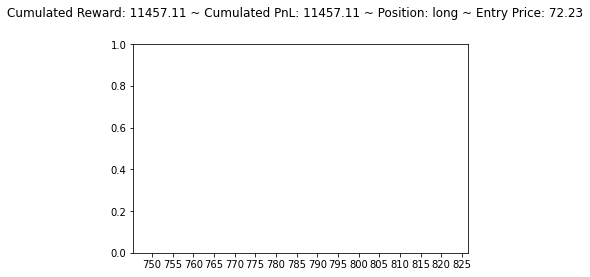

[1075.77   1120.7882  991.6942]
long hold long


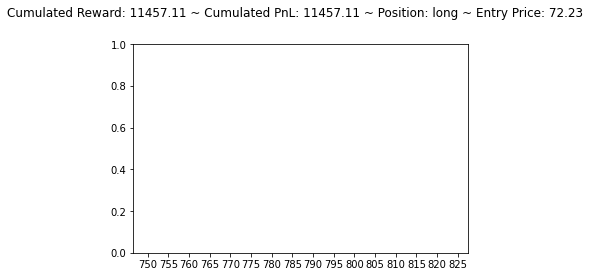

[1084.8541  1123.5723   985.35724]
long hold long


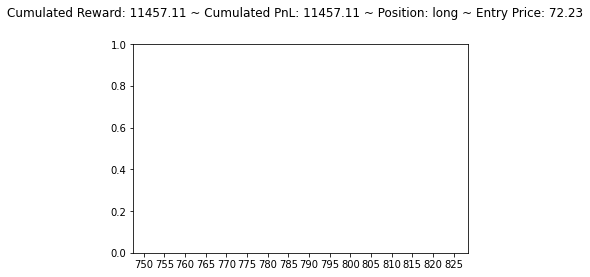

[1098.0643  1139.6434  1004.21466]
long hold long


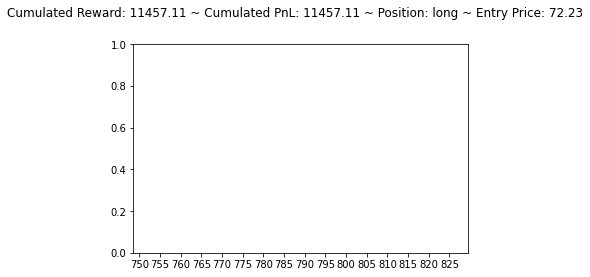

[1135.7574 1168.8248 1047.3281]
long hold long


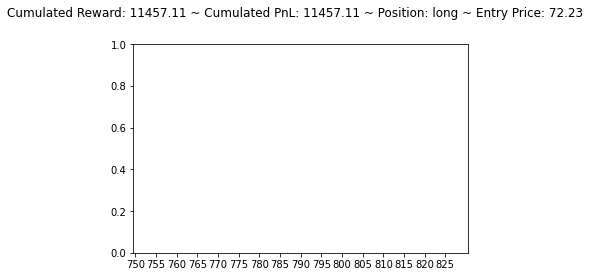

[1281.4843 1348.1462 1208.3164]
long hold long


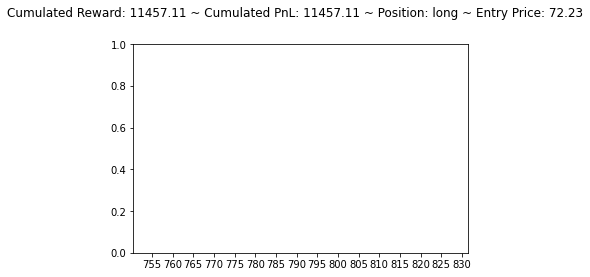

[1154.4856 1251.067  1097.5308]
long hold long


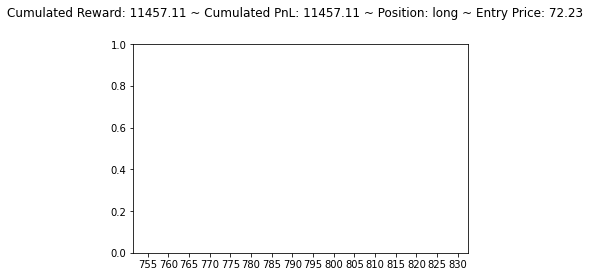

[984.7624  989.88074 868.3875 ]
long hold long


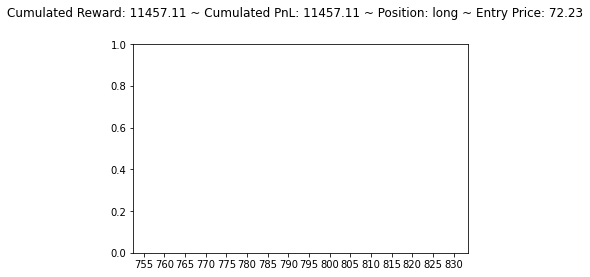

[990.05804 968.11206 774.52167]
long hold long


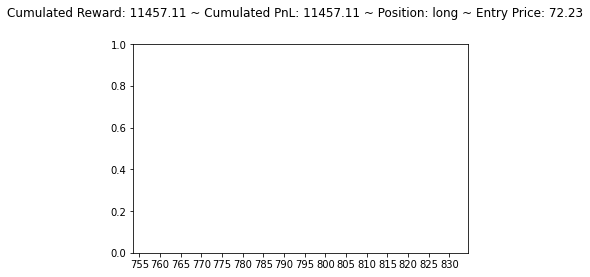

[1759.5084 2123.4417 1395.2258]
long hold long


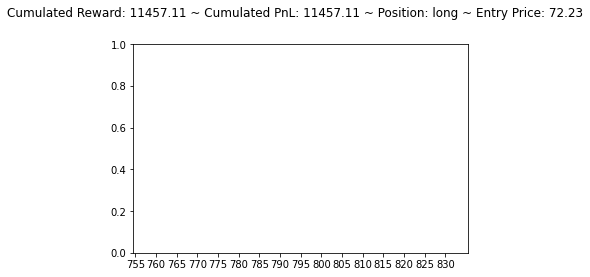

[1015.8101  779.5779 1078.9727]
long sell flat


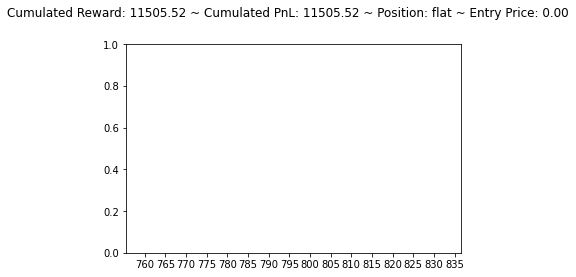

[905.3883  979.0902  897.11597]
flat buy long


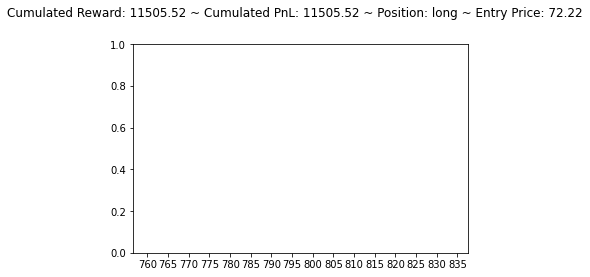

[1860.0177 2287.0234 1425.7119]
long hold long


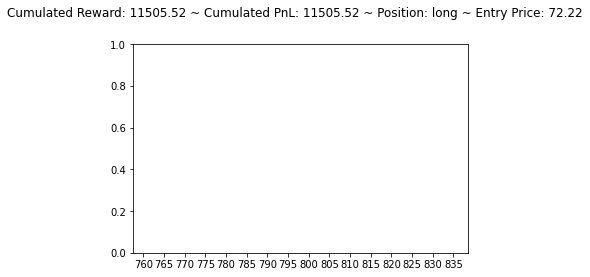

[1016.6918   871.22375  982.7058 ]
long hold long


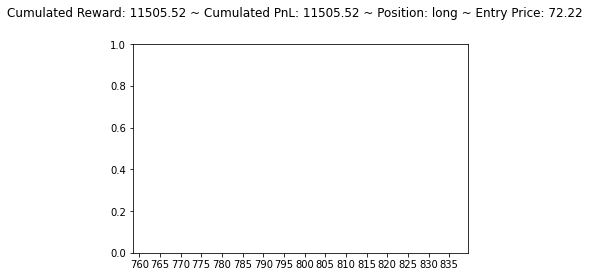

[1045.6823  748.8501 1087.9084]
long sell flat


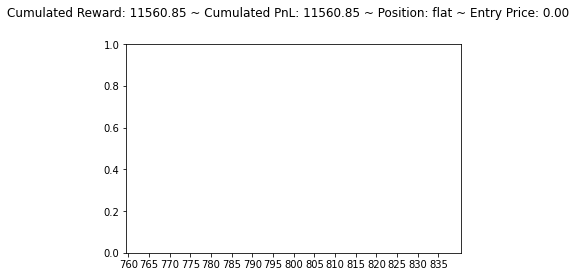

[1751.0813 2192.3584 1298.9509]
flat buy long


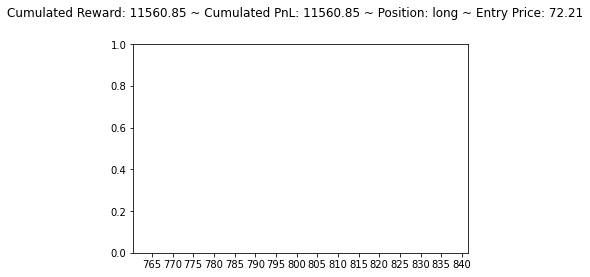

[908.71075 776.78394 976.18506]
long sell flat


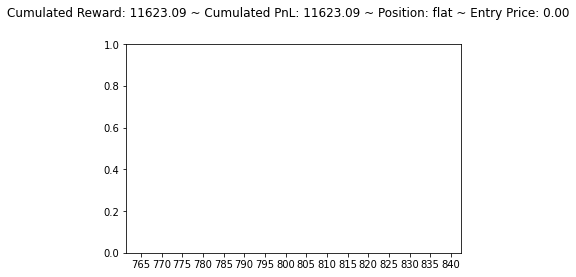

[861.10394 692.6039  844.43494]
flat hold flat


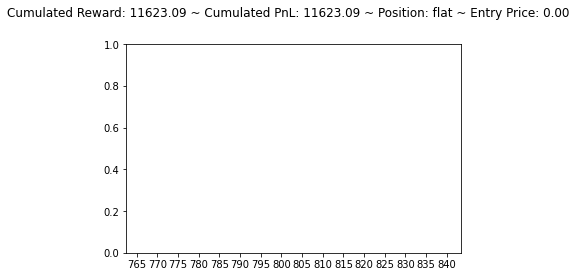

[921.3348  668.2125  969.25244]
flat sell short


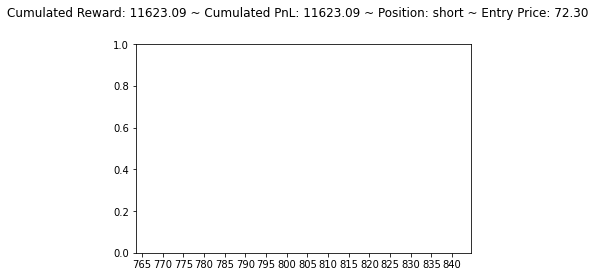

short hold short


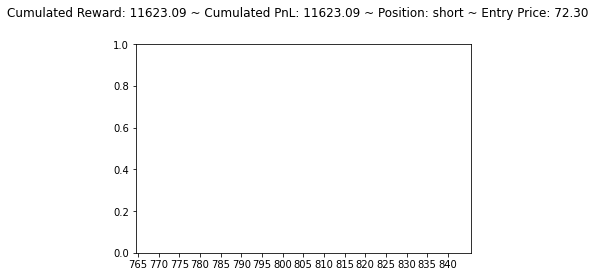

[803.5406 943.7138 844.4713]
short buy flat


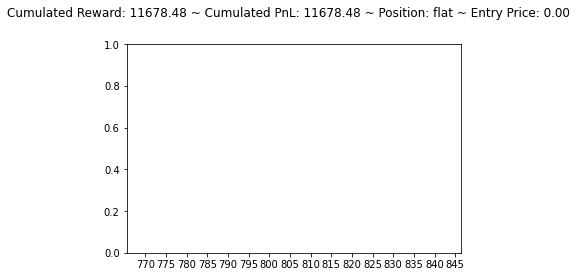

[465.85757 700.77686 762.32837]
flat sell short


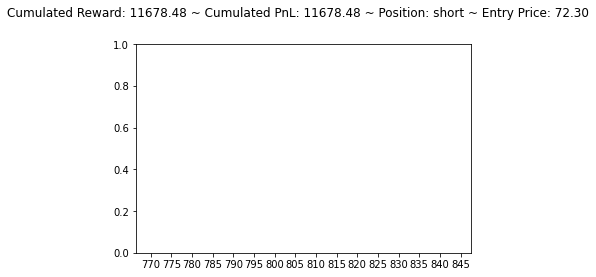

[800.26917 779.0921  812.8908 ]
short hold short


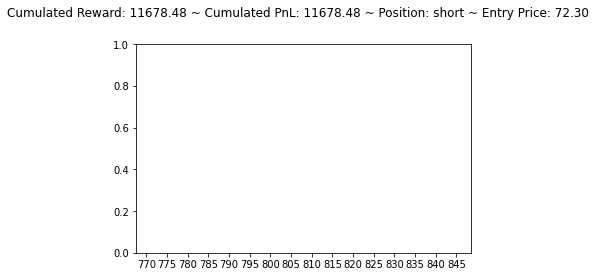

[1132.2212  1013.63556  959.4997 ]
short hold short


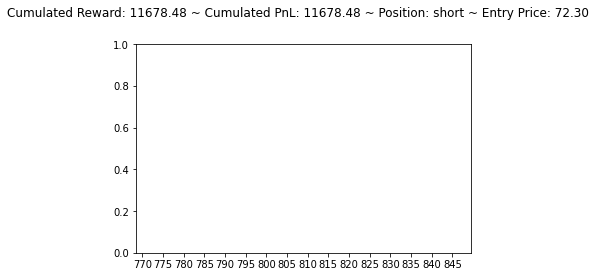

[ 809.95026 1012.90894  849.59045]
short buy flat


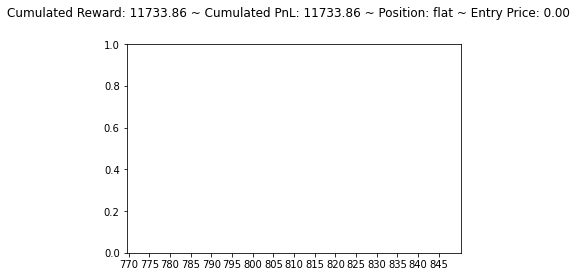

[624.1818 845.8989 757.6805]
flat buy long


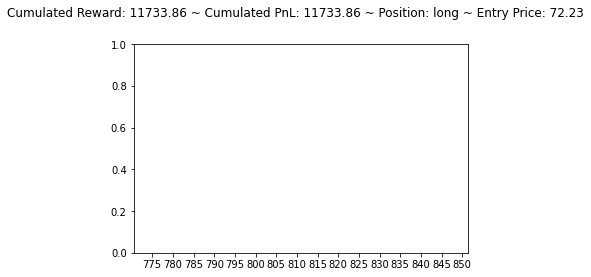

[745.7886  930.52747 835.95905]
long sell flat


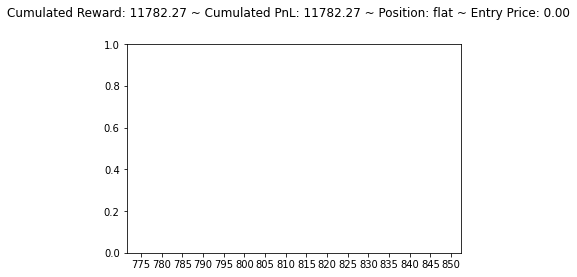

[759.1328  799.5378  707.60406]
flat buy long


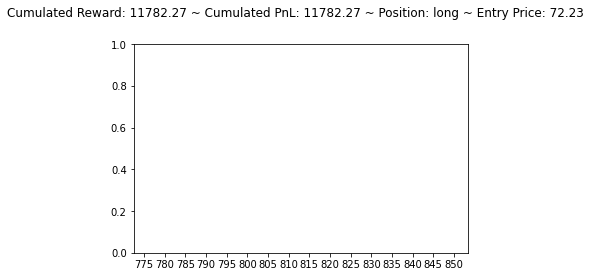

[ 976.1392 1038.7738  916.2055]
long hold long


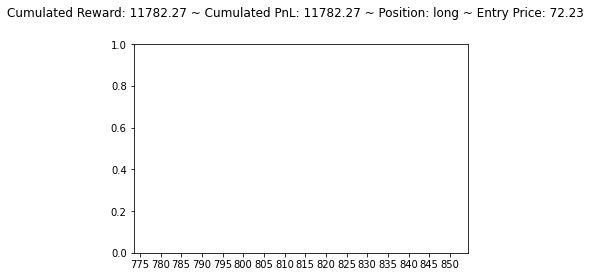

[1089.3582  1090.1658   913.98413]
long hold long


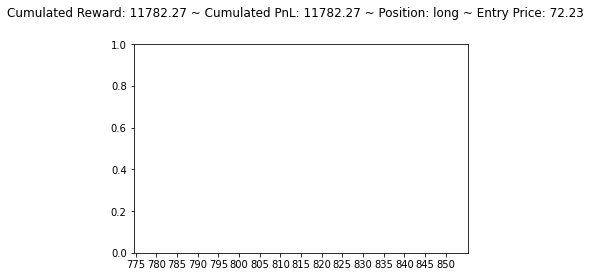

[1332.9708 1219.6226 1202.5638]
long hold long


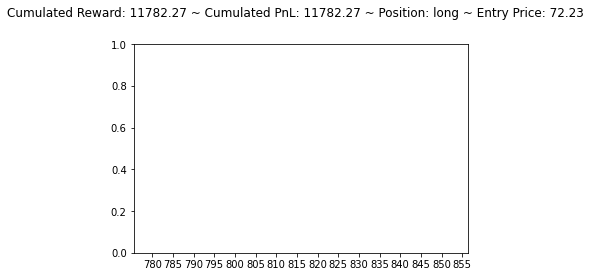

[2694.3801 2105.9763 1660.4348]
long hold long


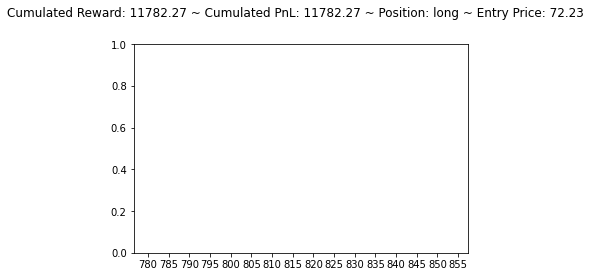

[1197.1605   853.69415  868.4638 ]
long hold long


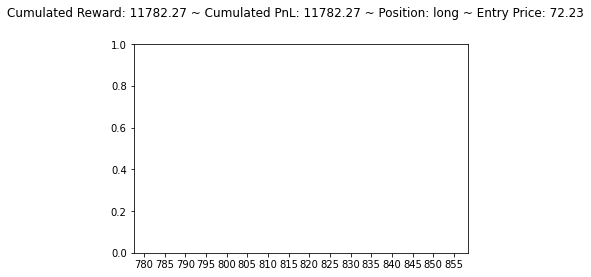

[1451.56   1535.4924 1566.311 ]
long sell flat


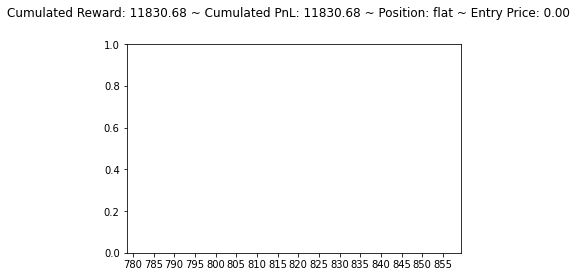

[1309.5089 1359.1268 1372.6324]
flat sell short


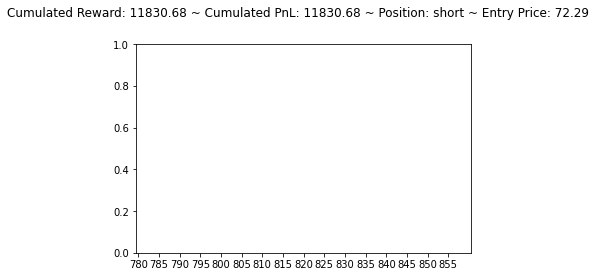

[698.49524 585.62897 689.5271 ]
short hold short


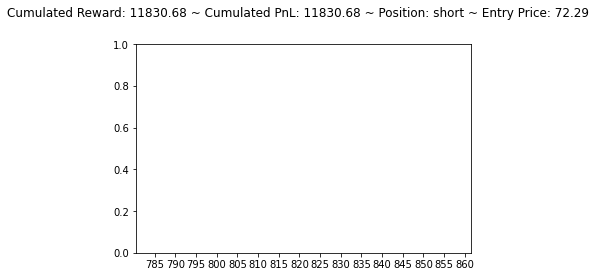

[1623.1631 2339.293  1328.7338]
short buy flat


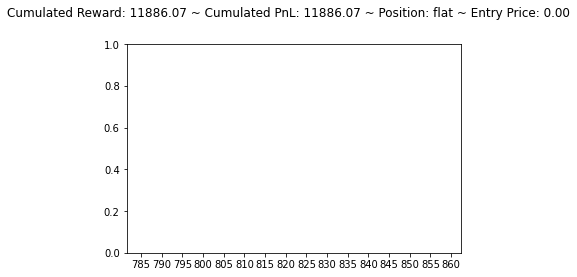

[858.9283  667.61646 804.19604]
flat hold flat


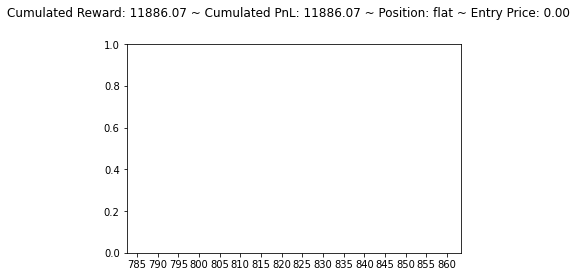

[672.9628 836.1866 737.5537]
flat buy long


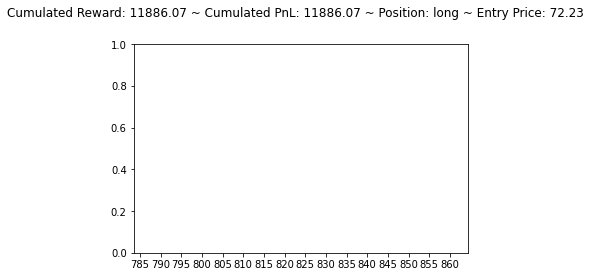

[814.4394 933.4652 813.7396]
long hold long


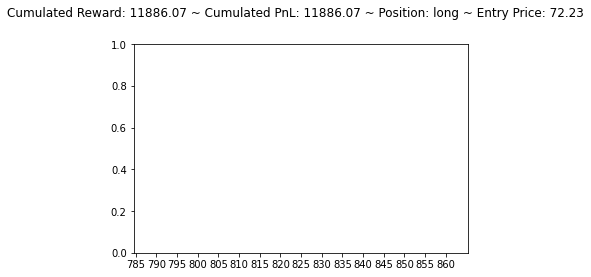

[1651.233  2158.587  1404.2618]
long hold long


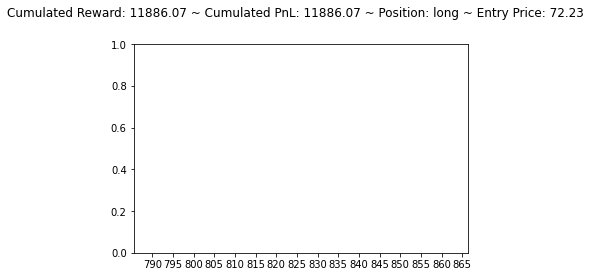

[1131.482  1075.2921 1190.4006]
long sell flat


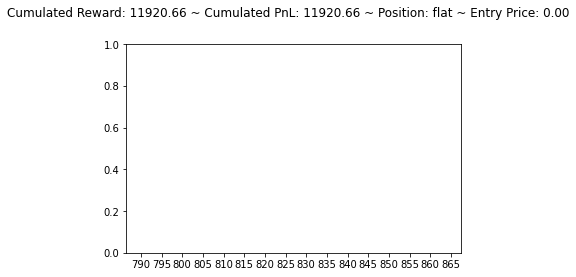

[944.84436 837.00977 952.112  ]
flat sell short


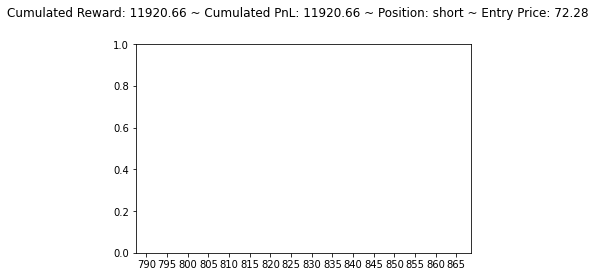

[908.6325  659.0376  881.57275]
short hold short


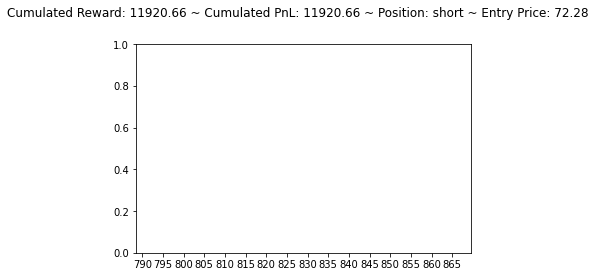

[765.43256 881.538   961.8496 ]
short buy flat


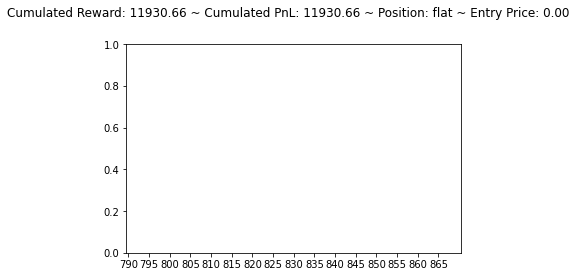

[718.3643  691.82715 716.61676]
flat hold flat


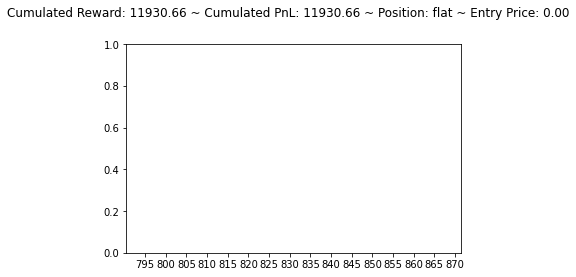

[722.46625 841.9392  741.9417 ]
flat buy long


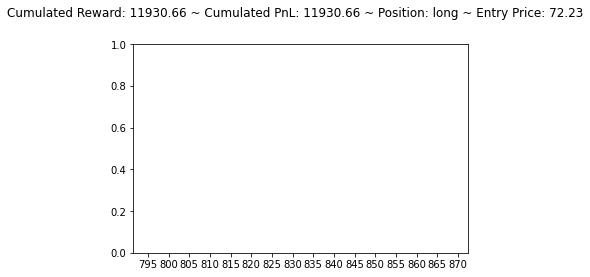

[692.4162  859.27783 672.0143 ]
long hold long


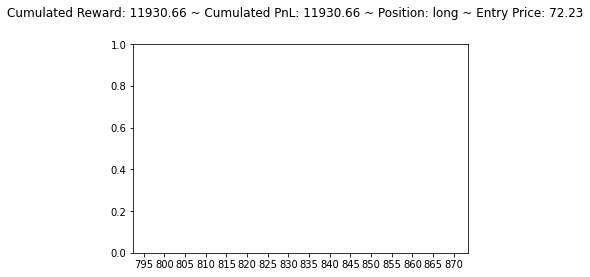

[ 721.59143  638.0953  1015.1006 ]
long sell flat


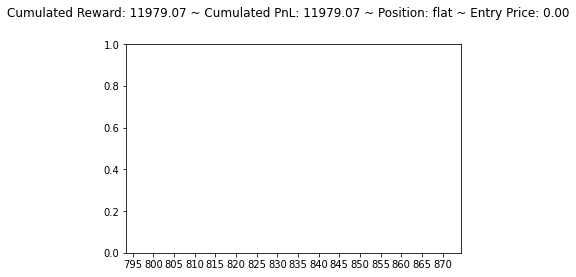

[1322.1917 1167.8389 1195.1328]
flat hold flat


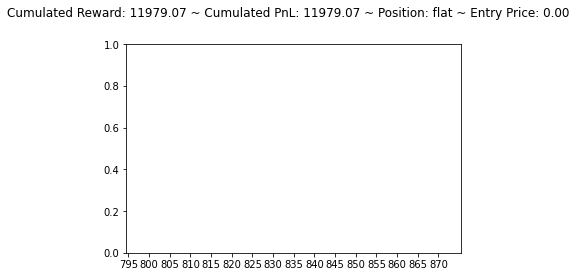

[1417.1993 1528.6183 1545.3782]
flat sell short


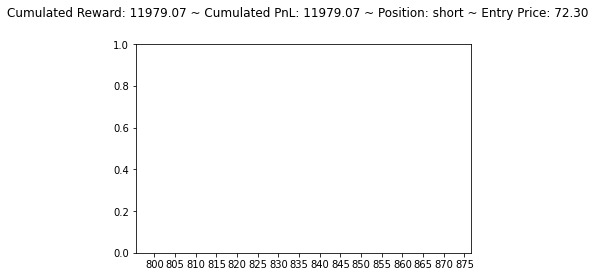

[1526.023  1569.6539 1490.4634]
short buy flat


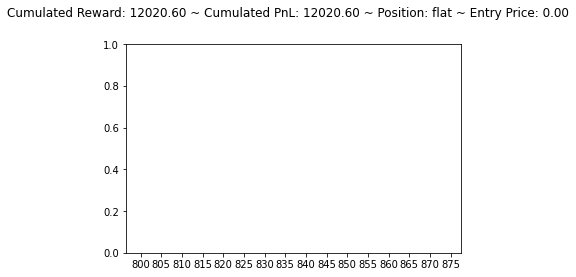

[1162.0367 1011.2353 1052.0052]
flat hold flat


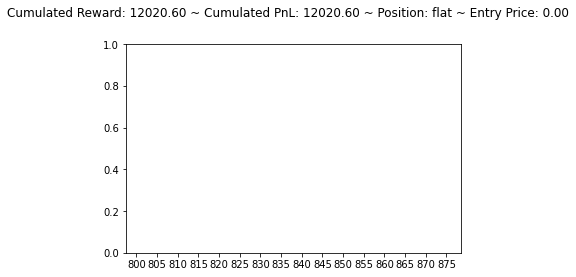

[1340.0339 1771.3568 1209.1259]
flat buy long


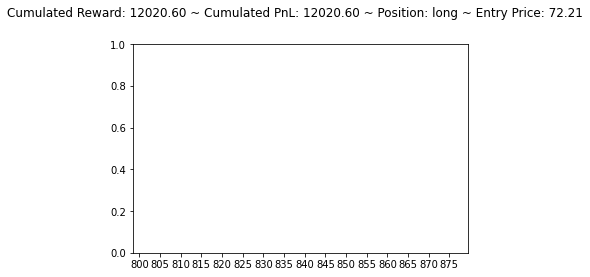

[2484.7334 2870.492  2817.98  ]
long sell flat


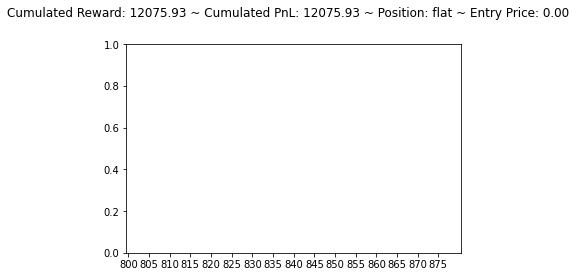

[1143.0415 1274.6111 1012.964 ]
flat buy long


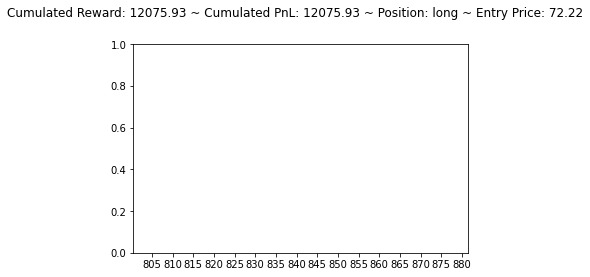

[1152.6622  995.9911 1050.144 ]
long hold long


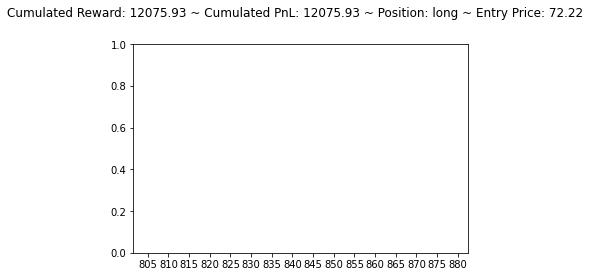

[682.05316 820.62134 632.005  ]
long hold long


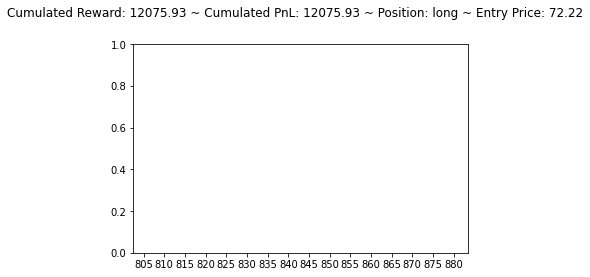

[ 720.61615  611.3244  1006.7116 ]
long sell flat


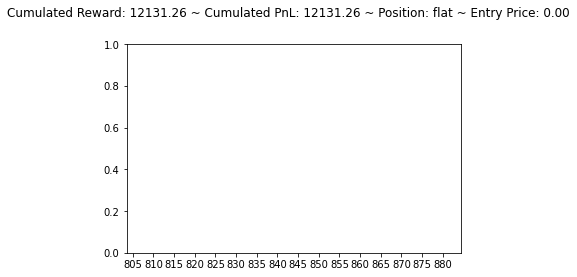

[1379.3612 1208.8606 1253.2504]
flat hold flat


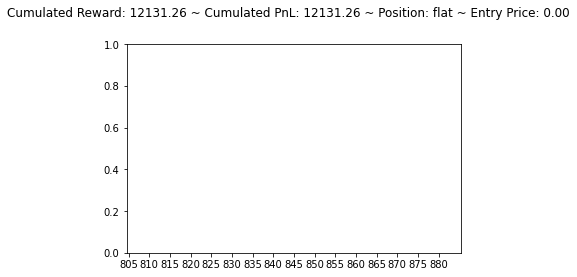

[1467.4926 1576.199  1572.9148]
flat buy long


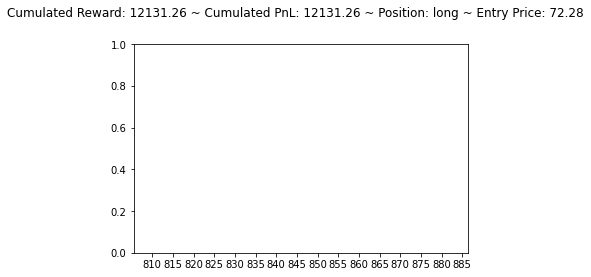

[1377.0824 1364.4388 1402.7083]
long sell flat


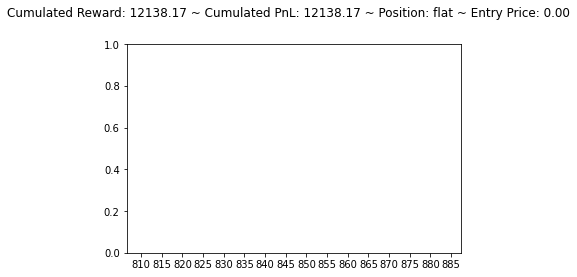

[1077.3746   921.68536  966.0944 ]
flat hold flat


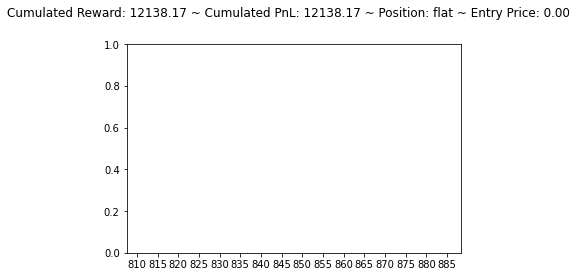

flat buy long


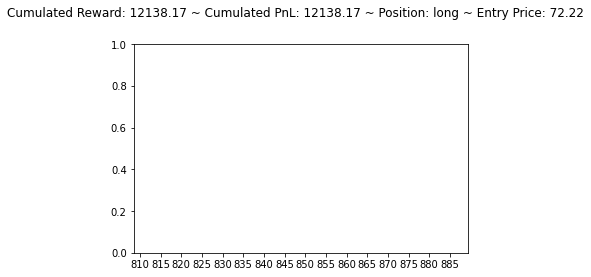

[1413.1427 1546.1276 1471.9232]
long sell flat


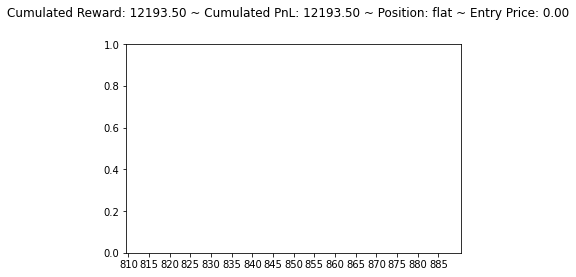

[1280.3175 1186.933  1218.4668]
flat hold flat


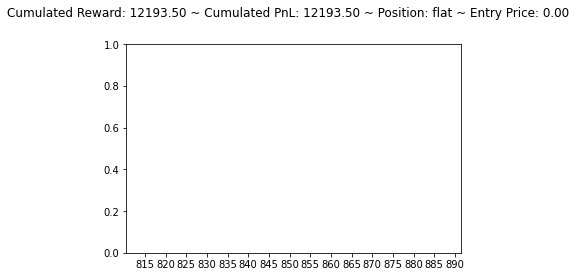

[1468.0474  835.3454 1228.6898]
flat hold flat


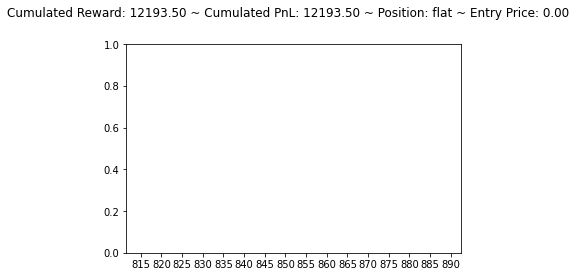

[1052.722  1278.851  1211.9307]
flat buy long


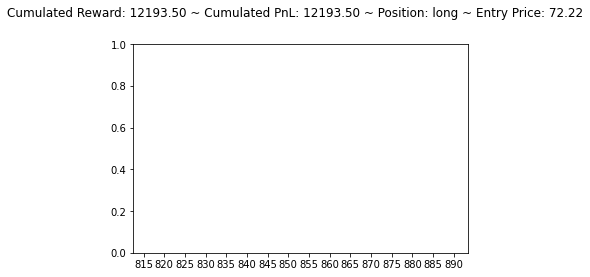

[ 893.7884  1063.7255   945.82385]
long sell flat


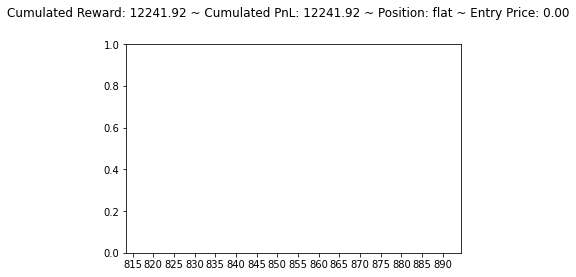

[679.8258 872.9392 842.3683]
flat buy long


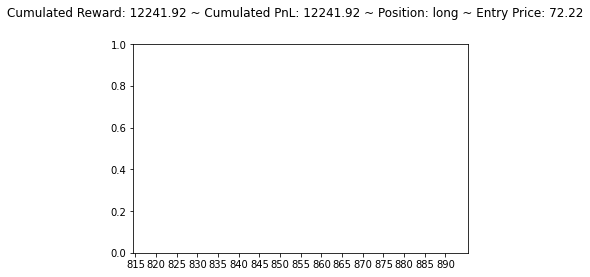

[1307.374  1435.7185 1303.698 ]
long hold long


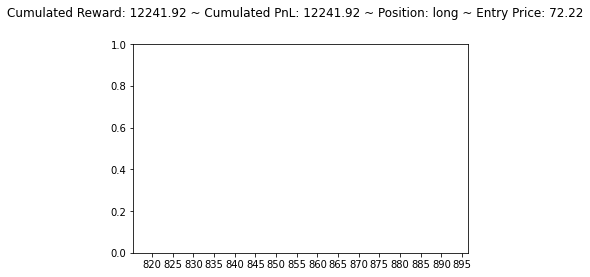

[1401.5294 1543.3883 1383.9698]
long hold long


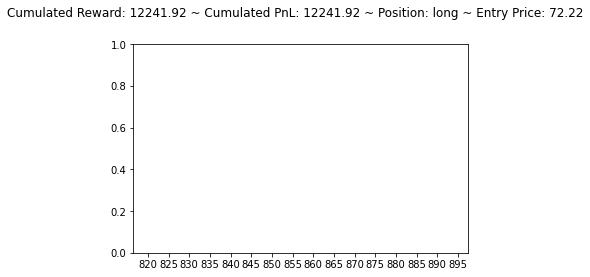

[1149.8823 1301.3171 1130.0997]
long hold long


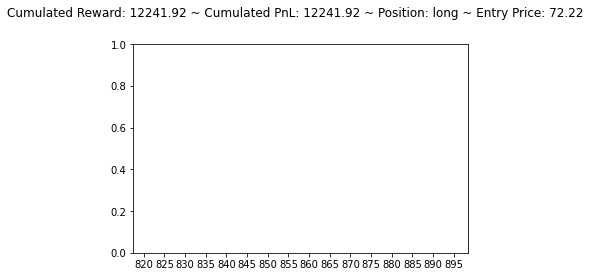

[1024.7965 1130.5624 1052.3173]
long sell flat


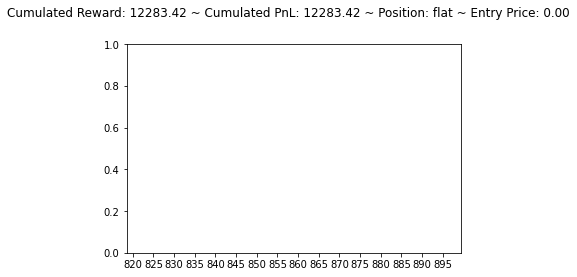

[1000.98456 1063.2563  1024.7542 ]
flat buy long


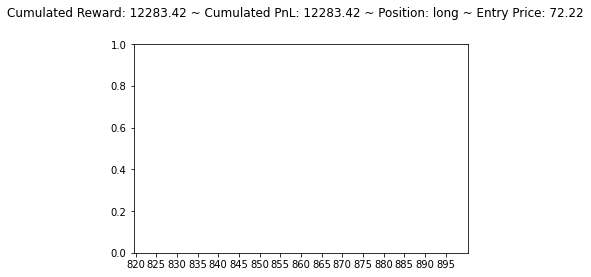

[ 916.9559 1176.008  1063.0282]
long sell flat


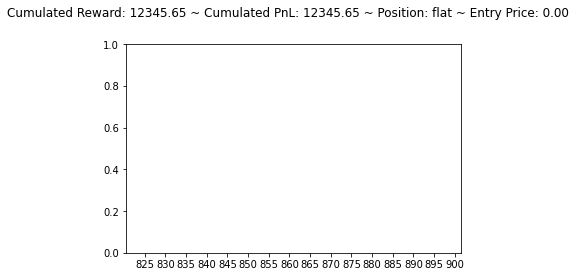

[908.443   974.44403 918.7687 ]
flat buy long


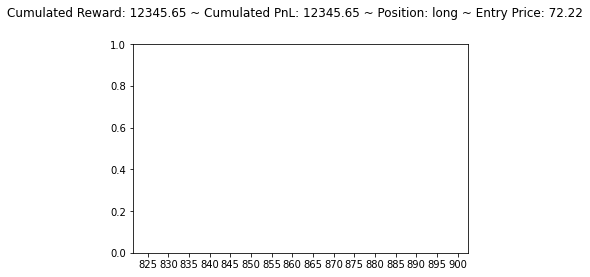

[ 894.52075 1053.2981   966.6111 ]
long sell flat


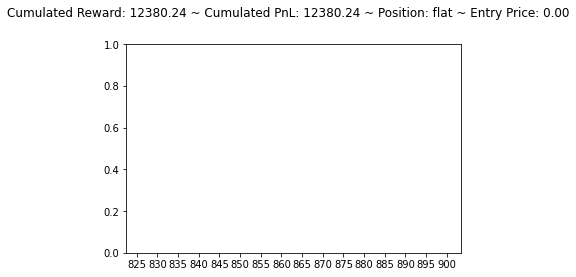

[862.6787 938.82   890.5664]
flat buy long


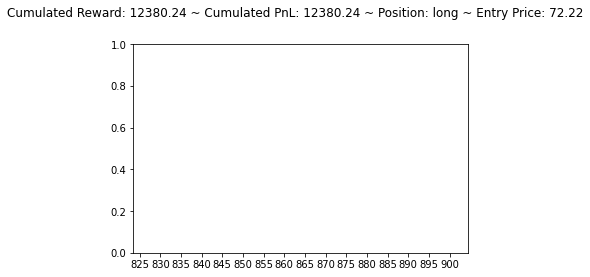

[1224.4158 1240.4526 1158.3578]
long hold long


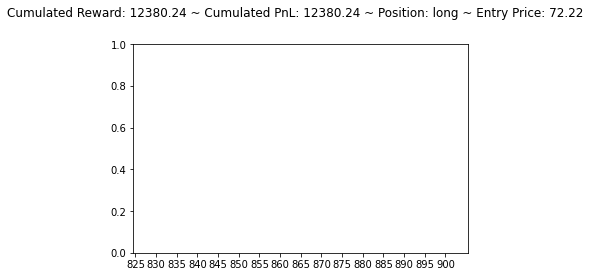

[1354.9559 1488.8845 1343.9391]
long hold long


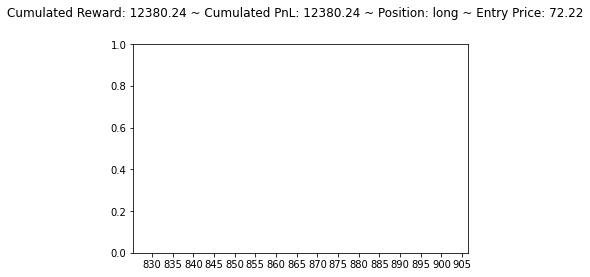

[1204.1057 1221.303  1177.0608]
long hold long


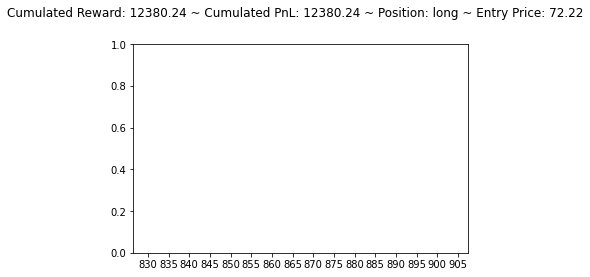

[1043.2028 1384.2122 1213.77  ]
long sell flat


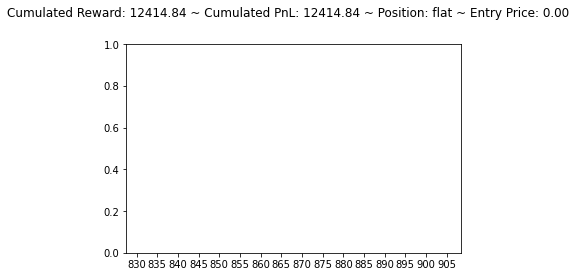

[ 920.8419 1034.3062  876.088 ]
flat buy long


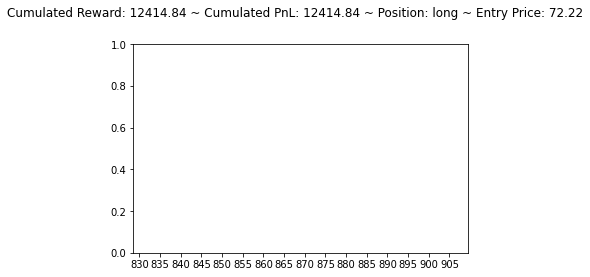

[1157.8468 1205.1998 1156.1766]
long hold long


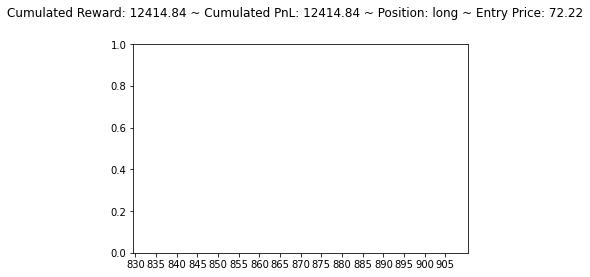

[1611.2992 1752.6517 1429.0354]
long hold long


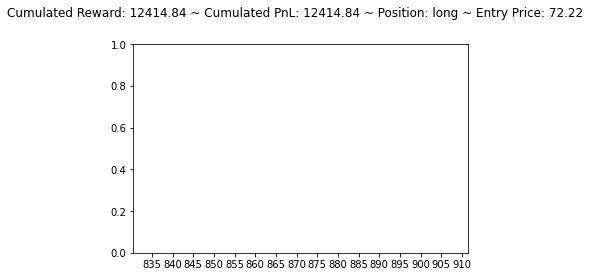

[1060.1145   987.74194 1072.0122 ]
long sell flat


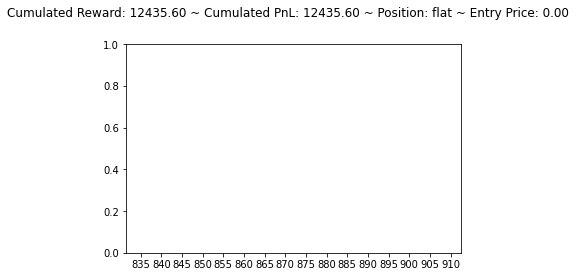

[893.80365 967.5061  982.4217 ]
flat sell short


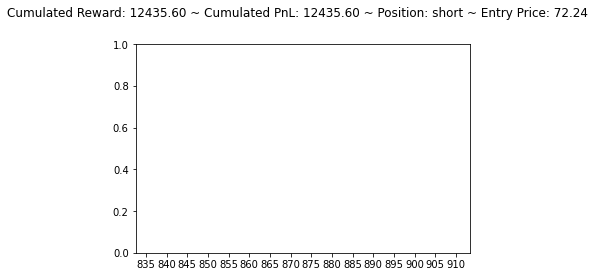

[1154.8063  987.256  1126.5864]
short hold short


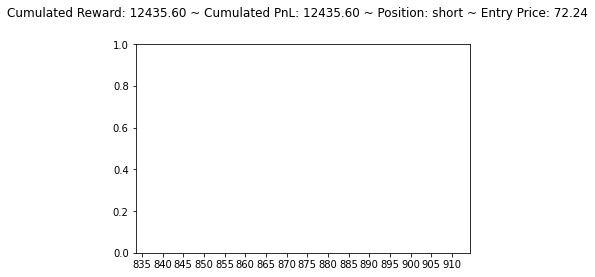

[ 999.1922 1115.9965 1077.1321]
short buy flat


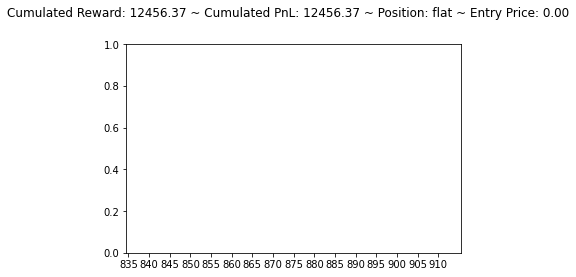

[799.9775  559.0995  714.90674]
flat hold flat


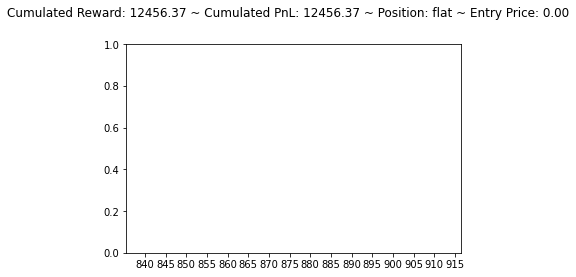

[668.4338 668.9149 704.3889]
flat sell short


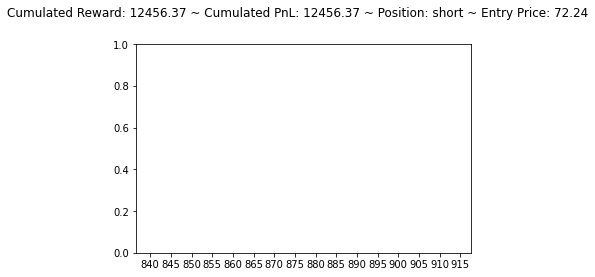

[970.35596 958.6991  821.87286]
short hold short


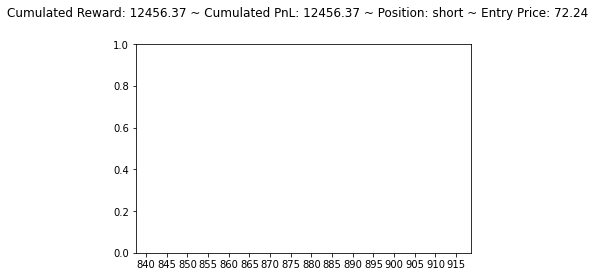

[1559.6079 1871.9532 1311.2024]
short buy flat


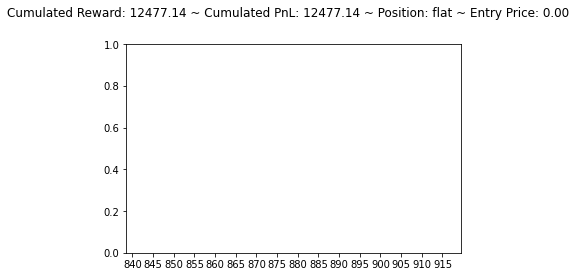

[866.1276  737.33105 912.49097]
flat sell short


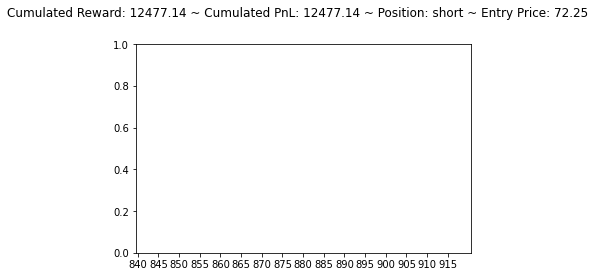

[1135.097  1178.0706 1039.4818]
short buy flat


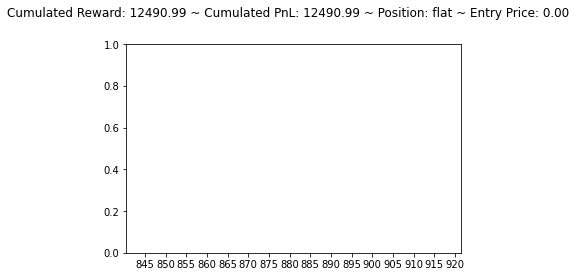

[735.04065 857.37463 743.21686]
flat buy long


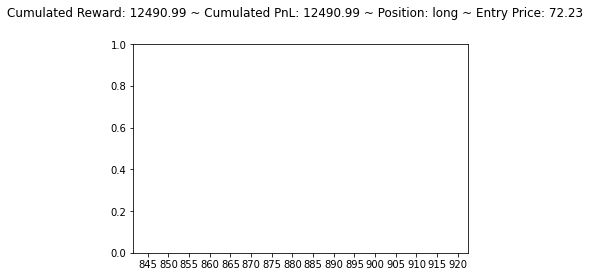

[912.2072  969.70276 842.5653 ]
long hold long


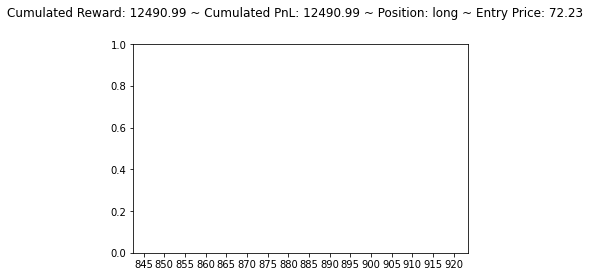

[942.02997 956.5668  802.4949 ]
long hold long


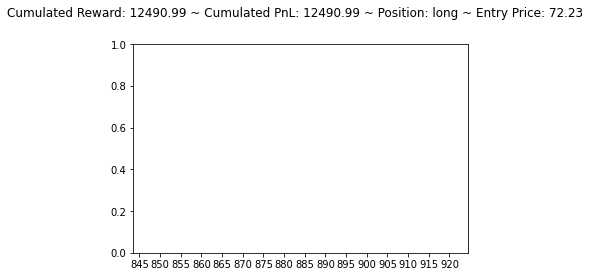

[1180.0933   568.5849   987.83984]
long hold long


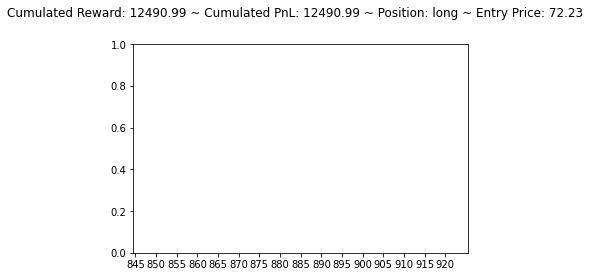

[811.62994 954.4013  810.8511 ]
long hold long


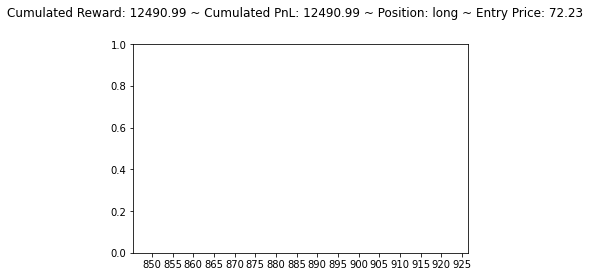

[690.86896 908.7438  797.26776]
long sell flat


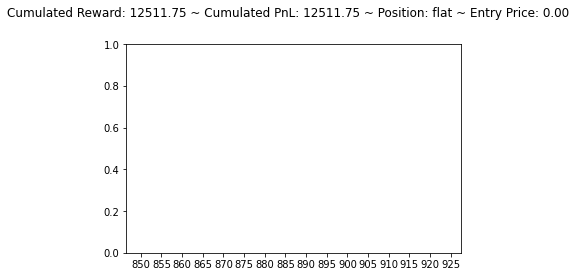

[482.58792 734.6907  729.30383]
flat buy long


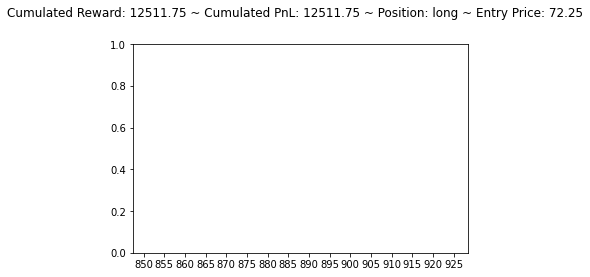

[594.3368 699.2467 768.6583]
long sell flat


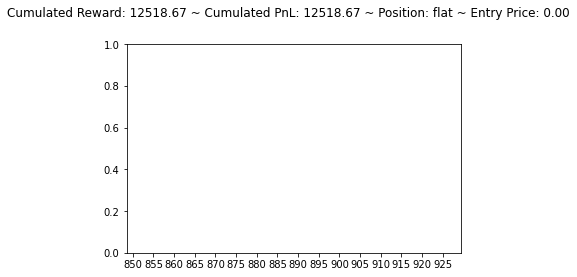

[876.0944  516.54236 686.2884 ]
flat hold flat


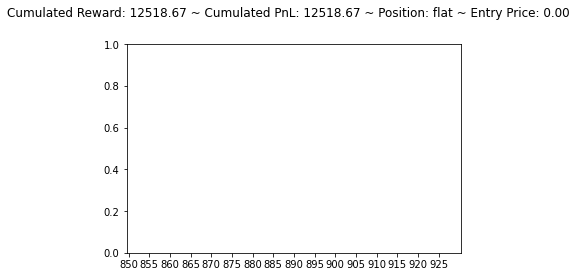

[1155.0455 1809.3341 1294.7947]
flat buy long


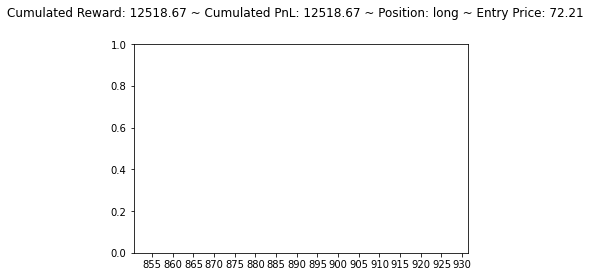

[1210.8798 1202.2123 1231.6456]
long sell flat


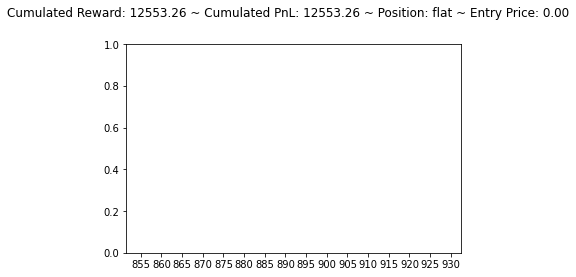

[852.44135 752.25684 775.0471 ]
flat hold flat


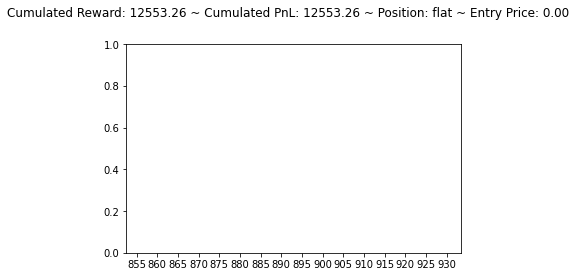

[547.5799  737.38525 804.73553]
flat sell short


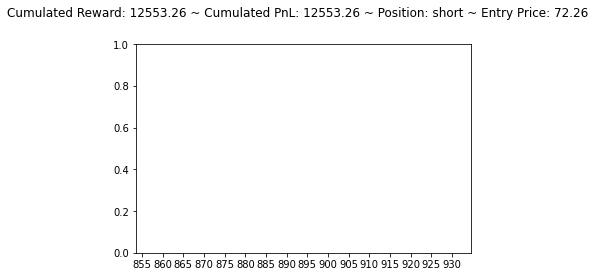

[1368.8821 2014.5092 1223.2689]
short buy flat


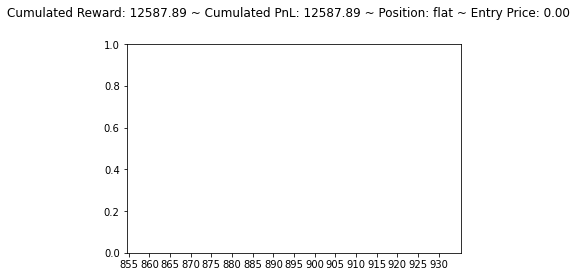

[1067.785  1026.9357 1103.8344]
flat sell short


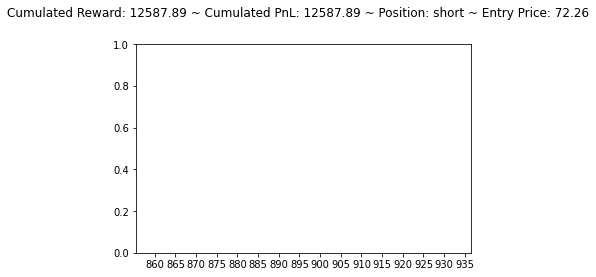

[929.97003 909.9154  866.9031 ]
short hold short


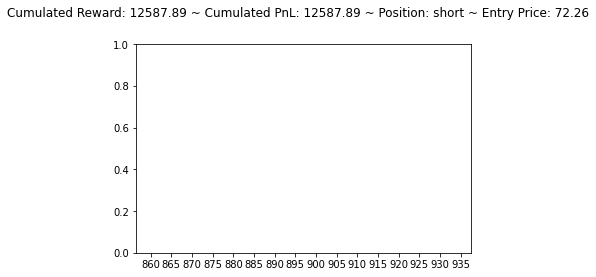

short hold short


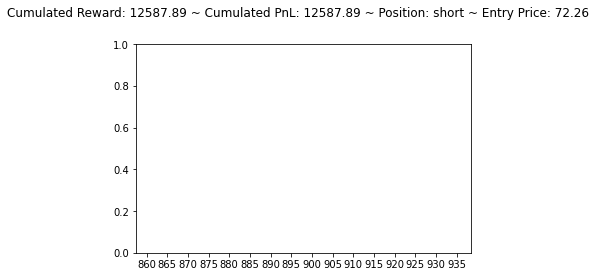

[ 930.4525  1065.4775   980.94104]
short buy flat


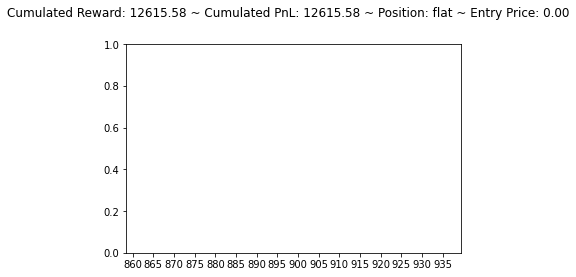

[894.3283 964.1286 907.1765]
flat buy long


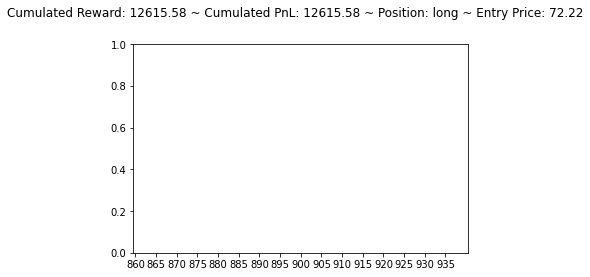

[1087.202   1108.4799   923.97205]
long hold long


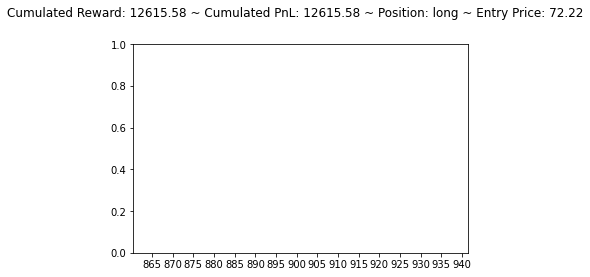

[1285.3446   973.19006 1244.0994 ]
long hold long


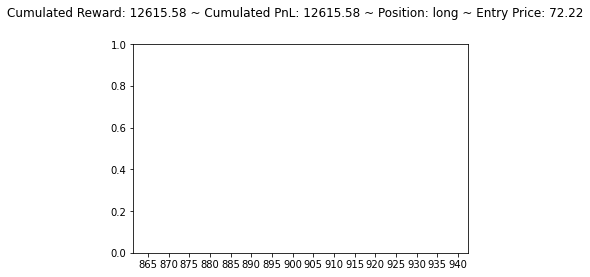

[1010.0631 1045.5662  969.1691]
long hold long


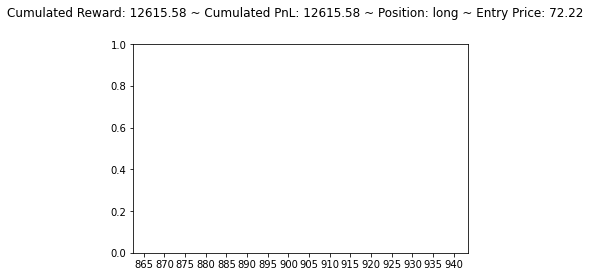

[967.1699  936.93866 794.41724]
long hold long


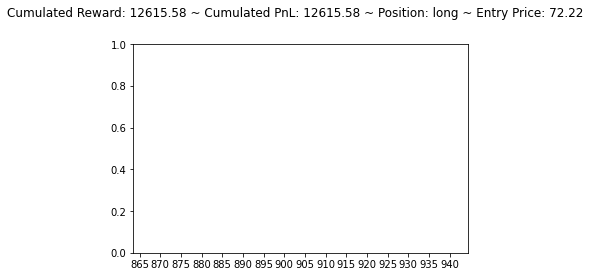

long sell flat


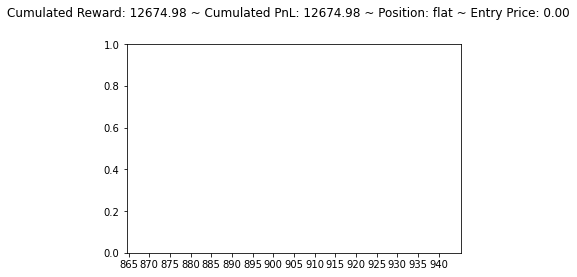

[838.98615 871.2598  776.6497 ]
flat buy long


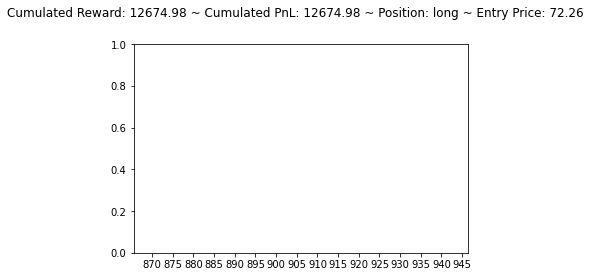

[1011.68036  950.0172   909.3462 ]
long hold long


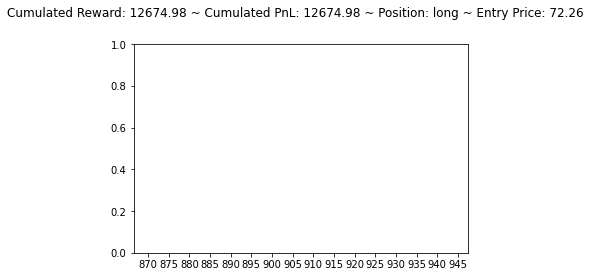

[960.51166 844.2032  917.1505 ]
long hold long


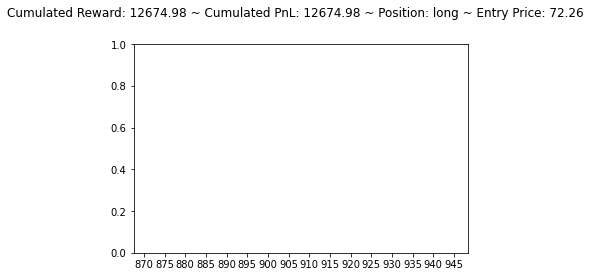

[812.1094 689.0591 812.6097]
long sell flat


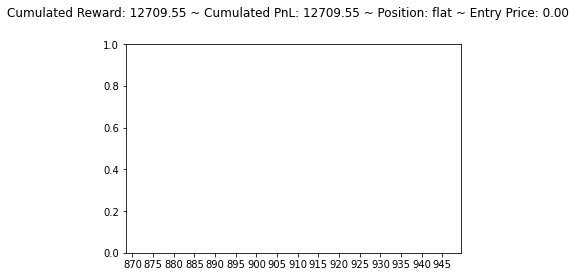

[633.8377  478.03043 580.8998 ]
flat hold flat


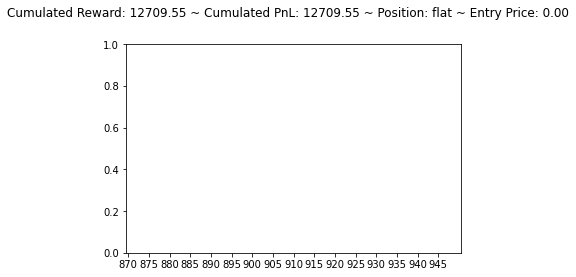

[771.7781 556.7466 662.4769]
flat hold flat


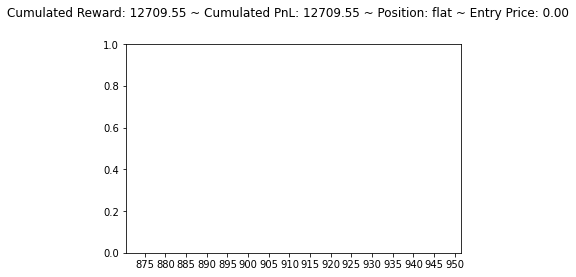

[707.43646 837.2148  721.0716 ]
flat buy long


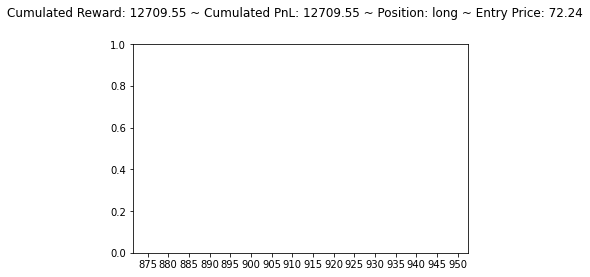

[654.74164 899.59076 792.10114]
long sell flat


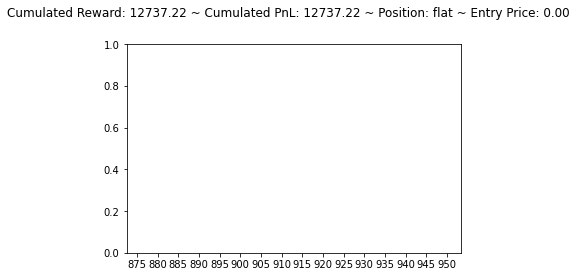

[780.16565 827.30286 762.29443]
flat buy long


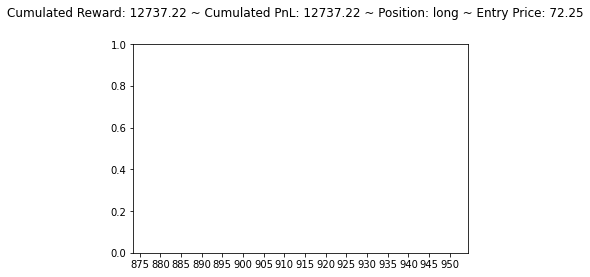

[809.7292  948.36096 812.0515 ]
long sell flat


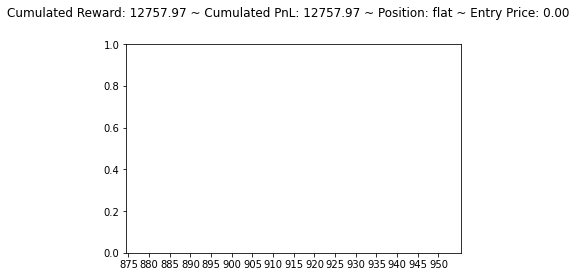

[772.0034  848.95715 755.1744 ]
flat buy long


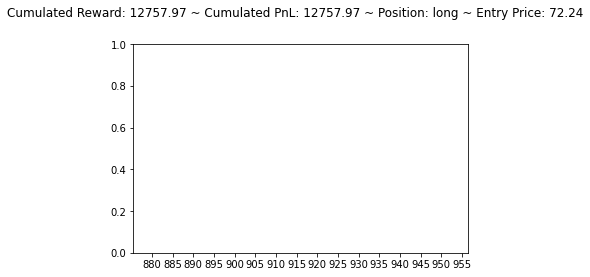

[805.891  947.5131 811.4743]
long sell flat


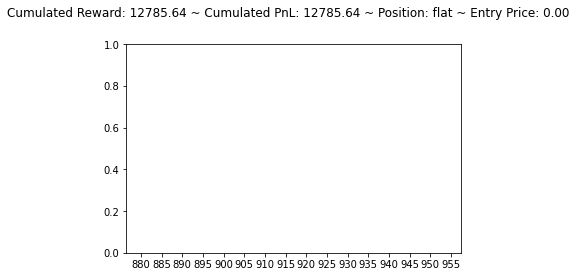

[794.41876 838.71405 742.4782 ]
flat buy long


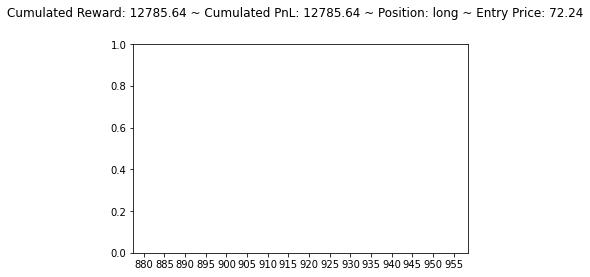

[864.83997 955.77277 802.8102 ]
long hold long


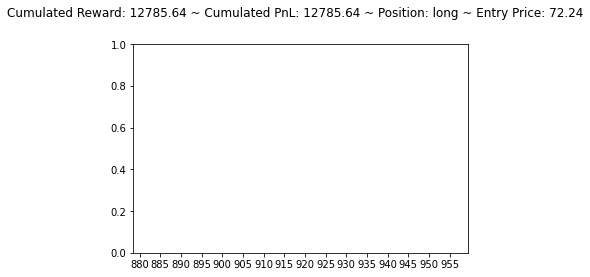

[1168.3533 1463.4573 1195.7946]
long sell flat


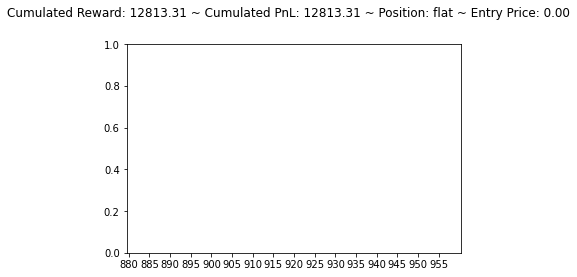

[1053.8276  1020.49365 1028.6887 ]
flat hold flat


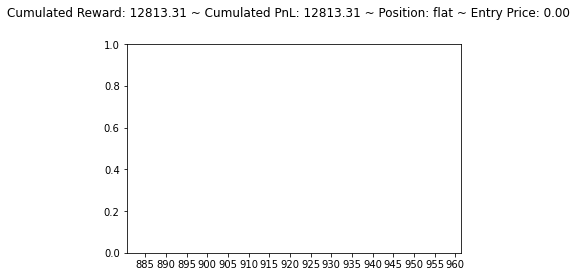

[1085.0599 1324.2612 1125.1005]
flat buy long


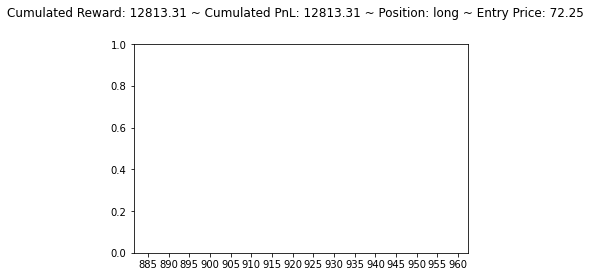

[1504.6333 1610.4578 1449.6157]
long hold long


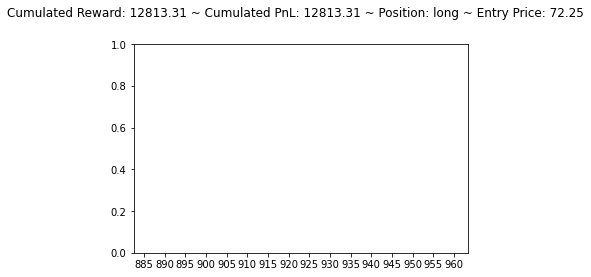

[ 977.92487 1113.9349   813.76636]
long hold long


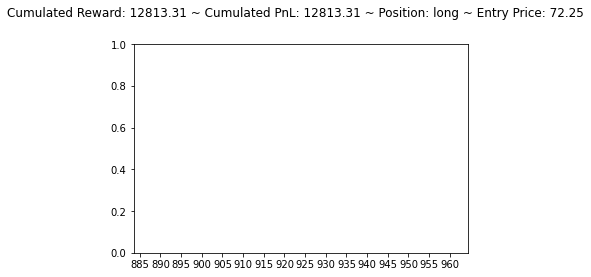

[680.88104 930.633   845.8837 ]
long sell flat


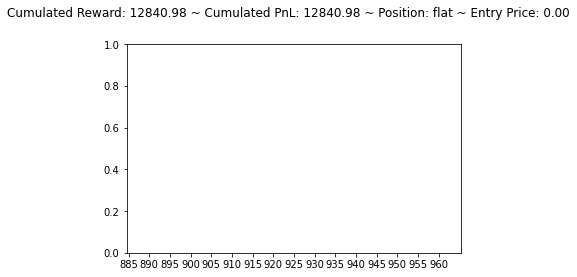

[616.77905 796.3918  741.9679 ]
flat buy long


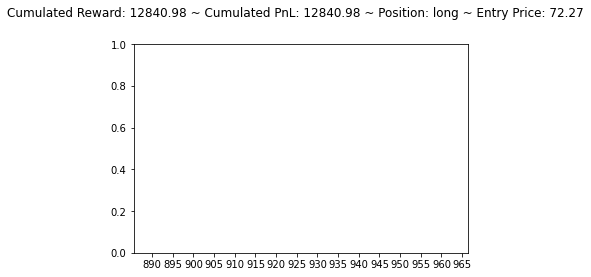

[728.28467 926.49963 827.3553 ]
long sell flat


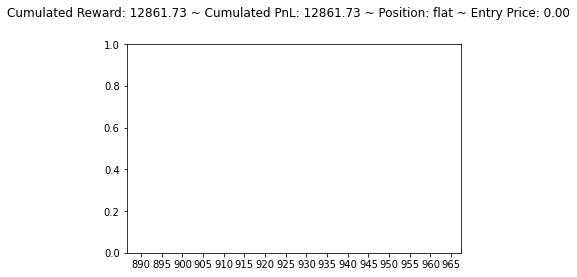

[697.45294 690.0442  779.0237 ]
flat sell short


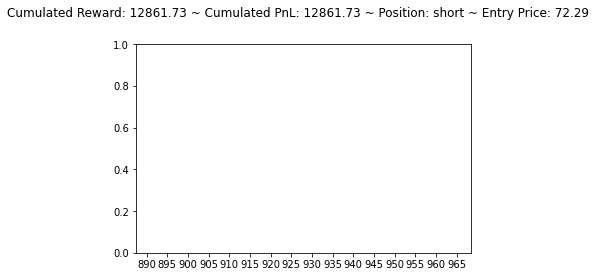

[964.5371 897.9291 624.8372]
short hold short


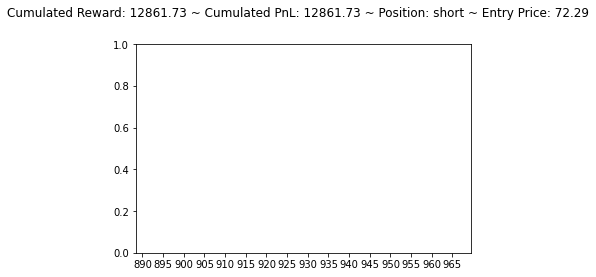

[560.0769 634.7709 782.1366]
short buy flat


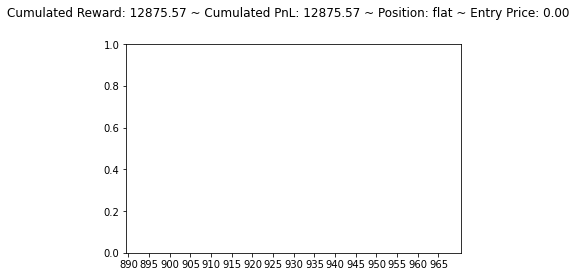

[494.72382 778.65625 780.24255]
flat sell short


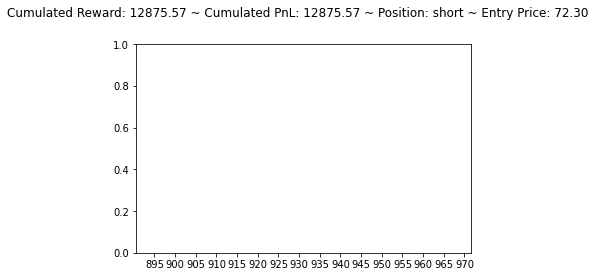

[889.6121  912.02814 829.14667]
short buy flat


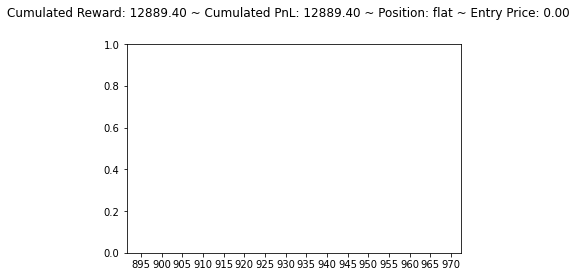

[1040.874   894.1432  946.755 ]
flat hold flat


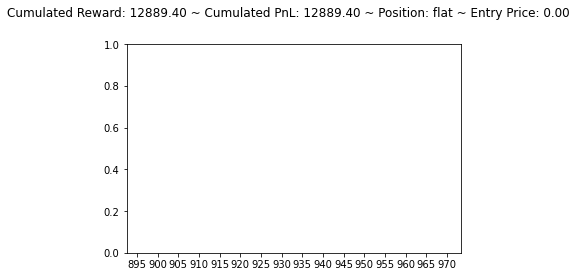

[590.4396  521.82074 596.1206 ]
flat sell short


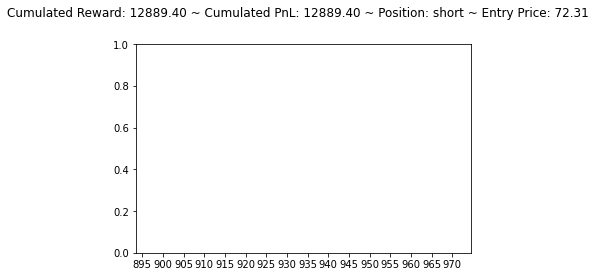

[893.22833 904.1786  813.43896]
short buy flat


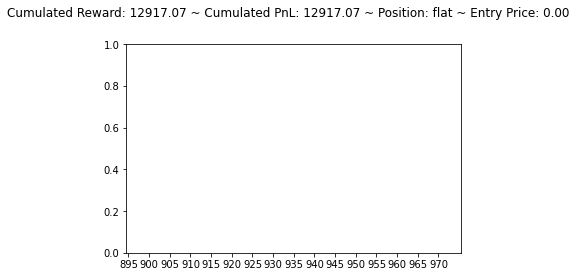

[ 986.60345 1079.865    957.4623 ]
flat buy long


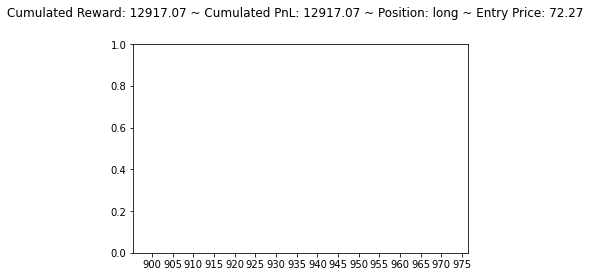

[1144.2361 1194.142  1035.2404]
long hold long


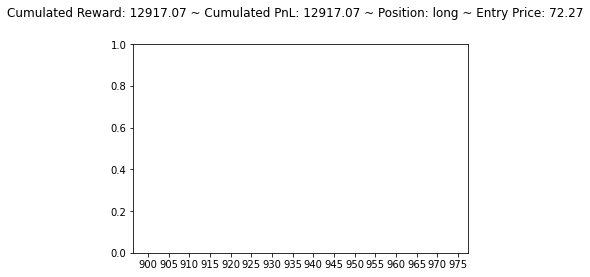

[1121.8018 1181.4879 1022.2421]
long hold long


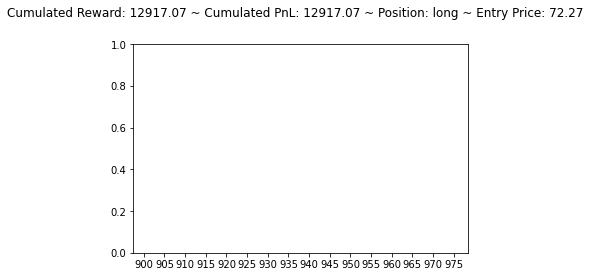

[1089.3312  1064.134    981.33014]
long hold long


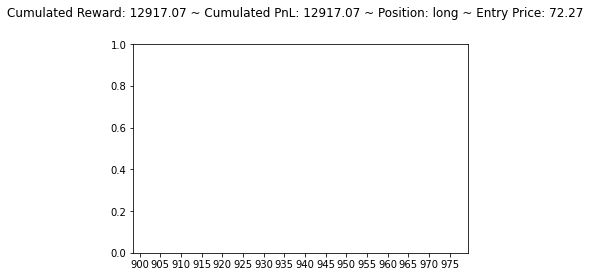

[932.3688  757.082   863.66254]
long hold long


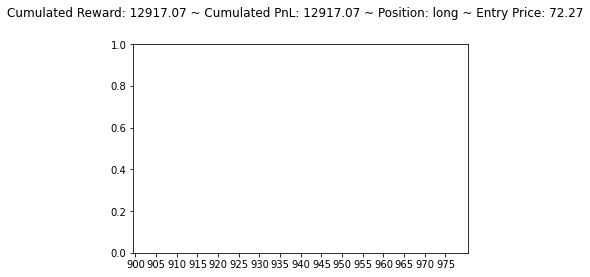

[761.9292 518.3406 669.612 ]
long hold long


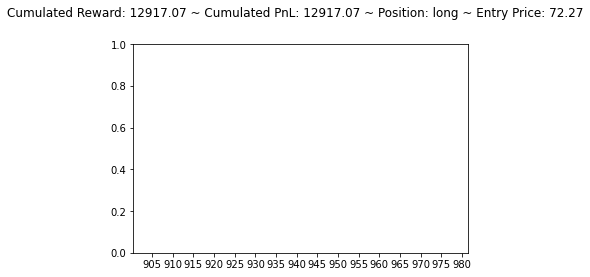

[570.28485 489.68738 682.4676 ]
long sell flat


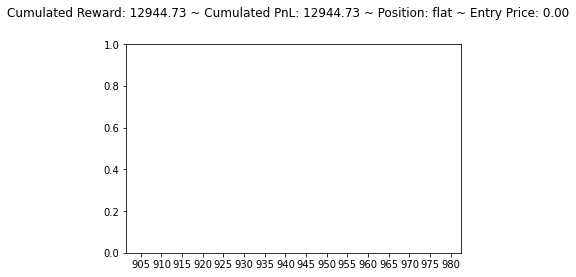

[731.72266 700.9568  670.99164]
flat hold flat


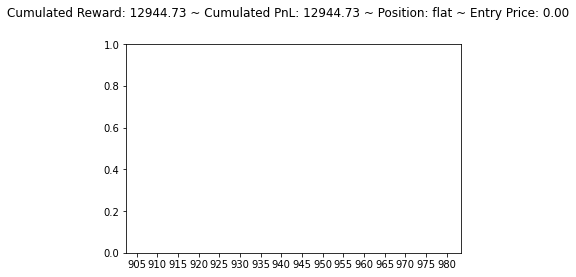

[616.2246 819.1074 708.6353]
flat buy long


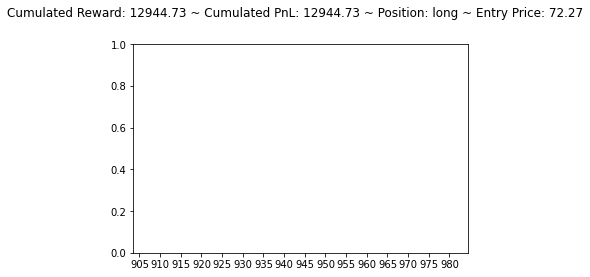

[773.8416 847.4961 656.2715]
long hold long


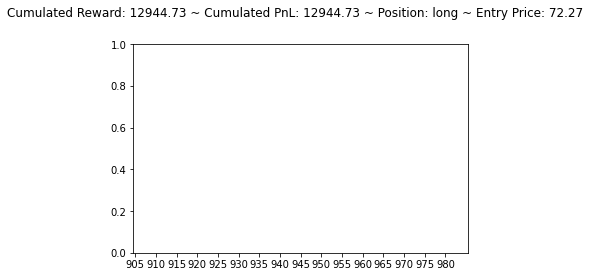

[820.9522  551.16174 886.8989 ]
long sell flat


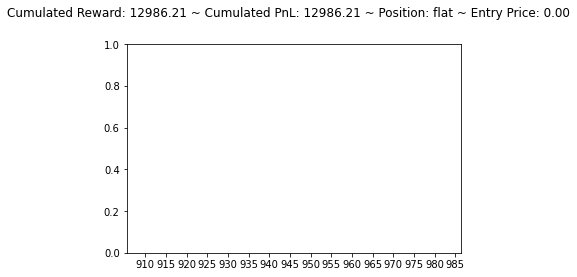

[753.14905 832.8749  717.83167]
flat buy long


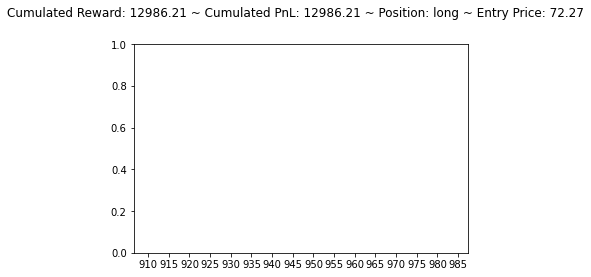

[788.13043 838.7398  743.36755]
long hold long


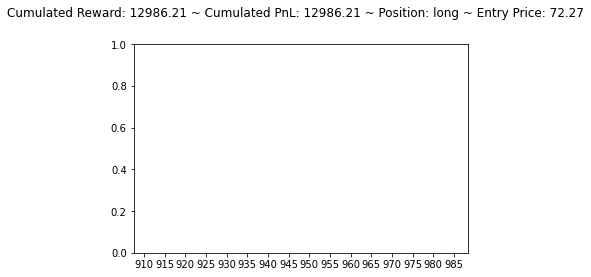

[878.9158 813.3771 934.1737]
long sell flat


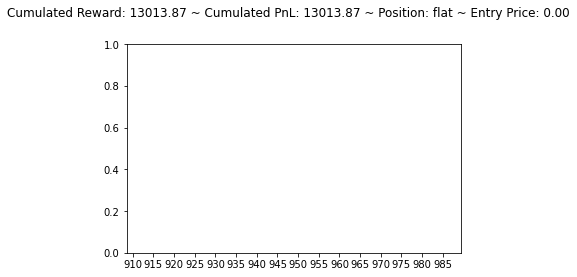

[726.82153 812.07623 712.3904 ]
flat buy long


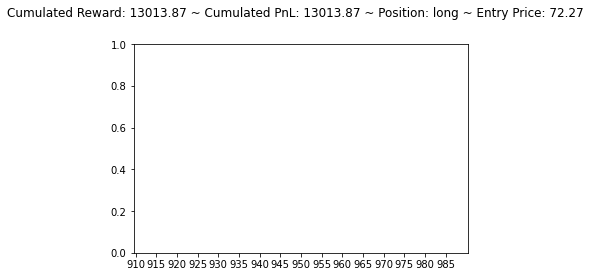

[918.92084 924.3242  851.11365]
long hold long


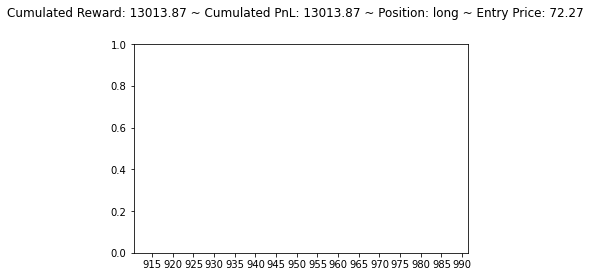

[929.1605  901.72894 913.3352 ]
long hold long


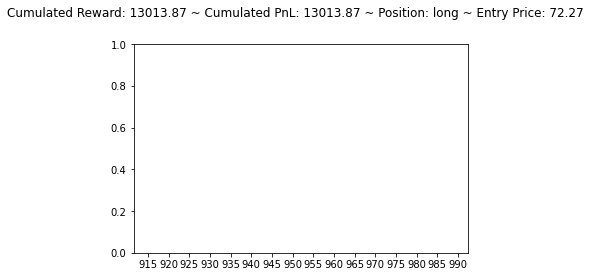

[909.3715 858.5219 834.4602]
long hold long


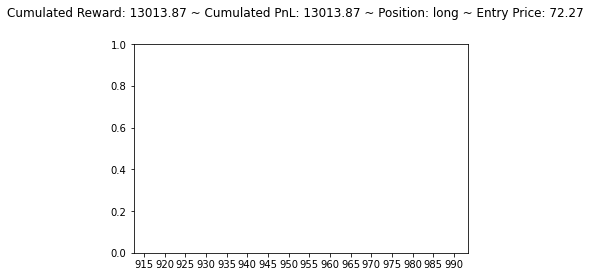

[996.2906 988.4033 828.747 ]
long hold long


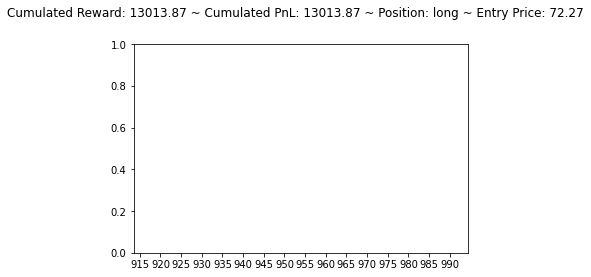

[750.2063 946.1395 785.0747]
long sell flat


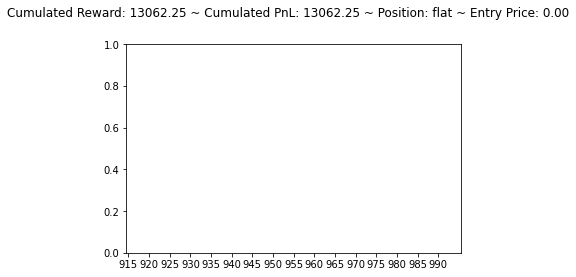

[439.547   587.6382  632.46643]
flat sell short


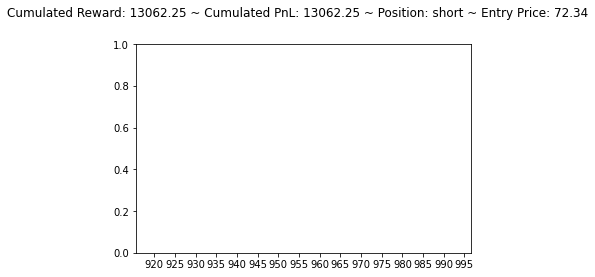

[600.27094 702.0881  747.8748 ]
short buy flat


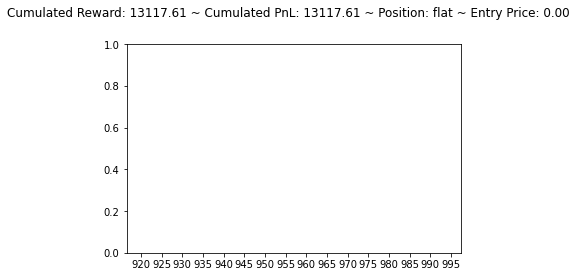

[417.68073 402.79752 736.0161 ]
flat sell short


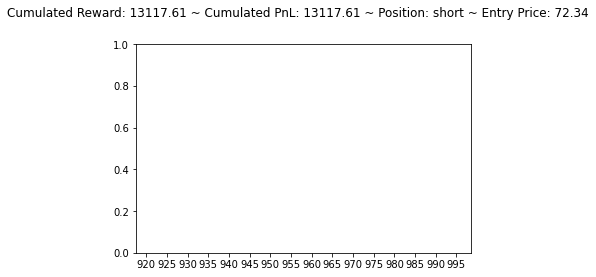

[ 868.93463  747.89825 1016.36914]
short hold short


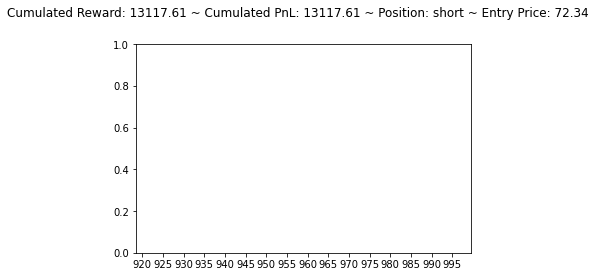

[1001.6583  1019.03656  875.8006 ]
short buy flat


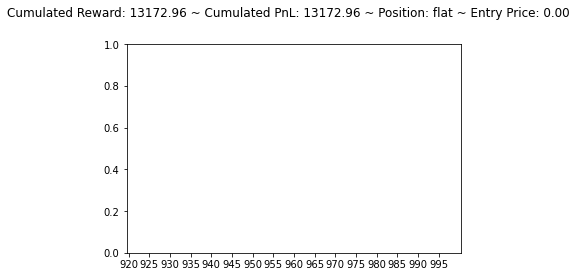

In [70]:
# Running the agent
done = False
state = environment.reset()
while not done:
    action = agent.act(np.asarray(state).astype('float32'))
    
    for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            position_name = position
        
    for _action in environment._actions:
          if all(action==environment._actions[_action]):
            action_name = _action
    
    state, _, done, info = environment.step(action)
    
    for position in environment._positions:
          if all(environment._position==environment._positions[position]):
            next_position_name = position
               
    print(position_name, action_name, next_position_name)
    
    if 'status' in info and info['status'] == 'Closed plot':
        done = True
    else:
        try:
            environment.render()
        except TypeError as e:
            print(e)
            continue